In [1]:
import pandas as pd

In [2]:
[feature for feature in features_sorted if feature[1] > threshold]

C:\Program Files\Python36\lib\site-packages\IPython\core\interactiveshell.py:2705: DtypeWarning: Columns (1) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [3]:
ped.shape

(5901, 17754)

In [4]:
ped.head()

,id,fid,cos1,cos2,sex,color,rs6599770,rs12440100,rs12906138,rs7179358,...,exm1194798,exm1194803,exm1194806,rs7182651,rs7180058,rs2203349,exm1194810,exm2274791,rs13329121,rs11247329
0,3,19Y384,0,0,2,1,"('A', 'C')","('A', 'G')","('A', 'G')","('A', 'A')",...,"('A', 'A')","('G', 'G')","('C', 'C')","('G', 'G')","('G', 'G')","('T', 'C')","('C', 'C')","('C', 'C')","('T', 'T')","('C', 'T')"
1,4,19Y382,0,0,2,2,"('A', 'C')","('G', 'G')","('A', 'G')","('A', 'A')",...,"('A', 'A')","('G', 'G')","('C', 'C')","('A', 'G')","('G', 'G')","('C', 'C')","('C', 'C')","('C', 'C')","('C', 'T')","('T', 'T')"
2,5,19Y411,0,0,1,2,"('A', 'C')","('G', 'G')","('G', 'G')","('G', 'A')",...,"('A', 'A')","('G', 'G')","('C', 'C')","('A', 'G')","('G', 'G')","('T', 'T')","('T', 'C')","('C', 'C')","('T', 'T')","('C', 'T')"
3,6,19Y406,0,0,2,2,"('C', 'C')","('G', 'G')","('A', 'G')","('G', 'G')",...,"('A', 'A')","('A', 'G')","('C', 'C')","('A', 'G')","('G', 'G')","('T', 'T')","('C', 'C')","('C', 'C')","('T', 'T')","('C', 'T')"
4,7,19Y448,0,0,2,2,"('C', 'C')","('G', 'G')","('G', 'G')","('G', 'G')",...,"('A', 'A')","('G', 'G')","('C', 'C')","('A', 'G')","('G', 'G')","('C', 'C')","('C', 'C')","('C', 'C')","('C', 'T')","('T', 'T')"


In [15]:
ped.groupby('color').count()

,id,fid,cos1,cos2,sex,rs6599770,rs12440100,rs12906138,rs7179358,kgp6444009,...,exm1194798,exm1194803,exm1194806,rs7182651,rs7180058,rs2203349,exm1194810,exm2274791,rs13329121,rs11247329
color,,,,,,,,,,,,,,,,,,,,,
-9,1126,1126,1126,1126,1126,1126,1126,1126,1126,1126,...,1126,1126,1126,1126,1126,1126,1126,1126,1126,1126
1,3011,3011,3011,3011,3011,3011,3011,3011,3011,3011,...,3011,3011,3011,3011,3011,3011,3011,3011,3011,3011
2,1764,1764,1764,1764,1764,1764,1764,1764,1764,1764,...,1764,1764,1764,1764,1764,1764,1764,1764,1764,1764


### Data clearing

In [23]:
# Remove unnown values
ped = ped.drop(ped[ped.color == -9].index)

In [21]:
ped.groupby('color').count()

,id,fid,cos1,cos2,sex,rs6599770,rs12440100,rs12906138,rs7179358,kgp6444009,...,exm1194798,exm1194803,exm1194806,rs7182651,rs7180058,rs2203349,exm1194810,exm2274791,rs13329121,rs11247329
color,,,,,,,,,,,,,,,,,,,,,
1,3011,3011,3011,3011,3011,3011,3011,3011,3011,3011,...,3011,3011,3011,3011,3011,3011,3011,3011,3011,3011
2,1764,1764,1764,1764,1764,1764,1764,1764,1764,1764,...,1764,1764,1764,1764,1764,1764,1764,1764,1764,1764


In [34]:
train = ped.drop(['id', 'fid', 'cos1', 'cos2', 'sex', 'color'], axis=1)

In [37]:
# Remove columns with only one value
for poly in list(train.columns.values):
    if train[poly].nunique() == 1:
        print(poly)
        train = train.drop(poly, axis=1)

exm1824992
variant.34221
variant.34222
exm1141205
exm1141207
variant.34233
exm1141255
exm1141256
exm1141386
exm1141424
indel.34245
exm1141684
newrs138976716
exm1141701
exm1141908
exm1141919
exm1141954
exm1141981
exm1142007
exm1142468
exm1142570
variant.34264
exm1142579
exm2223088
exm1825714
exm1142692
exm1142700
exm1825749
exm1142770
exm1142780
1KG_15_26260492
variant.34273
indel.34280
exm1142919
rs111782177
rs111864417
rs190819188
rs151210258
rs182290687
rs200732154
rs138228425
rs183101063
rs146505199
rs183743105
rs141949212
rs148894313
variant.34281
rs138335119
rs7173419
rs138985876
rs1800415
rs139844766
rs141159640
rs34141095
rs143699063
rs142152913
exm1143070
exm1143074
rs148413474
rs76026235
rs141627675
exm1143084
rs140566426
rs150020919
exm1143100
rs140703213
exm1143110
rs1800403
rs139743429
rs200651760
rs139562520
rs183487020
rs144175965
rs201791790
rs114097653
rs7496685
rs145385813
rs147271386
rs192999801
rs141739498
rs146332822
rs188787231
rs142779606
exm1143196
rs148731297
rs

rs80051519
rs56658716
rs138827241
rs59359360
rs181766689
rs201118855
rs141974163
rs147864142
rs61317221
rs121434538
rs200141896
rs148483238
rs35900050
rs142652579
rs146495071
indel.35740
variant.35741
rs61203654
variant.35747
indel.35748
exm1161747
exm1161772
exm2252193
exm1161843
indel.35759
exm1161908
exm1162002
exm1162085
exm1162109
exm1162128
exm1162181
var_15_52192500
indel.35775
indel.35776
indel.35783
exm1834208
exm1162586
variant.35792
variant.35797
exm1162656
exm1162694
exm1162695
var_15_52567902
exm1834303
exm1162774
exm1162798
exm1162807
exm1162850
variant.35812
exm1162937
exm1163053
exm1163072
exm1163080
indel.35820
exm1163172
exm1163173
exm1163203
exm1163206
exm1163222
variant.35831
variant.35837
variant.35839
variant.35840
newrs142154661
rs2614222
exm1163343
exm1163409
exm1163418
exm1163434
variant.35847
variant.35848
exm1163469
variant.35854
exm1163530
variant.35855
exm1163584
var_15_55497852
exm1163652
indel.35864
exm1163737
exm1163798
variant.35878
exm1163817
exm116385

exm1190085
variant.37591
indel.37592
exm2275247
exm1190629
var_15_91479212
exm1190682
exm1190683
exm1190829
exm1190925
var_15_91517814
exm1190955
variant.37648
exm1190980
variant.37650
exm1190994
exm1191057
indel.37658
variant.37660
variant.37664
variant.37665
variant.37671
exm1844601
rs12594058
kgp19959494
kgp19750005
exm1191359
kgp19976672
kgp6980260
kgp19945207
exm1191379
exm1191393
variant.37674
exm1191684
exm1191720
exm1844850
rs7162547
rs8030949
exm1191786
exm1191787
exm1191796
indel.37695
variant.37698
exm1191847
variant.37708
variant.37723
variant.37725
variant.37726
rs7168474
rs8039004
exm1192047
variant.37730
exm1192139
variant.37734
exm1192463
indel.37759
exm1192473
var_15_99670240
exm1192491
exm1192494
exm1192497
exm1192539
exm1192570
indel.37772
variant.37780
exm1192726
exm1192728
exm1192735
exm1192803
exm1193368
var_15_100591918
exm1193382
exm1193432
exm1193460
exm1193465
variant.37814
exm1193549
exm1824379
exm1193573
exm1193576
variant.37830
newrs74386167
exm1193768
rs38

In [38]:
train.shape

(4775, 16269)

In [43]:
train['sex'] = ped['sex']

In [44]:
train.shape

(4775, 16270)

In [57]:
#Remove columns with two values where one of them is (0,0)
for poly in list(train.columns.values):
    if train[poly].nunique() == 2:
        if "('0', '0')" in train[poly].unique():
            print(poly, train[poly].unique())
            train = train.drop(poly, axis=1)

indel.34204 ["('I', 'I')" "('0', '0')"]
exm1140799 ["('T', 'T')" "('0', '0')"]
exm1140818 ["('T', 'T')" "('0', '0')"]
exm1140821 ["('C', 'C')" "('0', '0')"]
exm1824994 ["('C', 'C')" "('0', '0')"]
exm1140825 ["('G', 'G')" "('0', '0')"]
exm1140829 ["('C', 'C')" "('0', '0')"]
exm1140833 ["('A', 'A')" "('0', '0')"]
exm1140871 ["('G', 'G')" "('0', '0')"]
exm1140928 ["('T', 'T')" "('0', '0')"]
exm1140966 ["('C', 'C')" "('0', '0')"]
newrs139137715 ["('A', 'A')" "('0', '0')"]
exm1141114 ["('T', 'T')" "('0', '0')"]
exm1141115 ["('G', 'G')" "('0', '0')"]
indel.34217 ["('I', 'I')" "('0', '0')"]
exm1141156 ["('C', 'C')" "('0', '0')"]
indel.34223 ["('D', 'D')" "('0', '0')"]
exm1141165 ["('0', '0')" "('C', 'C')"]
exm1825127 ["('G', 'G')" "('0', '0')"]
rs17137283 ["('A', 'A')" "('0', '0')"]
exm1141198 ["('G', 'G')" "('0', '0')"]
exm1141204 ["('G', 'G')" "('0', '0')"]
newrs145285758 ["('G', 'G')" "('0', '0')"]
variant.34235 ["('G', 'G')" "('0', '0')"]
exm1141295 ["('A', 'A')" "('0', '0')"]
exm1141358 

rs141210218 ["('G', 'G')" "('0', '0')"]
exm1143463 ["('G', 'G')" "('0', '0')"]
rs61755662 ["('G', 'G')" "('0', '0')"]
rs148225341 ["('T', 'T')" "('0', '0')"]
rs76296532 ["('A', 'A')" "('0', '0')"]
rs146090836 ["('G', 'G')" "('0', '0')"]
rs74789945 ["('C', 'C')" "('0', '0')"]
rs149188455 ["('C', 'C')" "('0', '0')"]
rs146969415 ["('G', 'G')" "('0', '0')"]
rs147576051 ["('T', 'T')" "('0', '0')"]
rs145730767 ["('G', 'G')" "('0', '0')"]
rs138636407 ["('G', 'G')" "('0', '0')"]
rs150374233 ["('G', 'G')" "('0', '0')"]
rs187225254 ["('G', 'G')" "('0', '0')"]
rs200605180 ["('C', 'C')" "('0', '0')"]
rs200377671 ["('A', 'A')" "('0', '0')"]
rs193014113 ["('C', 'C')" "('0', '0')"]
rs141981089 ["('G', 'G')" "('0', '0')"]
rs148503135 ["('G', 'G')" "('0', '0')"]
rs186663694 ["('T', 'T')" "('0', '0')"]
rs140839645 ["('T', 'T')" "('0', '0')"]
rs144750946 ["('A', 'A')" "('0', '0')"]
rs138650689 ["('T', 'T')" "('0', '0')"]
rs142072884 ["('G', 'G')" "('0', '0')"]
rs200571641 ["('G', 'G')" "('0', '0')"]
rs13

exm1827340 ["('G', 'G')" "('0', '0')"]
exm1145914 ["('G', 'G')" "('0', '0')"]
variant.34469 ["('G', 'G')" "('0', '0')"]
exm1146010 ["('G', 'G')" "('0', '0')"]
exm1146041 ["('G', 'G')" "('0', '0')"]
exm1146045 ["('G', 'G')" "('0', '0')"]
exm1146070 ["('A', 'A')" "('0', '0')"]
indel.34470 ["('D', 'D')" "('0', '0')"]
exm1827424 ["('A', 'A')" "('0', '0')"]
exm1146135 ["('G', 'G')" "('0', '0')"]
indel.34474 ["('I', 'I')" "('0', '0')"]
exm1146136 ["('T', 'T')" "('0', '0')"]
exm1146149 ["('T', 'T')" "('0', '0')"]
exm1146160 ["('T', 'T')" "('0', '0')"]
exm1146174 ["('T', 'T')" "('0', '0')"]
exm1146186 ["('C', 'C')" "('0', '0')"]
exm1146191 ["('A', 'A')" "('0', '0')"]
exm2252113 ["('C', 'C')" "('0', '0')"]
exm1146221 ["('G', 'G')" "('0', '0')"]
exm1146225 ["('A', 'A')" "('0', '0')"]
exm1146228 ["('T', 'T')" "('0', '0')"]
exm1146231 ["('G', 'G')" "('0', '0')"]
exm1146292 ["('G', 'G')" "('0', '0')"]
exm1146317 ["('G', 'G')" "('0', '0')"]
var_15_34395827 ["('D', 'D')" "('0', '0')"]
exm1146352 ["('

exm1149380 ["('A', 'A')" "('0', '0')"]
var_15_40902497 ["('T', 'T')" "('0', '0')"]
exm1149406 ["('C', 'C')" "('0', '0')"]
exm1149409 ["('A', 'A')" "('0', '0')"]
exm1149413 ["('T', 'T')" "('0', '0')"]
exm1149417 ["('A', 'A')" "('0', '0')"]
exm1149418 ["('A', 'A')" "('0', '0')"]
exm1149443 ["('A', 'A')" "('0', '0')"]
exm1149448 ["('T', 'T')" "('0', '0')"]
exm1149451 ["('T', 'T')" "('0', '0')"]
exm1828892 ["('A', 'A')" "('0', '0')"]
exm1149471 ["('A', 'A')" "('0', '0')"]
exm1149485 ["('A', 'A')" "('0', '0')"]
exm1828902 ["('T', 'T')" "('0', '0')"]
exm1149497 ["('G', 'G')" "('0', '0')"]
exm1149514 ["('C', 'C')" "('0', '0')"]
exm1149533 ["('A', 'A')" "('0', '0')"]
exm1149537 ["('C', 'C')" "('0', '0')"]
exm1828917 ["('C', 'C')" "('0', '0')"]
exm1149548 ["('A', 'A')" "('0', '0')"]
exm1149550 ["('C', 'C')" "('0', '0')"]
exm1149567 ["('A', 'A')" "('0', '0')"]
exm1149570 ["('A', 'A')" "('0', '0')"]
variant.34700 ["('G', 'G')" "('0', '0')"]
indel.34701 ["('I', 'I')" "('0', '0')"]
exm1149614 ["('A

exm1152431 ["('C', 'C')" "('0', '0')"]
exm1152526 ["('0', '0')" "('C', 'C')"]
exm1152527 ["('C', 'C')" "('0', '0')"]
exm1152537 ["('G', 'G')" "('0', '0')"]
exm1152544 ["('T', 'T')" "('0', '0')"]
exm1152549 ["('0', '0')" "('G', 'G')"]
exm1152551 ["('C', 'C')" "('0', '0')"]
exm1152639 ["('A', 'A')" "('0', '0')"]
exm1152699 ["('C', 'C')" "('0', '0')"]
exm1152702 ["('G', 'G')" "('0', '0')"]
exm1152712 ["('C', 'C')" "('0', '0')"]
exm2223279 ["('C', 'C')" "('0', '0')"]
exm1152787 ["('C', 'C')" "('0', '0')"]
exm1152841 ["('C', 'C')" "('0', '0')"]
exm1152861 ["('C', 'C')" "('0', '0')"]
exm1152871 ["('0', '0')" "('G', 'G')"]
exm1152882 ["('G', 'G')" "('0', '0')"]
exm1152913 ["('C', 'C')" "('0', '0')"]
rs1621597 ["('T', 'T')" "('0', '0')"]
exm1830081 ["('C', 'C')" "('0', '0')"]
exm1152975 ["('G', 'G')" "('0', '0')"]
var_15_42276164 ["('G', 'G')" "('0', '0')"]
variant.34940 ["('G', 'G')" "('0', '0')"]
variant.34941 ["('G', 'G')" "('0', '0')"]
exm1153018 ["('G', 'G')" "('0', '0')"]
exm1153020 ["('

exm1831153 ["('C', 'C')" "('0', '0')"]
exm1155916 ["('T', 'T')" "('0', '0')"]
exm1155948 ["('C', 'C')" "('0', '0')"]
exm1155951 ["('C', 'C')" "('0', '0')"]
exm1155959 ["('T', 'T')" "('0', '0')"]
newrs141062118 ["('C', 'C')" "('0', '0')"]
exm1156002 ["('A', 'A')" "('0', '0')"]
exm1156019 ["('T', 'T')" "('0', '0')"]
1KG_15_43699579 ["('D', 'D')" "('0', '0')"]
exm1831228 ["('C', 'C')" "('0', '0')"]
exm1156104 ["('C', 'C')" "('0', '0')"]
exm2252152 ["('G', 'G')" "('0', '0')"]
exm1156124 ["('G', 'G')" "('0', '0')"]
exm1156146 ["('C', 'C')" "('0', '0')"]
exm1156153 ["('A', 'A')" "('0', '0')"]
exm1156169 ["('G', 'G')" "('0', '0')"]
exm1156188 ["('C', 'C')" "('0', '0')"]
exm1156223 ["('T', 'T')" "('0', '0')"]
indel.35244 ["('I', 'I')" "('0', '0')"]
exm1831285 ["('T', 'T')" "('0', '0')"]
exm1156255 ["('G', 'G')" "('0', '0')"]
exm1156258 ["('T', 'T')" "('0', '0')"]
exm1156304 ["('G', 'G')" "('0', '0')"]
exm1156324 ["('C', 'C')" "('0', '0')"]
exm1156325 ["('G', 'G')" "('0', '0')"]
exm1156360 ["('

rs140666229 ["('C', 'C')" "('0', '0')"]
exm1159351 ["('C', 'C')" "('0', '0')"]
exm1159352 ["('T', 'T')" "('0', '0')"]
rs187525777 ["('A', 'A')" "('0', '0')"]
rs144331959 ["('T', 'T')" "('0', '0')"]
exm1159361 ["('T', 'T')" "('0', '0')"]
rs147788058 ["('C', 'C')" "('0', '0')"]
exm1159379 ["('T', 'T')" "('0', '0')"]
exm1159392 ["('C', 'C')" "('0', '0')"]
exm1159422 ["('T', 'T')" "('0', '0')"]
exm1159431 ["('G', 'G')" "('0', '0')"]
exm1159441 ["('T', 'T')" "('0', '0')"]
exm1159455 ["('G', 'G')" "('0', '0')"]
exm1159456 ["('C', 'C')" "('0', '0')"]
exm1159479 ["('G', 'G')" "('0', '0')"]
exm1159480 ["('A', 'A')" "('0', '0')"]
variant.35513 ["('G', 'G')" "('0', '0')"]
exm1159483 ["('C', 'C')" "('0', '0')"]
variant.35518 ["('C', 'C')" "('0', '0')"]
indel.35525 ["('I', 'I')" "('0', '0')"]
exm1159531 ["('G', 'G')" "('0', '0')"]
variant.35526 ["('G', 'G')" "('0', '0')"]
exm2223442 ["('G', 'G')" "('0', '0')"]
exm1159557 ["('G', 'G')" "('0', '0')"]
exm1159579 ["('G', 'G')" "('0', '0')"]
exm1159588 

exm1161759 ["('T', 'T')" "('0', '0')"]
exm1161779 ["('G', 'G')" "('0', '0')"]
exm1161807 ["('A', 'A')" "('0', '0')"]
exm1161827 ["('A', 'A')" "('0', '0')"]
indel.35757 ["('I', 'I')" "('0', '0')"]
exm1161880 ["('T', 'T')" "('0', '0')"]
exm1161887 ["('A', 'A')" "('0', '0')"]
exm1161895 ["('C', 'C')" "('0', '0')"]
exm1161901 ["('A', 'A')" "('0', '0')"]
exm1161903 ["('A', 'A')" "('0', '0')"]
exm1161907 ["('T', 'T')" "('0', '0')"]
exm1161929 ["('C', 'C')" "('0', '0')"]
exm1161943 ["('G', 'G')" "('0', '0')"]
exm1161953 ["('T', 'T')" "('0', '0')"]
exm1161959 ["('A', 'A')" "('0', '0')"]
var_15_51809270 ["('T', 'T')" "('0', '0')"]
exm1161963 ["('C', 'C')" "('0', '0')"]
exm1161966 ["('A', 'A')" "('0', '0')"]
exm1161979 ["('A', 'A')" "('0', '0')"]
exm1162012 ["('G', 'G')" "('0', '0')"]
exm1162035 ["('G', 'G')" "('0', '0')"]
exm1162048 ["('C', 'C')" "('0', '0')"]
exm1162125 ["('A', 'A')" "('0', '0')"]
exm1162137 ["('A', 'A')" "('0', '0')"]
exm1162138 ["('T', 'T')" "('0', '0')"]
exm1162143 ["('C', 

exm1164813 ["('A', 'A')" "('0', '0')"]
exm1164831 ["('G', 'G')" "('0', '0')"]
exm1164838 ["('A', 'A')" "('0', '0')"]
exm1164842 ["('A', 'A')" "('0', '0')"]
exm1164849 ["('G', 'G')" "('0', '0')"]
variant.35951 ["('C', 'C')" "('0', '0')"]
exm1164872 ["('A', 'A')" "('0', '0')"]
exm1164882 ["('G', 'G')" "('0', '0')"]
newrs145813278 ["('C', 'C')" "('0', '0')"]
exm1164898 ["('A', 'A')" "('0', '0')"]
exm1164915 ["('C', 'C')" "('0', '0')"]
newrs139527247 ["('A', 'A')" "('0', '0')"]
exm1164922 ["('G', 'G')" "('0', '0')"]
exm1164926 ["('A', 'A')" "('0', '0')"]
exm1164946 ["('C', 'C')" "('0', '0')"]
exm2277079 ["('G', 'G')" "('0', '0')"]
exm1164963 ["('T', 'T')" "('0', '0')"]
exm1164973 ["('G', 'G')" "('0', '0')"]
exm1164975 ["('C', 'C')" "('0', '0')"]
exm1164982 ["('G', 'G')" "('0', '0')"]
exm1164994 ["('A', 'A')" "('0', '0')"]
exm1164995 ["('G', 'G')" "('0', '0')"]
variant.35958 ["('G', 'G')" "('0', '0')"]
variant.35959 ["('C', 'C')" "('0', '0')"]
exm1165023 ["('G', 'G')" "('0', '0')"]
exm11650

exm1167973 ["('G', 'G')" "('0', '0')"]
exm1167984 ["('G', 'G')" "('0', '0')"]
exm1167997 ["('A', 'A')" "('0', '0')"]
exm2252242 ["('C', 'C')" "('0', '0')"]
variant.36133 ["('G', 'G')" "('0', '0')"]
exm1168031 ["('C', 'C')" "('0', '0')"]
exm1168049 ["('A', 'A')" "('0', '0')"]
exm1168064 ["('G', 'G')" "('0', '0')"]
exm2223625 ["('G', 'G')" "('0', '0')"]
exm1168138 ["('C', 'C')" "('0', '0')"]
exm1168152 ["('G', 'G')" "('0', '0')"]
variant.36139 ["('T', 'T')" "('0', '0')"]
exm2223628 ["('A', 'A')" "('0', '0')"]
exm1168212 ["('A', 'A')" "('0', '0')"]
exm1168225 ["('C', 'C')" "('0', '0')"]
exm1168232 ["('T', 'T')" "('0', '0')"]
exm1168252 ["('T', 'T')" "('0', '0')"]
exm1168254 ["('T', 'T')" "('0', '0')"]
exm1168292 ["('C', 'C')" "('0', '0')"]
exm1168295 ["('C', 'C')" "('0', '0')"]
exm1836682 ["('G', 'G')" "('0', '0')"]
exm1168345 ["('G', 'G')" "('0', '0')"]
exm1168355 ["('C', 'C')" "('0', '0')"]
variant.36146 ["('G', 'G')" "('0', '0')"]
exm1168380 ["('G', 'G')" "('0', '0')"]
variant.36148 ["

exm1171369 ["('T', 'T')" "('0', '0')"]
indel.36362 ["('I', 'I')" "('0', '0')"]
exm1171435 ["('C', 'C')" "('0', '0')"]
variant.36363 ["('C', 'C')" "('0', '0')"]
exm1171440 ["('C', 'C')" "('0', '0')"]
exm1171448 ["('T', 'T')" "('0', '0')"]
exm2223705 ["('A', 'A')" "('0', '0')"]
variant.36371 ["('T', 'T')" "('0', '0')"]
exm1171578 ["('A', 'A')" "('0', '0')"]
var_15_66821913 ["('T', 'T')" "('0', '0')"]
exm1171637 ["('C', 'C')" "('0', '0')"]
exm1171641 ["('T', 'T')" "('0', '0')"]
variant.36379 ["('G', 'G')" "('0', '0')"]
exm1171668 ["('C', 'C')" "('0', '0')"]
variant.36382 ["('C', 'C')" "('0', '0')"]
exm1171670 ["('T', 'T')" "('0', '0')"]
exm1171689 ["('C', 'C')" "('0', '0')"]
exm1171702 ["('C', 'C')" "('0', '0')"]
exm1837856 ["('T', 'T')" "('0', '0')"]
exm1171706 ["('T', 'T')" "('0', '0')"]
exm1171710 ["('A', 'A')" "('0', '0')"]
exm1171714 ["('C', 'C')" "('0', '0')"]
exm1171723 ["('G', 'G')" "('0', '0')"]
exm1171724 ["('T', 'T')" "('0', '0')"]
exm1171732 ["('G', 'G')" "('0', '0')"]
exm1171

newrs146921317 ["('C', 'C')" "('0', '0')"]
exm1174708 ["('A', 'A')" "('0', '0')"]
kgp19852964 ["('C', 'C')" "('0', '0')"]
exm1174813 ["('C', 'C')" "('0', '0')"]
rs8033604 ["('A', 'A')" "('0', '0')"]
variant.36615 ["('G', 'G')" "('0', '0')"]
exm1174826 ["('A', 'A')" "('0', '0')"]
exm1174827 ["('A', 'A')" "('0', '0')"]
exm1174846 ["('A', 'A')" "('0', '0')"]
variant.36617 ["('G', 'G')" "('0', '0')"]
exm1174867 ["('G', 'G')" "('0', '0')"]
exm1174870 ["('G', 'G')" "('0', '0')"]
newrs141345544 ["('0', '0')" "('G', 'G')"]
exm1174875 ["('A', 'A')" "('0', '0')"]
variant.36620 ["('A', 'A')" "('0', '0')"]
variant.36625 ["('A', 'A')" "('0', '0')"]
exm1174933 ["('C', 'C')" "('0', '0')"]
exm2223768 ["('C', 'C')" "('0', '0')"]
exm1839095 ["('G', 'G')" "('0', '0')"]
variant.36630 ["('G', 'G')" "('0', '0')"]
exm1174988 ["('C', 'C')" "('0', '0')"]
exm1174998 ["('C', 'C')" "('0', '0')"]
newrs139850324 ["('G', 'G')" "('0', '0')"]
exm1175032 ["('G', 'G')" "('0', '0')"]
exm1175041 ["('A', 'A')" "('0', '0')"

exm1178072 ["('C', 'C')" "('0', '0')"]
exm1178078 ["('T', 'T')" "('0', '0')"]
exm1178117 ["('G', 'G')" "('0', '0')"]
exm1178121 ["('T', 'T')" "('0', '0')"]
exm1840359 ["('C', 'C')" "('0', '0')"]
exm2223854 ["('C', 'C')" "('0', '0')"]
1KG_15_75890878 ["('D', 'D')" "('0', '0')"]
exm1178282 ["('0', '0')" "('G', 'G')"]
exm1178285 ["('C', 'C')" "('0', '0')"]
exm1178294 ["('C', 'C')" "('0', '0')"]
exm1178298 ["('T', 'T')" "('0', '0')"]
exm1178320 ["('G', 'G')" "('0', '0')"]
exm1178363 ["('G', 'G')" "('0', '0')"]
indel.36880 ["('D', 'D')" "('0', '0')"]
exm1178404 ["('G', 'G')" "('0', '0')"]
exm1178416 ["('T', 'T')" "('0', '0')"]
exm1178446 ["('G', 'G')" "('0', '0')"]
exm1178466 ["('C', 'C')" "('0', '0')"]
exm1178469 ["('T', 'T')" "('0', '0')"]
exm1178511 ["('C', 'C')" "('0', '0')"]
exm1178515 ["('G', 'G')" "('0', '0')"]
var_15_75980489 ["('G', 'G')" "('0', '0')"]
exm1178670 ["('C', 'C')" "('0', '0')"]
exm1178682 ["('C', 'C')" "('0', '0')"]
exm1178871 ["('G', 'G')" "('0', '0')"]
exm1178876 ["(

exm1182654 ["('A', 'A')" "('0', '0')"]
exm1182658 ["('A', 'A')" "('0', '0')"]
exm1182661 ["('G', 'G')" "('0', '0')"]
exm1182689 ["('C', 'C')" "('0', '0')"]
exm1182699 ["('A', 'A')" "('0', '0')"]
exm1182716 ["('C', 'C')" "('0', '0')"]
indel.37100 ["('D', 'D')" "('0', '0')"]
exm1182732 ["('T', 'T')" "('0', '0')"]
exm1182738 ["('T', 'T')" "('0', '0')"]
exm1182745 ["('C', 'C')" "('0', '0')"]
variant.37104 ["('G', 'G')" "('0', '0')"]
exm1182761 ["('T', 'T')" "('0', '0')"]
exm1182769 ["('C', 'C')" "('0', '0')"]
exm1182783 ["('A', 'A')" "('0', '0')"]
indel.37109 ["('I', 'I')" "('0', '0')"]
exm1182796 ["('G', 'G')" "('0', '0')"]
exm1182803 ["('C', 'C')" "('0', '0')"]
exm1182808 ["('G', 'G')" "('0', '0')"]
exm1182818 ["('G', 'G')" "('0', '0')"]
exm1182839 ["('C', 'C')" "('0', '0')"]
exm1182845 ["('C', 'C')" "('0', '0')"]
exm1182852 ["('G', 'G')" "('0', '0')"]
variant.37119 ["('C', 'C')" "('0', '0')"]
exm1841899 ["('C', 'C')" "('0', '0')"]
exm1182864 ["('G', 'G')" "('0', '0')"]
exm1182921 ["('T'

exm1186008 ["('C', 'C')" "('0', '0')"]
exm1186017 ["('C', 'C')" "('0', '0')"]
exm1186020 ["('G', 'G')" "('0', '0')"]
exm1186031 ["('G', 'G')" "('0', '0')"]
variant.37294 ["('G', 'G')" "('0', '0')"]
exm1186058 ["('A', 'A')" "('0', '0')"]
exm1186066 ["('A', 'A')" "('0', '0')"]
exm1186070 ["('G', 'G')" "('0', '0')"]
exm1186073 ["('G', 'G')" "('0', '0')"]
variant.37300 ["('C', 'C')" "('0', '0')"]
exm1186100 ["('A', 'A')" "('0', '0')"]
variant.37305 ["('G', 'G')" "('0', '0')"]
rs9806605 ["('C', 'C')" "('0', '0')"]
exm1186142 ["('G', 'G')" "('0', '0')"]
variant.37308 ["('C', 'C')" "('0', '0')"]
exm1186164 ["('T', 'T')" "('0', '0')"]
exm2252355 ["('C', 'C')" "('0', '0')"]
exm2252356 ["('G', 'G')" "('0', '0')"]
exm1186228 ["('C', 'C')" "('0', '0')"]
exm1186240 ["('G', 'G')" "('0', '0')"]
indel.37314 ["('I', 'I')" "('0', '0')"]
variant.37315 ["('G', 'G')" "('0', '0')"]
variant.37318 ["('G', 'G')" "('0', '0')"]
exm1186299 ["('C', 'C')" "('0', '0')"]
exm1186300 ["('G', 'G')" "('0', '0')"]
exm1186

exm1188895 ["('C', 'C')" "('0', '0')"]
exm2252373 ["('G', 'G')" "('0', '0')"]
variant.37510 ["('C', 'C')" "('0', '0')"]
exm1188934 ["('G', 'G')" "('0', '0')"]
exm1843760 ["('G', 'G')" "('0', '0')"]
exm1188984 ["('A', 'A')" "('0', '0')"]
exm1189020 ["('A', 'A')" "('0', '0')"]
exm1189022 ["('0', '0')" "('C', 'C')"]
exm1189024 ["('C', 'C')" "('0', '0')"]
exm1189058 ["('A', 'A')" "('0', '0')"]
exm1189074 ["('T', 'T')" "('0', '0')"]
exm2224039 ["('T', 'T')" "('0', '0')"]
exm1189136 ["('A', 'A')" "('0', '0')"]
exm1189175 ["('C', 'C')" "('0', '0')"]
exm1189203 ["('G', 'G')" "('0', '0')"]
exm1189226 ["('T', 'T')" "('0', '0')"]
exm1189237 ["('G', 'G')" "('0', '0')"]
exm1189242 ["('G', 'G')" "('0', '0')"]
exm1189263 ["('A', 'A')" "('0', '0')"]
exm1189269 ["('G', 'G')" "('0', '0')"]
exm1189284 ["('G', 'G')" "('0', '0')"]
exm1189301 ["('C', 'C')" "('0', '0')"]
exm1189323 ["('C', 'C')" "('0', '0')"]
exm1189349 ["('0', '0')" "('C', 'C')"]
exm1189365 ["('G', 'G')" "('0', '0')"]
exm1843891 ["('C', 'C'

exm1192124 ["('C', 'C')" "('0', '0')"]
exm1192129 ["('A', 'A')" "('0', '0')"]
exm1192136 ["('A', 'A')" "('0', '0')"]
exm1192209 ["('G', 'G')" "('0', '0')"]
exm1192277 ["('G', 'G')" "('0', '0')"]
exm1192298 ["('C', 'C')" "('0', '0')"]
exm2224103 ["('G', 'G')" "('0', '0')"]
exm1192400 ["('C', 'C')" "('0', '0')"]
exm1192403 ["('G', 'G')" "('0', '0')"]
exm1845184 ["('G', 'G')" "('0', '0')"]
exm1192410 ["('C', 'C')" "('0', '0')"]
exm1192452 ["('G', 'G')" "('0', '0')"]
exm1192474 ["('G', 'G')" "('0', '0')"]
exm1192509 ["('T', 'T')" "('0', '0')"]
exm1192512 ["('C', 'C')" "('0', '0')"]
variant.37761 ["('G', 'G')" "('0', '0')"]
exm1192532 ["('A', 'A')" "('0', '0')"]
exm1192541 ["('T', 'T')" "('0', '0')"]
exm1192559 ["('G', 'G')" "('0', '0')"]
exm1192575 ["('G', 'G')" "('0', '0')"]
exm1192576 ["('A', 'A')" "('0', '0')"]
exm1192583 ["('G', 'G')" "('0', '0')"]
exm1192596 ["('C', 'C')" "('0', '0')"]
exm1192598 ["('C', 'C')" "('0', '0')"]
exm1192609 ["('C', 'C')" "('0', '0')"]
exm1192612 ["('G', 'G'

C:\Program Files\Python36\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  after removing the cwd from sys.path.


In [58]:
train.shape

(4775, 12768)

In [77]:
train = train.drop('color', axis=1)

In [78]:
train.to_csv("ped_train.csv")

In [41]:
targets = ped['color']

In [63]:
targets.shape

(4775,)

In [42]:
targets.to_csv("ped_targets.csv")

In [64]:
ped2 = train
ped2['color'] = targets

In [65]:
ped2.shape

(4775, 12768)

In [94]:
ped2.head()

,rs6599770,rs12440100,rs12906138,rs7179358,kgp6444009,rs4932078,exm1140790,exm1140862,exm1140954,exm1140961,...,exm1194803,rs7182651,rs7180058,rs2203349,exm1194810,exm2274791,rs13329121,rs11247329,sex,color
0,"('A', 'C')","('A', 'G')","('A', 'G')","('A', 'A')","('C', 'A')","('T', 'C')","('A', 'A')","('C', 'C')","('C', 'C')","('G', 'G')",...,"('G', 'G')","('G', 'G')","('G', 'G')","('T', 'C')","('C', 'C')","('C', 'C')","('T', 'T')","('C', 'T')",2,1
1,"('A', 'C')","('G', 'G')","('A', 'G')","('A', 'A')","('C', 'A')","('T', 'C')","('A', 'A')","('C', 'C')","('C', 'C')","('G', 'G')",...,"('G', 'G')","('A', 'G')","('G', 'G')","('C', 'C')","('C', 'C')","('C', 'C')","('C', 'T')","('T', 'T')",2,2
2,"('A', 'C')","('G', 'G')","('G', 'G')","('G', 'A')","('C', 'A')","('T', 'C')","('A', 'A')","('C', 'C')","('C', 'C')","('G', 'G')",...,"('G', 'G')","('A', 'G')","('G', 'G')","('T', 'T')","('T', 'C')","('C', 'C')","('T', 'T')","('C', 'T')",1,2
3,"('C', 'C')","('G', 'G')","('A', 'G')","('G', 'G')","('A', 'A')","('C', 'C')","('G', 'A')","('C', 'C')","('C', 'C')","('G', 'G')",...,"('A', 'G')","('A', 'G')","('G', 'G')","('T', 'T')","('C', 'C')","('C', 'C')","('T', 'T')","('C', 'T')",2,2
4,"('C', 'C')","('G', 'G')","('G', 'G')","('G', 'G')","('A', 'A')","('C', 'C')","('A', 'A')","('C', 'C')","('C', 'C')","('G', 'G')",...,"('G', 'G')","('A', 'G')","('G', 'G')","('C', 'C')","('C', 'C')","('C', 'C')","('C', 'T')","('T', 'T')",2,2


In [62]:
ped2.to_csv("ped_filtered_2.csv")

## Analisys for single polymorphysms

In [169]:
poly = 'exm-rs12913832'
df_input = ped2[['color', poly]]
df_input['sum'] = 0
df_input = df_input[df_input[poly] != "('0', '0')"]
data = df_input.groupby(['color', poly]).count().astype(float)
print(data)
data['sum'][1] /= (data['sum'][1]).sum()
data['sum'][2] /= (data['sum'][2]).sum()
print(data)
data2 = abs(data['sum'][1] - data['sum'][2])
print(data2)
print(data2.sum())
print(data2.count())

                         sum
color exm-rs12913832        
1     ('A', 'A')        13.0
      ('A', 'G')       240.0
      ('G', 'G')      2755.0
2     ('A', 'A')       196.0
      ('A', 'G')      1316.0
      ('G', 'G')       250.0
                           sum
color exm-rs12913832          
1     ('A', 'A')      0.004322
      ('A', 'G')      0.079787
      ('G', 'G')      0.915891
2     ('A', 'A')      0.111237
      ('A', 'G')      0.746879
      ('G', 'G')      0.141884
exm-rs12913832
('A', 'A')    0.106915
('A', 'G')    0.667091
('G', 'G')    0.774007
Name: sum, dtype: float64
1.5480134699446952
3


C:\Program Files\Python36\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [170]:
# Calculating differences between classes.
# for a selected column calculate percentage of each genotype
# Then sum a difference and if it exceed 5% then leave it for further classification.

# Finally I sort features by relevance.

features = {}
for i, poly in enumerate(list(train.columns.values)):
    print (i, poly)
    #poly = 'rs6599770'
    df_input = ped2[['color', poly]]
    df_input['sum'] = 0
    df_input = df_input[df_input[poly] != "('0', '0')"]
    data = df_input.groupby(['color', poly]).count().astype(float)
    # print(data)
    data['sum'][1] /= (data['sum'][1]).sum()
    data['sum'][2] /= (data['sum'][2]).sum()
    # print(data)
    data2 = abs(data['sum'][1] - data['sum'][2])
    # print(data2)
    # print(data2.sum())
    features[poly] = data2.sum() / data2.count()

0 rs6599770
1 rs12440100
2 rs12906138


C:\Program Files\Python36\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':


3 rs7179358
4 kgp6444009
5 rs4932078
6 exm1140790
7 exm1140862
8 exm1140954
9 exm1140961
10 exm1140965
11 kgp11825057
12 rs4462663
13 kgp1549400
14 rs7402159
15 rs4932679
16 rs6606788
17 rs12900257
18 rs12102024
19 rs11486384
20 exm2264555
21 exm1141104
22 exm1141110
23 rs8029154
24 exm1141135
25 exm1141138
26 exm1141140
27 variant.34220
28 exm1141154
29 exm1141160
30 indel.34227
31 exm1141179
32 exm1141188
33 newrs146368727
34 rs11632888
35 rs3812921
36 rs17137279
37 rs2289815
38 exm1141217
39 rs765763
40 rs8029320
41 rs11853131
42 rs11632180
43 rs7171787
44 rs722410
45 rs17841096
46 rs11634023
47 rs2289823
48 exm1141281
49 rs8029108
50 exm1141287
51 rs4778298
52 exm1141304
53 exm1141320
54 rs4134803
55 exm1825219
56 rs2289819
57 exm1141359
58 rs7174982
59 rs6606813
60 exm1141368
61 exm1141369
62 rs17841095
63 variant.34238
64 exm1141380
65 rs2068655
66 exm1141388
67 exm1141399
68 rs7182576
69 rs10519332
70 rs3693
71 exm1141448
72 exm1141452
73 rs7168000
74 exm1141491
75 rs7170784
76 

577 rs7168574
578 rs6576617
579 rs11629509
580 rs4517759
581 rs4491481
582 rs6576622
583 rs4906913
584 rs12441474
585 rs11637817
586 rs6576628
587 rs6576636
588 rs6576638
589 rs7496866
590 rs7173687
591 rs9286393
592 rs28426996
593 exm1142893
594 rs10519587
595 rs140684
596 exm1142920
597 rs7183980
598 rs12185122
599 rs7403021
600 rs2376481
601 exm1142937
602 exm-rs1432133
603 rs1432132
604 rs7495797
605 rs1368022
606 rs724456
607 rs7167986
608 rs7168179
609 rs7403483
610 rs10519582
611 rs7171954
612 rs6606865
613 rs11263701
614 rs12913876
615 rs11852692
616 rs17648036
617 rs9330237
618 rs4887554
619 rs4887525
620 rs4354903
621 rs8036123
622 rs6606873
623 rs208177
624 rs208176
625 rs969754
626 rs6606877
627 rs2376837
628 rs7495487
629 rs2045153
630 rs7402147
631 exm2272215
632 rs1378101
633 rs8030244
634 rs997140
635 rs12907392
636 rs6422904
637 rs9972391
638 rs897173
639 rs4243105
640 rs1026358
641 rs6606892
642 rs7174776
643 rs1869599
644 rs11263713
645 rs7177867
646 rs8037609
647 rs

1128 exm1144388
1129 exm1144397
1130 indel.34342
1131 exm1144430
1132 rs4779794
1133 exm1144431
1134 exm1144438
1135 exm1826686
1136 exm1144445
1137 exm1144449
1138 variant.34350
1139 exm1144465
1140 rs1056118
1141 rs7176351
1142 rs7169064
1143 exm1144485
1144 exm1144504
1145 exm1144511
1146 exm1144513
1147 exm1144517
1148 exm1144533
1149 exm1144536
1150 exm1144545
1151 rs565
1152 rs2873
1153 exm1144557
1154 exm1144568
1155 exm1144579
1156 exm1144589
1157 exm2252096
1158 rs11293
1159 exm1144595
1160 rs2949569
1161 exm1144611
1162 exm1144619
1163 exm1144622
1164 exm1144628
1165 rs2949576
1166 exm1144630
1167 rs1133642
1168 exm1144642
1169 1KG_15_31283029
1170 exm1144647
1171 exm1144659
1172 exm1144665
1173 exm1144668
1174 exm1144670
1175 exm1144682
1176 exm1144687
1177 exm1144689
1178 exm1144690
1179 exm1144692
1180 exm1144693
1181 exm1144696
1182 exm2274734
1183 exm1826789
1184 variant.34381
1185 exm1144707
1186 rs7182547
1187 rs2113946
1188 rs7161812
1189 exm1144718
1190 exm1144722
11

1656 exm1146260
1657 rs10152504
1658 rs2568532
1659 exm1146268
1660 exm1146290
1661 exm1146298
1662 exm1146313
1663 exm1146329
1664 indel.34485
1665 rs7181861
1666 rs3850096
1667 rs16958835
1668 rs4587944
1669 rs7181902
1670 rs11635964
1671 rs8040071
1672 rs4780227
1673 rs7169884
1674 exm1146399
1675 rs4780233
1676 variant.34490
1677 exm1146474
1678 rs2290942
1679 exm1146479
1680 exm1146494
1681 exm1146501
1682 rs12591967
1683 rs347849
1684 rs347861
1685 rs347866
1686 exm1146526
1687 rs7175028
1688 rs347830
1689 rs8031147
1690 exm1146534
1691 exm1146566
1692 exm1146568
1693 exm1146578
1694 exm1146599
1695 exm1146602
1696 exm1146609
1697 exm1146611
1698 exm1146612
1699 exm1146619
1700 exm1146624
1701 exm1146625
1702 exm2223172
1703 exm1146639
1704 exm1146640
1705 exm1146669
1706 exm1146671
1707 exm1146677
1708 exm1146681
1709 exm1146689
1710 exm1146693
1711 exm1146694
1712 exm1146699
1713 exm1146708
1714 exm1146719
1715 exm1146722
1716 exm1146734
1717 rs4984222
1718 rs4984215
1719 rs498

2188 rs12903120
2189 exm1147547
2190 exm1147560
2191 rs1495186
2192 exm-rs12899449
2193 rs4340305
2194 rs2624272
2195 rs2643210
2196 rs8024474
2197 rs16967283
2198 rs7163834
2199 rs12916495
2200 rs7171789
2201 rs2912382
2202 rs16967312
2203 rs2958295
2204 rs2958285
2205 rs11073355
2206 rs1465511
2207 rs2929657
2208 rs2929660
2209 rs11636712
2210 rs2912387
2211 rs1004866
2212 rs2624257
2213 rs17659166
2214 rs12903682
2215 rs16954437
2216 rs8182091
2217 rs2958305
2218 exm-rs2624265
2219 rs4924307
2220 rs11632328
2221 rs7177787
2222 rs7176726
2223 rs8040465
2224 exm2267760
2225 rs7178589
2226 rs1897737
2227 rs2060369
2228 rs12439653
2229 rs7163517
2230 rs731223
2231 rs8027106
2232 rs9972315
2233 rs11857756
2234 rs768269
2235 rs12905686
2236 rs8039562
2237 rs4924313
2238 rs2164006
2239 rs3910264
2240 rs6492848
2241 rs8034449
2242 rs2035060
2243 rs2164011
2244 rs10152887
2245 rs12442494
2246 rs1460800
2247 rs11853413
2248 rs983482
2249 rs2004175
2250 rs4924327
2251 rs1368814
2252 rs7166614


2713 exm1150661
2714 exm1150665
2715 rs7168307
2716 rs16971767
2717 exm1150697
2718 exm1150700
2719 exm1829366
2720 exm1150728
2721 exm1150768
2722 exm1150769
2723 exm1150778
2724 exm1150789
2725 exm1150805
2726 exm1150808
2727 exm1150812
2728 exm1150817
2729 rs3743038
2730 rs7166469
2731 exm1150854
2732 rs1942
2733 rs1757463
2734 exm1150889
2735 exm2252138
2736 exm1150935
2737 exm1150943
2738 exm1150950
2739 rs170296
2740 variant.34793
2741 exm1150958
2742 exm1150974
2743 exm1150975
2744 exm1150977
2745 exm1150985
2746 exm1150993
2747 exm1151000
2748 exm1151002
2749 exm1151026
2750 exm1151040
2751 rs1077809
2752 exm1151064
2753 rs2305030
2754 exm1151085
2755 exm1151131
2756 exm1151132
2757 rs3743031
2758 exm1151141
2759 exm2223253
2760 exm1151152
2761 exm1151158
2762 exm1151168
2763 exm1151171
2764 exm2252139
2765 exm1151183
2766 rs1473781
2767 exm1151205
2768 exm1151208
2769 exm1151212
2770 exm1151215
2771 exm1151217
2772 rs2289741
2773 rs1200349
2774 exm1151227
2775 exm1151228
2776 

3227 exm2274742
3228 exm1154707
3229 rs8023524
3230 exm1154708
3231 exm1154731
3232 exm2260430
3233 exm1154739
3234 exm1154740
3235 exm1154748
3236 exm1154752
3237 newrs113313967
3238 exm1154775
3239 exm1154780
3240 exm1154782
3241 exm1154787
3242 exm1154792
3243 1KG_15_43024569
3244 exm1154803
3245 exm1154812
3246 exm1154813
3247 variant.35130
3248 exm1154858
3249 exm1154859
3250 exm1154884
3251 exm1154888
3252 exm1154891
3253 exm1154900
3254 exm1154918
3255 exm1154922
3256 exm1154945
3257 rs7174661
3258 rs9920562
3259 exm1154969
3260 rs16957167
3261 exm1154976
3262 rs13380301
3263 exm1155047
3264 rs8039438
3265 rs11070382
3266 exm1155054
3267 rs7164041
3268 rs3803341
3269 exm1155061
3270 exm1155066
3271 rs2277532
3272 exm1155069
3273 rs3759792
3274 exm1155076
3275 rs8037022
3276 exm1830809
3277 exm1155104
3278 exm1830818
3279 exm1155110
3280 exm1155123
3281 exm1155139
3282 rs3736054
3283 exm1155195
3284 exm1155200
3285 exm1155205
3286 rs16957385
3287 exm1155215
3288 exm1155220
3289 i

3740 exm1158843
3741 exm1158847
3742 rs16941355
3743 rs7166580
3744 rs8024620
3745 rs1719236
3746 exm-rs1706824
3747 rs2668740
3748 rs1628293
3749 rs1980288
3750 exm-rs2453533
3751 rs1049518
3752 exm1158873
3753 exm1158882
3754 exm1158883
3755 exm1158891
3756 exm1158893
3757 exm1158913
3758 exm1158918
3759 exm1158929
3760 exm1158992
3761 exm1158999
3762 var_15_45709547
3763 rs2467857
3764 exm1159003
3765 exm1159008
3766 rs1288847
3767 indel.35479
3768 exm1159015
3769 rs1629871
3770 indel.35482
3771 rs1974981
3772 rs6493153
3773 rs2453531
3774 exm1159055
3775 rs8042811
3776 rs8041902
3777 rs2899382
3778 rs607541
3779 rs2218309
3780 rs682805
3781 rs11637984
3782 rs635205
3783 rs674638
3784 rs2670811
3785 exm1159119
3786 rs11630132
3787 exm1159147
3788 exm1159148
3789 rs12914266
3790 rs2289578
3791 exm1159160
3792 rs2289579
3793 exm2252167
3794 exm-rs12594515
3795 rs951295
3796 rs4776235
3797 rs12148892
3798 exm2252168
3799 rs11632150
3800 rs4408481
3801 rs939424
3802 rs4774754
3803 rs176

4270 exm1160589
4271 variant.35653
4272 exm1160597
4273 exm1160599
4274 exm2252185
4275 exm1160603
4276 rs12902281
4277 rs2899439
4278 exm1160612
4279 exm1160615
4280 var_15_50189638
4281 rs12914341
4282 rs10519246
4283 variant.35667
4284 exm1160650
4285 rs2899441
4286 exm1160663
4287 exm1160664
4288 rs12148767
4289 exm1160674
4290 exm1160677
4291 rs7173644
4292 rs12916154
4293 exm1160688
4294 exm1160689
4295 exm1160691
4296 exm1160692
4297 exm1160701
4298 rs6493392
4299 exm1160707
4300 rs8039142
4301 rs6493393
4302 exm1160717
4303 exm1160718
4304 exm1160722
4305 rs11632984
4306 rs8041864
4307 rs2899446
4308 rs11854435
4309 rs7165755
4310 rs13380264
4311 rs7163415
4312 rs12903325
4313 rs8031076
4314 exm1160742
4315 exm1160744
4316 rs8040030
4317 rs11631945
4318 rs2414018
4319 rs6493402
4320 rs11853852
4321 rs7176805
4322 rs8038609
4323 rs6493403
4324 rs7177316
4325 rs12901981
4326 rs2414027
4327 rs11070752
4328 rs4775860
4329 rs11070759
4330 exm2264574
4331 rs1549520
4332 rs7176501
433

4796 rs272795
4797 rs7169159
4798 rs1038553
4799 rs7182641
4800 rs1021747
4801 rs4776145
4802 rs1996309
4803 rs4776147
4804 rs1027606
4805 rs624613
4806 rs1697452
4807 rs1189402
4808 rs4776151
4809 rs629413
4810 rs1607023
4811 rs663699
4812 rs12901523
4813 rs8033393
4814 rs1189333
4815 exm-rs7168365
4816 rs7182198
4817 rs8026294
4818 rs473664
4819 rs11856406
4820 rs17630697
4821 rs10518725
4822 rs563716
4823 rs10220852
4824 rs957284
4825 rs12440844
4826 rs1906429
4827 rs11632741
4828 rs1906433
4829 rs9672398
4830 rs4625672
4831 rs4448885
4832 rs4332691
4833 rs16966276
4834 rs2899517
4835 rs1906402
4836 rs1906405
4837 exm1163191
4838 exm1163197
4839 exm1163199
4840 exm1163207
4841 rs16966350
4842 rs512563
4843 exm-rs10518733
4844 rs10518733
4845 rs17730436
4846 exm-rs491567
4847 rs689631
4848 rs537025
4849 rs11635030
4850 rs527139
4851 rs989790
4852 rs8182039
4853 rs7174820
4854 rs7176417
4855 exm1163241
4856 exm2252202
4857 rs8038719
4858 exm1163278
4859 variant.35832
4860 exm1834604
4

5325 rs4494480
5326 rs11856411
5327 rs12900589
5328 rs2733332
5329 rs16977242
5330 rs11636655
5331 rs2615233
5332 exm1164692
5333 rs10518899
5334 rs8034744
5335 exm1164703
5336 exm1164718
5337 exm1164720
5338 exm1164721
5339 rs8034843
5340 rs2414500
5341 rs4774924
5342 rs12917506
5343 rs2247485
5344 rs4774257
5345 rs734489
5346 rs2431027
5347 rs1664476
5348 rs1664465
5349 rs1567615
5350 rs907473
5351 rs1664454
5352 rs1706386
5353 rs4774260
5354 rs2440968
5355 rs1706403
5356 rs1567620
5357 rs12909385
5358 rs11071314
5359 rs1664436
5360 rs7494888
5361 rs11857181
5362 rs16977493
5363 rs11855618
5364 exm1164773
5365 exm1164796
5366 exm1164804
5367 exm1164808
5368 exm1164816
5369 exm1164818
5370 exm1164819
5371 exm1164825
5372 exm1835304
5373 exm1164837
5374 exm1164841
5375 exm1164850
5376 exm1164857
5377 rs8034215
5378 exm1164859
5379 exm1164864
5380 rs11071320
5381 exm1164878
5382 rs1280410
5383 exm-rs2934442
5384 rs12440928
5385 rs7170267
5386 rs1292363
5387 rs4774948
5388 rs16977561
538

5854 rs2899656
5855 rs1567408
5856 rs8029104
5857 rs11071519
5858 exm-rs4775261
5859 rs4775261
5860 exm1166411
5861 exm1166417
5862 rs11633619
5863 rs8030787
5864 rs12909575
5865 rs8028846
5866 rs2100432
5867 rs3068
5868 exm1166489
5869 exm1166492
5870 exm1166495
5871 rs17270146
5872 exm1835940
5873 indel.36039
5874 exm1166528
5875 exm1166536
5876 exm1166539
5877 exm1166578
5878 rs12900881
5879 rs3743267
5880 rs7180766
5881 exm-rs3743266
5882 exm1166608
5883 rs7183916
5884 rs1866007
5885 rs11635975
5886 rs8033552
5887 rs10431796
5888 exm1166659
5889 exm2260452
5890 rs11632600
5891 rs340005
5892 rs2289163
5893 rs339969
5894 exm1166666
5895 exm-rs340029
5896 rs7172348
5897 rs2113943
5898 exm-rs3784609
5899 rs184638
5900 rs28724570
5901 rs11630262
5902 rs1834336
5903 rs339996
5904 rs974065
5905 rs1657797
5906 rs11629660
5907 rs9920661
5908 rs11629812
5909 rs2433025
5910 rs2414680
5911 rs1863270
5912 rs12899193
5913 exm2252230
5914 rs341413
5915 rs4775292
5916 rs1318929
5917 rs7183955
5918

6385 rs290559
6386 rs289806
6387 exm2260456
6388 exm-rs11071746
6389 rs11071746
6390 exm-rs10519210
6391 rs7175750
6392 rs4984288
6393 rs12917403
6394 rs751940
6395 rs11635502
6396 rs11634587
6397 rs17184382
6398 rs11635675
6399 rs6494409
6400 1KG_15_63824875
6401 exm1168021
6402 rs7178762
6403 exm1168041
6404 exm1168052
6405 exm1168055
6406 exm2223624
6407 exm1168070
6408 exm1168071
6409 exm1168081
6410 exm1168084
6411 exm1168086
6412 rs4412925
6413 rs11630290
6414 exm1168148
6415 exm1168166
6416 var_15_63933761
6417 rs10519223
6418 exm1168216
6419 exm1168218
6420 exm1168231
6421 exm1168267
6422 exm1168269
6423 exm1168271
6424 exm1168299
6425 exm1836672
6426 exm1168320
6427 exm1168325
6428 exm2223631
6429 exm1836687
6430 exm1168356
6431 exm1168359
6432 exm1168360
6433 rs2228510
6434 newrs191410508
6435 exm1168382
6436 exm1168387
6437 exm1168408
6438 exm1168409
6439 exm-rs4411464
6440 exm1168438
6441 rs7176133
6442 exm1168470
6443 exm1168479
6444 exm1168488
6445 exm1168507
6446 exm1168

6901 rs17202245
6902 rs2439354
6903 rs8038034
6904 rs8038602
6905 rs12148443
6906 rs7165240
6907 rs4351998
6908 rs11071904
6909 rs7166977
6910 rs6494591
6911 rs11638893
6912 rs4776811
6913 rs2469109
6914 rs4776311
6915 rs4776313
6916 rs8042883
6917 rs2439421
6918 rs11857194
6919 rs2278601
6920 exm1171744
6921 rs3809569
6922 rs2278602
6923 exm1171776
6924 rs2469116
6925 rs893902
6926 rs16953584
6927 rs8024238
6928 rs11636457
6929 rs11636413
6930 exm2272259
6931 rs7173030
6932 rs11858577
6933 exm1171780
6934 exm1171782
6935 rs12593878
6936 rs11636179
6937 rs10775190
6938 rs12438625
6939 rs7496700
6940 rs4381541
6941 rs7183242
6942 rs6494602
6943 rs1987318
6944 rs6494611
6945 rs8035054
6946 rs7495569
6947 rs4776329
6948 rs3079
6949 rs3852629
6950 rs1973147
6951 exm2260461
6952 rs266280
6953 rs898889
6954 rs447287
6955 rs7168889
6956 rs266372
6957 rs7175102
6958 rs7179528
6959 rs266293
6960 rs12908113
6961 rs3803519
6962 rs10518702
6963 rs372334
6964 rs615404
6965 rs2100856
6966 rs12101383

7429 rs11072202
7430 rs934009
7431 rs11629720
7432 rs12594173
7433 exm2267785
7434 rs11072209
7435 rs10851831
7436 rs11072211
7437 exm1173329
7438 rs7174472
7439 exm1173336
7440 exm1173346
7441 exm1173356
7442 exm1173380
7443 exm1173410
7444 exm2223736
7445 exm1173425
7446 exm1838465
7447 exm1173453
7448 exm1838472
7449 exm1173457
7450 exm1838481
7451 newrs62016913
7452 rs1991088
7453 rs1078097
7454 rs1011236
7455 rs8037348
7456 rs7164206
7457 rs4777311
7458 exm-rs1549318
7459 rs1549318
7460 exm2252276
7461 rs11072220
7462 exm1173524
7463 exm1173532
7464 exm1173560
7465 exm1173583
7466 rs3809562
7467 exm1173594
7468 exm1173608
7469 exm1173617
7470 rs1528827
7471 rs2415100
7472 exm1173644
7473 rs11853140
7474 rs11634492
7475 exm1173674
7476 exm1173682
7477 exm1173686
7478 rs1713551
7479 exm1173694
7480 rs1614625
7481 rs2415105
7482 exm2273527
7483 rs6494895
7484 exm1173709
7485 rs598472
7486 rs16955200
7487 rs1348318
7488 rs660620
7489 rs16955258
7490 rs6494899
7491 rs1561887
7492 rs118

7954 exm1176373
7955 exm1176380
7956 exm1176384
7957 exm1176392
7958 exm1176396
7959 exm1839663
7960 rs2279356
7961 exm1176412
7962 exm1176450
7963 rs6161
7964 kgp3520678
7965 var_15_74635472
7966 exm1176461
7967 exm1176465
7968 exm1176466
7969 exm1176471
7970 rs11632698
7971 rs1484215
7972 kgp19805840
7973 kgp3956993
7974 exm1176481
7975 rs2073475
7976 rs16968477
7977 rs4432229
7978 rs4243086
7979 rs2075593
7980 exm1176498
7981 exm1176499
7982 rs741761
7983 exm1176531
7984 exm1176545
7985 exm1176550
7986 exm1176561
7987 exm1176577
7988 exm1176580
7989 exm1176586
7990 rs11857558
7991 rs11852760
7992 rs28362885
7993 rs1992145
7994 exm1176599
7995 newrs180867141
7996 exm2223796
7997 variant.36740
7998 exm1176625
7999 exm1176640
8000 rs4544202
8001 rs10459601
8002 rs8041357
8003 exm-rs7497036
8004 exm2223803
8005 exm2272315
8006 exm2273529
8007 rs11072494
8008 rs6495117
8009 exm1176750
8010 exm1176759
8011 exm1176774
8012 exm2252294
8013 rs11072496
8014 exm1176800
8015 exm1176810
8016 exm

8471 rs1104991
8472 rs12442435
8473 rs8024882
8474 rs6495246
8475 rs6495247
8476 rs5021303
8477 rs7163336
8478 rs7172936
8479 rs6495249
8480 rs4075024
8481 rs3936093
8482 rs6495250
8483 rs4587942
8484 rs11852322
8485 rs4445861
8486 rs4886937
8487 rs10468064
8488 rs4886949
8489 rs4284601
8490 rs12908180
8491 rs12899446
8492 rs4243071
8493 rs4243072
8494 rs16969367
8495 exm1179820
8496 exm1179830
8497 exm1179835
8498 variant.36944
8499 rs2241885
8500 rs8030999
8501 exm1179858
8502 exm1179859
8503 exm2223884
8504 exm1179874
8505 exm1179880
8506 exm1179884
8507 rs4886992
8508 rs7173128
8509 exm1179890
8510 exm1179893
8511 rs11631180
8512 rs8039850
8513 exm1179927
8514 exm1179936
8515 exm1179941
8516 rs2867922
8517 exm1179942
8518 exm1179944
8519 exm1179950
8520 rs9806257
8521 exm1179980
8522 exm2276394
8523 exm1179995
8524 rs3784327
8525 exm1180011
8526 rs8036417
8527 exm1180026
8528 exm1180039
8529 exm1180046
8530 exm1180053
8531 rs3816253
8532 exm1180071
8533 exm1180080
8534 rs11638547
8

8999 rs4778799
9000 rs7178902
9001 rs4331301
9002 rs11856676
9003 rs4238522
9004 rs12148133
9005 rs4074666
9006 rs11635554
9007 rs7403706
9008 exm1182070
9009 rs7177543
9010 rs4301984
9011 rs6495511
9012 newrs76861207
9013 rs1139651
9014 rs7180570
9015 exm2272319
9016 rs11072931
9017 rs11072932
9018 rs8031550
9019 rs11637240
9020 rs7179532
9021 rs6495518
9022 rs2759301
9023 rs12148329
9024 rs7177344
9025 rs6495520
9026 rs11072936
9027 rs11072937
9028 rs8025914
9029 rs11633987
9030 rs7166728
9031 rs1046417
9032 rs10431814
9033 rs2759321
9034 rs941984
9035 rs12437679
9036 exm2264567
9037 rs925111
9038 rs4778856
9039 rs748696
9040 rs2903414
9041 rs1077540
9042 rs2055713
9043 rs12594499
9044 rs17228225
9045 rs906433
9046 rs906435
9047 rs12372944
9048 rs2135881
9049 rs11629743
9050 rs8025378
9051 exm1182146
9052 exm1182159
9053 newrs144446375
9054 rs6495529
9055 exm1182187
9056 exm1182193
9057 exm1182204
9058 exm1182209
9059 exm1182216
9060 exm1182228
9061 rs11072956
9062 exm1182257
9063 ex

9521 exm2252344
9522 exm1184394
9523 rs11858419
9524 newrs138389916
9525 exm1184440
9526 exm1184460
9527 exm1184481
9528 exm1184504
9529 exm1184505
9530 exm1184508
9531 rs1051168
9532 rs2292462
9533 rs11073663
9534 rs11073702
9535 exm1184558
9536 exm1184569
9537 exm1184574
9538 exm1184606
9539 rs12595321
9540 exm1184626
9541 exm1184631
9542 exm1184644
9543 newrs150829393
9544 exm1184663
9545 rs3748375
9546 rs9806315
9547 rs8023889
9548 exm1184701
9549 exm1842460
9550 exm1184713
9551 rs7164787
9552 exm1184734
9553 exm1184743
9554 exm1184768
9555 exm1184775
9556 exm1184777
9557 exm1184782
9558 exm1184794
9559 rs306202
9560 exm1184796
9561 exm1184806
9562 exm1184807
9563 exm1184812
9564 exm1184843
9565 exm1184846
9566 exm1184855
9567 exm1184860
9568 exm1184874
9569 exm1184882
9570 exm1184888
9571 exm1184890
9572 exm1184895
9573 exm1184897
9574 exm1184899
9575 exm2252345
9576 exm1184911
9577 exm1184942
9578 rs9944229
9579 exm1184957
9580 exm1184987
9581 exm1184993
9582 rs12101610
9583 rs48

10044 rs16940685
10045 rs4887307
10046 rs10459693
10047 rs7182036
10048 rs4887312
10049 rs4522384
10050 rs4261498
10051 rs4344707
10052 rs10468136
10053 rs4319733
10054 rs11858538
10055 rs12593614
10056 rs7165967
10057 rs4454940
10058 rs7173810
10059 rs11854174
10060 rs12592965
10061 rs16814
10062 rs2069227
10063 rs12595190
10064 rs7167158
10065 rs2117652
10066 rs4887326
10067 rs8030747
10068 rs12591645
10069 rs17842141
10070 exm2272276
10071 rs8033590
10072 rs8033491
10073 rs7164368
10074 rs6496448
10075 rs1560977
10076 rs16940915
10077 rs7176429
10078 rs1560975
10079 rs2117655
10080 rs1369430
10081 rs10163131
10082 rs11855377
10083 rs1946697
10084 rs8041239
10085 variant.37310
10086 rs8031871
10087 rs11631508
10088 rs13380271
10089 rs2018052
10090 rs11073755
10091 rs16941103
10092 rs8030107
10093 rs10520672
10094 rs12594283
10095 rs4887350
10096 rs3825885
10097 rs3825884
10098 rs16941241
10099 rs3784413
10100 rs11636250
10101 rs9806762
10102 rs2349057
10103 rs1104765
10104 rs8035239


10537 exm1188820
10538 exm1188821
10539 exm2274784
10540 exm1188832
10541 exm1188839
10542 exm1188849
10543 exm1188875
10544 exm1188880
10545 exm1188891
10546 rs11073891
10547 rs12440213
10548 rs11639336
10549 rs2028299
10550 rs2290351
10551 rs10520684
10552 rs2043881
10553 rs8038480
10554 rs2279849
10555 exm1188928
10556 exm1188944
10557 exm1188945
10558 exm-rs7178909
10559 exm1188956
10560 rs1256826
10561 rs1269077
10562 rs1702161
10563 rs3913879
10564 exm2267849
10565 rs6496614
10566 rs11852297
10567 rs1317722
10568 rs8041309
10569 rs1876294
10570 rs8040937
10571 exm1188983
10572 exm2252374
10573 exm1189008
10574 exm1189013
10575 rs2970359
10576 exm1189077
10577 exm1189088
10578 exm1189113
10579 exm1189121
10580 exm1189125
10581 rs11630814
10582 rs9672249
10583 rs4553601
10584 rs4436756
10585 rs4609823
10586 rs7178679
10587 rs964021
10588 rs11853144
10589 rs1877782
10590 rs8042171
10591 exm2267804
10592 rs7171150
10593 rs2352209
10594 rs7179795
10595 rs8036117
10596 exm1189167
10597

11029 rs2853651
11030 exm1191296
11031 GA030783
11032 exm1191300
11033 rs207960
11034 rs207954
11035 rs16974268
11036 rs6496893
11037 rs11853311
11038 rs6496896
11039 rs4777789
11040 rs886914
11041 rs2283458
11042 rs2302085
11043 rs2283457
11044 rs879547
11045 rs8174
11046 kgp19752522
11047 kgp7077077
11048 kgp19811118
11049 kgp28398777
11050 kgp28454709
11051 kgp8370002
11052 rs3743369
11053 kgp7558881
11054 rs3169130
11055 kgp1204362
11056 kgp8118077
11057 kgp11016717
11058 rs2108601
11059 kgp5575352
11060 kgp10657005
11061 kgp10056118
11062 kgp19879475
11063 kgp19868604
11064 rs11631374
11065 kgp3881218
11066 kgp1928601
11067 kgp1238391
11068 kgp19953641
11069 rs1053909
11070 rs917356
11071 rs886913
11072 rs758132
11073 rs7163817
11074 rs12910687
11075 rs1479521
11076 rs4778038
11077 rs4778039
11078 rs16946538
11079 rs4777736
11080 rs2079597
11081 rs12902121
11082 rs4627290
11083 rs989989
11084 rs12440538
11085 rs1026759
11086 rs1479520
11087 rs4002407
11088 rs8032711
11089 rs169465

11530 rs4350529
11531 rs12440379
11532 rs2199734
11533 rs2199732
11534 rs17664713
11535 rs12441398
11536 rs7174194
11537 rs962854
11538 rs2218688
11539 rs8037351
11540 rs4984479
11541 exm2272282
11542 rs10520766
11543 rs4491457
11544 rs8024991
11545 rs12443263
11546 rs12232345
11547 rs4984590
11548 rs935632
11549 rs4306453
11550 rs4459502
11551 rs6496069
11552 rs4316703
11553 rs12437784
11554 rs11632362
11555 rs1031644
11556 exm-rs6496074
11557 rs17635206
11558 rs17553945
11559 rs1457851
11560 rs7170871
11561 rs9920854
11562 rs12905555
11563 rs1471150
11564 rs8036547
11565 rs2198997
11566 rs2125179
11567 rs291030
11568 rs2894895
11569 rs1598909
11570 rs1471169
11571 rs2125311
11572 rs7176581
11573 rs7177791
11574 rs11635926
11575 exm-rs17733968
11576 rs989141
11577 rs920902
11578 rs290673
11579 rs10520771
11580 rs9920011
11581 rs188324
11582 rs8038195
11583 rs12101914
11584 rs12101936
11585 rs7177948
11586 rs7178600
11587 rs290670
11588 rs7168936
11589 rs7171611
11590 rs2218461
11591 r

12033 rs8023701
12034 rs8039531
12035 rs1017520
12036 rs11856261
12037 rs12917426
12038 rs4334280
12039 rs8031417
12040 rs11247311
12041 rs7181703
12042 rs9920714
12043 rs11638037
12044 rs4965927
12045 rs12903340
12046 rs12437848
12047 rs12148703
12048 rs4264372
12049 rs7183516
12050 rs12908064
12051 exm1192121
12052 exm1192123
12053 exm1192125
12054 rs7175188
12055 exm1192148
12056 rs4486867
12057 rs12595471
12058 rs8032168
12059 rs7170126
12060 rs12914549
12061 rs1105157
12062 rs12719740
12063 rs12904625
12064 rs3803478
12065 rs8043217
12066 rs2871860
12067 rs12438593
12068 rs11636483
12069 rs8037494
12070 rs7181975
12071 rs6598534
12072 rs7178383
12073 rs12902985
12074 rs11856426
12075 exm1192163
12076 exm-rs2871865
12077 rs2017500
12078 rs4966009
12079 exm2272328
12080 rs1319869
12081 rs11854132
12082 rs1319859
12083 rs7170035
12084 rs7173928
12085 rs1976667
12086 rs4966014
12087 exm1192186
12088 rs11857366
12089 rs907808
12090 exm2252408
12091 rs4966020
12092 rs10794486
12093 rs80

12528 rs3803424
12529 kgp4809361
12530 kgp19809078
12531 rs1130738
12532 kgp5073401
12533 kgp20032584
12534 kgp19850188
12535 rs7045
12536 kgp2627288
12537 exm1193832
12538 rs10794481
12539 rs11858394
12540 rs4075387
12541 rs7170683
12542 rs721906
12543 rs7178547
12544 rs12915954
12545 exm1193860
12546 exm1193868
12547 exm1193876
12548 rs4357923
12549 exm1193878
12550 exm1193879
12551 rs966293
12552 exm2272289
12553 rs1993375
12554 exm1193886
12555 exm1193905
12556 rs878274
12557 exm1193917
12558 rs963333
12559 rs11633278
12560 exm1193919
12561 exm1193931
12562 exm1193943
12563 rs4427776
12564 exm1193954
12565 exm1193969
12566 exm1193975
12567 exm1193980
12568 exm1193990
12569 exm2252041
12570 exm1194000
12571 rs1598492
12572 rs12594881
12573 rs7174996
12574 rs12592409
12575 exm1194034
12576 exm1194047
12577 exm1194048
12578 exm1194056
12579 exm1194076
12580 rs10468171
12581 exm1194105
12582 exm1194107
12583 exm2223023
12584 exm1194119
12585 exm1194122
12586 exm1194127
12587 exm1194128

C:\Program Files\Python36\lib\site-packages\pandas\core\ops.py:816: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  result = getattr(x, name)(y)


TypeError: invalid type comparison

In [171]:
print(len(features))

12766


In [172]:
features_sorted = sorted(features.items(), key=lambda x: x[1], reverse=True)

In [173]:
print(features_sorted)

[('exm-rs12913832', 0.5160044899815651), ('rs1129038', 0.5124542061581199), ('rs2238289', 0.41869638543356946), ('exm-rs1667394', 0.3664464863402093), ('exm-rs916977', 0.3555417474848011), ('rs8039195', 0.30048828269637684), ('rs3935591', 0.2901727528487347), ('rs7495174', 0.24493963212057368), ('rs4778241', 0.23594634387709537), ('rs201872292', 0.22679662418671648), ('rs2240203', 0.20736268156931031), ('rs8028689', 0.20657268774885137), ('rs61756153', 0.19446930772574683), ('exm-rs4778138', 0.1768015597663876), ('rs11636232', 0.16625839423030997), ('rs7183877', 0.15847219048526864), ('rs61756152', 0.15517719471236976), ('rs7174027', 0.12100460534854895), ('rs4778232', 0.12094966284187376), ('rs7179994', 0.11272904167342307), ('rs1597196', 0.09816260705149597), ('rs1470608', 0.09368608877552274), ('rs11638265', 0.09244711944337126), ('rs7170451', 0.09168112300685206), ('rs1800411', 0.09102295432980068), ('rs12442147', 0.08633523051766012), ('rs1900758', 0.08323401712106031), ('rs717663

In [179]:
for j in range(50):
    threshold = j / 100
    print(threshold, len([feature for feature in features_sorted if feature[1] > threshold]))

0.0 12766
0.01 3574
0.02 612
0.03 122
0.04 79
0.05 60
0.06 49
0.07 39
0.08 28
0.09 25
0.1 20
0.11 20
0.12 19
0.13 17
0.14 17
0.15 17
0.16 15
0.17 14
0.18 13
0.19 13
0.2 12
0.21 10
0.22 10
0.23 9
0.24 8
0.25 7
0.26 7
0.27 7
0.28 7
0.29 7
0.3 6
0.31 5
0.32 5
0.33 5
0.34 5
0.35 5
0.36 4
0.37 3
0.38 3
0.39 3
0.4 3
0.41 3
0.42 2
0.43 2
0.44 2
0.45 2
0.46 2
0.47 2
0.48 2
0.49 2


In [180]:
# We set threshold to 0.03
# Saving two files:
# - features_all: all sorted features
# - features_top: 122 feartures with difference above 3%

import csv

with open("features_all.csv", 'w') as fw:
    wr = csv.writer(fw, quoting=csv.QUOTE_ALL)
    headers = ("polymorphism", "differentiation")
    wr.writerow(headers)
    for feature in features_sorted:
        wr.writerow(feature)
        
features_top = [feature for feature in features_sorted if feature[1] > 0.03]
with open("features_top.csv", 'w') as fw:
    wr = csv.writer(fw, quoting=csv.QUOTE_ALL)
    headers = ("polymorphism", "differentiation")
    wr.writerow(headers)
    for feature in features_top:
        wr.writerow(feature)


In [181]:
ft = pd.read_csv("features_top.csv")

In [182]:
ft.shape

(122, 2)

In [183]:
ft.head()

,polymorphism,differentiation
0,exm-rs12913832,0.516004
1,rs1129038,0.512454
2,rs2238289,0.418696
3,exm-rs1667394,0.366446
4,exm-rs916977,0.355542


In [200]:
poly1 = 'exm-rs12913832'
poly2 = 'rs1129038'
df_input = ped2[['color', poly1, poly2]]
df_input['sum'] = 0
df_input = df_input[df_input[poly1] != "('0', '0')"]
df_input = df_input[df_input[poly2] != "('0', '0')"]
data = df_input.groupby(['color', poly1, poly2]).count().astype(float)
print(data)
data['sum'][1] /= (data['sum'][1]).sum()
data['sum'][2] /= (data['sum'][2]).sum()
print(data)
data2 = abs(data['sum'][1] - data['sum'][2])
print(data2)
print(data2.sum())
print( data2.sum() / data2.count())

                                    sum
color exm-rs12913832 rs1129038         
1     ('A', 'A')     ('G', 'G')    13.0
      ('A', 'G')     ('G', 'A')   240.0
      ('G', 'G')     ('A', 'A')  2739.0
                     ('G', 'A')     9.0
2     ('A', 'A')     ('G', 'A')     1.0
                     ('G', 'G')   195.0
      ('A', 'G')     ('A', 'A')     3.0
                     ('G', 'A')  1311.0
                     ('G', 'G')     1.0
      ('G', 'G')     ('A', 'A')   250.0
                                      sum
color exm-rs12913832 rs1129038           
1     ('A', 'A')     ('G', 'G')  0.004332
      ('A', 'G')     ('G', 'A')  0.079973
      ('G', 'G')     ('A', 'A')  0.912696
                     ('G', 'A')  0.002999
2     ('A', 'A')     ('G', 'A')  0.000568
                     ('G', 'G')  0.110733
      ('A', 'G')     ('A', 'A')  0.001704
                     ('G', 'A')  0.744463
                     ('G', 'G')  0.000568
      ('G', 'G')     ('A', 'A')  0.141965
exm-rs12913832  

C:\Program Files\Python36\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  after removing the cwd from sys.path.


In [213]:
for i, poly1 in enumerate(features_top[2:]):
    print (i, poly1[0])

0 rs2238289
1 exm-rs1667394
2 exm-rs916977
3 rs8039195
4 rs3935591
5 rs7495174
6 rs4778241
7 rs201872292
8 rs2240203
9 rs8028689
10 rs61756153
11 exm-rs4778138
12 rs11636232
13 rs7183877
14 rs61756152
15 rs7174027
16 rs4778232
17 rs7179994
18 rs1597196
19 rs1470608
20 rs11638265
21 rs7170451
22 rs1800411
23 rs12442147
24 rs1900758
25 rs7176632
26 rs921221
27 rs7179419
28 rs749846
29 rs1037208
30 rs4778218
31 rs10852218
32 rs1800407
33 exm1143095
34 rs7178315
35 rs1800404
36 rs6497233
37 rs12324648
38 rs6497238
39 rs2594934
40 rs16950821
41 rs3947367
42 rs11631195
43 rs17674017
44 rs1018105
45 rs3794604
46 rs1382054
47 rs11637518
48 rs4778192
49 rs1498519
50 rs6497235
51 rs2279728
52 rs2703983
53 rs7162117
54 rs1562592
55 rs1498509
56 rs17565757
57 rs4322616
58 rs3751651
59 rs118112076
60 rs1947747
61 rs1375166
62 rs12592307
63 rs11074304
64 rs768546
65 rs3098583
66 rs989869
67 rs7164752
68 rs2311470
69 rs8035334
70 exm-rs1871017
71 rs1871017
72 rs11852452
73 exm2272216
74 rs11858340
75

## Analysis for pairs polymorphisms

In [215]:
# Pairs of polymorphysm
pairs_of_features = {}
train_pairs = pd.DataFrame()
for i, polym1 in enumerate(features_top):
    poly1 = polym1[0]
    for j, polym2 in enumerate(features_top[i+1:]):
        poly2 = polym2[0]
        print (i, j, poly1, poly2)
        df_input = ped2[['color', poly1, poly2]]
        df_input['sum'] = 0
        df_input = df_input[df_input[poly1] != "('0', '0')"]
        df_input = df_input[df_input[poly2] != "('0', '0')"]
        data = df_input.groupby(['color', poly1, poly2]).count().astype(float)
        data['sum'][1] /= (data['sum'][1]).sum()
        data['sum'][2] /= (data['sum'][2]).sum()
        data2 = abs(data['sum'][1] - data['sum'][2])
        pairs_of_features[(poly1, poly2)] = data2.sum() / data2.count()

0 0 exm-rs12913832 rs1129038
0 1 exm-rs12913832 rs2238289
0 2 exm-rs12913832 exm-rs1667394


C:\Program Files\Python36\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


0 3 exm-rs12913832 exm-rs916977
0 4 exm-rs12913832 rs8039195
0 5 exm-rs12913832 rs3935591
0 6 exm-rs12913832 rs7495174
0 7 exm-rs12913832 rs4778241
0 8 exm-rs12913832 rs201872292
0 9 exm-rs12913832 rs2240203
0 10 exm-rs12913832 rs8028689
0 11 exm-rs12913832 rs61756153
0 12 exm-rs12913832 exm-rs4778138
0 13 exm-rs12913832 rs11636232
0 14 exm-rs12913832 rs7183877
0 15 exm-rs12913832 rs61756152
0 16 exm-rs12913832 rs7174027
0 17 exm-rs12913832 rs4778232
0 18 exm-rs12913832 rs7179994
0 19 exm-rs12913832 rs1597196
0 20 exm-rs12913832 rs1470608
0 21 exm-rs12913832 rs11638265
0 22 exm-rs12913832 rs7170451
0 23 exm-rs12913832 rs1800411
0 24 exm-rs12913832 rs12442147
0 25 exm-rs12913832 rs1900758
0 26 exm-rs12913832 rs7176632
0 27 exm-rs12913832 rs921221
0 28 exm-rs12913832 rs7179419
0 29 exm-rs12913832 rs749846
0 30 exm-rs12913832 rs1037208
0 31 exm-rs12913832 rs4778218
0 32 exm-rs12913832 rs10852218
0 33 exm-rs12913832 rs1800407
0 34 exm-rs12913832 exm1143095
0 35 exm-rs12913832 rs7178315
0 3

2 63 rs2238289 rs768546
2 64 rs2238289 rs3098583
2 65 rs2238289 rs989869
2 66 rs2238289 rs7164752
2 67 rs2238289 rs2311470
2 68 rs2238289 rs8035334
2 69 rs2238289 exm-rs1871017
2 70 rs2238289 rs1871017
2 71 rs2238289 rs11852452
2 72 rs2238289 exm2272216
2 73 rs2238289 rs11858340
2 74 rs2238289 rs3097531
2 75 rs2238289 rs7176463
2 76 rs2238289 rs11853577
2 77 rs2238289 rs2086042
2 78 rs2238289 rs6497218
2 79 rs2238289 rs1603784
2 80 rs2238289 exm1143132
2 81 rs2238289 rs17648415
2 82 rs2238289 rs1968813
2 83 rs2238289 rs746435
2 84 rs2238289 rs7177529
2 85 rs2238289 rs1528461
2 86 rs2238289 rs591143
2 87 rs2238289 rs4778199
2 88 rs2238289 rs7175827
2 89 rs2238289 rs10775246
2 90 rs2238289 rs1490079
2 91 rs2238289 rs2339262
2 92 rs2238289 rs8040604
2 93 rs2238289 rs8023338
2 94 rs2238289 rs9920714
2 95 rs2238289 rs16950272
2 96 rs2238289 rs11853140
2 97 rs2238289 rs2439421
2 98 rs2238289 rs8036143
2 99 rs2238289 rs9972608
2 100 rs2238289 rs8035562
2 101 rs2238289 rs8042768
2 102 rs223828

4 116 exm-rs916977 rs7403483
5 0 rs8039195 rs3935591
5 1 rs8039195 rs7495174
5 2 rs8039195 rs4778241
5 3 rs8039195 rs201872292
5 4 rs8039195 rs2240203
5 5 rs8039195 rs8028689
5 6 rs8039195 rs61756153
5 7 rs8039195 exm-rs4778138
5 8 rs8039195 rs11636232
5 9 rs8039195 rs7183877
5 10 rs8039195 rs61756152
5 11 rs8039195 rs7174027
5 12 rs8039195 rs4778232
5 13 rs8039195 rs7179994
5 14 rs8039195 rs1597196
5 15 rs8039195 rs1470608
5 16 rs8039195 rs11638265
5 17 rs8039195 rs7170451
5 18 rs8039195 rs1800411
5 19 rs8039195 rs12442147
5 20 rs8039195 rs1900758
5 21 rs8039195 rs7176632
5 22 rs8039195 rs921221
5 23 rs8039195 rs7179419
5 24 rs8039195 rs749846
5 25 rs8039195 rs1037208
5 26 rs8039195 rs4778218
5 27 rs8039195 rs10852218
5 28 rs8039195 rs1800407
5 29 rs8039195 exm1143095
5 30 rs8039195 rs7178315
5 31 rs8039195 rs1800404
5 32 rs8039195 rs6497233
5 33 rs8039195 rs12324648
5 34 rs8039195 rs6497238
5 35 rs8039195 rs2594934
5 36 rs8039195 rs16950821
5 37 rs8039195 rs3947367
5 38 rs8039195 rs1

7 94 rs7495174 rs9972608
7 95 rs7495174 rs8035562
7 96 rs7495174 rs8042768
7 97 rs7495174 rs11857194
7 98 rs7495174 rs12905508
7 99 rs7495174 rs405103
7 100 rs7495174 rs723615
7 101 rs7495174 rs2405779
7 102 rs7495174 rs11637291
7 103 rs7495174 rs12916261
7 104 rs7495174 rs12903325
7 105 rs7495174 rs552806
7 106 rs7495174 rs12439063
7 107 rs7495174 rs1874274
7 108 rs7495174 rs725458
7 109 rs7495174 rs8034091
7 110 rs7495174 exm-rs7172432
7 111 rs7495174 rs2946543
7 112 rs7495174 rs7173964
7 113 rs7495174 rs7403483
8 0 rs4778241 rs201872292
8 1 rs4778241 rs2240203
8 2 rs4778241 rs8028689
8 3 rs4778241 rs61756153
8 4 rs4778241 exm-rs4778138
8 5 rs4778241 rs11636232
8 6 rs4778241 rs7183877
8 7 rs4778241 rs61756152
8 8 rs4778241 rs7174027
8 9 rs4778241 rs4778232
8 10 rs4778241 rs7179994
8 11 rs4778241 rs1597196
8 12 rs4778241 rs1470608
8 13 rs4778241 rs11638265
8 14 rs4778241 rs7170451
8 15 rs4778241 rs1800411
8 16 rs4778241 rs12442147
8 17 rs4778241 rs1900758
8 18 rs4778241 rs7176632
8 19

10 67 rs2240203 rs7176463
10 68 rs2240203 rs11853577
10 69 rs2240203 rs2086042
10 70 rs2240203 rs6497218
10 71 rs2240203 rs1603784
10 72 rs2240203 exm1143132
10 73 rs2240203 rs17648415
10 74 rs2240203 rs1968813
10 75 rs2240203 rs746435
10 76 rs2240203 rs7177529
10 77 rs2240203 rs1528461
10 78 rs2240203 rs591143
10 79 rs2240203 rs4778199
10 80 rs2240203 rs7175827
10 81 rs2240203 rs10775246
10 82 rs2240203 rs1490079
10 83 rs2240203 rs2339262
10 84 rs2240203 rs8040604
10 85 rs2240203 rs8023338
10 86 rs2240203 rs9920714
10 87 rs2240203 rs16950272
10 88 rs2240203 rs11853140
10 89 rs2240203 rs2439421
10 90 rs2240203 rs8036143
10 91 rs2240203 rs9972608
10 92 rs2240203 rs8035562
10 93 rs2240203 rs8042768
10 94 rs2240203 rs11857194
10 95 rs2240203 rs12905508
10 96 rs2240203 rs405103
10 97 rs2240203 rs723615
10 98 rs2240203 rs2405779
10 99 rs2240203 rs11637291
10 100 rs2240203 rs12916261
10 101 rs2240203 rs12903325
10 102 rs2240203 rs552806
10 103 rs2240203 rs12439063
10 104 rs2240203 rs1874274


13 40 exm-rs4778138 rs2703983
13 41 exm-rs4778138 rs7162117
13 42 exm-rs4778138 rs1562592
13 43 exm-rs4778138 rs1498509
13 44 exm-rs4778138 rs17565757
13 45 exm-rs4778138 rs4322616
13 46 exm-rs4778138 rs3751651
13 47 exm-rs4778138 rs118112076
13 48 exm-rs4778138 rs1947747
13 49 exm-rs4778138 rs1375166
13 50 exm-rs4778138 rs12592307
13 51 exm-rs4778138 rs11074304
13 52 exm-rs4778138 rs768546
13 53 exm-rs4778138 rs3098583
13 54 exm-rs4778138 rs989869
13 55 exm-rs4778138 rs7164752
13 56 exm-rs4778138 rs2311470
13 57 exm-rs4778138 rs8035334
13 58 exm-rs4778138 exm-rs1871017
13 59 exm-rs4778138 rs1871017
13 60 exm-rs4778138 rs11852452
13 61 exm-rs4778138 exm2272216
13 62 exm-rs4778138 rs11858340
13 63 exm-rs4778138 rs3097531
13 64 exm-rs4778138 rs7176463
13 65 exm-rs4778138 rs11853577
13 66 exm-rs4778138 rs2086042
13 67 exm-rs4778138 rs6497218
13 68 exm-rs4778138 rs1603784
13 69 exm-rs4778138 exm1143132
13 70 exm-rs4778138 rs17648415
13 71 exm-rs4778138 rs1968813
13 72 exm-rs4778138 rs74643

16 18 rs61756152 exm1143095
16 19 rs61756152 rs7178315
16 20 rs61756152 rs1800404
16 21 rs61756152 rs6497233
16 22 rs61756152 rs12324648
16 23 rs61756152 rs6497238
16 24 rs61756152 rs2594934
16 25 rs61756152 rs16950821
16 26 rs61756152 rs3947367
16 27 rs61756152 rs11631195
16 28 rs61756152 rs17674017
16 29 rs61756152 rs1018105
16 30 rs61756152 rs3794604
16 31 rs61756152 rs1382054
16 32 rs61756152 rs11637518
16 33 rs61756152 rs4778192
16 34 rs61756152 rs1498519
16 35 rs61756152 rs6497235
16 36 rs61756152 rs2279728
16 37 rs61756152 rs2703983
16 38 rs61756152 rs7162117
16 39 rs61756152 rs1562592
16 40 rs61756152 rs1498509
16 41 rs61756152 rs17565757
16 42 rs61756152 rs4322616
16 43 rs61756152 rs3751651
16 44 rs61756152 rs118112076
16 45 rs61756152 rs1947747
16 46 rs61756152 rs1375166
16 47 rs61756152 rs12592307
16 48 rs61756152 rs11074304
16 49 rs61756152 rs768546
16 50 rs61756152 rs3098583
16 51 rs61756152 rs989869
16 52 rs61756152 rs7164752
16 53 rs61756152 rs2311470
16 54 rs61756152 rs

19 16 rs7179994 rs7178315
19 17 rs7179994 rs1800404
19 18 rs7179994 rs6497233
19 19 rs7179994 rs12324648
19 20 rs7179994 rs6497238
19 21 rs7179994 rs2594934
19 22 rs7179994 rs16950821
19 23 rs7179994 rs3947367
19 24 rs7179994 rs11631195
19 25 rs7179994 rs17674017
19 26 rs7179994 rs1018105
19 27 rs7179994 rs3794604
19 28 rs7179994 rs1382054
19 29 rs7179994 rs11637518
19 30 rs7179994 rs4778192
19 31 rs7179994 rs1498519
19 32 rs7179994 rs6497235
19 33 rs7179994 rs2279728
19 34 rs7179994 rs2703983
19 35 rs7179994 rs7162117
19 36 rs7179994 rs1562592
19 37 rs7179994 rs1498509
19 38 rs7179994 rs17565757
19 39 rs7179994 rs4322616
19 40 rs7179994 rs3751651
19 41 rs7179994 rs118112076
19 42 rs7179994 rs1947747
19 43 rs7179994 rs1375166
19 44 rs7179994 rs12592307
19 45 rs7179994 rs11074304
19 46 rs7179994 rs768546
19 47 rs7179994 rs3098583
19 48 rs7179994 rs989869
19 49 rs7179994 rs7164752
19 50 rs7179994 rs2311470
19 51 rs7179994 rs8035334
19 52 rs7179994 exm-rs1871017
19 53 rs7179994 rs1871017


22 26 rs11638265 rs11637518
22 27 rs11638265 rs4778192
22 28 rs11638265 rs1498519
22 29 rs11638265 rs6497235
22 30 rs11638265 rs2279728
22 31 rs11638265 rs2703983
22 32 rs11638265 rs7162117
22 33 rs11638265 rs1562592
22 34 rs11638265 rs1498509
22 35 rs11638265 rs17565757
22 36 rs11638265 rs4322616
22 37 rs11638265 rs3751651
22 38 rs11638265 rs118112076
22 39 rs11638265 rs1947747
22 40 rs11638265 rs1375166
22 41 rs11638265 rs12592307
22 42 rs11638265 rs11074304
22 43 rs11638265 rs768546
22 44 rs11638265 rs3098583
22 45 rs11638265 rs989869
22 46 rs11638265 rs7164752
22 47 rs11638265 rs2311470
22 48 rs11638265 rs8035334
22 49 rs11638265 exm-rs1871017
22 50 rs11638265 rs1871017
22 51 rs11638265 rs11852452
22 52 rs11638265 exm2272216
22 53 rs11638265 rs11858340
22 54 rs11638265 rs3097531
22 55 rs11638265 rs7176463
22 56 rs11638265 rs11853577
22 57 rs11638265 rs2086042
22 58 rs11638265 rs6497218
22 59 rs11638265 rs1603784
22 60 rs11638265 exm1143132
22 61 rs11638265 rs17648415
22 62 rs116382

25 42 rs12442147 rs989869
25 43 rs12442147 rs7164752
25 44 rs12442147 rs2311470
25 45 rs12442147 rs8035334
25 46 rs12442147 exm-rs1871017
25 47 rs12442147 rs1871017
25 48 rs12442147 rs11852452
25 49 rs12442147 exm2272216
25 50 rs12442147 rs11858340
25 51 rs12442147 rs3097531
25 52 rs12442147 rs7176463
25 53 rs12442147 rs11853577
25 54 rs12442147 rs2086042
25 55 rs12442147 rs6497218
25 56 rs12442147 rs1603784
25 57 rs12442147 exm1143132
25 58 rs12442147 rs17648415
25 59 rs12442147 rs1968813
25 60 rs12442147 rs746435
25 61 rs12442147 rs7177529
25 62 rs12442147 rs1528461
25 63 rs12442147 rs591143
25 64 rs12442147 rs4778199
25 65 rs12442147 rs7175827
25 66 rs12442147 rs10775246
25 67 rs12442147 rs1490079
25 68 rs12442147 rs2339262
25 69 rs12442147 rs8040604
25 70 rs12442147 rs8023338
25 71 rs12442147 rs9920714
25 72 rs12442147 rs16950272
25 73 rs12442147 rs11853140
25 74 rs12442147 rs2439421
25 75 rs12442147 rs8036143
25 76 rs12442147 rs9972608
25 77 rs12442147 rs8035562
25 78 rs12442147 r

28 72 rs921221 rs8036143
28 73 rs921221 rs9972608
28 74 rs921221 rs8035562
28 75 rs921221 rs8042768
28 76 rs921221 rs11857194
28 77 rs921221 rs12905508
28 78 rs921221 rs405103
28 79 rs921221 rs723615
28 80 rs921221 rs2405779
28 81 rs921221 rs11637291
28 82 rs921221 rs12916261
28 83 rs921221 rs12903325
28 84 rs921221 rs552806
28 85 rs921221 rs12439063
28 86 rs921221 rs1874274
28 87 rs921221 rs725458
28 88 rs921221 rs8034091
28 89 rs921221 exm-rs7172432
28 90 rs921221 rs2946543
28 91 rs921221 rs7173964
28 92 rs921221 rs7403483
29 0 rs7179419 rs749846
29 1 rs7179419 rs1037208
29 2 rs7179419 rs4778218
29 3 rs7179419 rs10852218
29 4 rs7179419 rs1800407
29 5 rs7179419 exm1143095
29 6 rs7179419 rs7178315
29 7 rs7179419 rs1800404
29 8 rs7179419 rs6497233
29 9 rs7179419 rs12324648
29 10 rs7179419 rs6497238
29 11 rs7179419 rs2594934
29 12 rs7179419 rs16950821
29 13 rs7179419 rs3947367
29 14 rs7179419 rs11631195
29 15 rs7179419 rs17674017
29 16 rs7179419 rs1018105
29 17 rs7179419 rs3794604
29 18 

32 26 rs4778218 rs4322616
32 27 rs4778218 rs3751651
32 28 rs4778218 rs118112076
32 29 rs4778218 rs1947747
32 30 rs4778218 rs1375166
32 31 rs4778218 rs12592307
32 32 rs4778218 rs11074304
32 33 rs4778218 rs768546
32 34 rs4778218 rs3098583
32 35 rs4778218 rs989869
32 36 rs4778218 rs7164752
32 37 rs4778218 rs2311470
32 38 rs4778218 rs8035334
32 39 rs4778218 exm-rs1871017
32 40 rs4778218 rs1871017
32 41 rs4778218 rs11852452
32 42 rs4778218 exm2272216
32 43 rs4778218 rs11858340
32 44 rs4778218 rs3097531
32 45 rs4778218 rs7176463
32 46 rs4778218 rs11853577
32 47 rs4778218 rs2086042
32 48 rs4778218 rs6497218
32 49 rs4778218 rs1603784
32 50 rs4778218 exm1143132
32 51 rs4778218 rs17648415
32 52 rs4778218 rs1968813
32 53 rs4778218 rs746435
32 54 rs4778218 rs7177529
32 55 rs4778218 rs1528461
32 56 rs4778218 rs591143
32 57 rs4778218 rs4778199
32 58 rs4778218 rs7175827
32 59 rs4778218 rs10775246
32 60 rs4778218 rs1490079
32 61 rs4778218 rs2339262
32 62 rs4778218 rs8040604
32 63 rs4778218 rs8023338
3

35 69 exm1143095 rs11857194
35 70 exm1143095 rs12905508
35 71 exm1143095 rs405103
35 72 exm1143095 rs723615
35 73 exm1143095 rs2405779
35 74 exm1143095 rs11637291
35 75 exm1143095 rs12916261
35 76 exm1143095 rs12903325
35 77 exm1143095 rs552806
35 78 exm1143095 rs12439063
35 79 exm1143095 rs1874274
35 80 exm1143095 rs725458
35 81 exm1143095 rs8034091
35 82 exm1143095 exm-rs7172432
35 83 exm1143095 rs2946543
35 84 exm1143095 rs7173964
35 85 exm1143095 rs7403483
36 0 rs7178315 rs1800404
36 1 rs7178315 rs6497233
36 2 rs7178315 rs12324648
36 3 rs7178315 rs6497238
36 4 rs7178315 rs2594934
36 5 rs7178315 rs16950821
36 6 rs7178315 rs3947367
36 7 rs7178315 rs11631195
36 8 rs7178315 rs17674017
36 9 rs7178315 rs1018105
36 10 rs7178315 rs3794604
36 11 rs7178315 rs1382054
36 12 rs7178315 rs11637518
36 13 rs7178315 rs4778192
36 14 rs7178315 rs1498519
36 15 rs7178315 rs6497235
36 16 rs7178315 rs2279728
36 17 rs7178315 rs2703983
36 18 rs7178315 rs7162117
36 19 rs7178315 rs1562592
36 20 rs7178315 rs14

39 43 rs12324648 exm1143132
39 44 rs12324648 rs17648415
39 45 rs12324648 rs1968813
39 46 rs12324648 rs746435
39 47 rs12324648 rs7177529
39 48 rs12324648 rs1528461
39 49 rs12324648 rs591143
39 50 rs12324648 rs4778199
39 51 rs12324648 rs7175827
39 52 rs12324648 rs10775246
39 53 rs12324648 rs1490079
39 54 rs12324648 rs2339262
39 55 rs12324648 rs8040604
39 56 rs12324648 rs8023338
39 57 rs12324648 rs9920714
39 58 rs12324648 rs16950272
39 59 rs12324648 rs11853140
39 60 rs12324648 rs2439421
39 61 rs12324648 rs8036143
39 62 rs12324648 rs9972608
39 63 rs12324648 rs8035562
39 64 rs12324648 rs8042768
39 65 rs12324648 rs11857194
39 66 rs12324648 rs12905508
39 67 rs12324648 rs405103
39 68 rs12324648 rs723615
39 69 rs12324648 rs2405779
39 70 rs12324648 rs11637291
39 71 rs12324648 rs12916261
39 72 rs12324648 rs12903325
39 73 rs12324648 rs552806
39 74 rs12324648 rs12439063
39 75 rs12324648 rs1874274
39 76 rs12324648 rs725458
39 77 rs12324648 rs8034091
39 78 rs12324648 exm-rs7172432
39 79 rs12324648 rs

43 30 rs3947367 rs11852452
43 31 rs3947367 exm2272216
43 32 rs3947367 rs11858340
43 33 rs3947367 rs3097531
43 34 rs3947367 rs7176463
43 35 rs3947367 rs11853577
43 36 rs3947367 rs2086042
43 37 rs3947367 rs6497218
43 38 rs3947367 rs1603784
43 39 rs3947367 exm1143132
43 40 rs3947367 rs17648415
43 41 rs3947367 rs1968813
43 42 rs3947367 rs746435
43 43 rs3947367 rs7177529
43 44 rs3947367 rs1528461
43 45 rs3947367 rs591143
43 46 rs3947367 rs4778199
43 47 rs3947367 rs7175827
43 48 rs3947367 rs10775246
43 49 rs3947367 rs1490079
43 50 rs3947367 rs2339262
43 51 rs3947367 rs8040604
43 52 rs3947367 rs8023338
43 53 rs3947367 rs9920714
43 54 rs3947367 rs16950272
43 55 rs3947367 rs11853140
43 56 rs3947367 rs2439421
43 57 rs3947367 rs8036143
43 58 rs3947367 rs9972608
43 59 rs3947367 rs8035562
43 60 rs3947367 rs8042768
43 61 rs3947367 rs11857194
43 62 rs3947367 rs12905508
43 63 rs3947367 rs405103
43 64 rs3947367 rs723615
43 65 rs3947367 rs2405779
43 66 rs3947367 rs11637291
43 67 rs3947367 rs12916261
43 

47 32 rs3794604 rs2086042
47 33 rs3794604 rs6497218
47 34 rs3794604 rs1603784
47 35 rs3794604 exm1143132
47 36 rs3794604 rs17648415
47 37 rs3794604 rs1968813
47 38 rs3794604 rs746435
47 39 rs3794604 rs7177529
47 40 rs3794604 rs1528461
47 41 rs3794604 rs591143
47 42 rs3794604 rs4778199
47 43 rs3794604 rs7175827
47 44 rs3794604 rs10775246
47 45 rs3794604 rs1490079
47 46 rs3794604 rs2339262
47 47 rs3794604 rs8040604
47 48 rs3794604 rs8023338
47 49 rs3794604 rs9920714
47 50 rs3794604 rs16950272
47 51 rs3794604 rs11853140
47 52 rs3794604 rs2439421
47 53 rs3794604 rs8036143
47 54 rs3794604 rs9972608
47 55 rs3794604 rs8035562
47 56 rs3794604 rs8042768
47 57 rs3794604 rs11857194
47 58 rs3794604 rs12905508
47 59 rs3794604 rs405103
47 60 rs3794604 rs723615
47 61 rs3794604 rs2405779
47 62 rs3794604 rs11637291
47 63 rs3794604 rs12916261
47 64 rs3794604 rs12903325
47 65 rs3794604 rs552806
47 66 rs3794604 rs12439063
47 67 rs3794604 rs1874274
47 68 rs3794604 rs725458
47 69 rs3794604 rs8034091
47 70 r

51 55 rs1498519 rs405103
51 56 rs1498519 rs723615
51 57 rs1498519 rs2405779
51 58 rs1498519 rs11637291
51 59 rs1498519 rs12916261
51 60 rs1498519 rs12903325
51 61 rs1498519 rs552806
51 62 rs1498519 rs12439063
51 63 rs1498519 rs1874274
51 64 rs1498519 rs725458
51 65 rs1498519 rs8034091
51 66 rs1498519 exm-rs7172432
51 67 rs1498519 rs2946543
51 68 rs1498519 rs7173964
51 69 rs1498519 rs7403483
52 0 rs6497235 rs2279728
52 1 rs6497235 rs2703983
52 2 rs6497235 rs7162117
52 3 rs6497235 rs1562592
52 4 rs6497235 rs1498509
52 5 rs6497235 rs17565757
52 6 rs6497235 rs4322616
52 7 rs6497235 rs3751651
52 8 rs6497235 rs118112076
52 9 rs6497235 rs1947747
52 10 rs6497235 rs1375166
52 11 rs6497235 rs12592307
52 12 rs6497235 rs11074304
52 13 rs6497235 rs768546
52 14 rs6497235 rs3098583
52 15 rs6497235 rs989869
52 16 rs6497235 rs7164752
52 17 rs6497235 rs2311470
52 18 rs6497235 rs8035334
52 19 rs6497235 exm-rs1871017
52 20 rs6497235 rs1871017
52 21 rs6497235 rs11852452
52 22 rs6497235 exm2272216
52 23 rs6

56 29 rs1562592 rs746435
56 30 rs1562592 rs7177529
56 31 rs1562592 rs1528461
56 32 rs1562592 rs591143
56 33 rs1562592 rs4778199
56 34 rs1562592 rs7175827
56 35 rs1562592 rs10775246
56 36 rs1562592 rs1490079
56 37 rs1562592 rs2339262
56 38 rs1562592 rs8040604
56 39 rs1562592 rs8023338
56 40 rs1562592 rs9920714
56 41 rs1562592 rs16950272
56 42 rs1562592 rs11853140
56 43 rs1562592 rs2439421
56 44 rs1562592 rs8036143
56 45 rs1562592 rs9972608
56 46 rs1562592 rs8035562
56 47 rs1562592 rs8042768
56 48 rs1562592 rs11857194
56 49 rs1562592 rs12905508
56 50 rs1562592 rs405103
56 51 rs1562592 rs723615
56 52 rs1562592 rs2405779
56 53 rs1562592 rs11637291
56 54 rs1562592 rs12916261
56 55 rs1562592 rs12903325
56 56 rs1562592 rs552806
56 57 rs1562592 rs12439063
56 58 rs1562592 rs1874274
56 59 rs1562592 rs725458
56 60 rs1562592 rs8034091
56 61 rs1562592 exm-rs7172432
56 62 rs1562592 rs2946543
56 63 rs1562592 rs7173964
56 64 rs1562592 rs7403483
57 0 rs1498509 rs17565757
57 1 rs1498509 rs4322616
57 2 r

61 26 rs118112076 rs1528461
61 27 rs118112076 rs591143
61 28 rs118112076 rs4778199
61 29 rs118112076 rs7175827
61 30 rs118112076 rs10775246
61 31 rs118112076 rs1490079
61 32 rs118112076 rs2339262
61 33 rs118112076 rs8040604
61 34 rs118112076 rs8023338
61 35 rs118112076 rs9920714
61 36 rs118112076 rs16950272
61 37 rs118112076 rs11853140
61 38 rs118112076 rs2439421
61 39 rs118112076 rs8036143
61 40 rs118112076 rs9972608
61 41 rs118112076 rs8035562
61 42 rs118112076 rs8042768
61 43 rs118112076 rs11857194
61 44 rs118112076 rs12905508
61 45 rs118112076 rs405103
61 46 rs118112076 rs723615
61 47 rs118112076 rs2405779
61 48 rs118112076 rs11637291
61 49 rs118112076 rs12916261
61 50 rs118112076 rs12903325
61 51 rs118112076 rs552806
61 52 rs118112076 rs12439063
61 53 rs118112076 rs1874274
61 54 rs118112076 rs725458
61 55 rs118112076 rs8034091
61 56 rs118112076 exm-rs7172432
61 57 rs118112076 rs2946543
61 58 rs118112076 rs7173964
61 59 rs118112076 rs7403483
62 0 rs1947747 rs1375166
62 1 rs1947747 

66 45 rs768546 rs12903325
66 46 rs768546 rs552806
66 47 rs768546 rs12439063
66 48 rs768546 rs1874274
66 49 rs768546 rs725458
66 50 rs768546 rs8034091
66 51 rs768546 exm-rs7172432
66 52 rs768546 rs2946543
66 53 rs768546 rs7173964
66 54 rs768546 rs7403483
67 0 rs3098583 rs989869
67 1 rs3098583 rs7164752
67 2 rs3098583 rs2311470
67 3 rs3098583 rs8035334
67 4 rs3098583 exm-rs1871017
67 5 rs3098583 rs1871017
67 6 rs3098583 rs11852452
67 7 rs3098583 exm2272216
67 8 rs3098583 rs11858340
67 9 rs3098583 rs3097531
67 10 rs3098583 rs7176463
67 11 rs3098583 rs11853577
67 12 rs3098583 rs2086042
67 13 rs3098583 rs6497218
67 14 rs3098583 rs1603784
67 15 rs3098583 exm1143132
67 16 rs3098583 rs17648415
67 17 rs3098583 rs1968813
67 18 rs3098583 rs746435
67 19 rs3098583 rs7177529
67 20 rs3098583 rs1528461
67 21 rs3098583 rs591143
67 22 rs3098583 rs4778199
67 23 rs3098583 rs7175827
67 24 rs3098583 rs10775246
67 25 rs3098583 rs1490079
67 26 rs3098583 rs2339262
67 27 rs3098583 rs8040604
67 28 rs3098583 rs80

72 41 exm-rs1871017 rs12439063
72 42 exm-rs1871017 rs1874274
72 43 exm-rs1871017 rs725458
72 44 exm-rs1871017 rs8034091
72 45 exm-rs1871017 exm-rs7172432
72 46 exm-rs1871017 rs2946543
72 47 exm-rs1871017 rs7173964
72 48 exm-rs1871017 rs7403483
73 0 rs1871017 rs11852452
73 1 rs1871017 exm2272216
73 2 rs1871017 rs11858340
73 3 rs1871017 rs3097531
73 4 rs1871017 rs7176463
73 5 rs1871017 rs11853577
73 6 rs1871017 rs2086042
73 7 rs1871017 rs6497218
73 8 rs1871017 rs1603784
73 9 rs1871017 exm1143132
73 10 rs1871017 rs17648415
73 11 rs1871017 rs1968813
73 12 rs1871017 rs746435
73 13 rs1871017 rs7177529
73 14 rs1871017 rs1528461
73 15 rs1871017 rs591143
73 16 rs1871017 rs4778199
73 17 rs1871017 rs7175827
73 18 rs1871017 rs10775246
73 19 rs1871017 rs1490079
73 20 rs1871017 rs2339262
73 21 rs1871017 rs8040604
73 22 rs1871017 rs8023338
73 23 rs1871017 rs9920714
73 24 rs1871017 rs16950272
73 25 rs1871017 rs11853140
73 26 rs1871017 rs2439421
73 27 rs1871017 rs8036143
73 28 rs1871017 rs9972608
73 29

79 27 rs11853577 rs405103
79 28 rs11853577 rs723615
79 29 rs11853577 rs2405779
79 30 rs11853577 rs11637291
79 31 rs11853577 rs12916261
79 32 rs11853577 rs12903325
79 33 rs11853577 rs552806
79 34 rs11853577 rs12439063
79 35 rs11853577 rs1874274
79 36 rs11853577 rs725458
79 37 rs11853577 rs8034091
79 38 rs11853577 exm-rs7172432
79 39 rs11853577 rs2946543
79 40 rs11853577 rs7173964
79 41 rs11853577 rs7403483
80 0 rs2086042 rs6497218
80 1 rs2086042 rs1603784
80 2 rs2086042 exm1143132
80 3 rs2086042 rs17648415
80 4 rs2086042 rs1968813
80 5 rs2086042 rs746435
80 6 rs2086042 rs7177529
80 7 rs2086042 rs1528461
80 8 rs2086042 rs591143
80 9 rs2086042 rs4778199
80 10 rs2086042 rs7175827
80 11 rs2086042 rs10775246
80 12 rs2086042 rs1490079
80 13 rs2086042 rs2339262
80 14 rs2086042 rs8040604
80 15 rs2086042 rs8023338
80 16 rs2086042 rs9920714
80 17 rs2086042 rs16950272
80 18 rs2086042 rs11853140
80 19 rs2086042 rs2439421
80 20 rs2086042 rs8036143
80 21 rs2086042 rs9972608
80 22 rs2086042 rs8035562


87 33 rs7177529 rs7403483
88 0 rs1528461 rs591143
88 1 rs1528461 rs4778199
88 2 rs1528461 rs7175827
88 3 rs1528461 rs10775246
88 4 rs1528461 rs1490079
88 5 rs1528461 rs2339262
88 6 rs1528461 rs8040604
88 7 rs1528461 rs8023338
88 8 rs1528461 rs9920714
88 9 rs1528461 rs16950272
88 10 rs1528461 rs11853140
88 11 rs1528461 rs2439421
88 12 rs1528461 rs8036143
88 13 rs1528461 rs9972608
88 14 rs1528461 rs8035562
88 15 rs1528461 rs8042768
88 16 rs1528461 rs11857194
88 17 rs1528461 rs12905508
88 18 rs1528461 rs405103
88 19 rs1528461 rs723615
88 20 rs1528461 rs2405779
88 21 rs1528461 rs11637291
88 22 rs1528461 rs12916261
88 23 rs1528461 rs12903325
88 24 rs1528461 rs552806
88 25 rs1528461 rs12439063
88 26 rs1528461 rs1874274
88 27 rs1528461 rs725458
88 28 rs1528461 rs8034091
88 29 rs1528461 exm-rs7172432
88 30 rs1528461 rs2946543
88 31 rs1528461 rs7173964
88 32 rs1528461 rs7403483
89 0 rs591143 rs4778199
89 1 rs591143 rs7175827
89 2 rs591143 rs10775246
89 3 rs591143 rs1490079
89 4 rs591143 rs23392

99 7 rs11853140 rs405103
99 8 rs11853140 rs723615
99 9 rs11853140 rs2405779
99 10 rs11853140 rs11637291
99 11 rs11853140 rs12916261
99 12 rs11853140 rs12903325
99 13 rs11853140 rs552806
99 14 rs11853140 rs12439063
99 15 rs11853140 rs1874274
99 16 rs11853140 rs725458
99 17 rs11853140 rs8034091
99 18 rs11853140 exm-rs7172432
99 19 rs11853140 rs2946543
99 20 rs11853140 rs7173964
99 21 rs11853140 rs7403483
100 0 rs2439421 rs8036143
100 1 rs2439421 rs9972608
100 2 rs2439421 rs8035562
100 3 rs2439421 rs8042768
100 4 rs2439421 rs11857194
100 5 rs2439421 rs12905508
100 6 rs2439421 rs405103
100 7 rs2439421 rs723615
100 8 rs2439421 rs2405779
100 9 rs2439421 rs11637291
100 10 rs2439421 rs12916261
100 11 rs2439421 rs12903325
100 12 rs2439421 rs552806
100 13 rs2439421 rs12439063
100 14 rs2439421 rs1874274
100 15 rs2439421 rs725458
100 16 rs2439421 rs8034091
100 17 rs2439421 exm-rs7172432
100 18 rs2439421 rs2946543
100 19 rs2439421 rs7173964
100 20 rs2439421 rs7403483
101 0 rs8036143 rs9972608
101 1

In [217]:
print(len(pairs_of_features))

7381


In [218]:
pairs_of_features_sorted = sorted(pairs_of_features.items(), key=lambda x: x[1], reverse=True)

In [224]:
print(pairs_of_features_sorted[:50])

[(('exm-rs12913832', 'rs1129038'), 0.5138738850568014), (('exm-rs12913832', 'rs118112076'), 0.3095249940830457), (('exm-rs12913832', 'rs201872292'), 0.308551762761853), (('exm-rs12913832', 'rs61756153'), 0.30852593506910087), (('exm-rs12913832', 'rs2240203'), 0.3083345951184059), (('exm-rs12913832', 'rs8028689'), 0.3082406054531842), (('exm-rs12913832', 'rs2238289'), 0.3077813876310403), (('rs1129038', 'rs118112076'), 0.3074608986332802), (('rs1129038', 'rs61756153'), 0.3065888126255851), (('rs1129038', 'rs201872292'), 0.30647623421354764), (('rs1129038', 'rs2240203'), 0.3062014882571385), (('rs1129038', 'rs8028689'), 0.30611120775613115), (('rs1129038', 'rs2238289'), 0.30576090576090575), (('rs2238289', 'rs61756153'), 0.27946234724892993), (('rs2238289', 'rs2240203'), 0.2790386608648689), (('rs2238289', 'rs8028689'), 0.2787426495008498), (('rs2238289', 'rs201872292'), 0.27805116174601396), (('rs2238289', 'exm-rs1667394'), 0.270094684854814), (('exm-rs12913832', 'rs11636232'), 0.258503

In [225]:
for j in range(50):
    threshold = j / 100
    print(threshold, len([feature for feature in pairs_of_features_sorted if feature[1] > threshold]))

0.0 7381
0.01 7381
0.02 5579
0.03 3318
0.04 2382
0.05 2026
0.06 1809
0.07 1374
0.08 1104
0.09 949
0.1 891
0.11 763
0.12 642
0.13 540
0.14 343
0.15 318
0.16 307
0.17 295
0.18 117
0.19 107
0.2 68
0.21 64
0.22 45
0.23 38
0.24 36
0.25 36
0.26 18
0.27 18
0.28 13
0.29 13
0.3 13
0.31 1
0.32 1
0.33 1
0.34 1
0.35 1
0.36 1
0.37 1
0.38 1
0.39 1
0.4 1
0.41 1
0.42 1
0.43 1
0.44 1
0.45 1
0.46 1
0.47 1
0.48 1
0.49 1


In [228]:
# Set threshold to 0.1 and count polymorphisms seen it top 891 pairs.
top_pairs_of_features = [feature for feature in pairs_of_features_sorted if feature[1] > 0.1]
stats = {}
for pair in top_pairs_of_features:
    for feature in pair[0]:
        try:
            stats[feature] += 1
        except:
            stats[feature] = 1
stats_sorted = sorted(stats.items(), key=lambda x: x[1], reverse=True)
print(stats_sorted)

[('exm-rs12913832', 121), ('rs1129038', 121), ('rs2238289', 121), ('exm-rs1667394', 121), ('exm-rs916977', 121), ('rs8039195', 118), ('rs3935591', 108), ('rs201872292', 23), ('rs7495174', 23), ('rs4778241', 21), ('rs7183877', 19), ('rs61756152', 19), ('rs118112076', 18), ('rs61756153', 18), ('rs2240203', 18), ('rs8028689', 18), ('rs11636232', 15), ('exm-rs4778138', 14), ('rs749846', 12), ('exm1143132', 12), ('rs1800407', 12), ('exm1143095', 12), ('rs7174027', 11), ('rs7162117', 10), ('rs7179994', 10), ('rs9972608', 8), ('rs3097531', 8), ('rs4778232', 8), ('rs1490079', 7), ('rs405103', 7), ('rs17648415', 7), ('rs723615', 7), ('rs8023338', 7), ('rs8034091', 7), ('rs7179419', 7), ('rs12903325', 7), ('rs12324648', 7), ('rs3794604', 7), ('rs16950821', 7), ('rs2405779', 7), ('rs2339262', 7), ('rs591143', 7), ('rs1597196', 7), ('rs8040604', 7), ('rs921221', 7), ('rs11631195', 7), ('rs7178315', 7), ('rs7403483', 7), ('exm-rs7172432', 7), ('rs4322616', 7), ('rs2279728', 7), ('rs725458', 7), ('r

In [ ]:
# Wy see that there is a big difference between first 7 and others

* Top seven from file from organizers

15 rs1129038 28356859 G 0.4836 0.04579 A 2587 0 19.51

15 exm-rs12913832 28365618 A 0.4847 0.04422 G 2627 0 20.33

15 exm-rs916977 28513364 A 0.3218 0.03145 G 1567 0 14.61

15 exm-rs1667394 28530182 G 0.333 0.03188 A 1645 0 15.16

15 rs8039195 28516084 C 0.2707 0.02773 T 1267 2.094E-277 13.01

15 rs3935591 28374012 A 0.2563 0.0236 G 1214 6.442E-266 14.26

15 rs2238289 28453215 C 0.2356 0.02624 T 1044 4.883E-229 11.44

* They are the same as our top 7 (the order is slightly different)

## Corelation analysis

In [232]:
top_seven = [stat[0] for stat in stats_sorted[:7]]
print(top_seven)

['exm-rs12913832', 'rs1129038', 'rs2238289', 'exm-rs1667394', 'exm-rs916977', 'rs8039195', 'rs3935591']


In [238]:
to_corr = ped2[['color'] + top_seven]
to_corr.head()

,color,exm-rs12913832,rs1129038,rs2238289,exm-rs1667394,exm-rs916977,rs8039195,rs3935591
0,1,"('G', 'G')","('A', 'A')","('T', 'T')","('A', 'A')","('G', 'G')","('T', 'T')","('G', 'G')"
1,2,"('A', 'A')","('G', 'G')","('C', 'T')","('G', 'A')","('A', 'G')","('C', 'T')","('A', 'G')"
2,2,"('G', 'G')","('A', 'A')","('T', 'T')","('A', 'A')","('G', 'G')","('T', 'T')","('G', 'G')"
3,2,"('A', 'G')","('G', 'A')","('T', 'T')","('A', 'A')","('G', 'G')","('T', 'T')","('G', 'G')"
4,2,"('A', 'G')","('G', 'A')","('T', 'T')","('A', 'A')","('G', 'G')","('T', 'T')","('0', '0')"


In [263]:
df_cont = pd.DataFrame()
for poly in to_corr.columns.values:
    if poly != 'color':
        df_input = to_corr[['color', poly]]
        df_input['sum'] = 0
        df_input = df_input[df_input[poly] != "('0', '0')"]
        data = df_input.groupby(['color', poly]).count().astype(float)
        print(poly)
        print(data)
        
        df_cont = df_cont.append(data['sum'],ignore_index=True)
df_cont = df_cont.transpose()

C:\Program Files\Python36\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """


exm-rs12913832
                         sum
color exm-rs12913832        
1     ('A', 'A')        13.0
      ('A', 'G')       240.0
      ('G', 'G')      2755.0
2     ('A', 'A')       196.0
      ('A', 'G')      1316.0
      ('G', 'G')       250.0
rs1129038
                     sum
color rs1129038         
1     ('A', 'A')  2741.0
      ('G', 'A')   249.0
      ('G', 'G')    13.0
2     ('A', 'A')   254.0
      ('G', 'A')  1313.0
      ('G', 'G')   196.0
rs2238289
                     sum
color rs2238289         
1     ('C', 'T')   158.0
      ('T', 'T')  2853.0
2     ('C', 'T')   809.0
      ('T', 'T')   908.0
exm-rs1667394
                        sum
color exm-rs1667394        
1     ('A', 'A')     2826.0
      ('G', 'A')      178.0
      ('G', 'G')        7.0
2     ('A', 'A')      686.0
      ('G', 'A')      981.0
      ('G', 'G')       97.0
exm-rs916977
                       sum
color exm-rs916977        
1     ('A', 'A')       6.0
      ('A', 'G')     177.0
      ('G', 'G')    2822

In [264]:
df_cont

,0,1,2,3,4,5,6
"(1, ('A', 'A'))",13.0,2741.0,NaN,2826.0,6.0,NaN,3.0
"(1, ('A', 'G'))",240.0,NaN,NaN,NaN,177.0,NaN,135.0
"(1, ('G', 'G'))",2755.0,13.0,NaN,7.0,2822.0,NaN,2849.0
"(2, ('A', 'A'))",196.0,254.0,NaN,686.0,87.0,NaN,52.0
"(2, ('A', 'G'))",1316.0,NaN,NaN,NaN,960.0,NaN,753.0
"(2, ('G', 'G'))",250.0,196.0,NaN,97.0,715.0,NaN,867.0
"(1, ('G', 'A'))",NaN,249.0,NaN,178.0,NaN,NaN,NaN
"(2, ('G', 'A'))",NaN,1313.0,NaN,981.0,NaN,NaN,NaN
"(1, ('C', 'T'))",NaN,NaN,158.0,NaN,NaN,157.0,NaN
"(1, ('T', 'T'))",NaN,NaN,2853.0,NaN,NaN,2849.0,NaN


In [265]:
df_cont.shape

(14, 7)

In [266]:
df_cont.corr()

,0,1,2,3,4,5,6
0,1.000000,-0.473345,NaN,-0.522180,0.967955,NaN,0.936204
1,-0.473345,1.000000,NaN,0.971724,-0.525979,NaN,-0.538902
2,NaN,NaN,1.00000,NaN,NaN,0.99984,NaN
3,-0.522180,0.971724,NaN,1.000000,-0.600009,NaN,-0.620342
4,0.967955,-0.525979,NaN,-0.600009,1.000000,NaN,0.994240
5,NaN,NaN,0.99984,NaN,NaN,1.00000,NaN
6,0.936204,-0.538902,NaN,-0.620342,0.994240,NaN,1.000000


In [ ]:
# So among our 7 top we have 3 independent groups.
# For prediction we choose first polymorphysm from each group.

['exm-rs12913832', 'exm-rs916977', 'rs3935591']
['rs1129038', 'exm-rs1667394']
['rs2238289', 'rs8039195']


## Analysis for set of polymorphisms

In [275]:
#features_top = ['exm-rs12913832', 'rs1129038', 'rs2238289']
#features_names_top = [x[0] for x in features_top]
features_names_top = ['exm-rs12913832', 'rs1129038', 'rs2238289']

In [276]:
from itertools import combinations

# Combinations of multiple polymorphysms
tuple_of_features = {}
train_tuple = pd.DataFrame()
for i, poly_tuple in enumerate(combinations(features_names_top, 3)):
    print(i, poly_tuple)
    df_input = ped2[['color'] + [poly for poly in poly_tuple]]
    df_input['sum'] = 0
    for poly in poly_tuple:
        df_input = df_input[df_input[poly] != "('0', '0')"]
    data = df_input.groupby(['color'] + [poly for poly in poly_tuple]).count().astype(float)
    data['sum'][1] /= (data['sum'][1]).sum()
    data['sum'][2] /= (data['sum'][2]).sum()
    data2 = abs(data['sum'][1] - data['sum'][2])
    tuple_of_features[poly_tuple] = data2.sum() / data2.count()

0 ('exm-rs12913832', 'rs1129038', 'rs2238289')


C:\Program Files\Python36\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':


In [277]:
# TODO


## Prediction

In [321]:
from category_encoders import *
from sklearn.model_selection import train_test_split
df_features = ped2[features_names_top]
df_targets = ped2['color']


enc = HashingEncoder(cols=features_names_top).fit(df_features, df_targets)
numeric_features = enc.transform(df_features)
X_train, X_test, y_train, y_test = train_test_split(numeric_features, df_targets, test_size=0.33, random_state=42)


In [322]:
X_train.shape

(3199, 8)

In [323]:
len(X_test)

1576

In [324]:
from sklearn.svm import SVC
clf = SVC()
clf.fit(X_train, y_train) 
SVC(C=1.0, cache_size=200, class_weight=None, coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma='auto', kernel='rbf',
    max_iter=-1, probability=False, random_state=None, shrinking=True,
    tol=0.001, verbose=False)

# prediction = clf.predict(X_test)

score = clf.score(X_test, y_test)
# diff = (prediction, y_test, prediction - y_test)
# bubu = pd.DataFrame()
# bubu['diff'] = pd.Series(diff)
# bubu['y'] = pd.Series(y_test)
# bubu['pred'] = pd.Series(prediction)
# print("bub")
# print(bubu)
# for row in diff:
#     print(row)
# print(diff.sum())
# for pred in prediction:
#     if pred =
# len(prediction)


# cross_val_score(clf, X, y, scoring='neg_log_loss') 
# array([-0.07..., -0.16..., -0.06...])
# >>> model = svm.SVC()
# >>> cross_val_score(model, X, y, scoring='wrong_choice')

In [325]:
# from sklearn.model_selection import cross_validate
# from sklearn.metrics import confusion_matrix
# # A sample toy binary classification dataset
# X, y = datasets.make_classification(n_classes=2, random_state=0)
# svm = LinearSVC(random_state=0)
# def tp(y_true, y_pred): return confusion_matrix(y_true, y_pred)[0, 0]
# def tn(y_true, y_pred): return confusion_matrix(y_true, y_pred)[0, 0]
# def fp(y_true, y_pred): return confusion_matrix(y_true, y_pred)[1, 0]
# def fn(y_true, y_pred): return confusion_matrix(y_true, y_pred)[0, 1]
# scoring = {'tp' : make_scorer(tp), 'tn' : make_scorer(tn), 'fp' : make_scorer(fp), 'fn' : make_scorer(fn)}
# cv_results = cross_validate(svm.fit(X, y), X, y, scoring=scoring)
# # Getting the test set true positive scores
# print(cv_results['test_tp'])          
# # Getting the test set false negative scores
# print(cv_results['test_fn'])          

In [326]:
score

0.8788071065989848

## Graphs

rs6599770


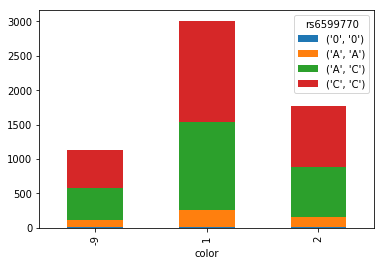

rs12440100


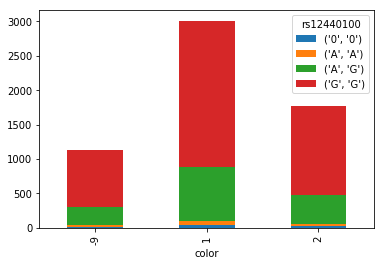

rs12906138


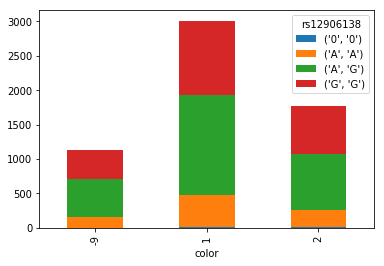

rs7179358


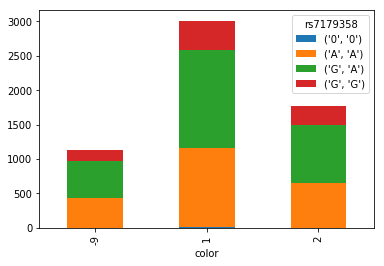

kgp6444009


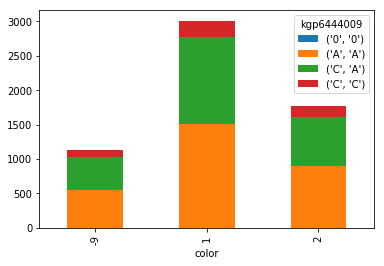

rs4932078


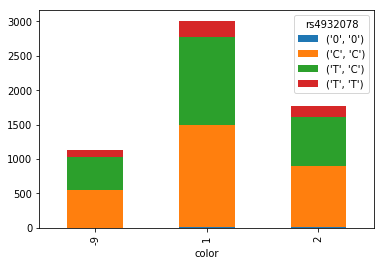

exm1140790


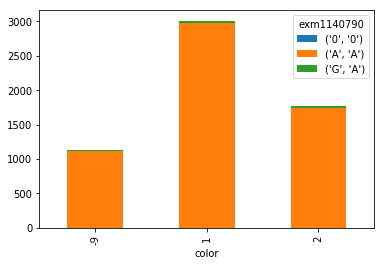

indel.34204


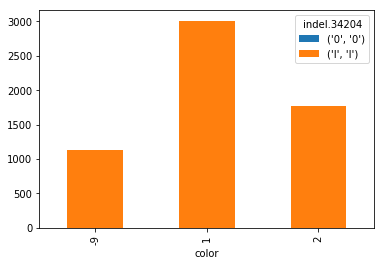

exm1140799


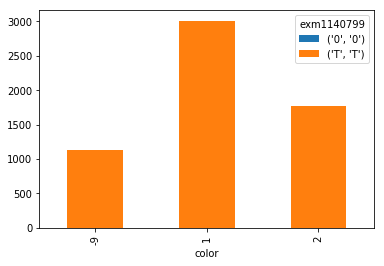

exm1824992


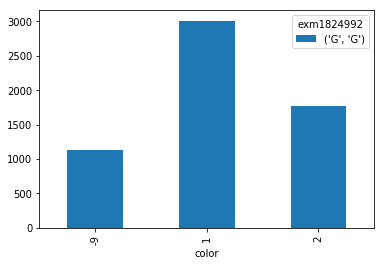

exm1140818


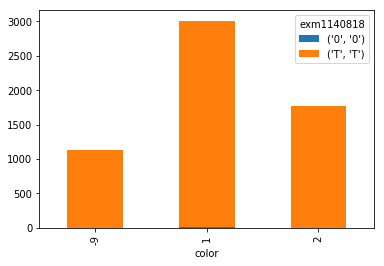

exm1140821


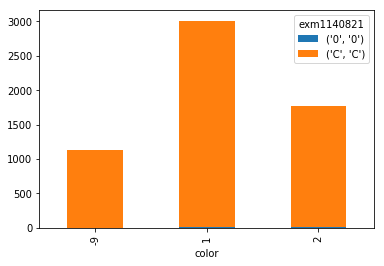

exm1824994


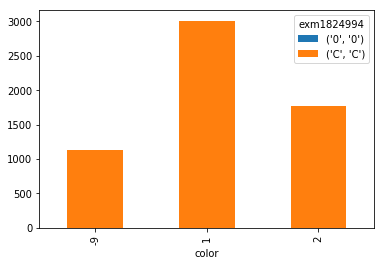

exm1140825


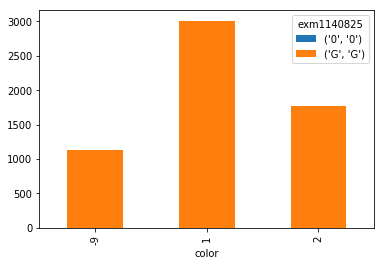

exm1140829


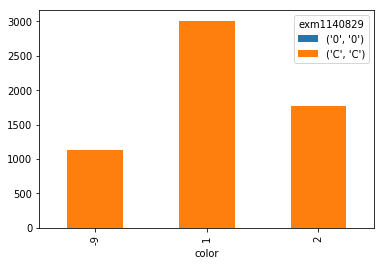

exm1140833


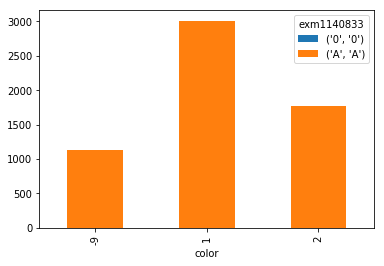

exm1140862


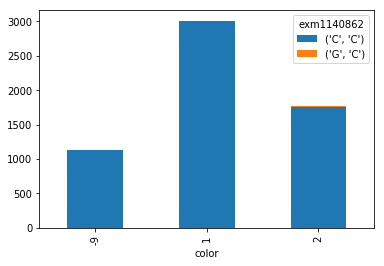

exm1140871


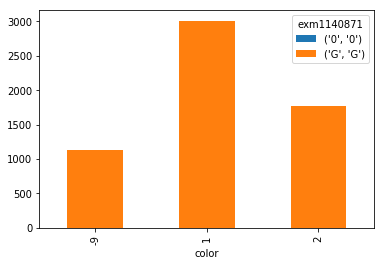

exm1140928


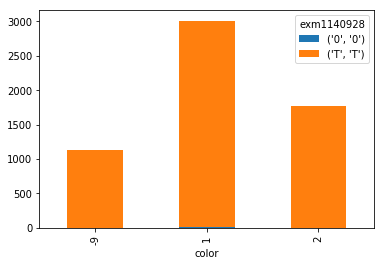

exm1140954


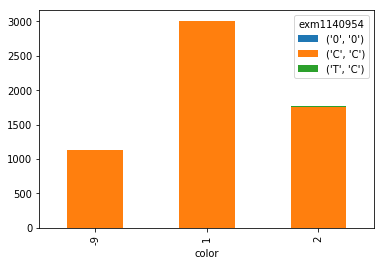

exm1140961


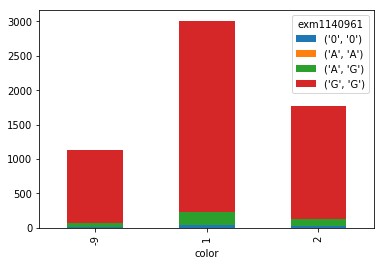

exm1140965


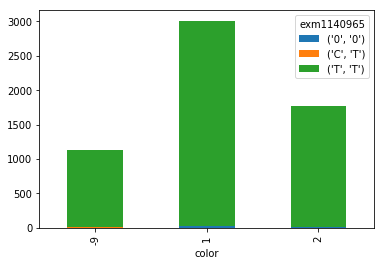

exm1140966


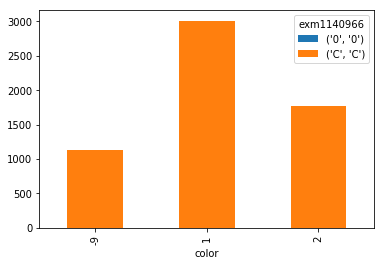

newrs139137715


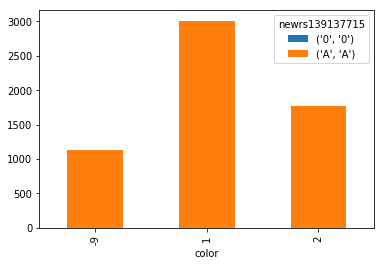

kgp11825057


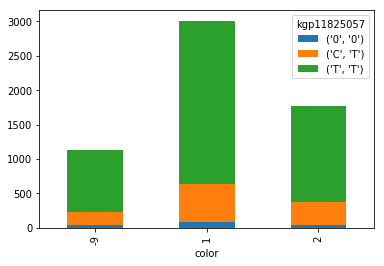

rs4462663


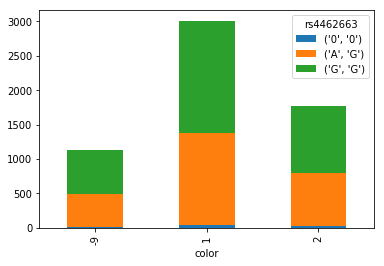

kgp1549400


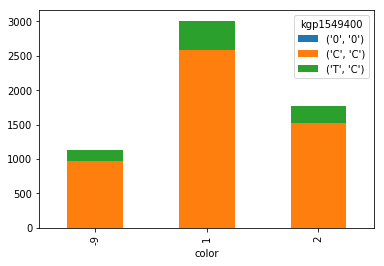

rs7402159


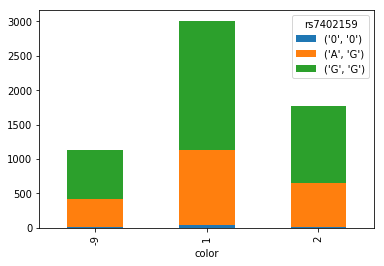

rs4932679


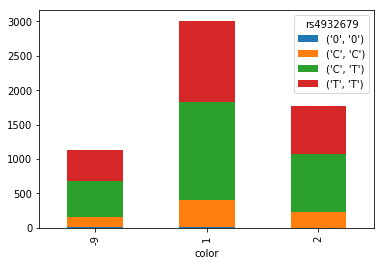

rs6606788


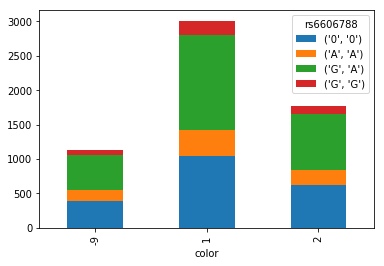

rs12900257


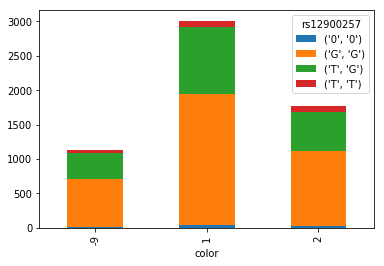

rs12102024


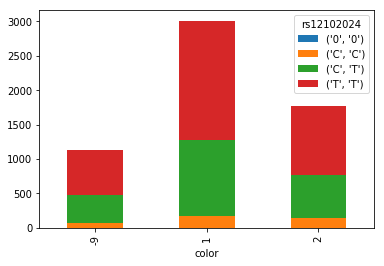

rs11486384


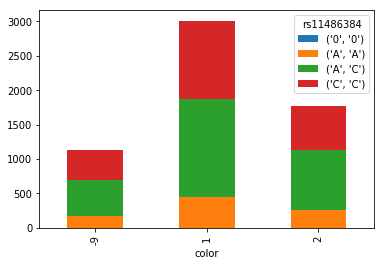

exm2264555


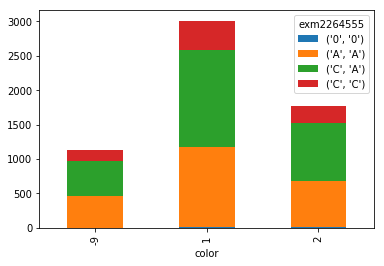

exm1141104


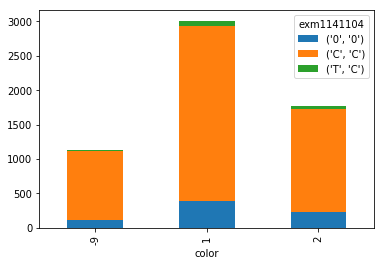

exm1141110


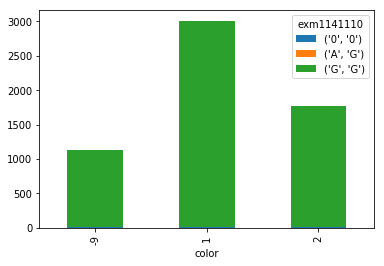

rs8029154


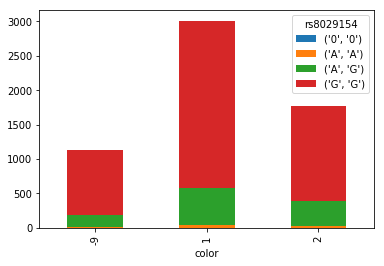

exm1141114


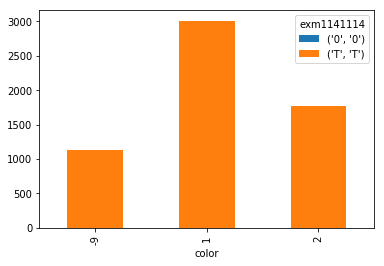

exm1141115


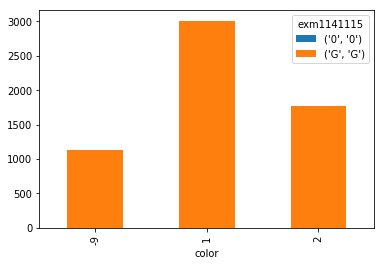

indel.34217


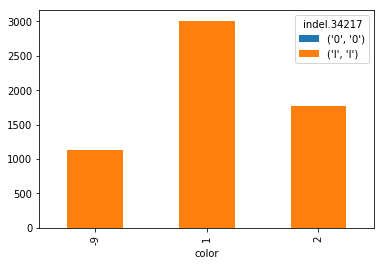

exm1141135


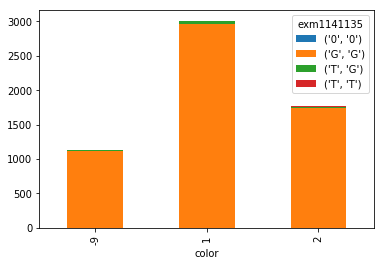

exm1141138


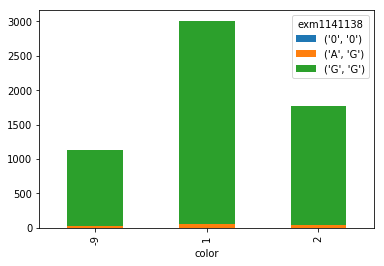

exm1141140


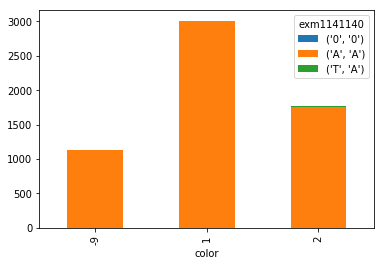

variant.34220


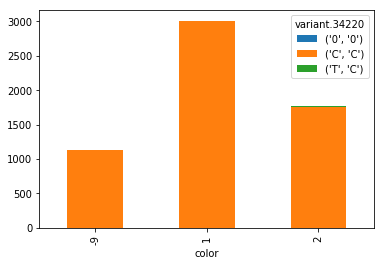

variant.34221


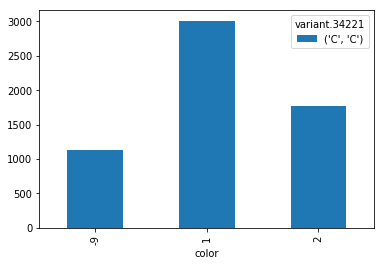

variant.34222


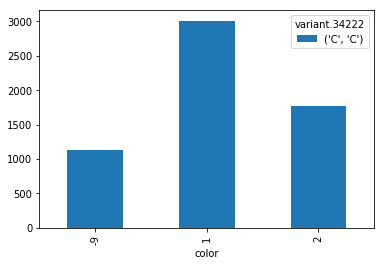

exm1141154


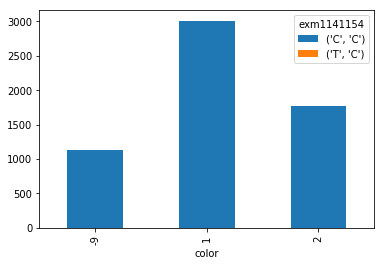

exm1141156


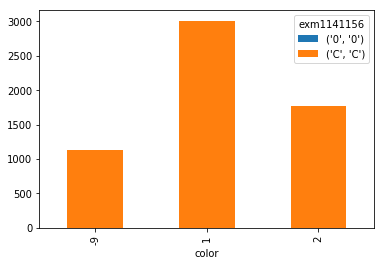

indel.34223


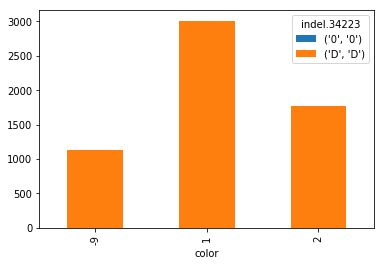

exm1141160


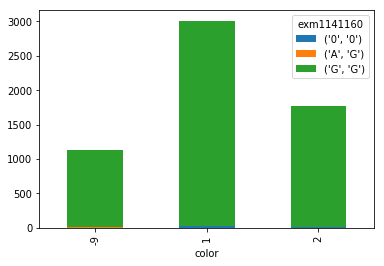

exm1141165


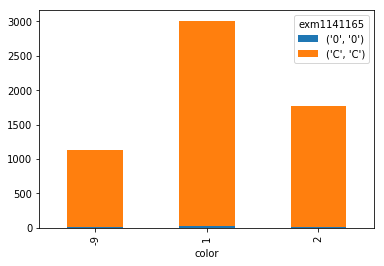

exm1825127


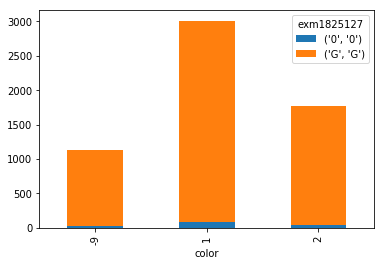

indel.34227


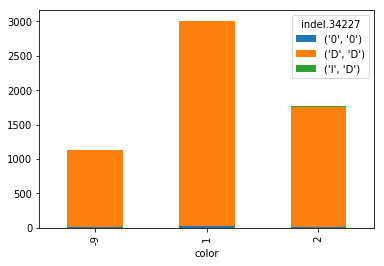

exm1141179


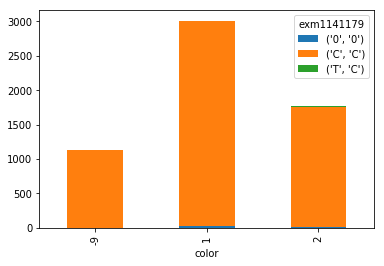

exm1141188


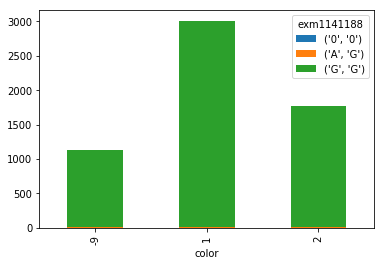

rs17137283


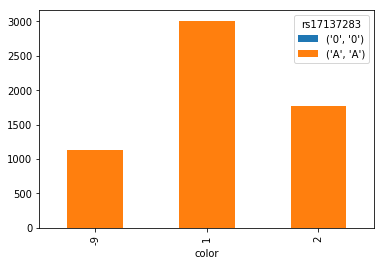

newrs146368727


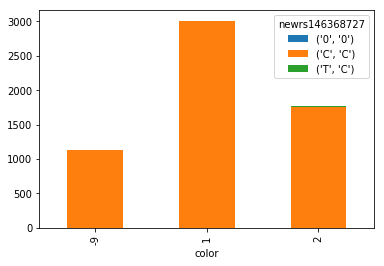

exm1141198


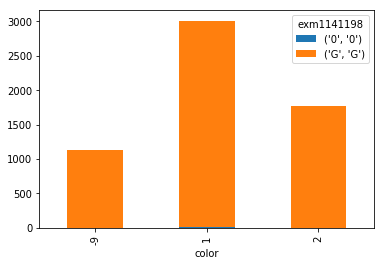

rs11632888


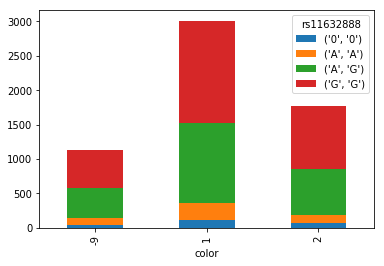

exm1141204


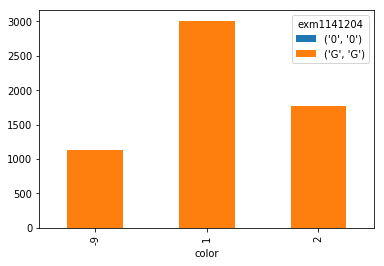

exm1141205


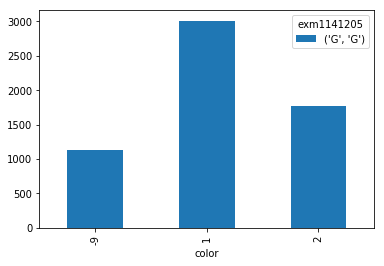

exm1141207


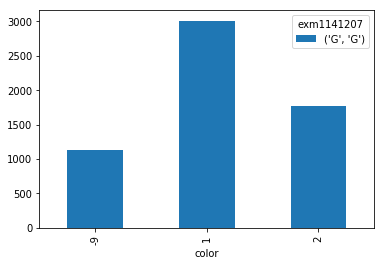

rs3812921


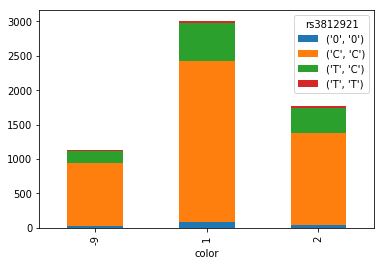

variant.34233


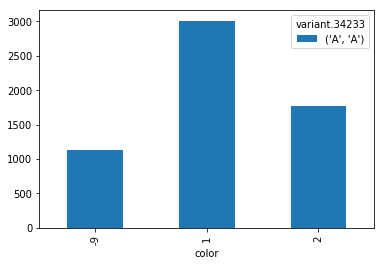

rs17137279


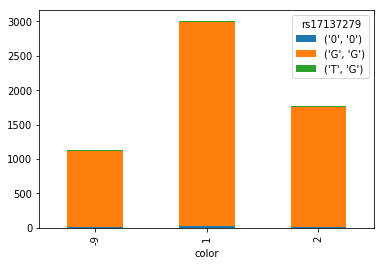

rs2289815


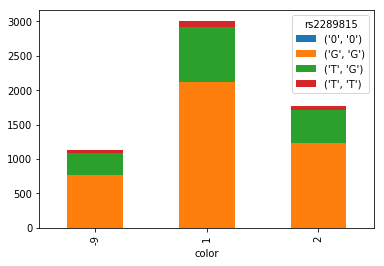

newrs145285758


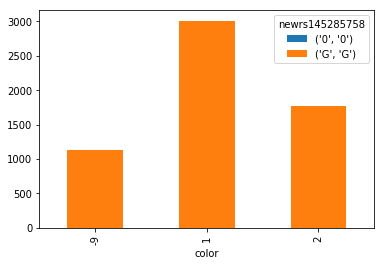

exm1141217


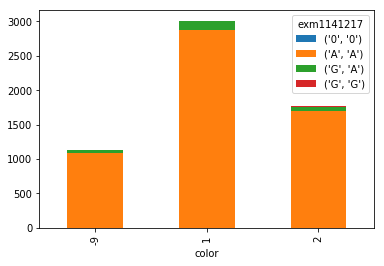

variant.34235


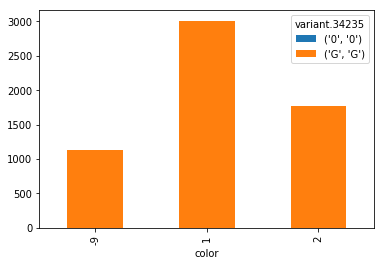

rs765763


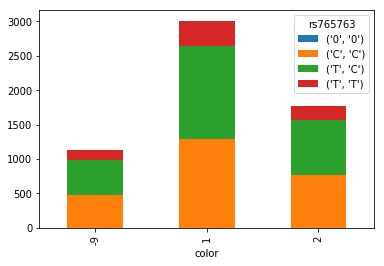

rs8029320


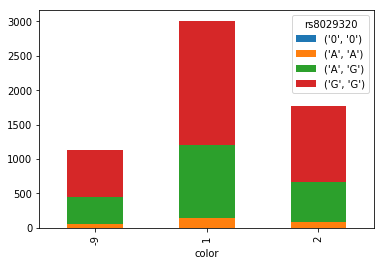

rs11853131


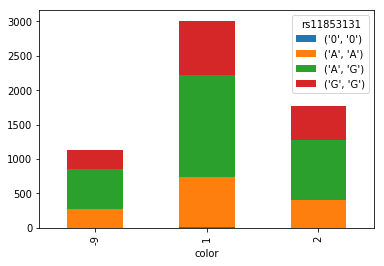

rs11632180


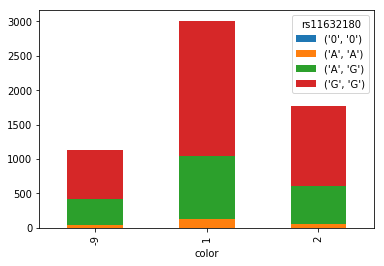

rs7171787


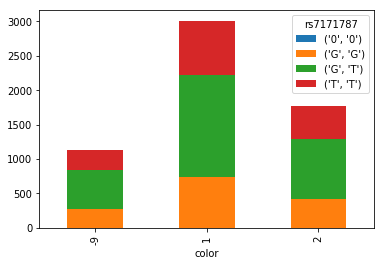

rs722410


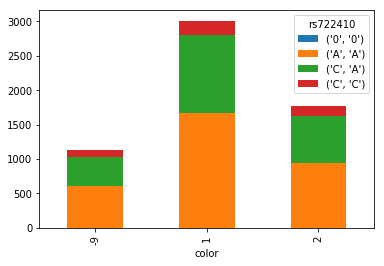

rs17841096


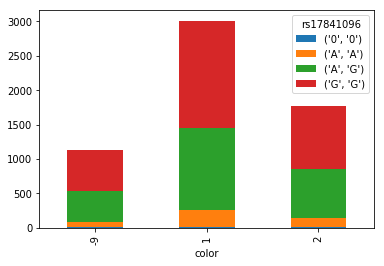

rs11634023


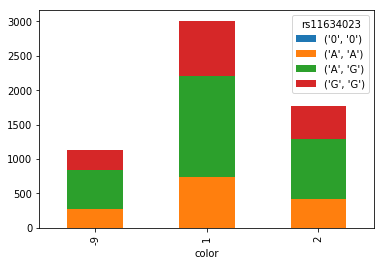

rs2289823


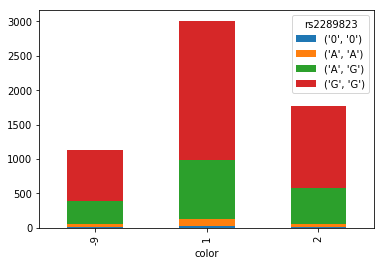

exm1141255


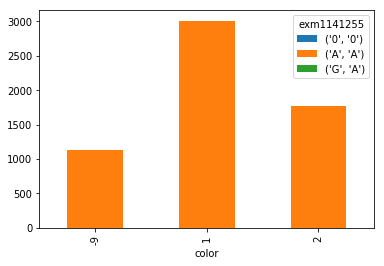

exm1141256


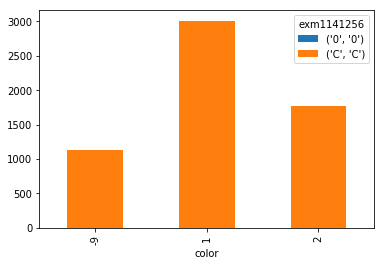

exm1141281


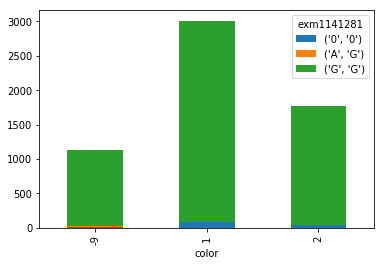

rs8029108


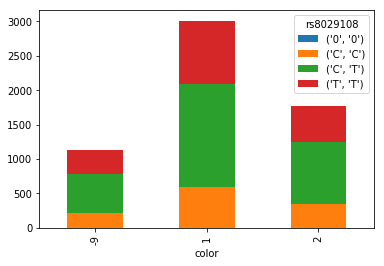

exm1141287


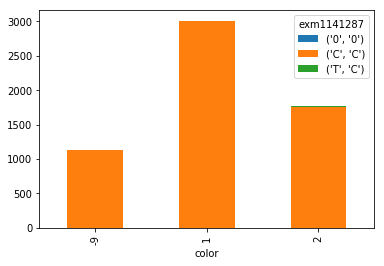

rs4778298


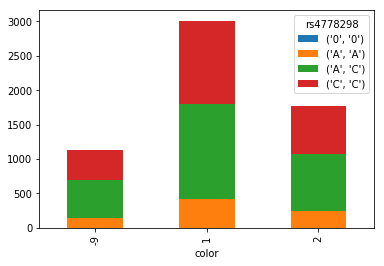

exm1141295


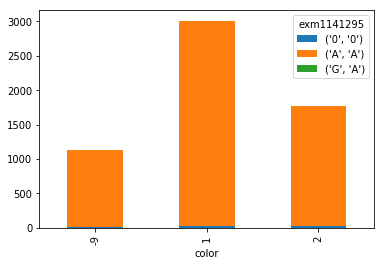

exm1141304


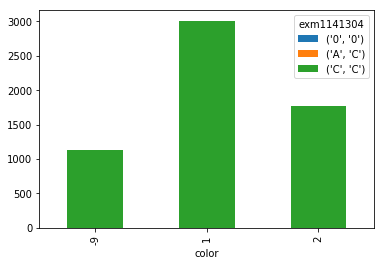

exm1141320


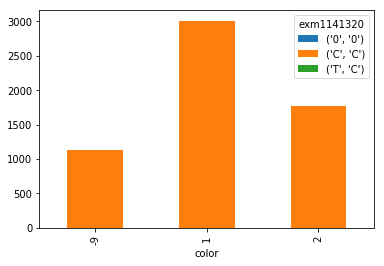

rs4134803


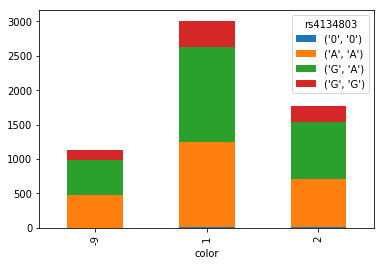

exm1825219


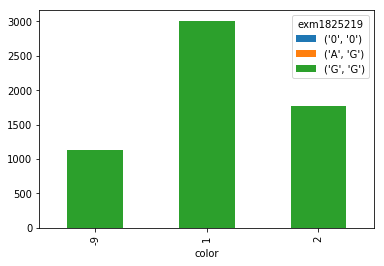

rs2289819


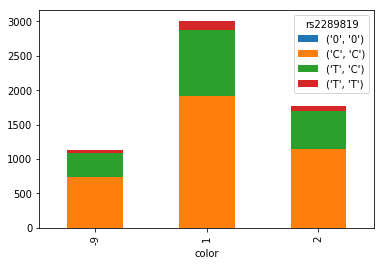

exm1141358


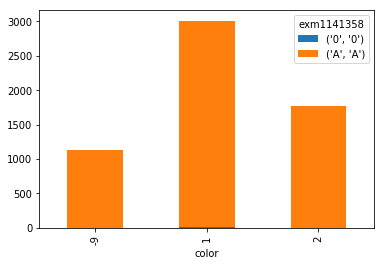

exm1141359


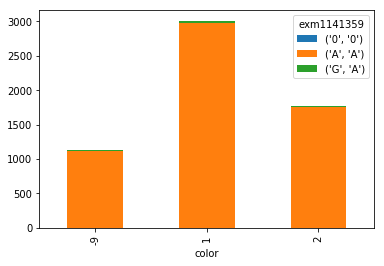

rs7174982


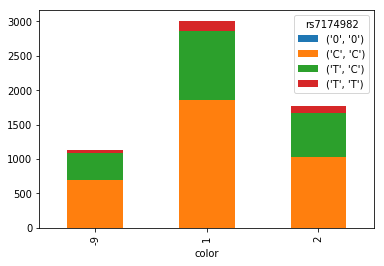

rs6606813


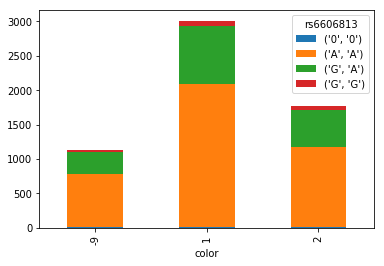

exm1141363


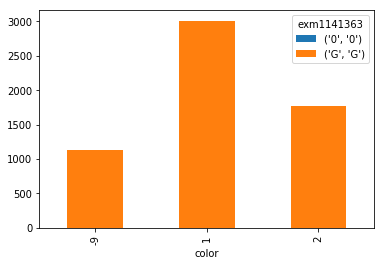

exm1141368


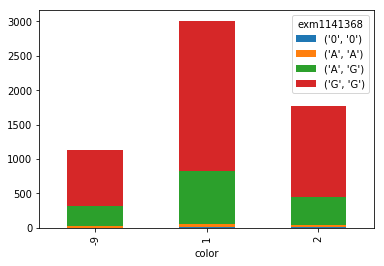

exm1141369


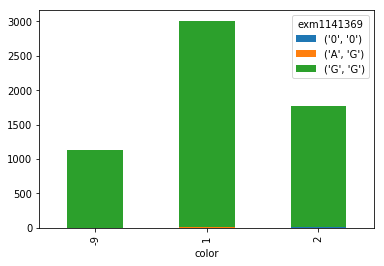

exm1141370


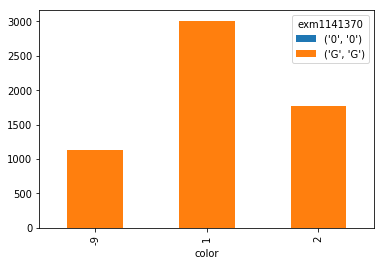

rs17841095


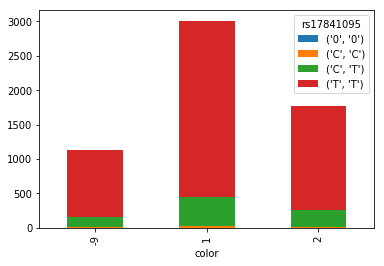

variant.34238


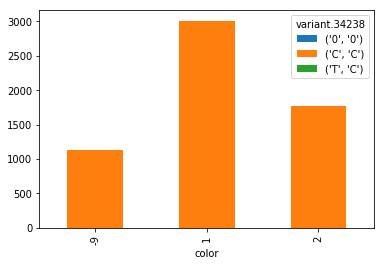

exm1141380


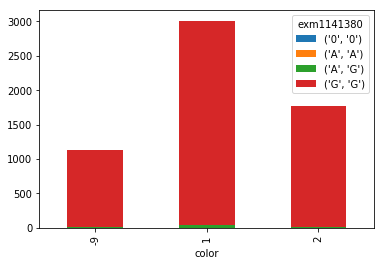

exm1141386


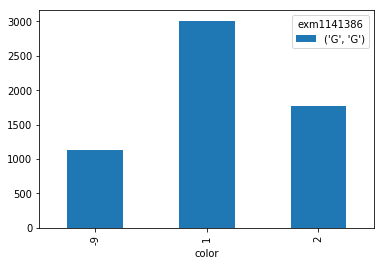

rs2068655


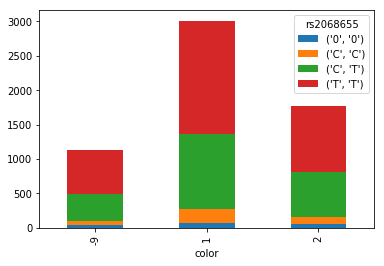

exm1141388


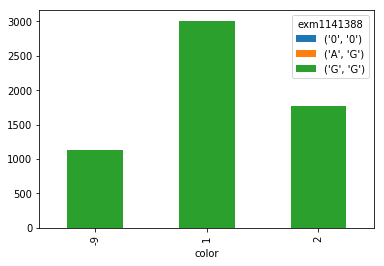

exm1141399


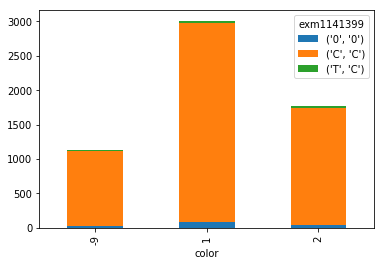

rs7182576


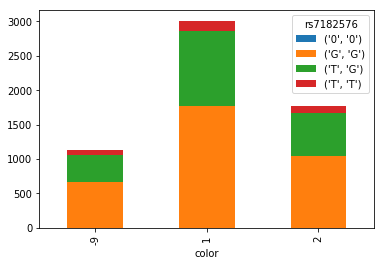

exm1141416


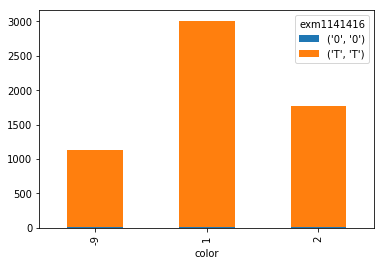

exm1141424


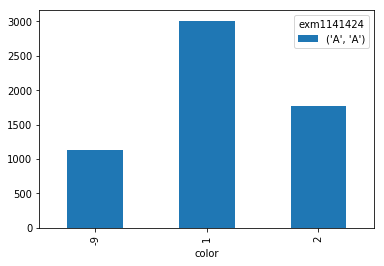

exm1141425


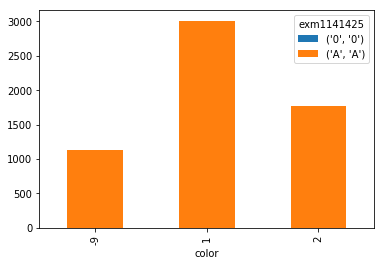

rs10519332


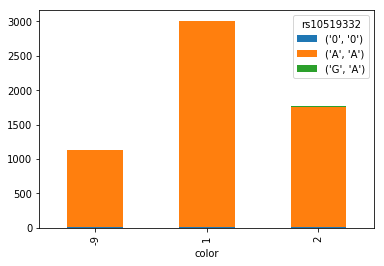

rs3693


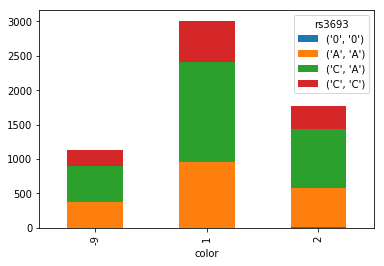

exm1141448


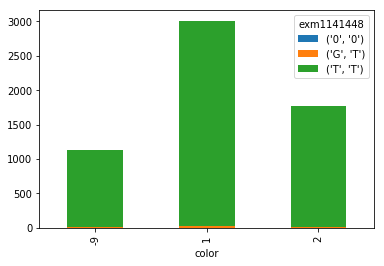

exm1141452


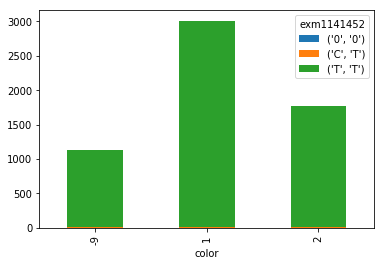

exm1141472


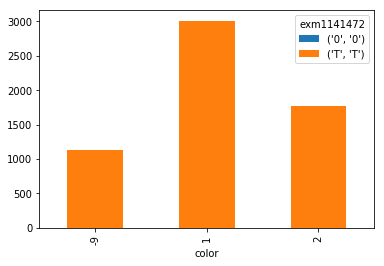

exm1141473


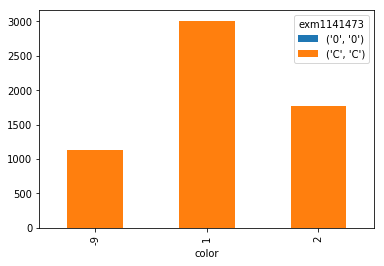

rs7168000


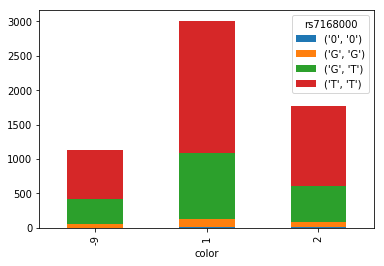

exm1141490


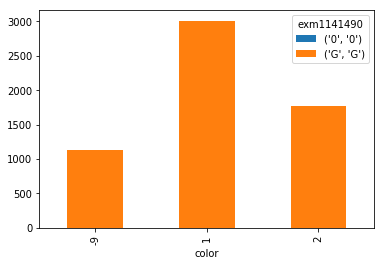

exm1141491


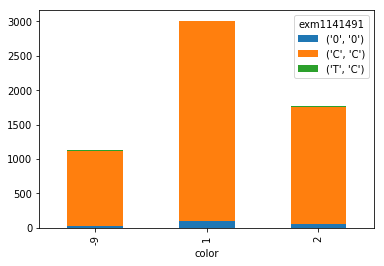

rs7170784


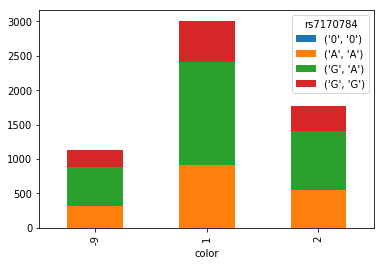

rs4592619


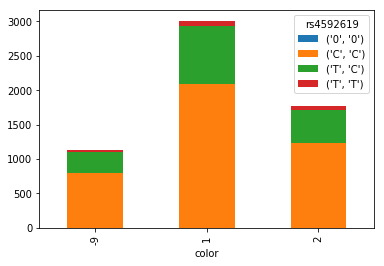

exm2267749


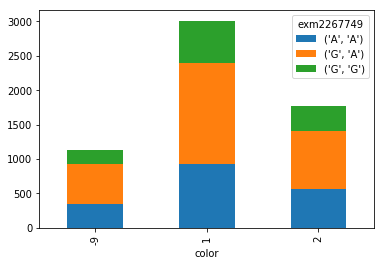

rs7179251


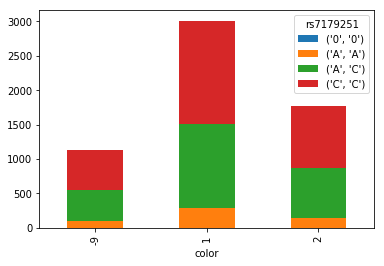

rs11263683


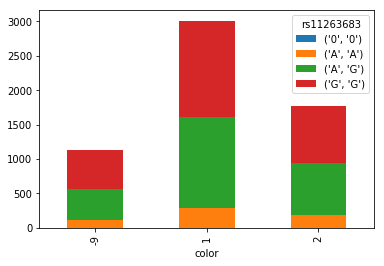

rs4778575


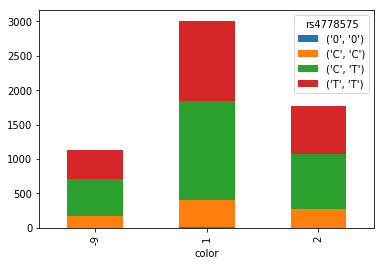

exm2252065


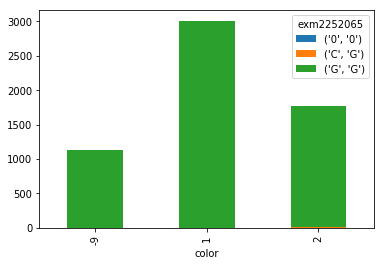

exm1141526


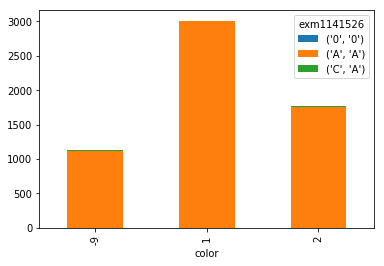

rs7168367


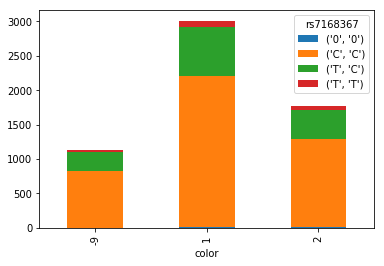

exm2267816


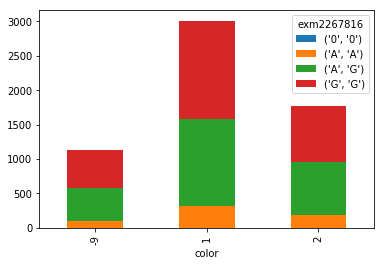

rs7174119


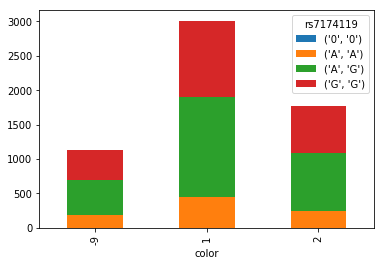

rs11263687


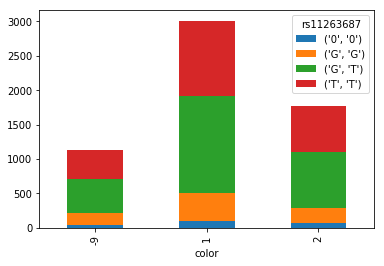

rs10152278


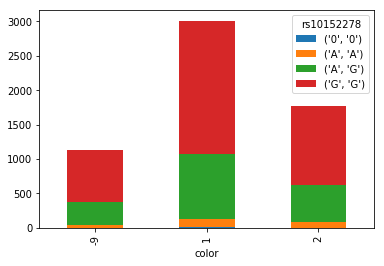

rs4778307


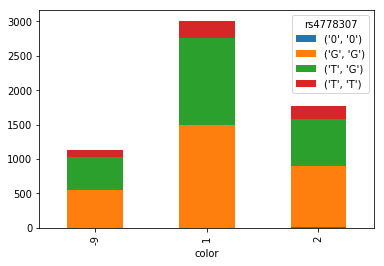

rs8033142


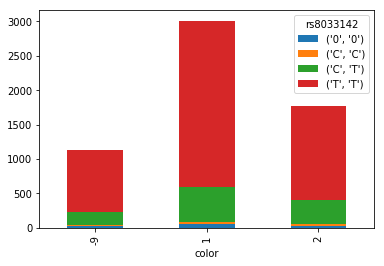

rs2881013


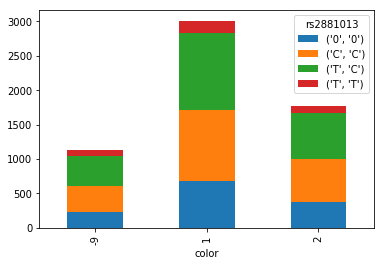

rs3883043


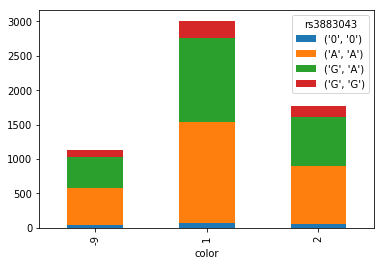

kgp5633336


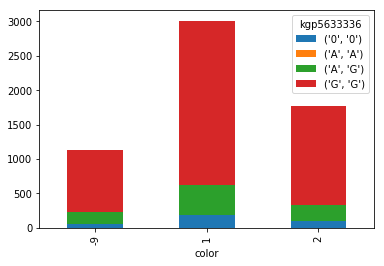

kgp785555


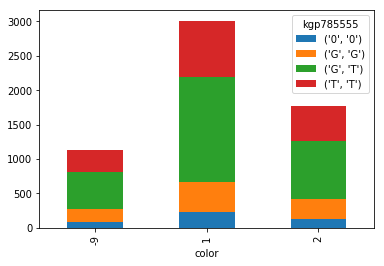

rs1814766


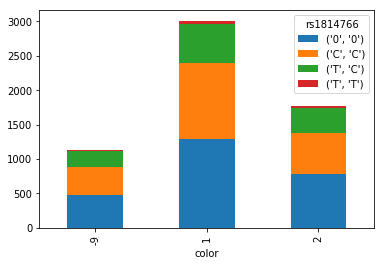

rs17118628


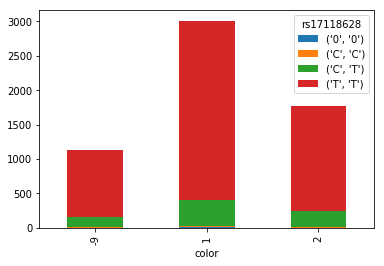

rs2345408


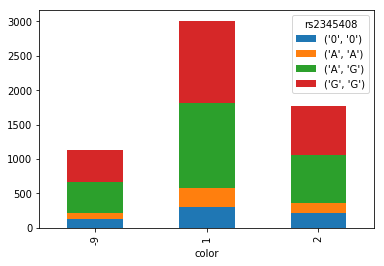

exm2267750


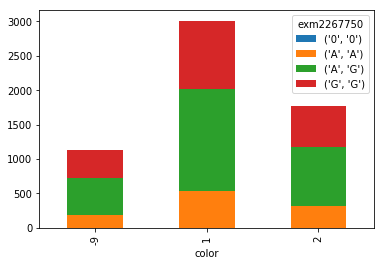

rs1526175


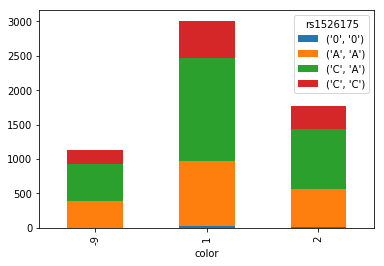

rs4267282


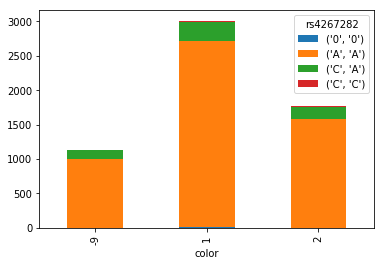

rs8024108


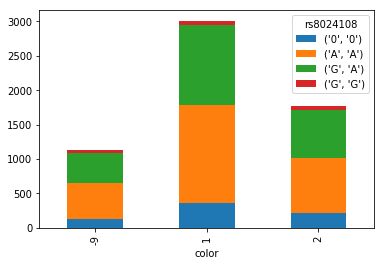

rs1608962


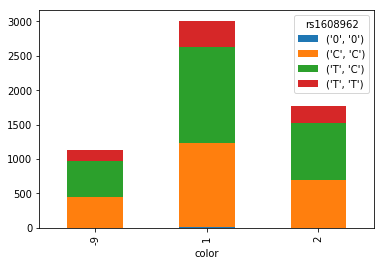

rs7174702


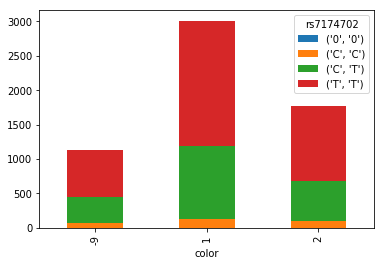

rs8034585


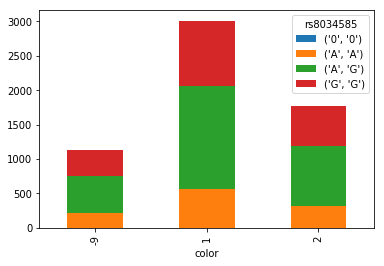

rs7164717


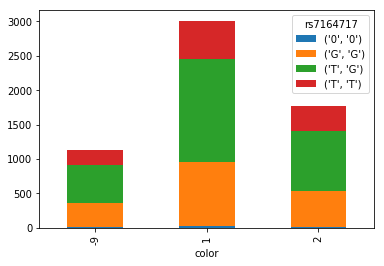

rs11638266


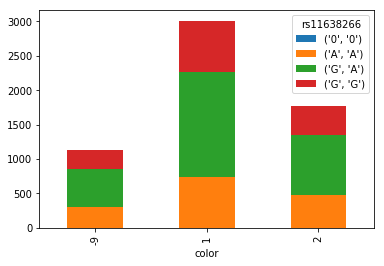

exm2260406


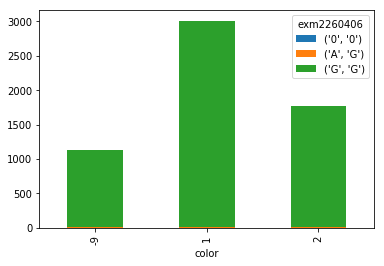

rs12440458


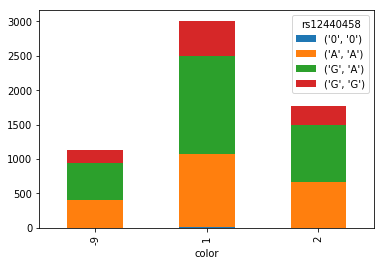

rs7179053


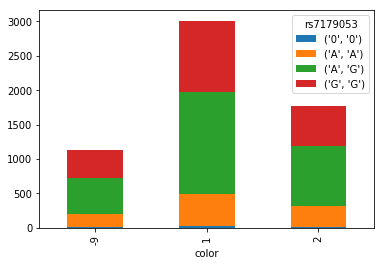

rs12441827


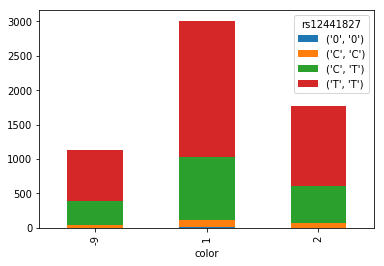

exm1141621


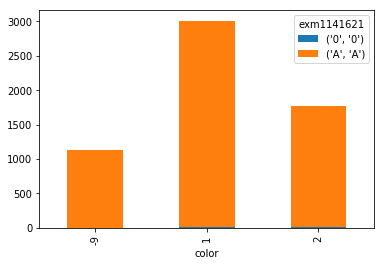

exm1141639


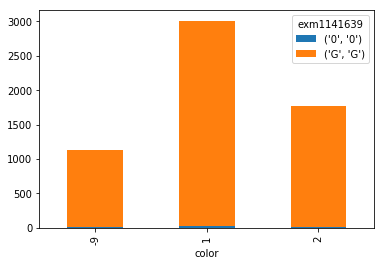

rs2239669


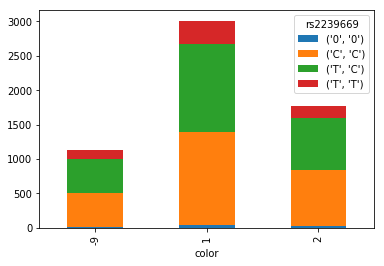

exm1825352


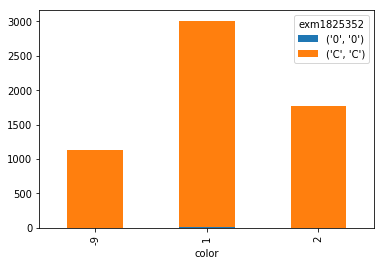

exm1141657


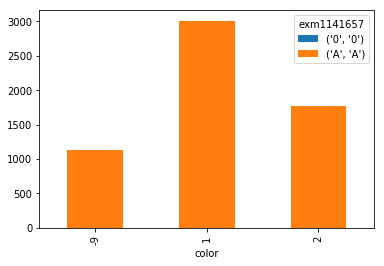

exm1141661


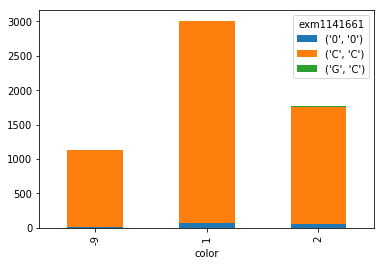

exm1141669


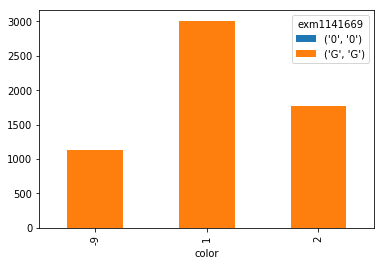

var_15_23812132


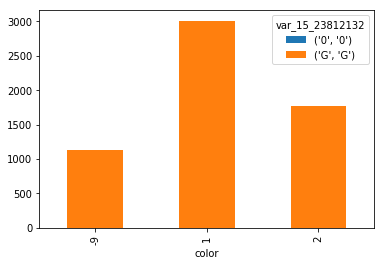

indel.34245


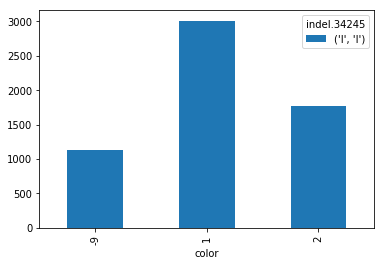

exm1141684


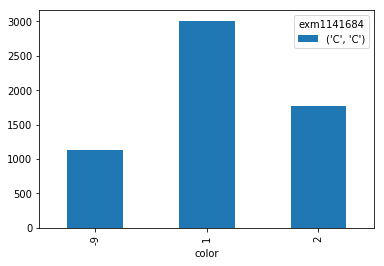

newrs138976716


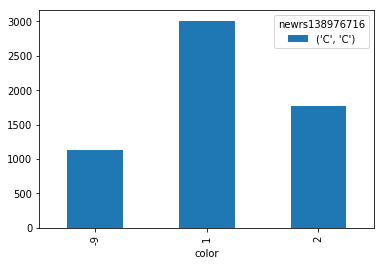

exm1141691


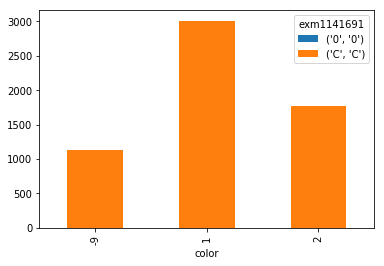

rs6576483


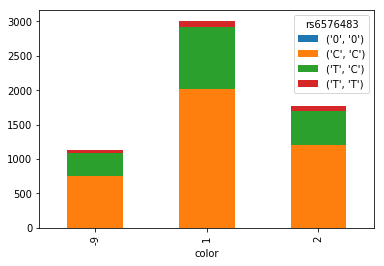

rs6576525


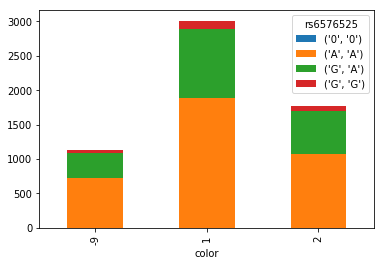

rs7495455


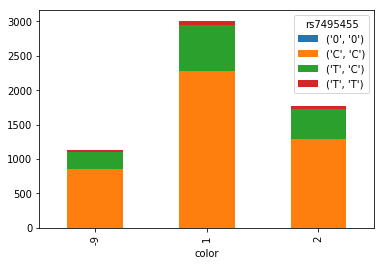

rs7181128


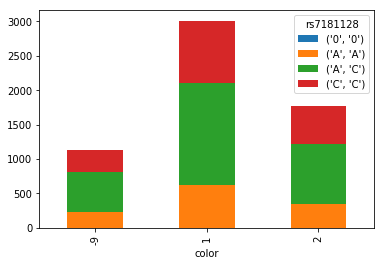

rs4480754


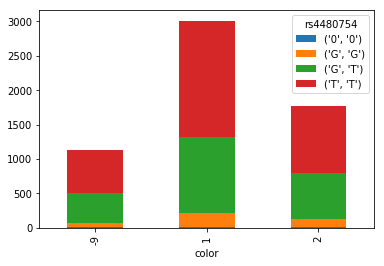

rs9785


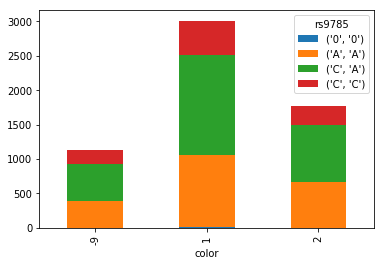

exm1141696


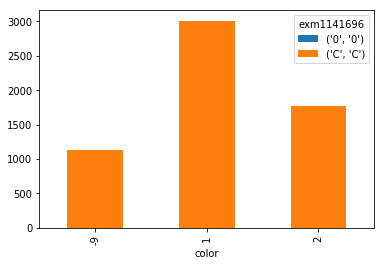

exm1141701


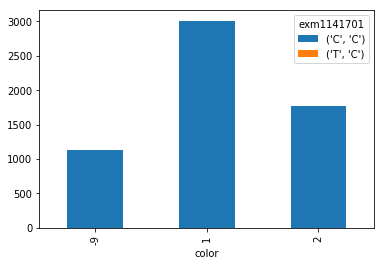

exm1141708


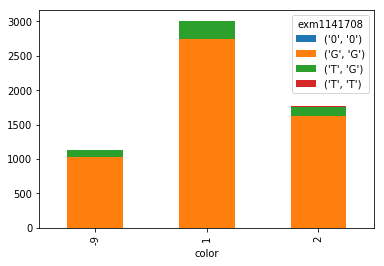

exm1141712


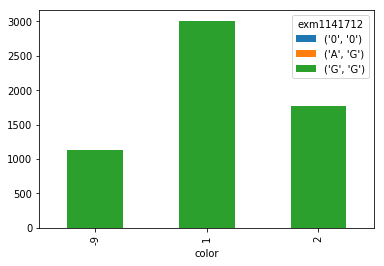

exm1141714


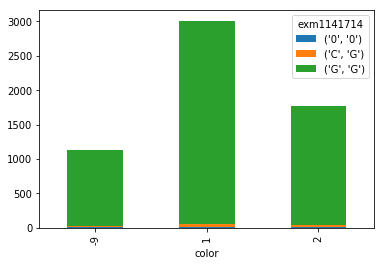

exm1141734


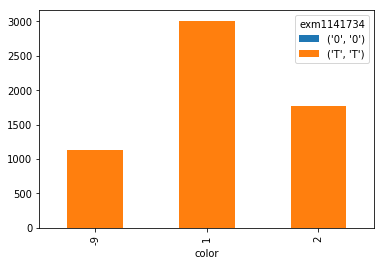

exm1141736


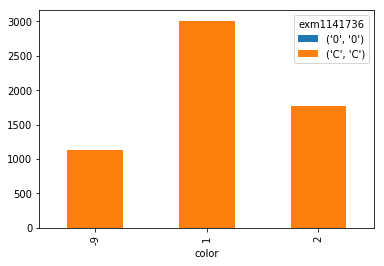

exm1141741


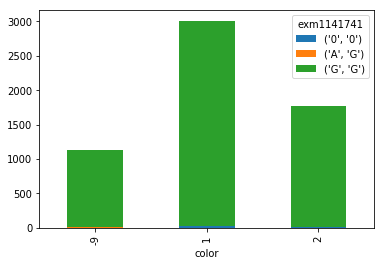

exm1141743


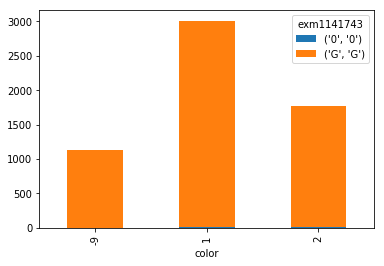

exm1141744


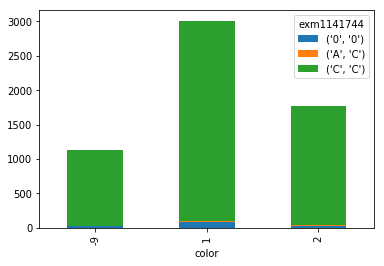

exm1141753


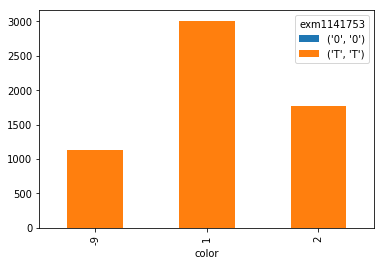

exm1141758


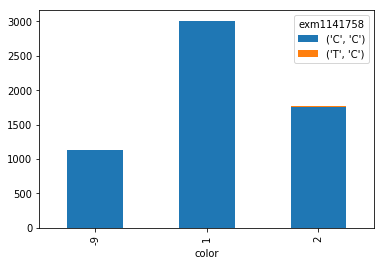

exm1141759


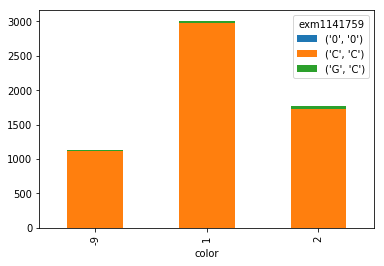

exm1141765


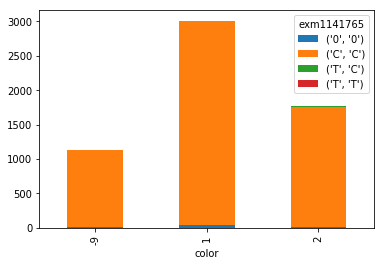

exm1141784


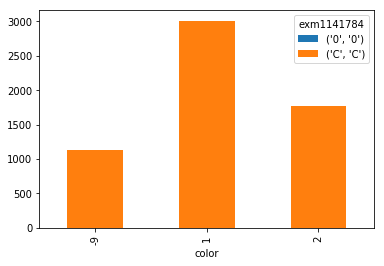

exm1141785


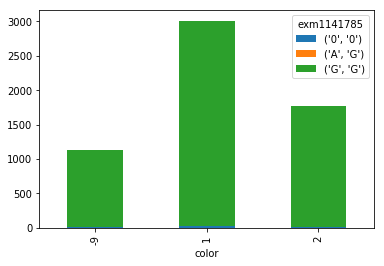

exm2223080


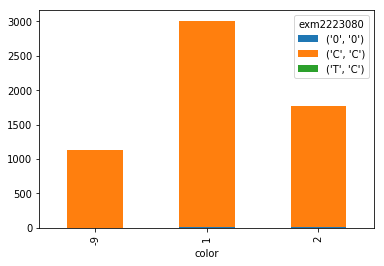

exm1141800


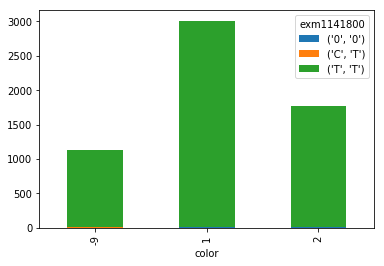

rs850817


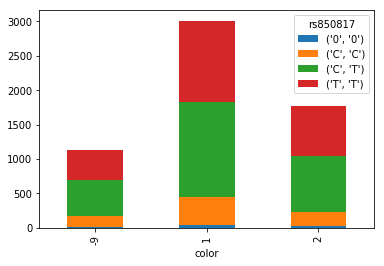

rs850813


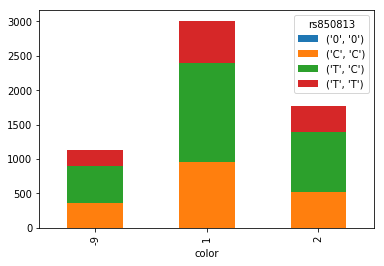

rs17116771


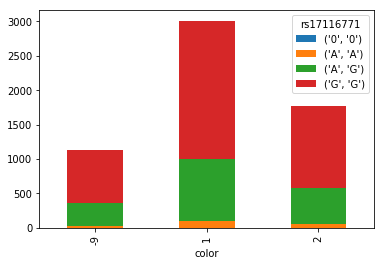

rs10519442


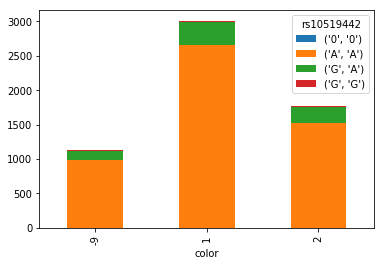

rs7163927


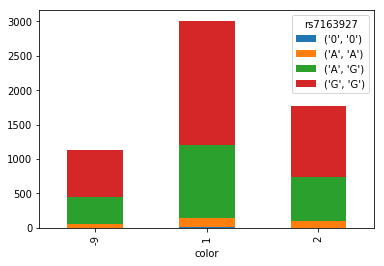

rs699328


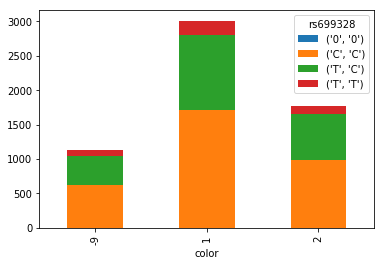

exm1141813


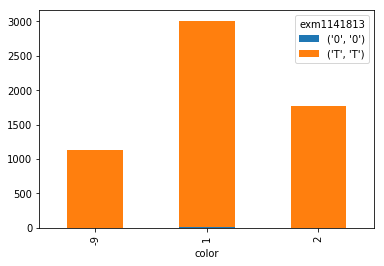

indel.34248


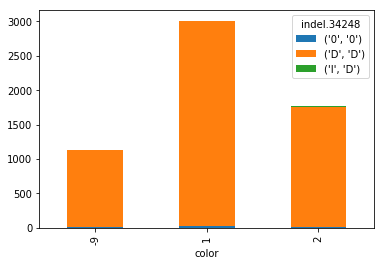

rs28706770


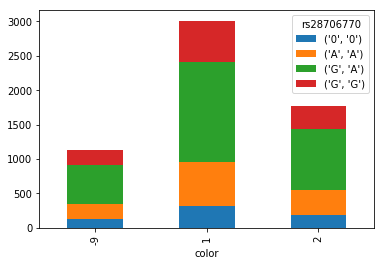

rs1722793


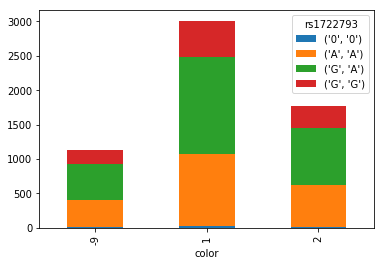

rs1722791


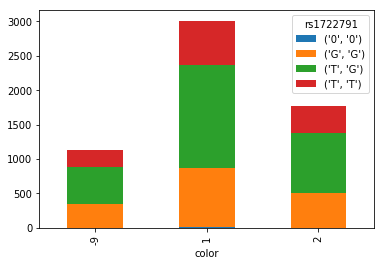

rs8025564


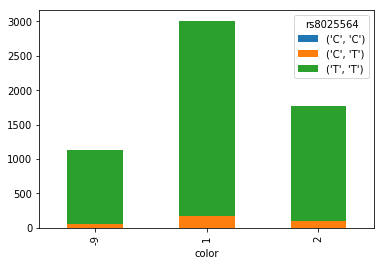

rs12903451


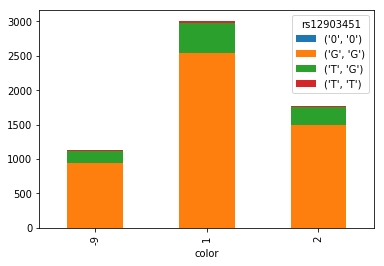

rs12164906


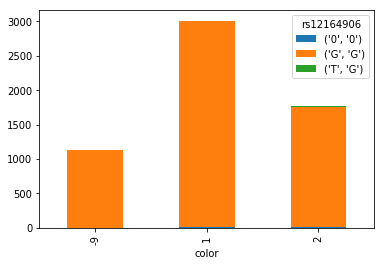

rs1628195


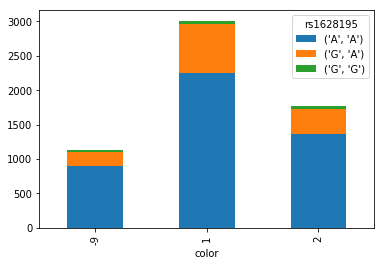

rs824192


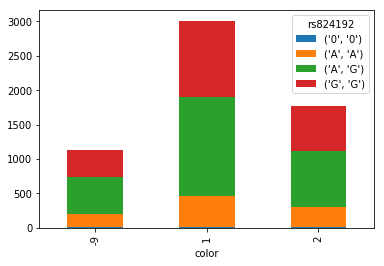

rs8182040


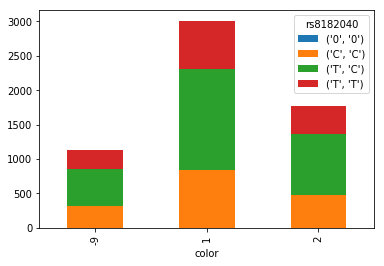

rs4624124


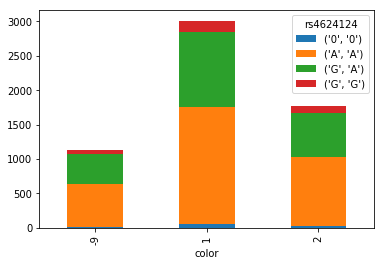

rs1717831


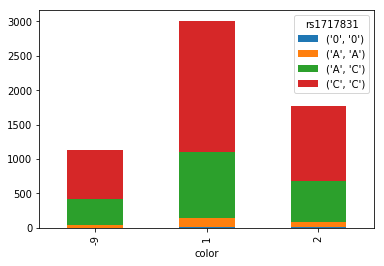

rs940595


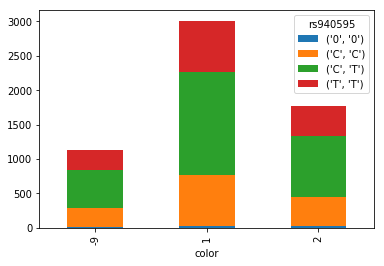

rs824209


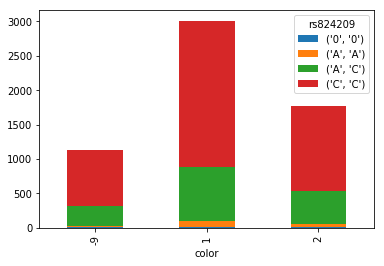

rs824167


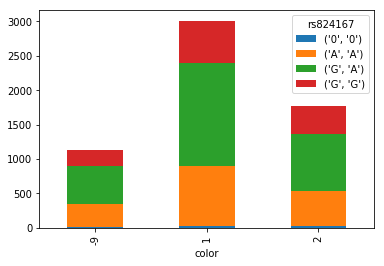

rs1402843


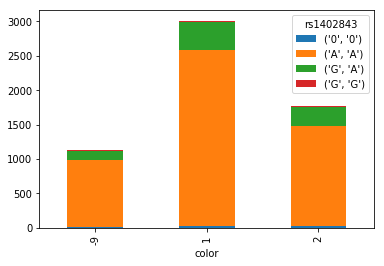

rs8031166


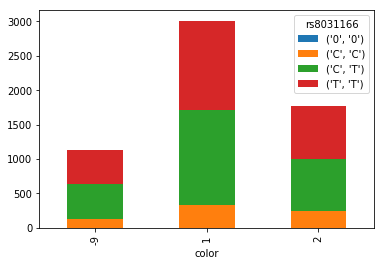

rs4778340


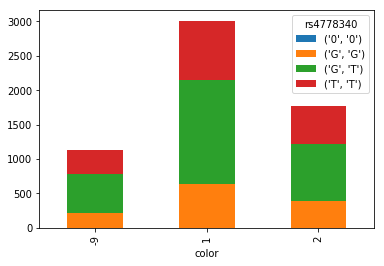

rs17117614


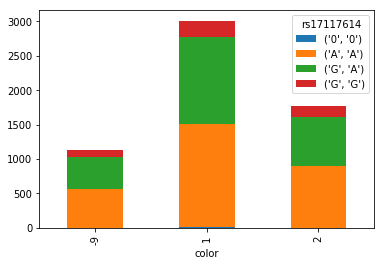

rs11161353


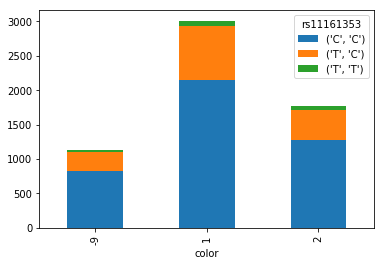

rs10519445


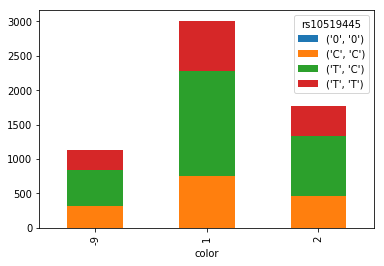

rs1459985


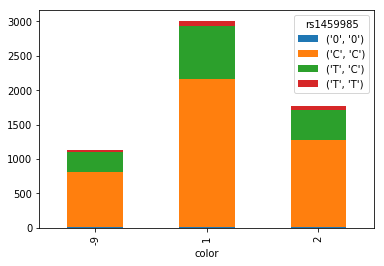

rs8037816


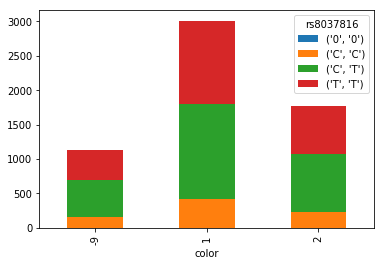

rs1002907


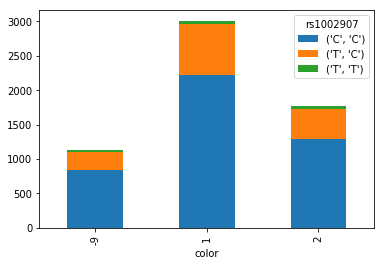

rs12591922


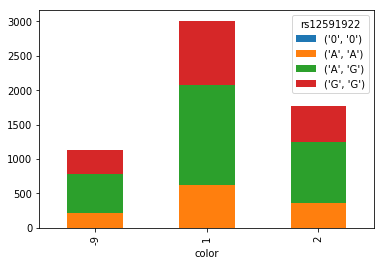

rs6576648


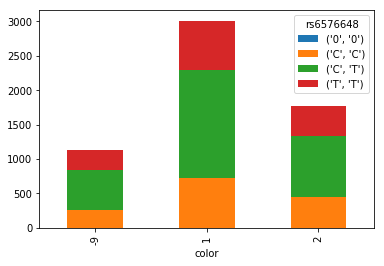

rs12437706


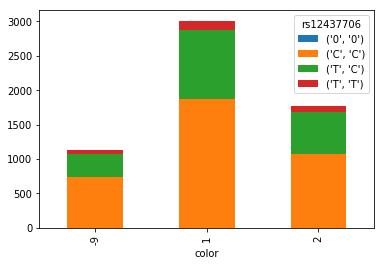

rs2353498


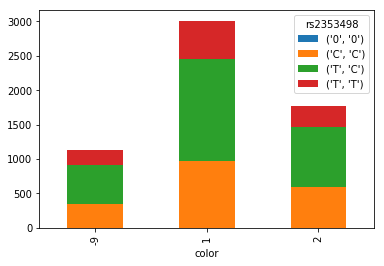

rs12148769


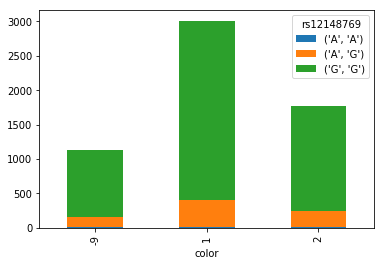

exm2267751


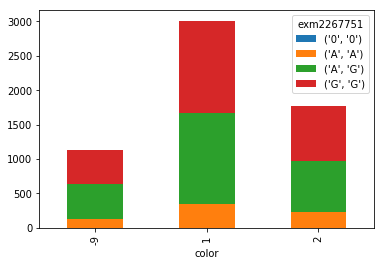

rs11635083


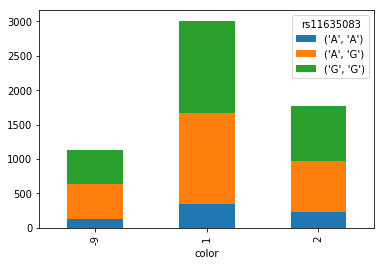

rs12899677


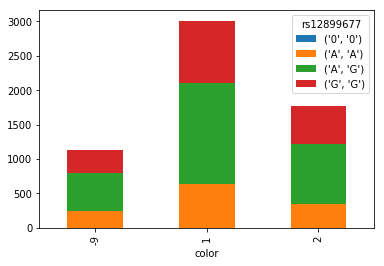

rs12915222


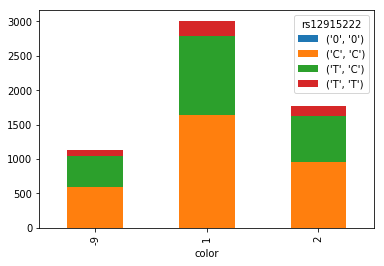

rs2353505


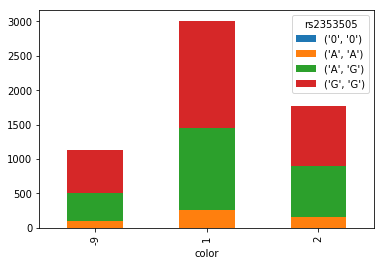

rs898368


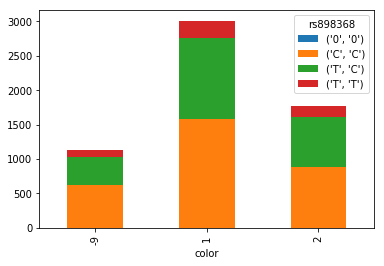

rs4778264


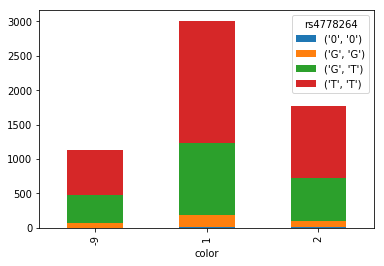

rs8041086


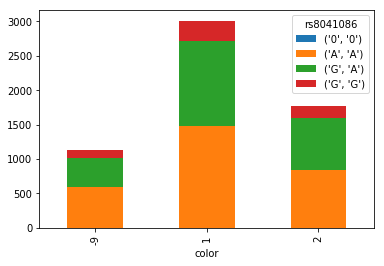

rs12906805


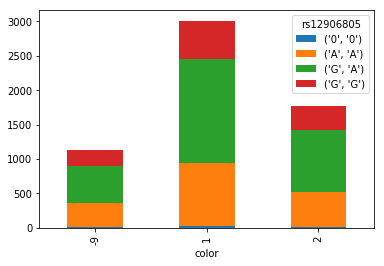

rs11161367


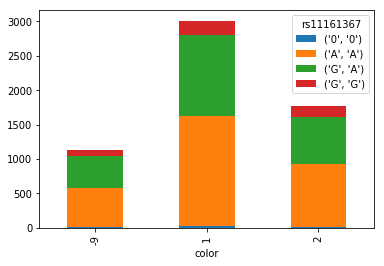

rs7176869


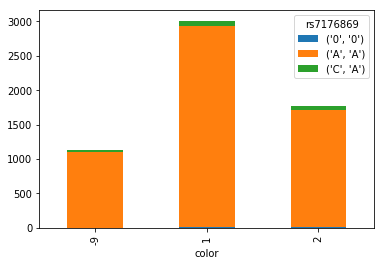

rs2353499


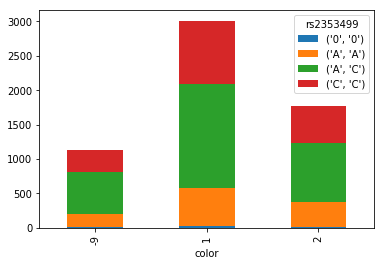

rs12916493


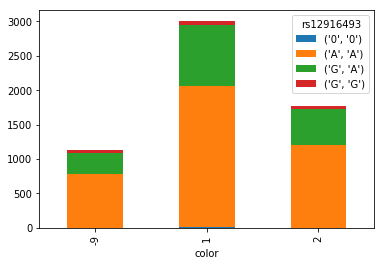

rs4778368


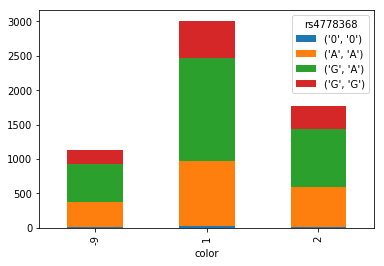

rs12916663


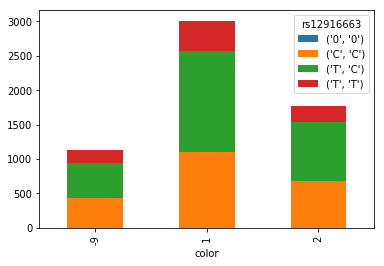

rs12148138


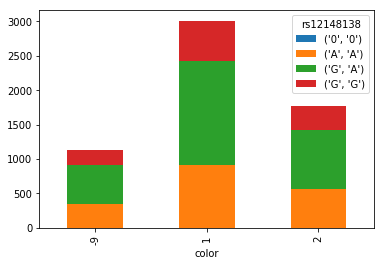

rs11854250


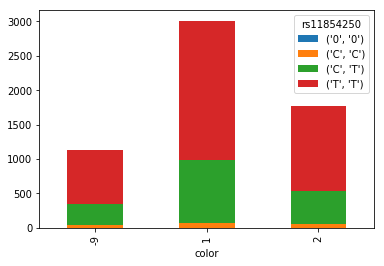

rs4778272


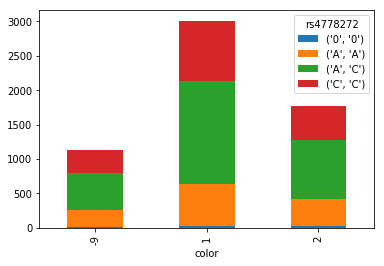

rs4555114


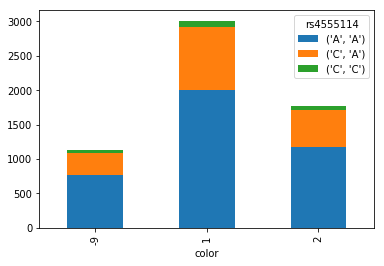

rs11639152


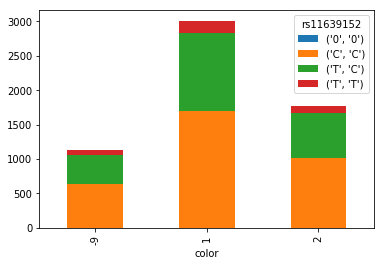

rs12914535


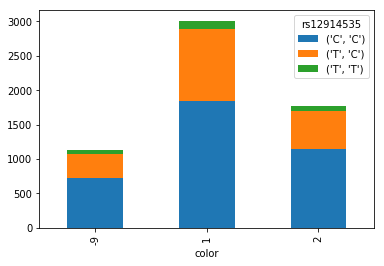

rs10873649


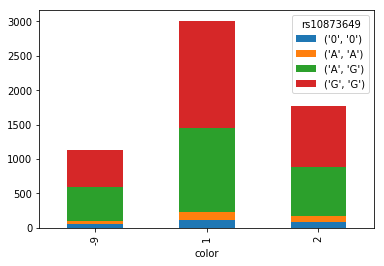

rs1563817


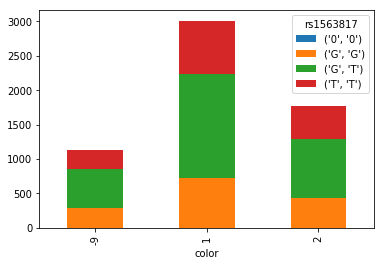

rs936443


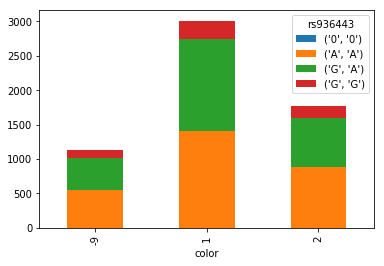

rs8026512


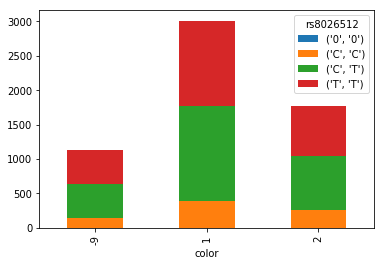

rs12442070


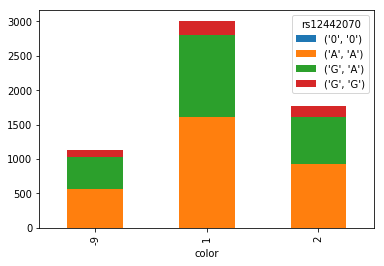

rs1459977


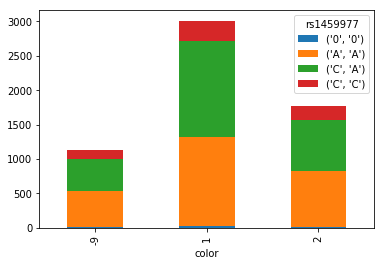

rs387171


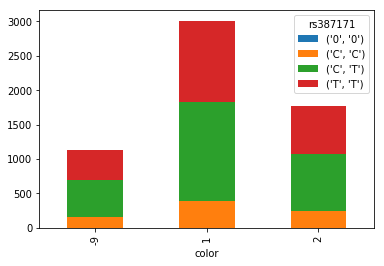

rs7179664


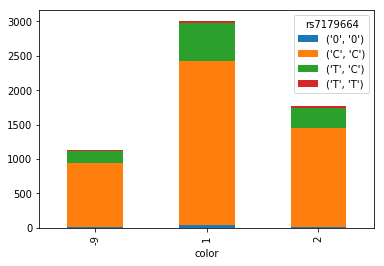

rs2354040


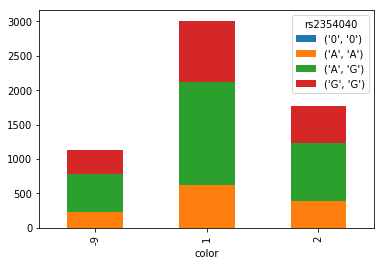

rs11161396


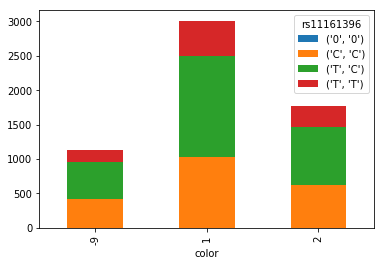

rs11161397


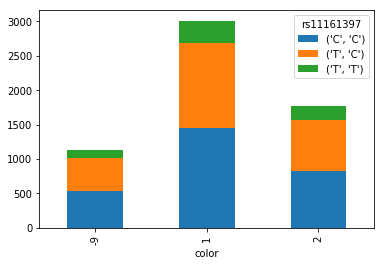

rs1850477


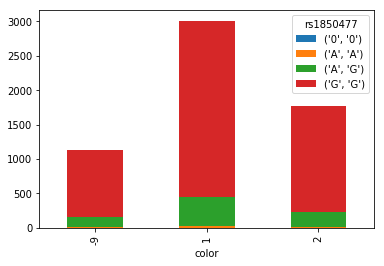

rs11856821


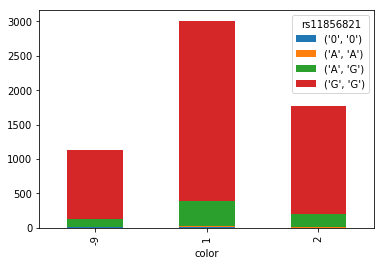

rs11632280


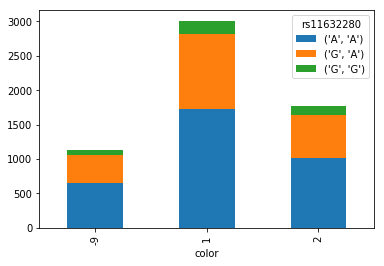

rs4778389


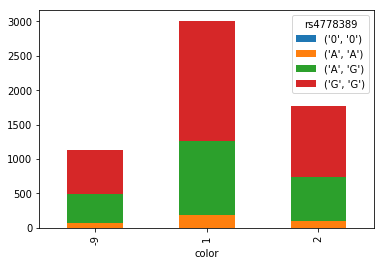

rs12906657


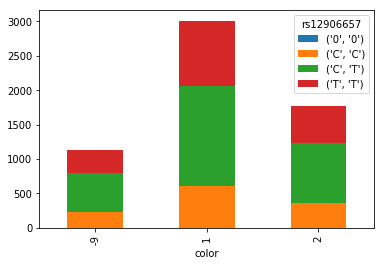

rs12902333


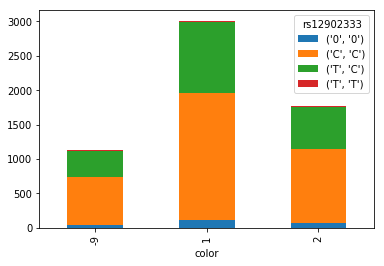

rs12898923


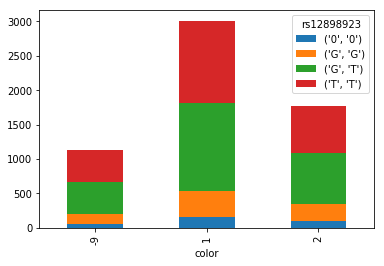

rs1110961


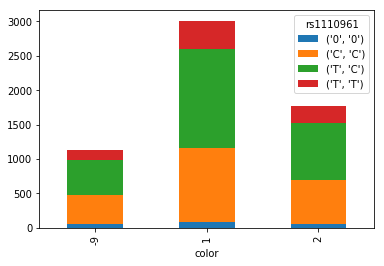

rs11629740


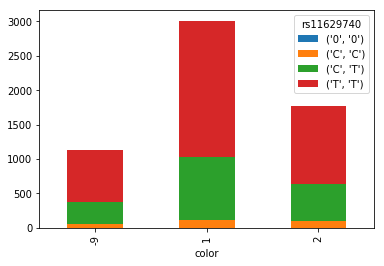

rs4778410


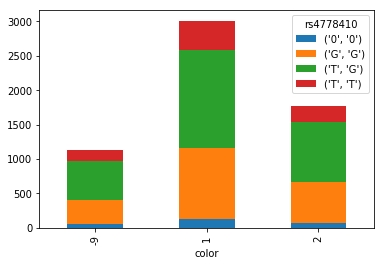

rs17118244


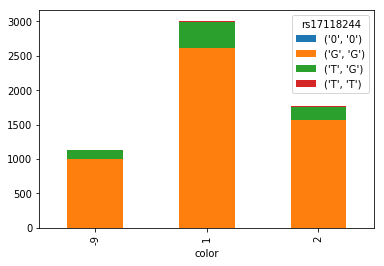

rs1850475


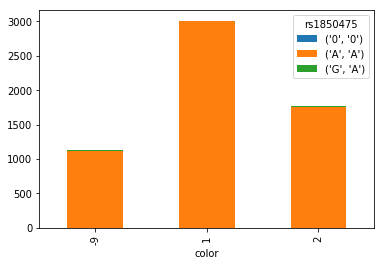

rs8040374


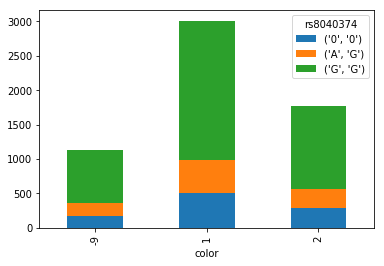

rs1878504


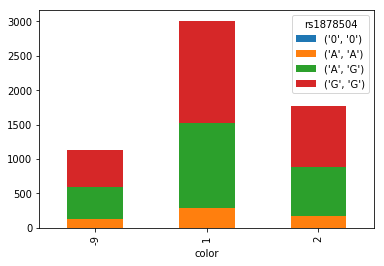

rs12441672


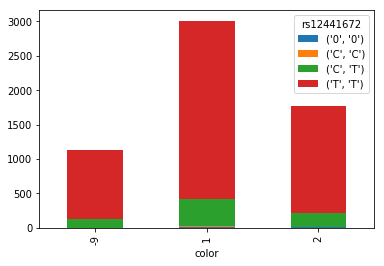

rs4778426


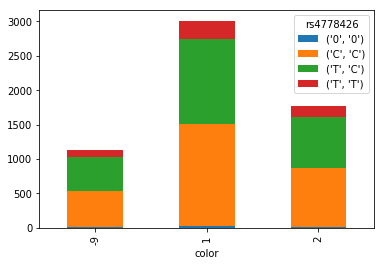

rs4778437


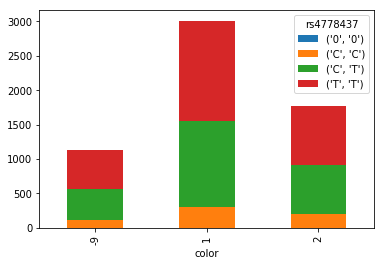

rs2011170


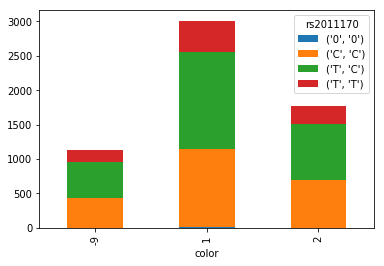

rs12161938


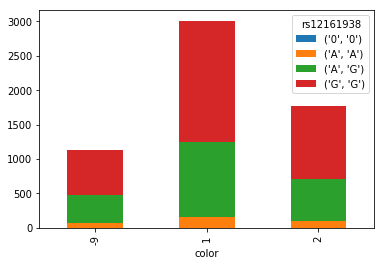

kgp3169207


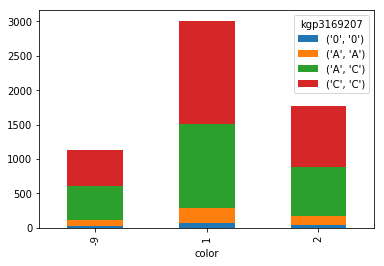

rs9652534


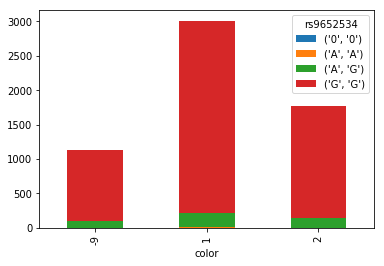

rs1532517


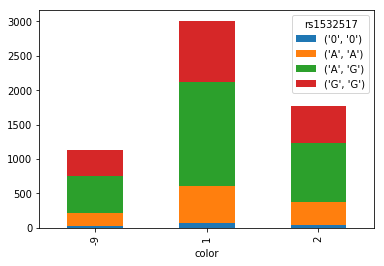

kgp5585247


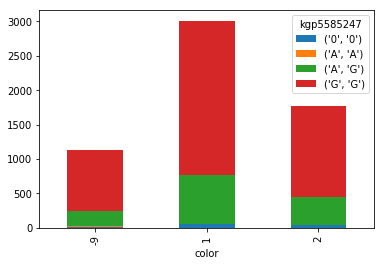

kgp6770083


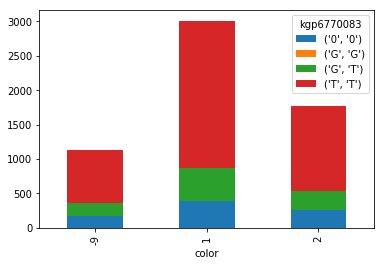

rs12915627


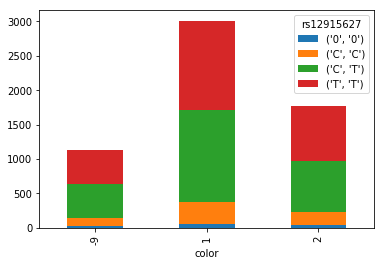

rs2015894


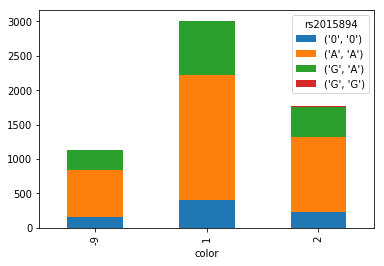

rs7496436


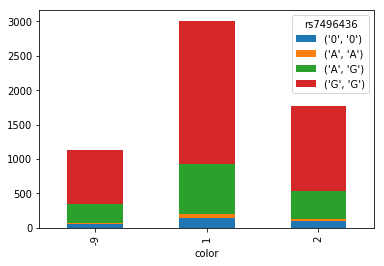

rs7174746


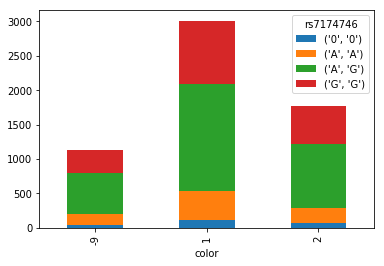

rs11633615


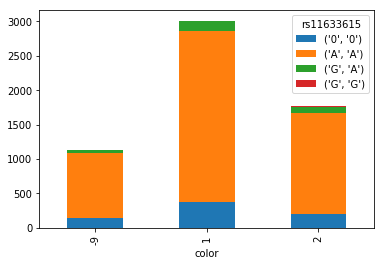

kgp1081538


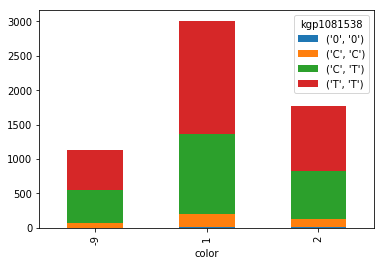

rs6576326


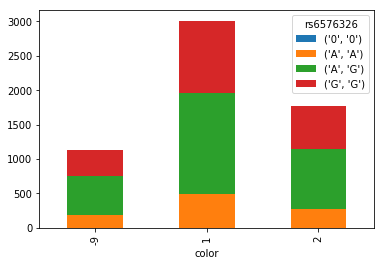

rs12913328


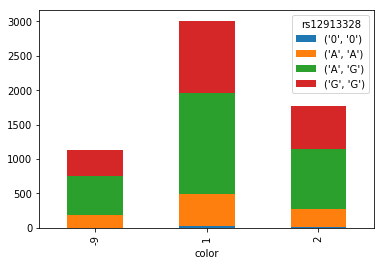

rs8025557


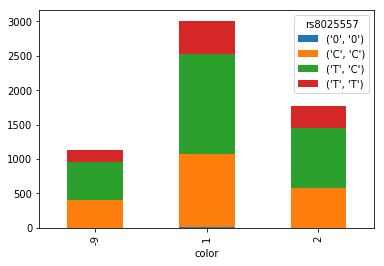

rs7180201


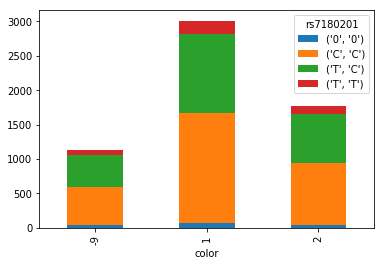

rs11854546


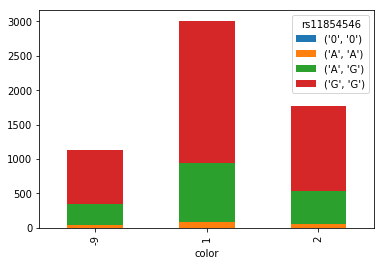

rs7497879


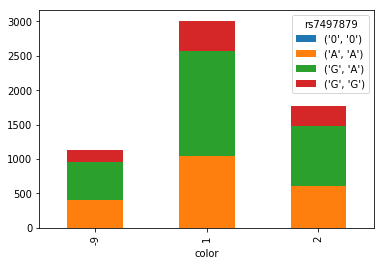

rs8031555


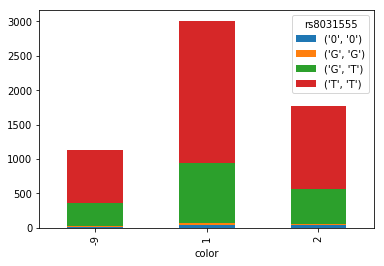

exm2272210


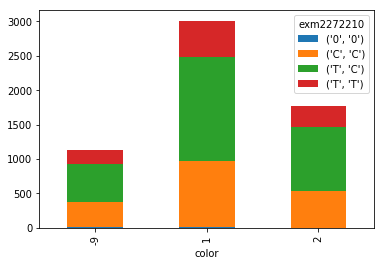

rs8038746


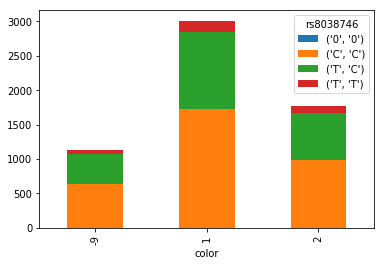

rs8025033


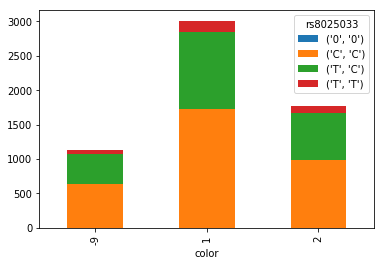

rs6420955


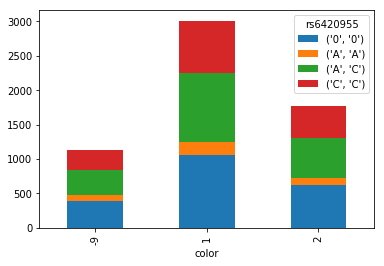

rs12594489


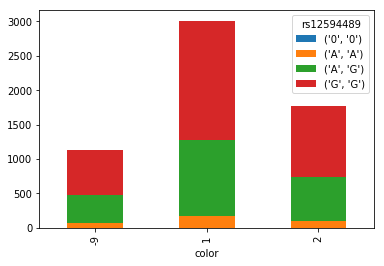

rs12914251


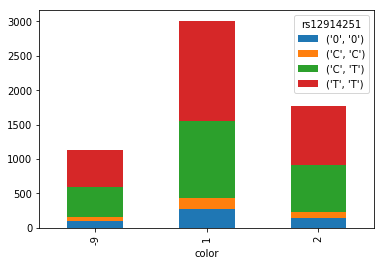

rs7164751


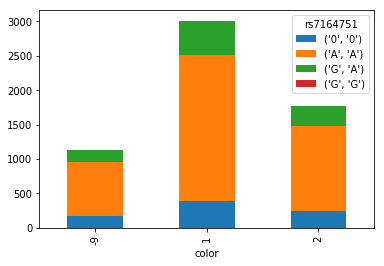

rs12910004


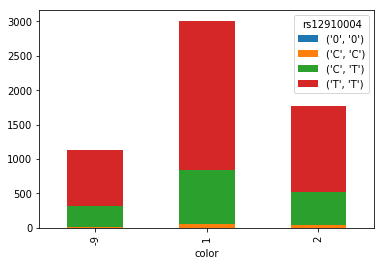

rs4906706


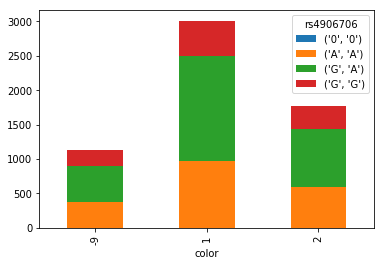

exm1141858


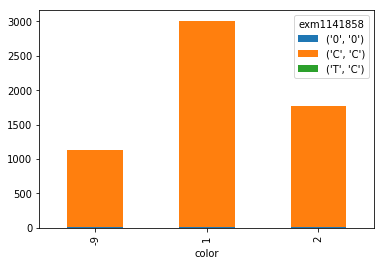

exm1141867


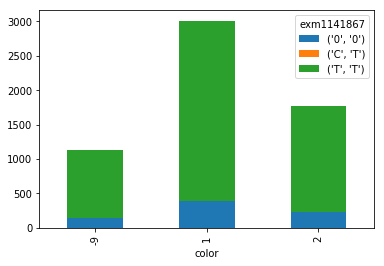

exm1141868


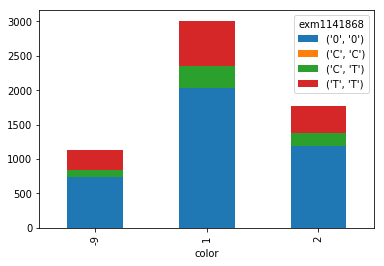

exm1141869


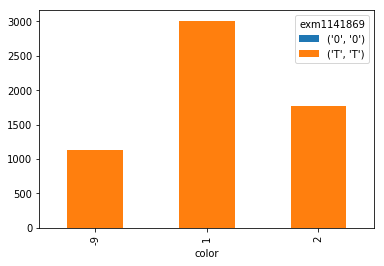

exm1141874


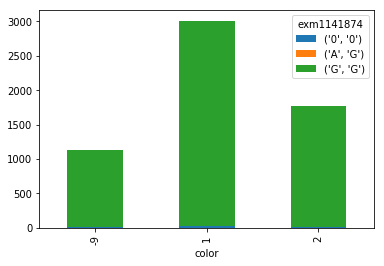

exm1141883


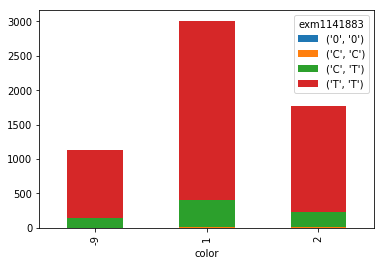

exm1141885


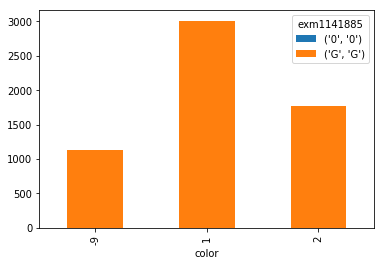

exm1141894


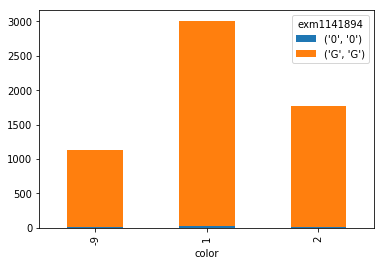

exm1141898


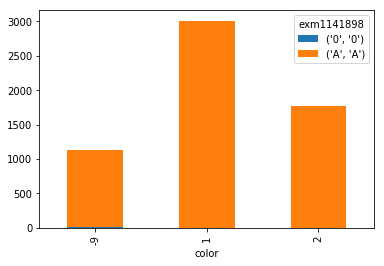

exm1141899


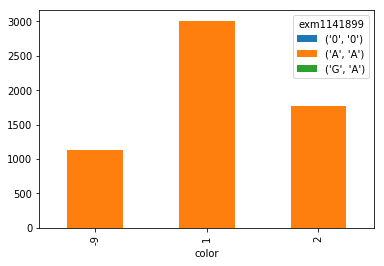

exm1141900


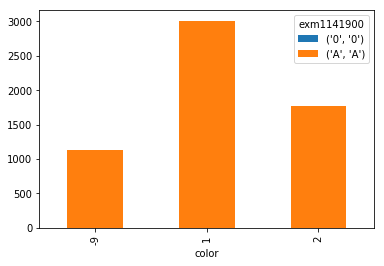

exm1141906


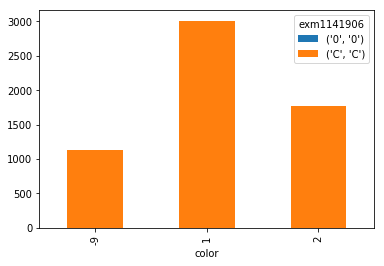

exm1141908


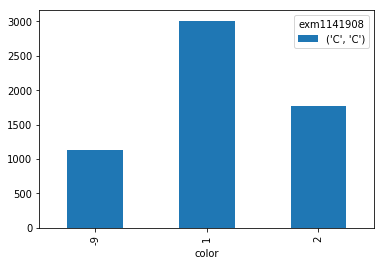

exm1141909


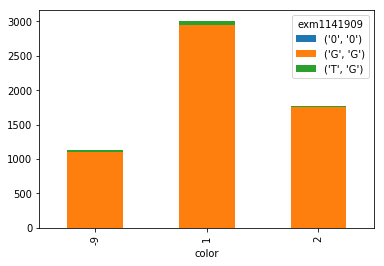

exm1141913


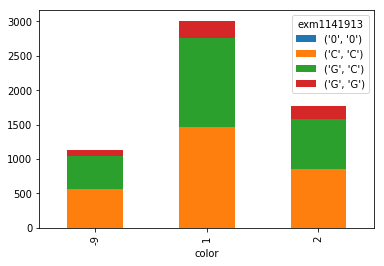

exm1141919


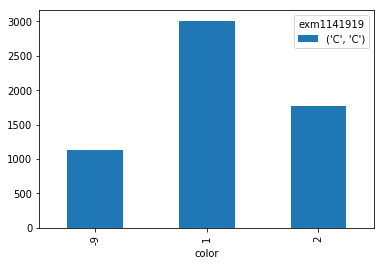

exm1141928


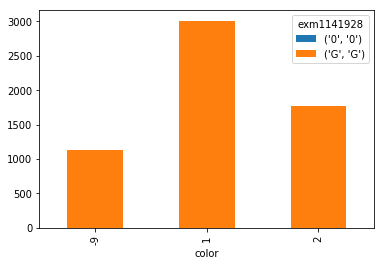

exm1141930


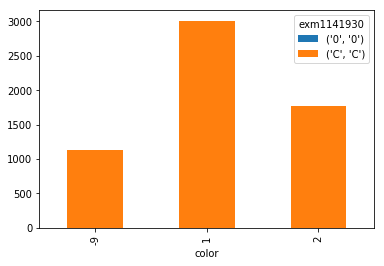

exm1141931


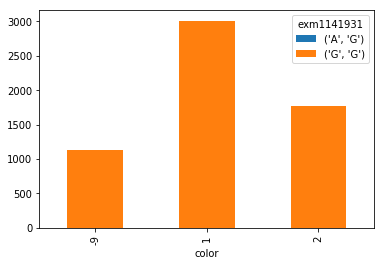

exm1141932


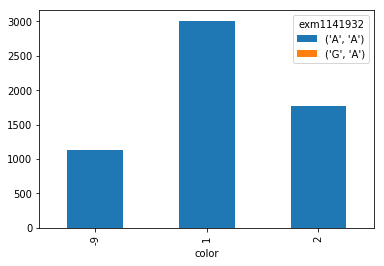

exm1141933


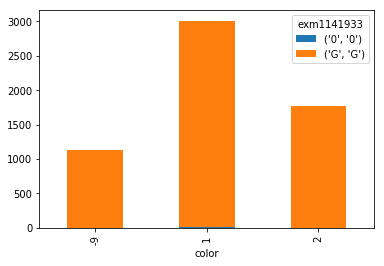

exm1141935


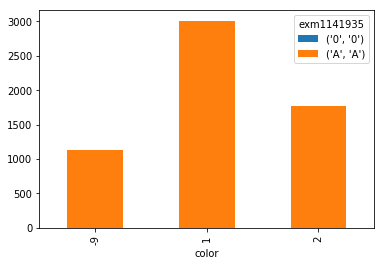

exm1141941


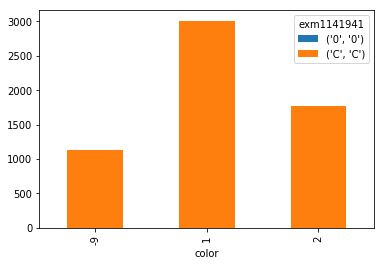

exm1141945


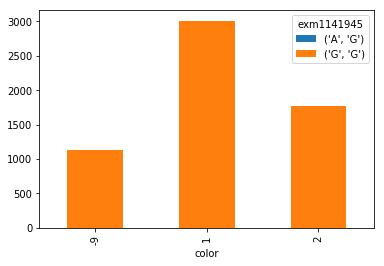

exm1141952


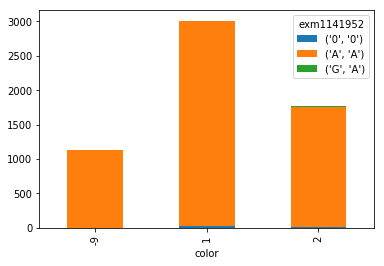

exm1141954


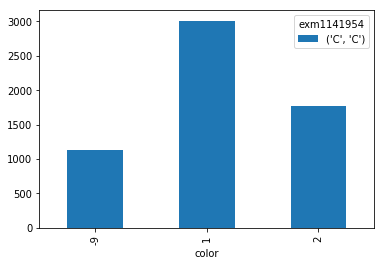

exm1141955


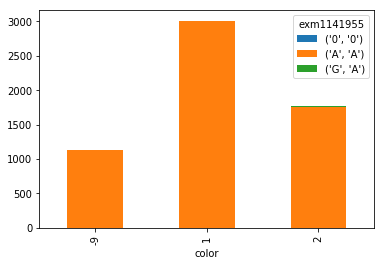

exm1141963


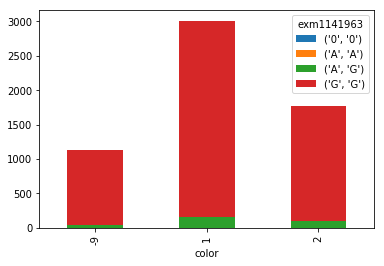

exm1825409


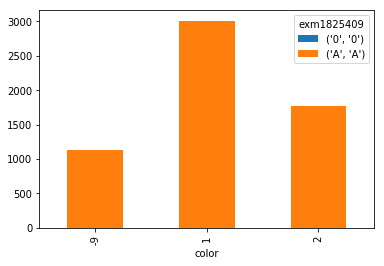

exm1141981


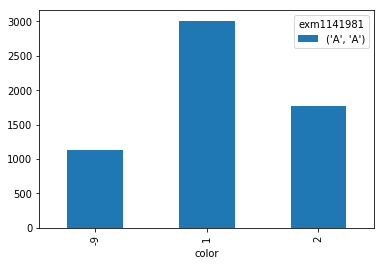

exm1141983


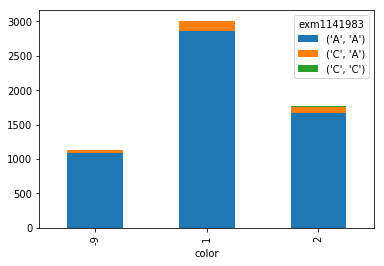

indel.34253


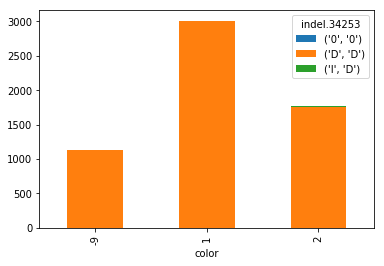

exm1141992


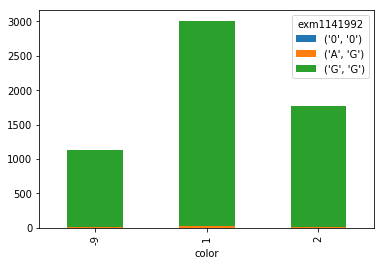

exm1141994


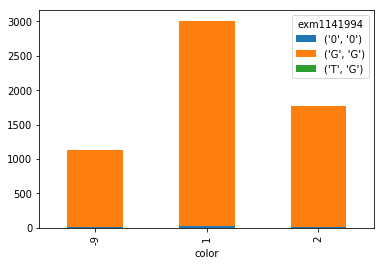

exm1141996


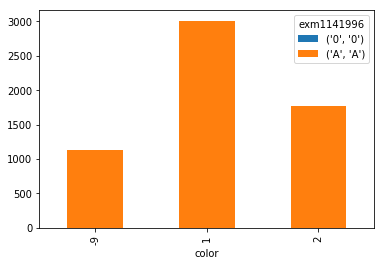

exm1141997


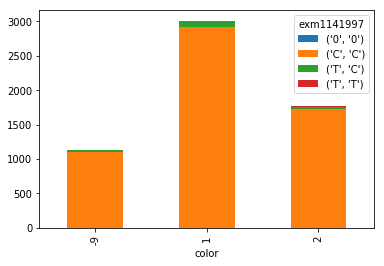

exm1141998


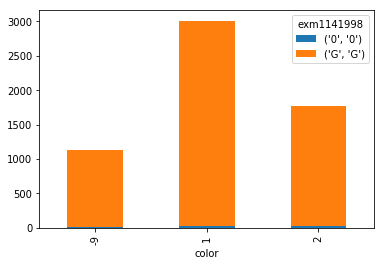

exm1142000


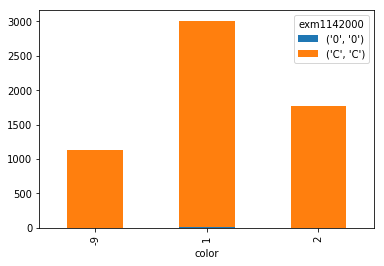

exm1142003


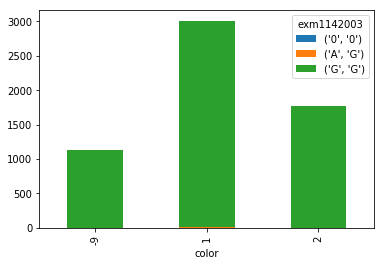

exm1142004


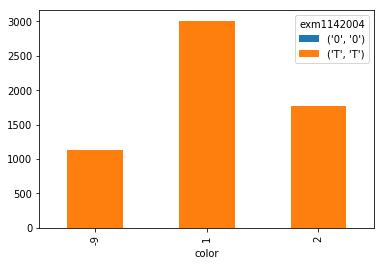

exm1142005


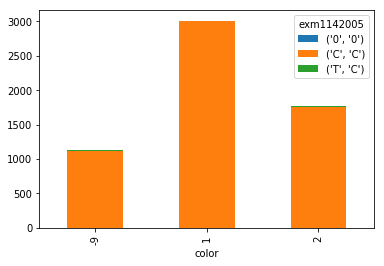

exm1142007


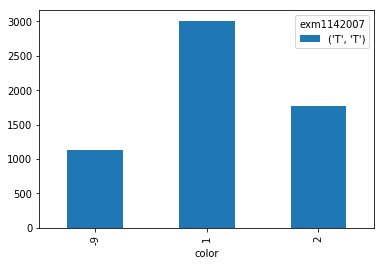

rs12902295


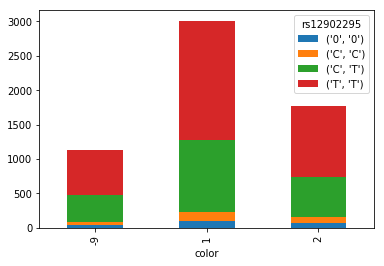

rs8036990


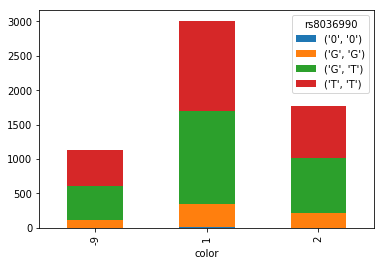

rs2883645


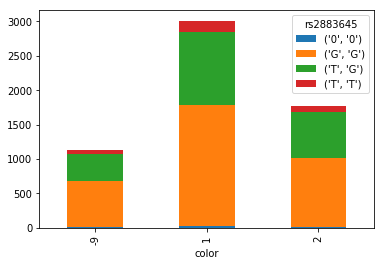

exm2260407


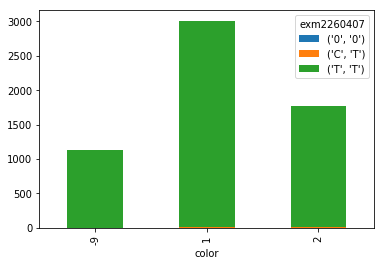

rs11637828


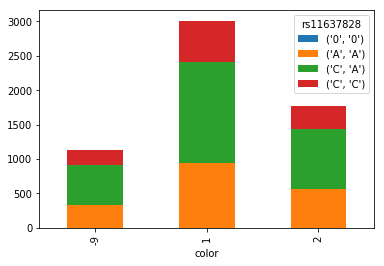

rs7167156


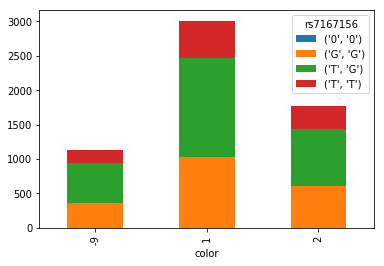

rs8029237


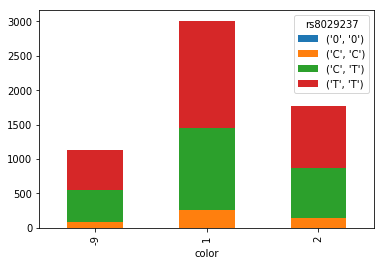

rs7176450


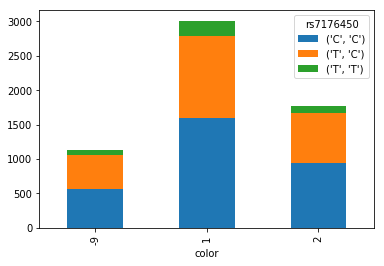

rs3913226


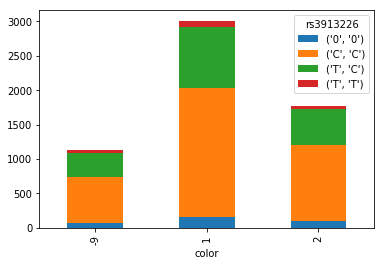

rs12904303


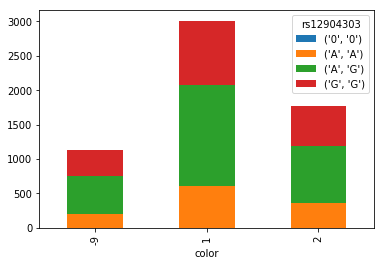

rs13329219


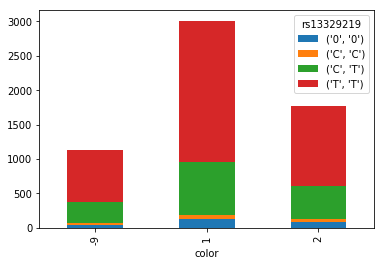

rs749305


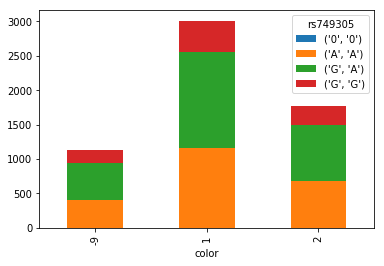

rs7175885


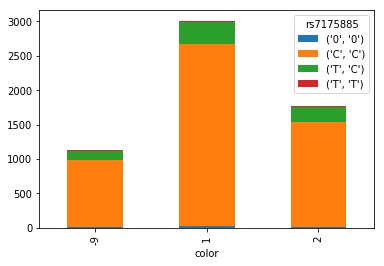

rs8034720


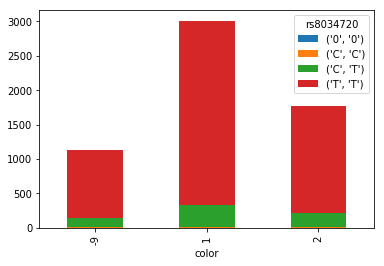

rs17114774


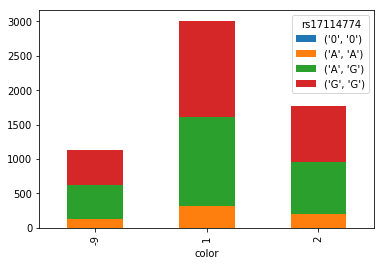

rs11161140


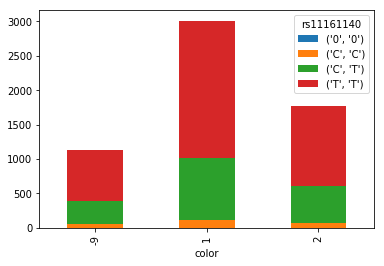

rs12905653


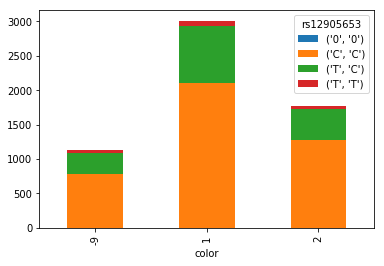

rs4028400


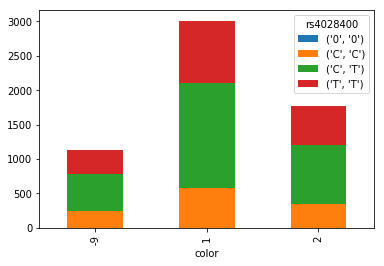

exm-rs3867498


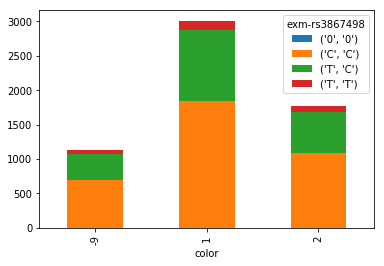

rs3867498


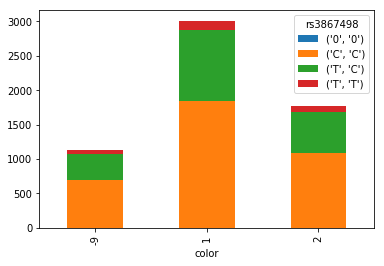

rs2167926


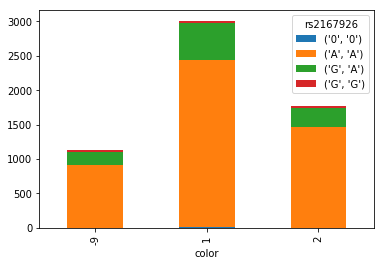

rs1079207


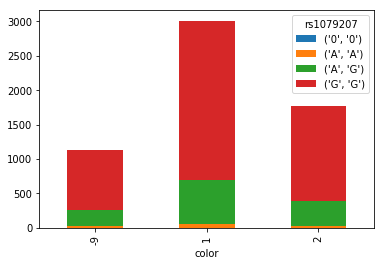

rs7359196


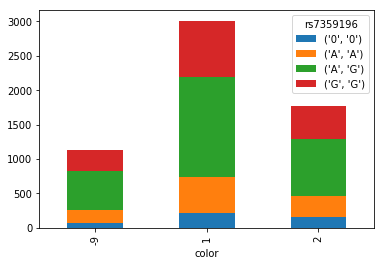

rs12592215


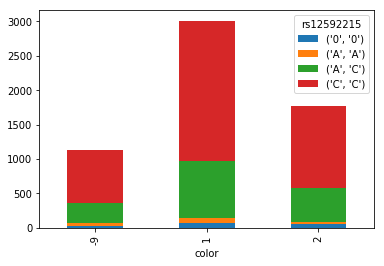

rs12592279


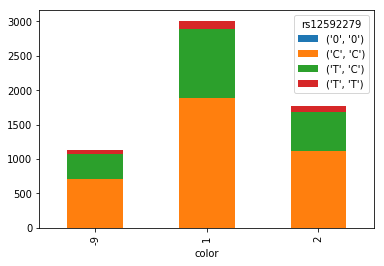

exm2252072


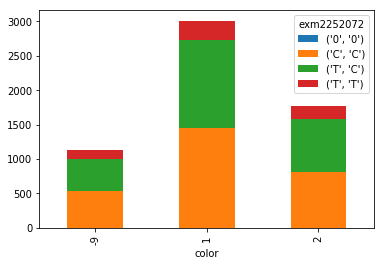

rs3867499


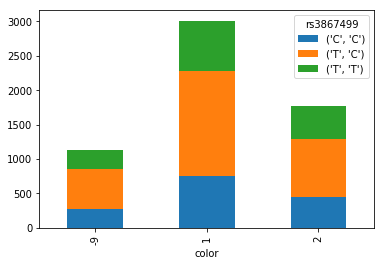

rs4906929


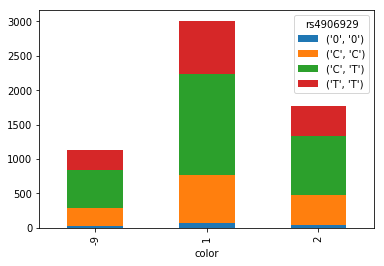

rs4906933


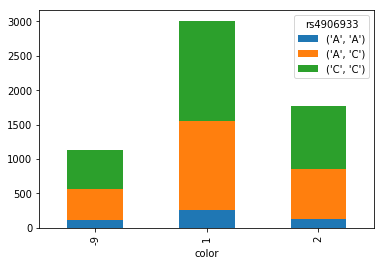

rs7179965


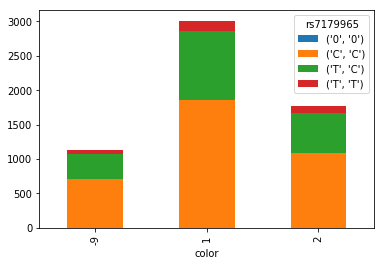

rs12909900


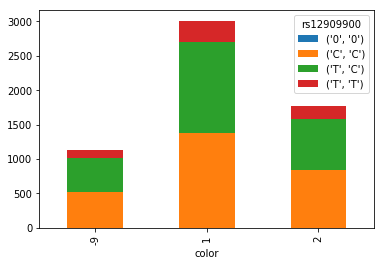

rs956182


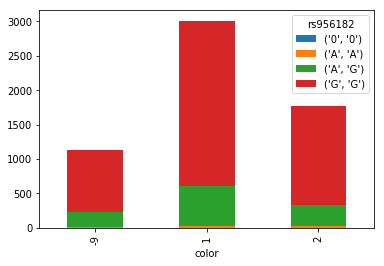

rs12438971


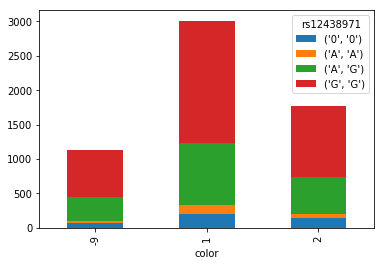

rs2133127


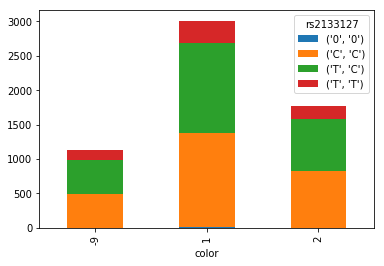

rs952981


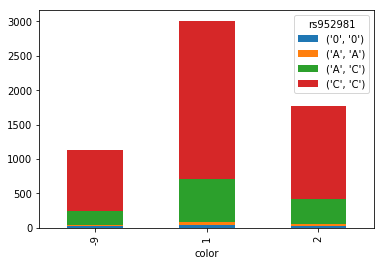

rs7175827


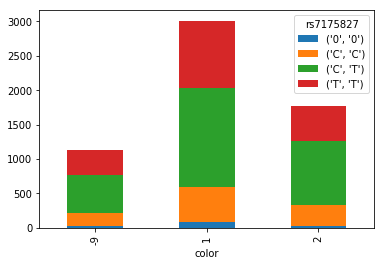

rs4906695


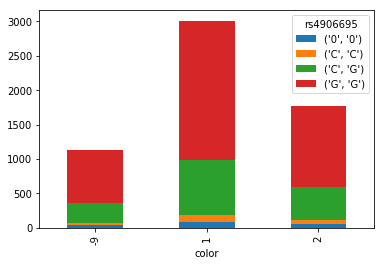

rs11633230


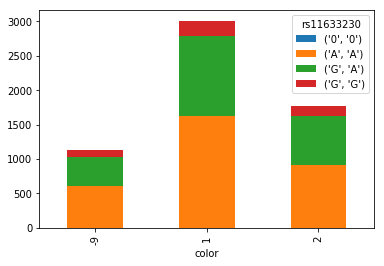

rs12592731


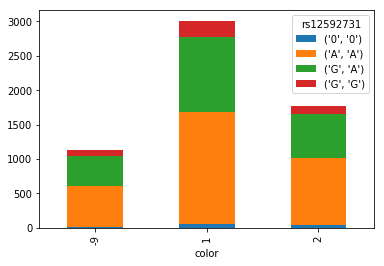

rs4906939


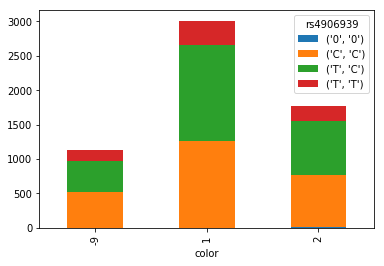

exm1142022


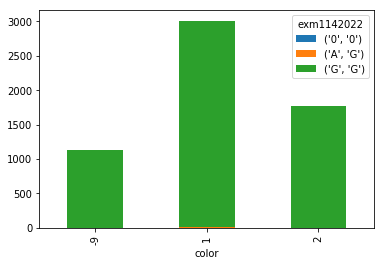

rs220034


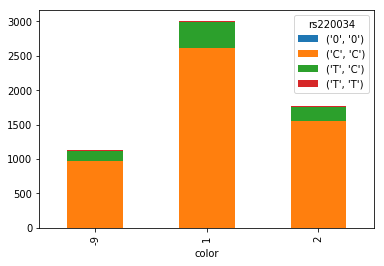

exm1142026


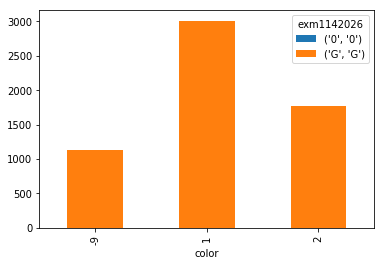

exm1142027


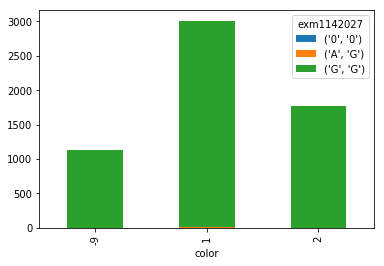

variant.34256


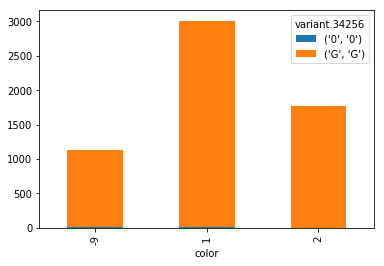

rs705


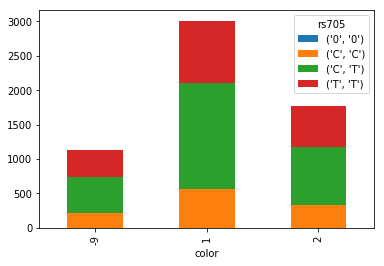

rs2732029


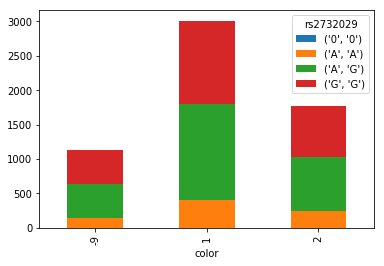

rs2732040


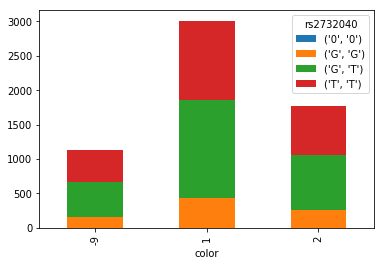

rs1812905


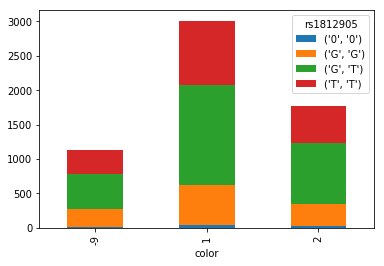

rs17115126


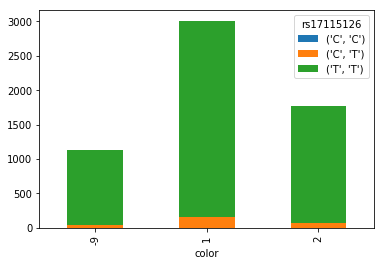

rs12441340


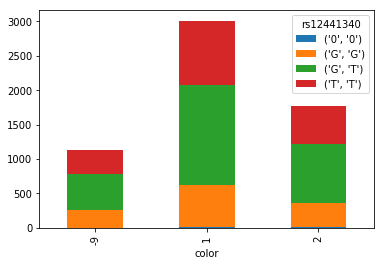

rs7171937


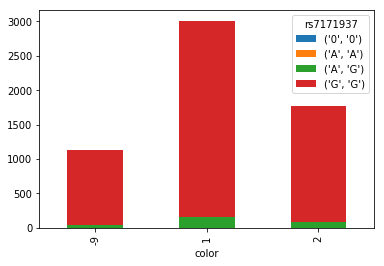

rs8033133


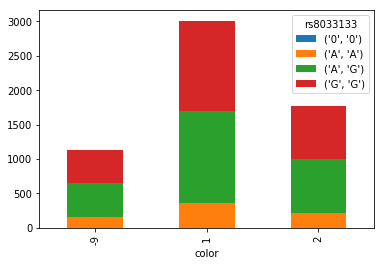

rs2714717


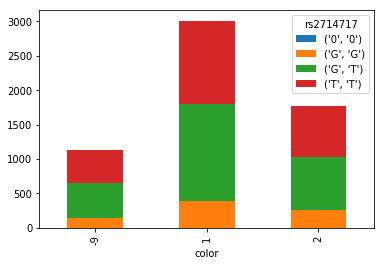

rs2739826


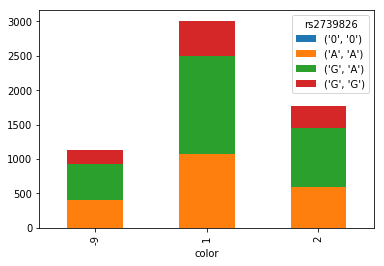

rs2714731


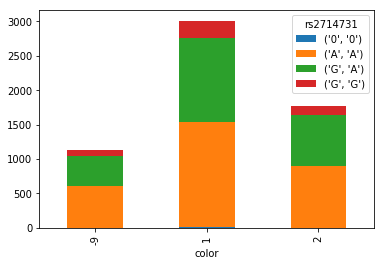

rs2011010


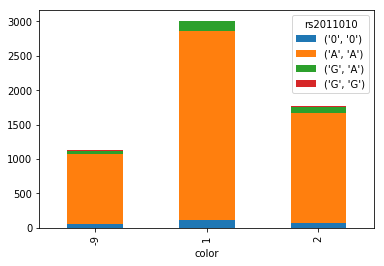

rs2017626


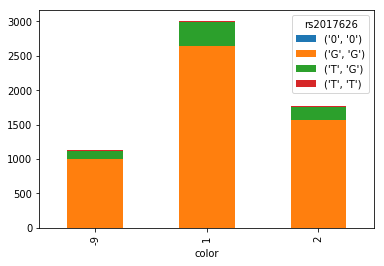

rs2714772


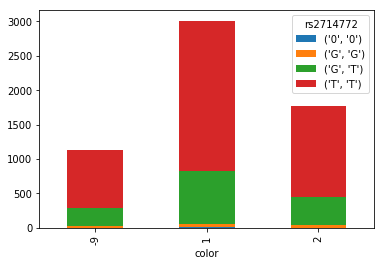

rs11855919


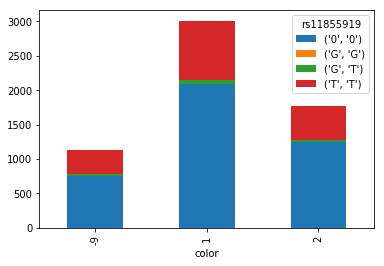

rs2719922


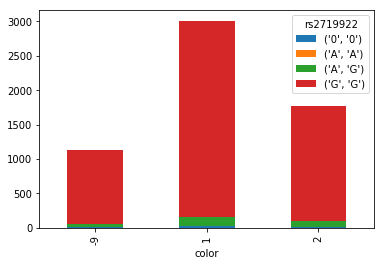

exm2267818


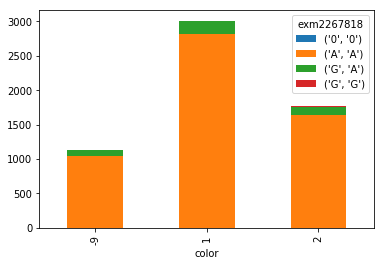

rs12441992


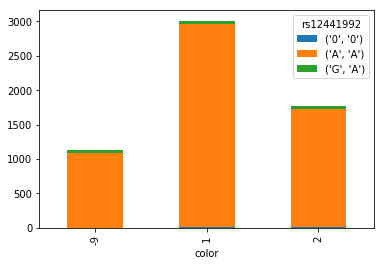

rs2719889


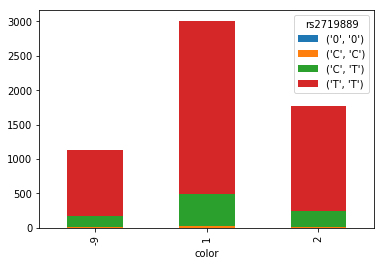

kgp1723515


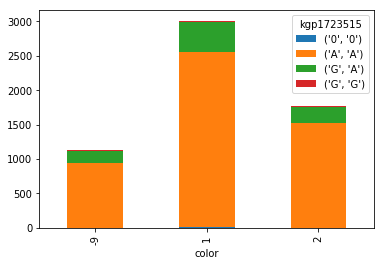

rs34815964


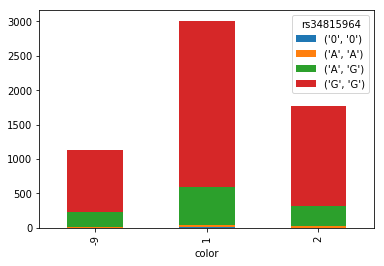

exm1142468


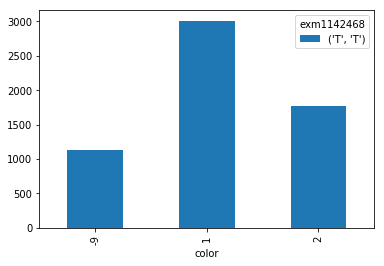

exm1142499


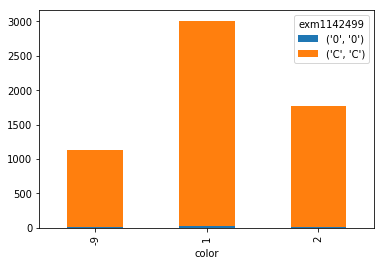

exm1142501


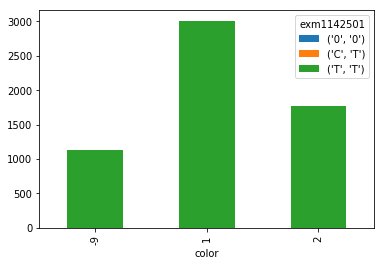

exm1142506


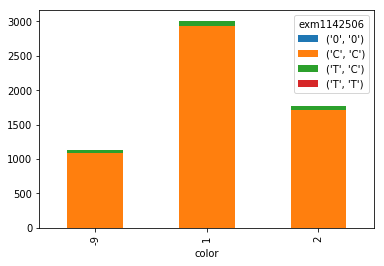

rs7175559


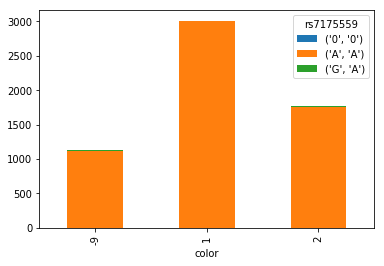

variant.34259


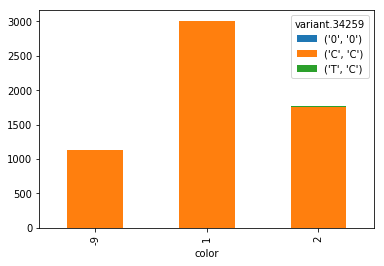

variant.34260


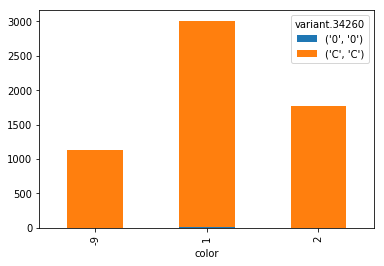

rs1041933


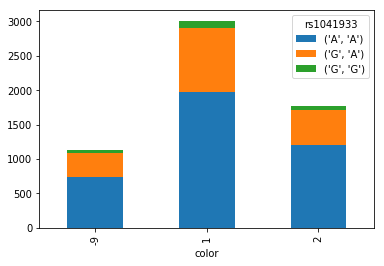

rs7182827


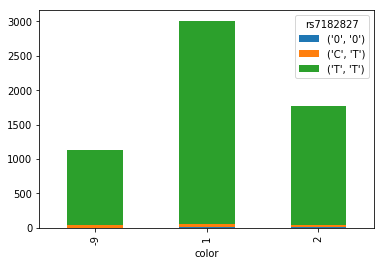

rs2214470


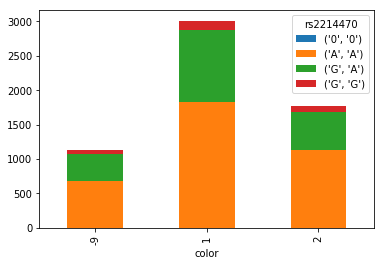

rs2340634


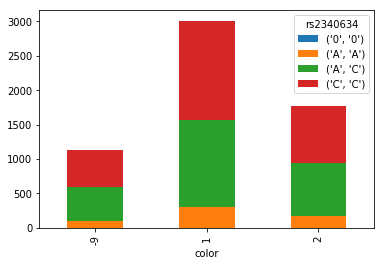

rs7496458


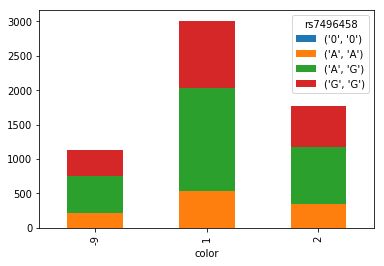

rs2925235


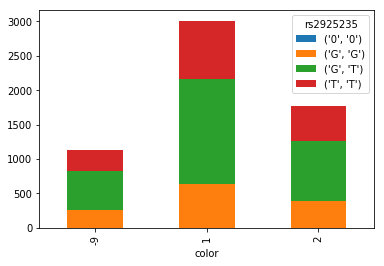

rs1034754


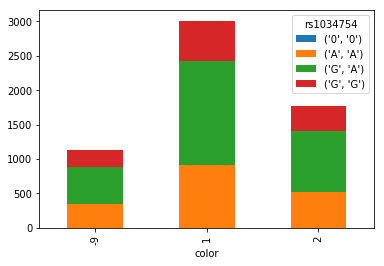

rs2189713


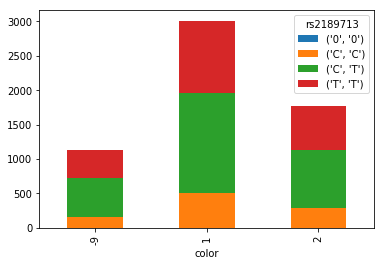

rs8036143


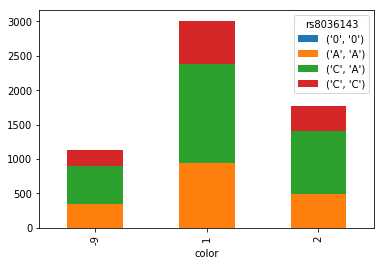

rs4906723


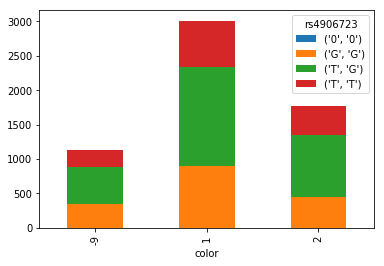

rs12916261


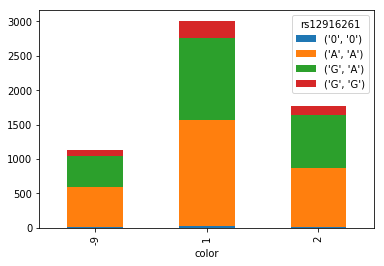

rs2526565


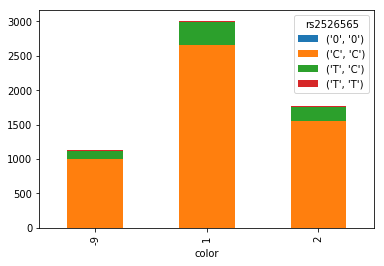

rs2526571


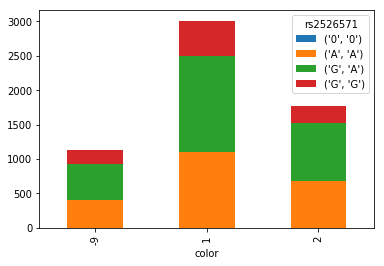

rs2605463


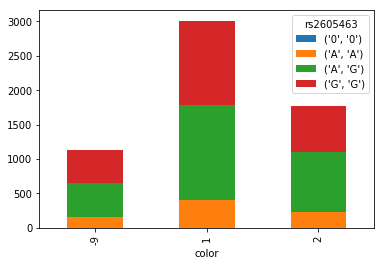

rs8032380


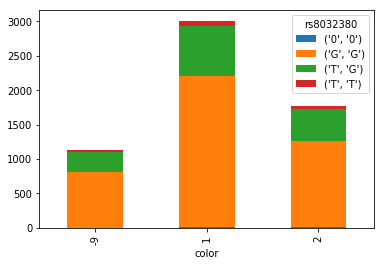

rs4906974


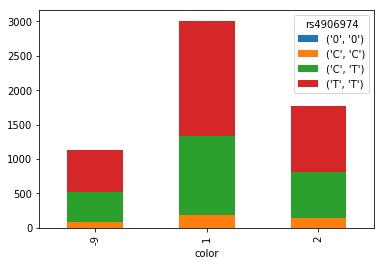

rs2628633


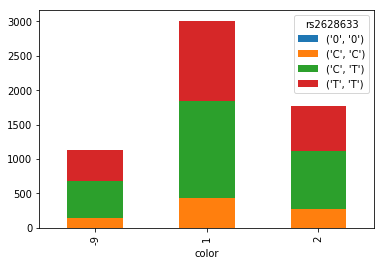

rs1008531


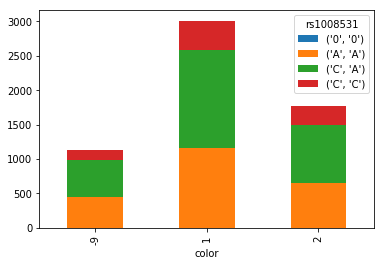

rs12914691


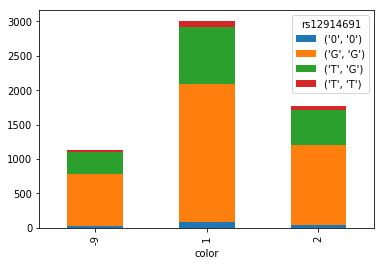

rs4906728


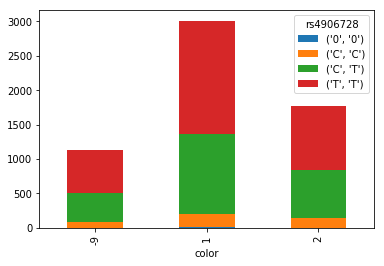

rs11630820


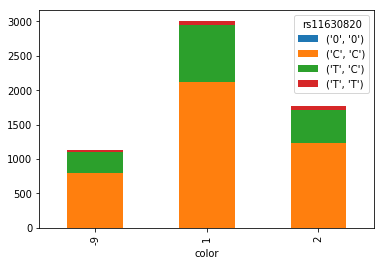

rs2930599


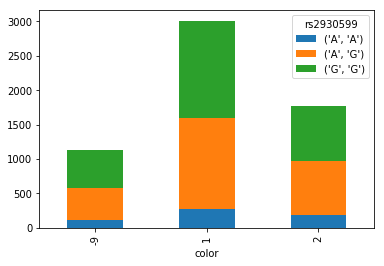

rs9806169


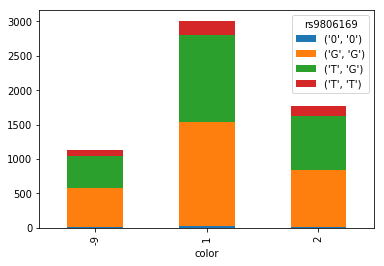

rs8025092


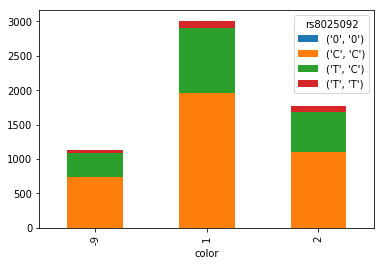

rs872282


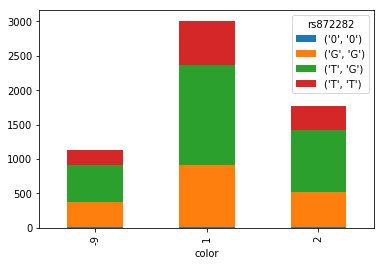

rs2930593


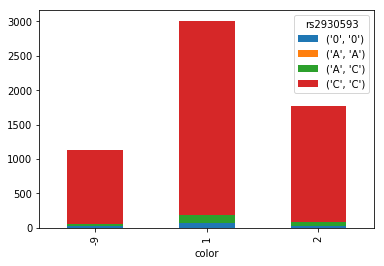

rs1385388


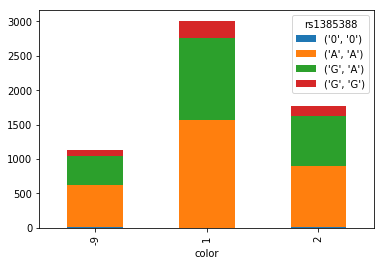

rs2106


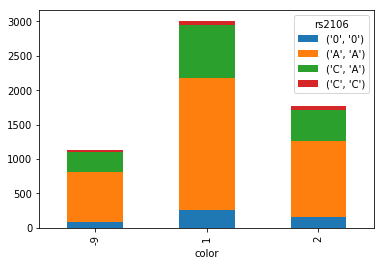

rs6576443


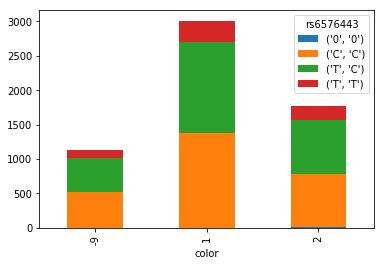

rs2605447


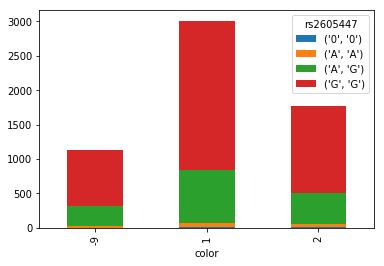

rs1817569


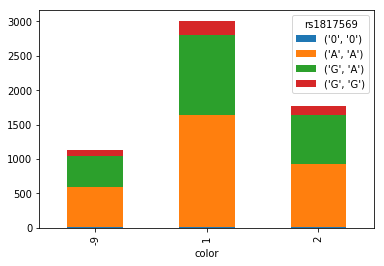

rs9806558


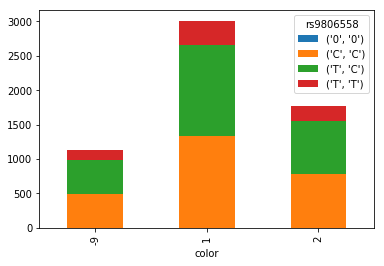

exm-rs17636733


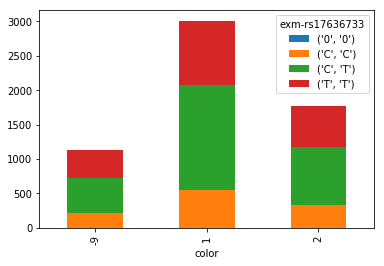

rs2066708


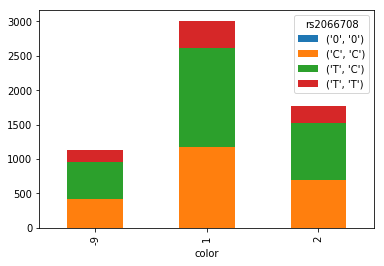

exm1142522


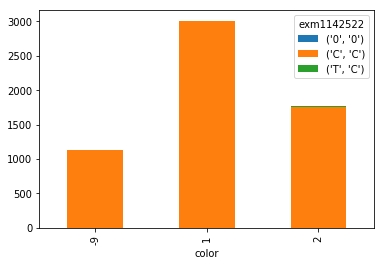

exm1142527


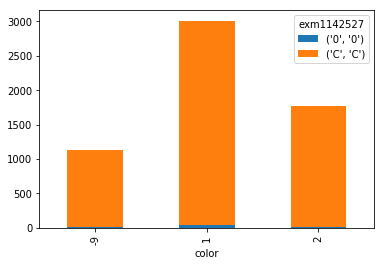

exm1142531


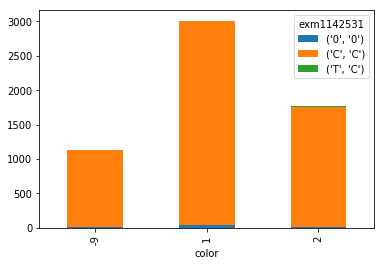

exm1142534


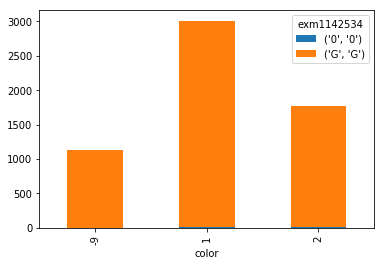

exm2252075


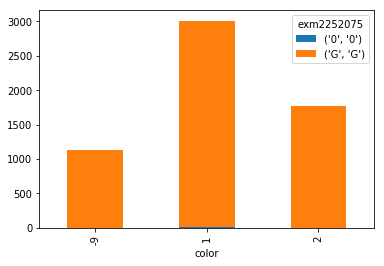

exm1142542


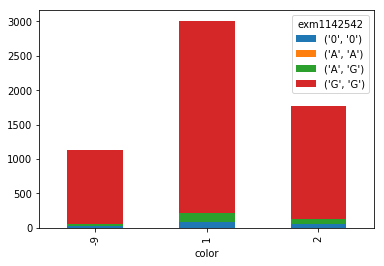

exm1142547


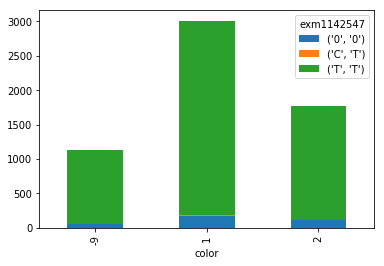

exm1142551


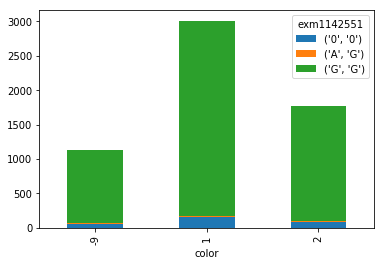

exm2274731


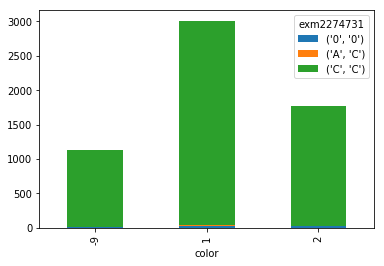

exm1142559


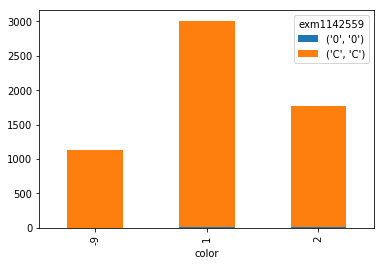

exm1142564


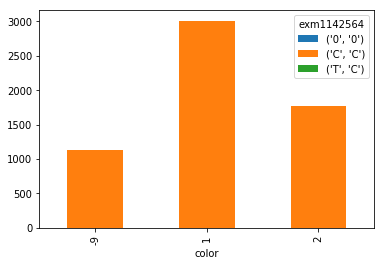

rs3736186


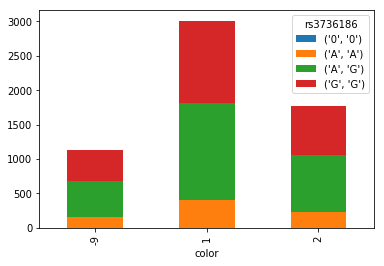

exm1142569


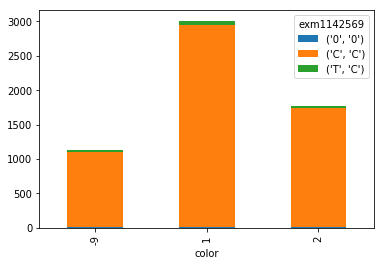

exm1142570


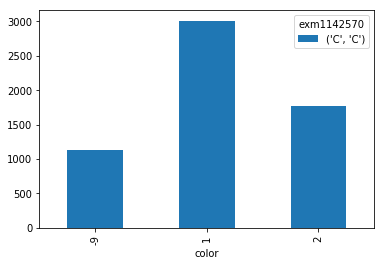

variant.34264


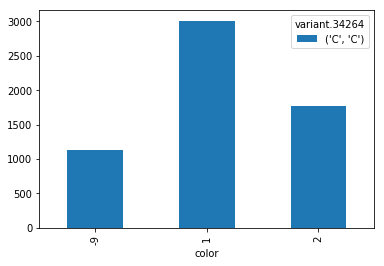

exm1142579


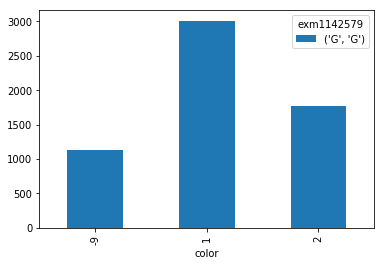

rs901003


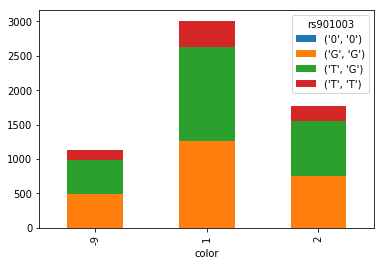

exm1142582


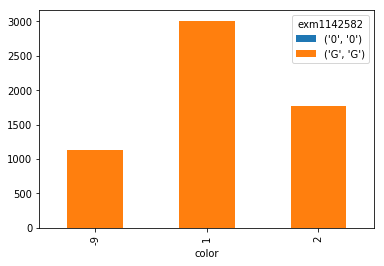

exm1142583


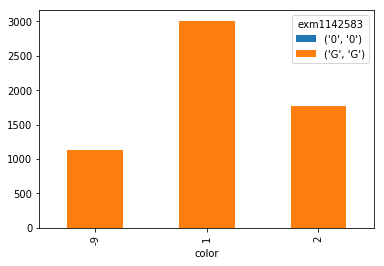

exm1142585


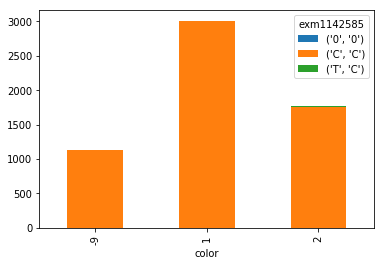

exm1142589


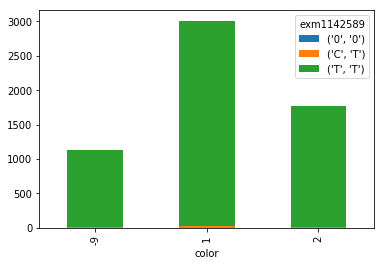

exm1142590


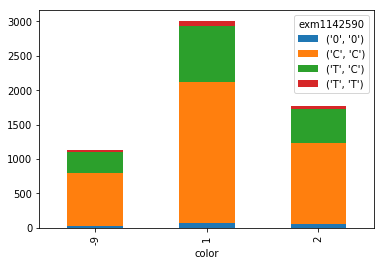

exm1142598


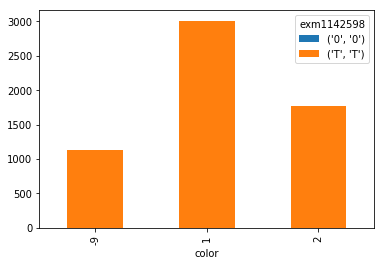

rs8028506


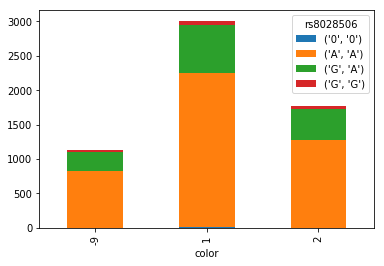

exm1142610


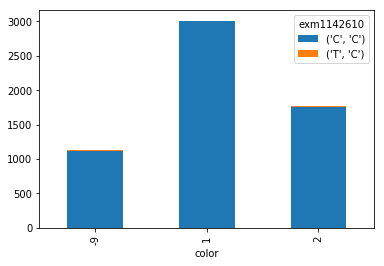

rs2066705


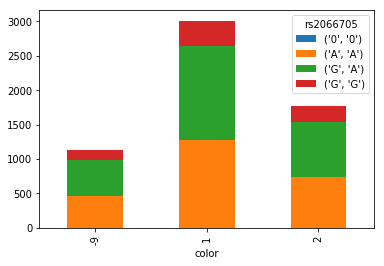

rs2046414


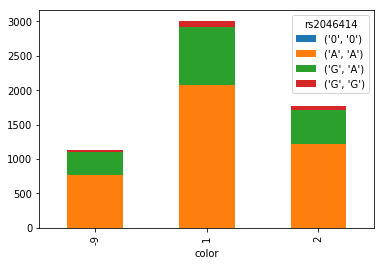

exm1142614


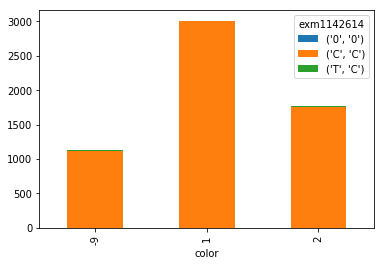

exm1142615


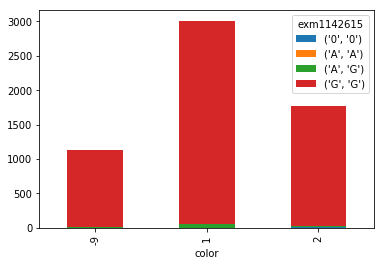

exm1142620


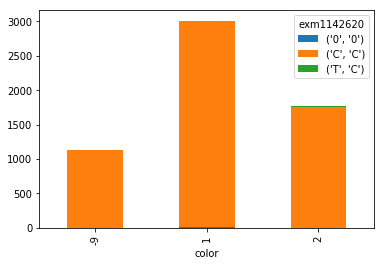

exm1142626


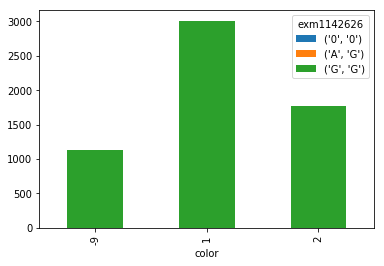

exm1142631


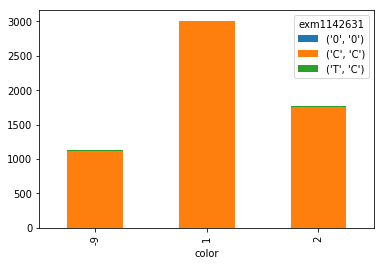

exm2223088


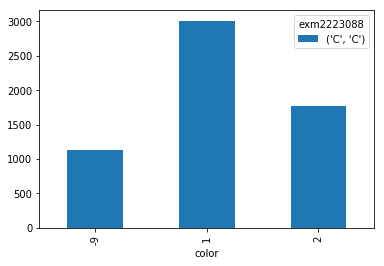

exm1142645


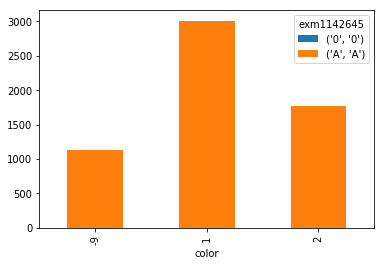

exm1142648


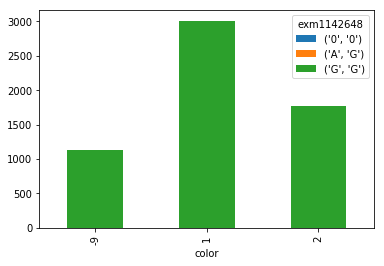

exm1825714


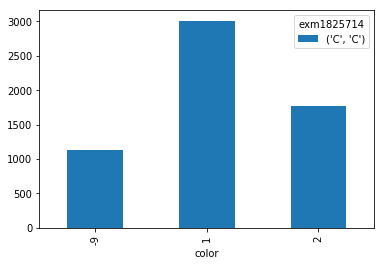

rs2291354


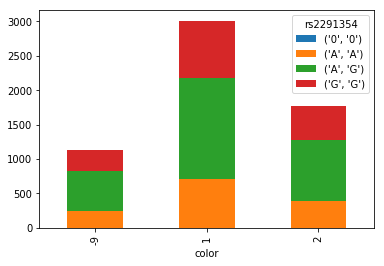

exm1142657


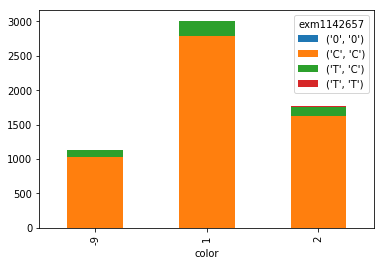

indel.34266


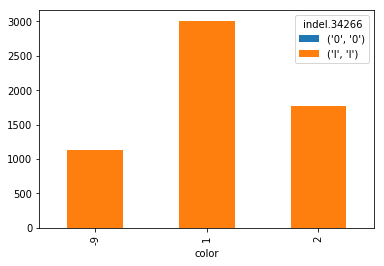

rs4906621


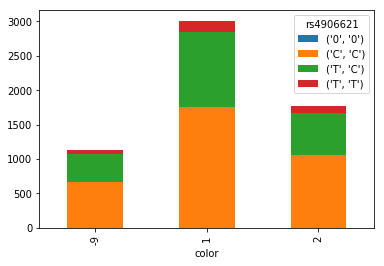

rs7180035


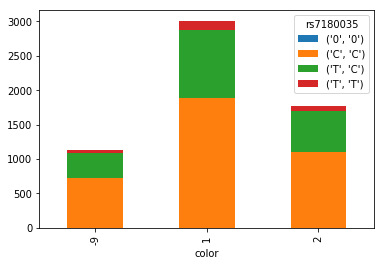

exm1142669


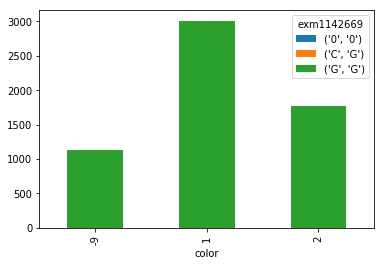

exm1142674


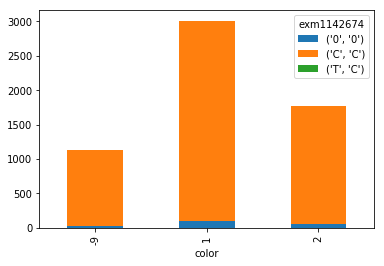

exm1142675


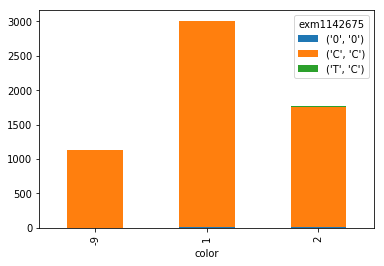

exm1825729


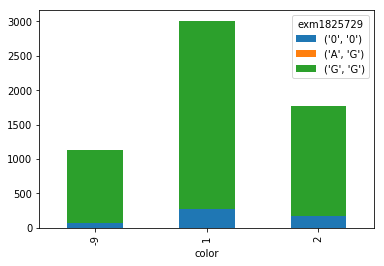

exm1142684


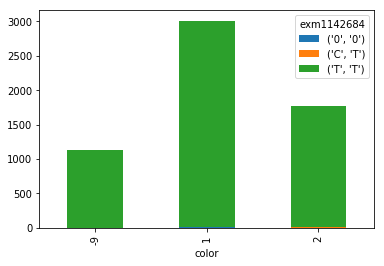

exm1142690


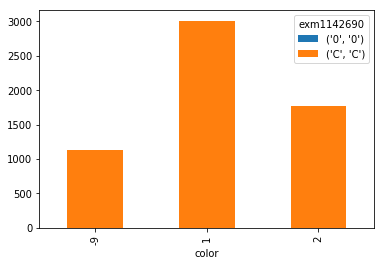

exm1142692


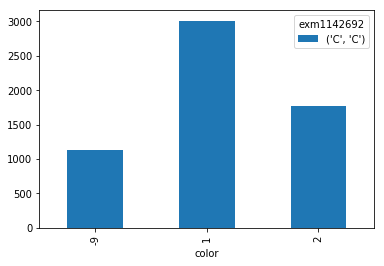

exm1142700


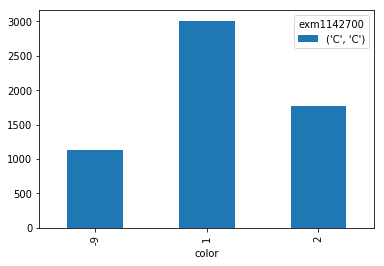

exm1142704


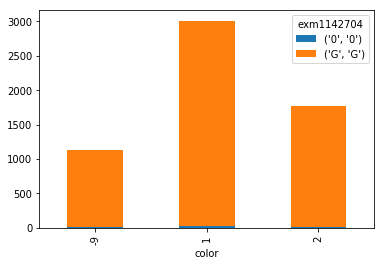

exm1142712


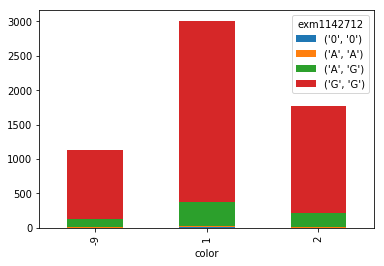

exm1142719


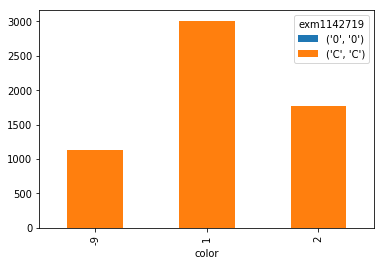

exm1142720


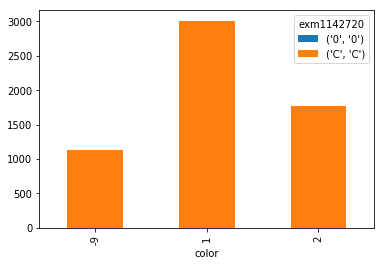

exm1142727


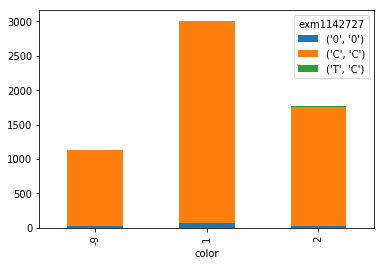

exm1142731


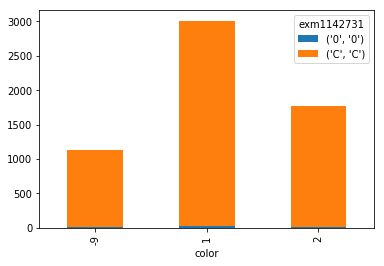

exm1142734


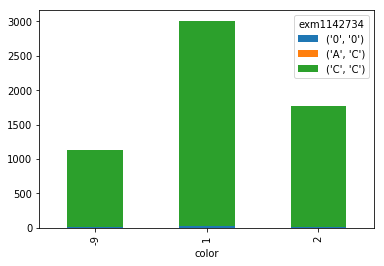

exm1142744


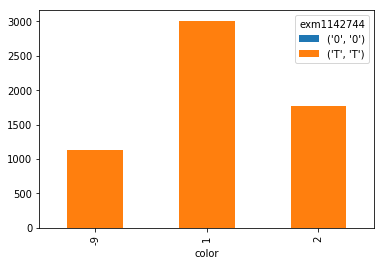

exm1142745


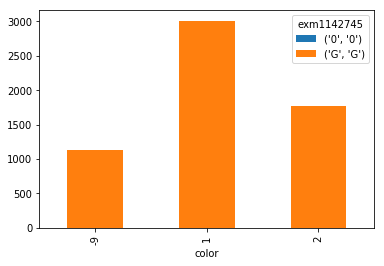

exm1142748


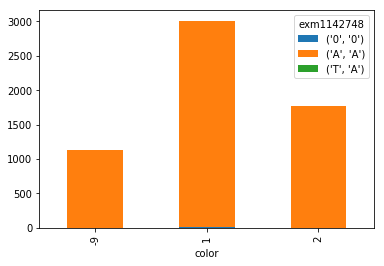

rs4906627


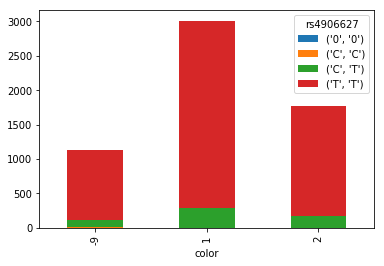

exm1142757


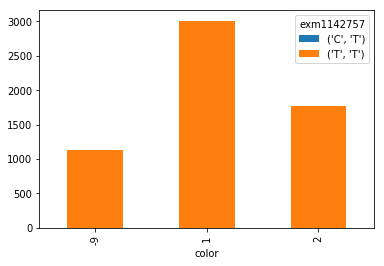

exm1142758


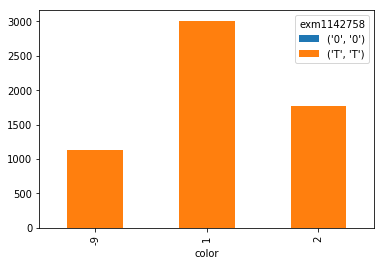

exm1142760


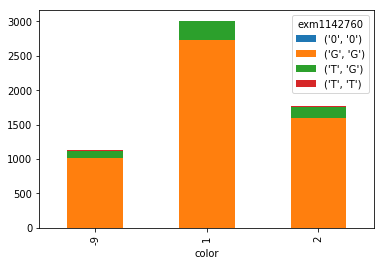

exm1825749


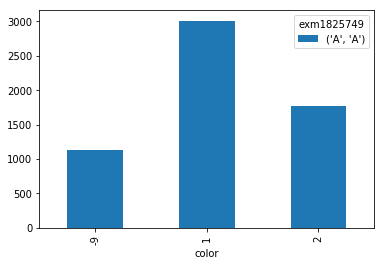

exm1142770


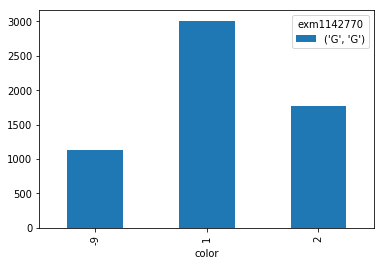

rs4627308


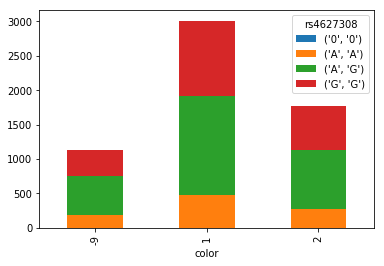

exm1142780


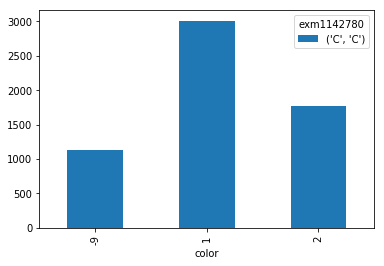

exm1825758


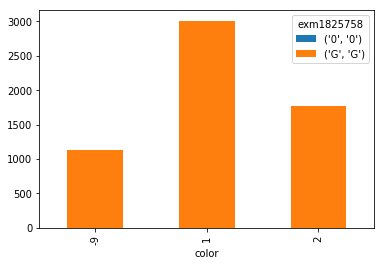

rs4906631


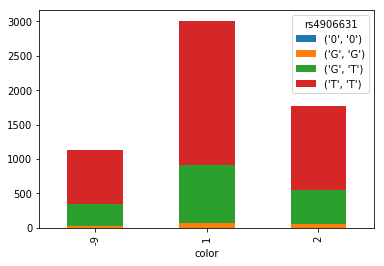

rs7182019


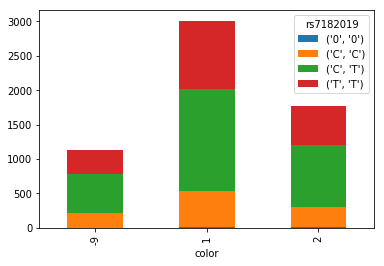

rs12901627


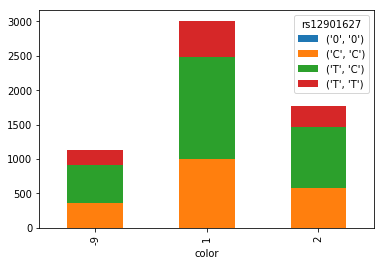

rs8027096


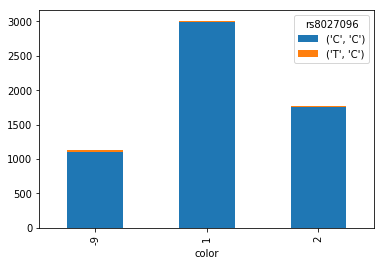

rs4547306


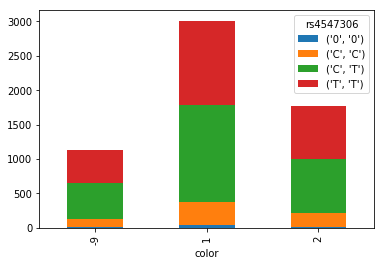

rs11630130


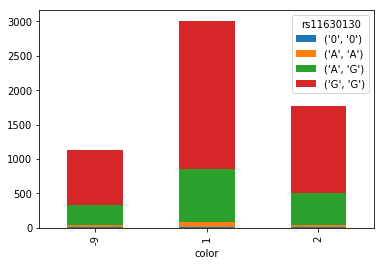

rs6576456


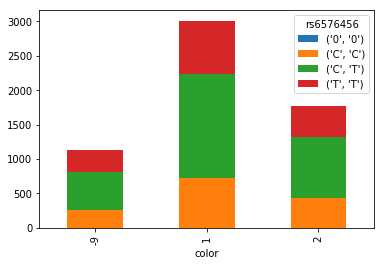

rs11161217


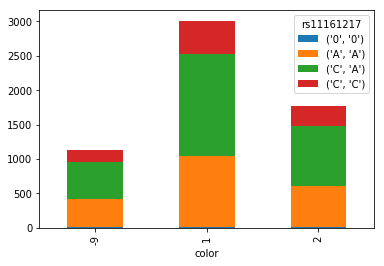

rs1444623


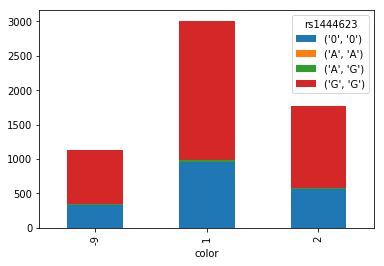

rs17637182


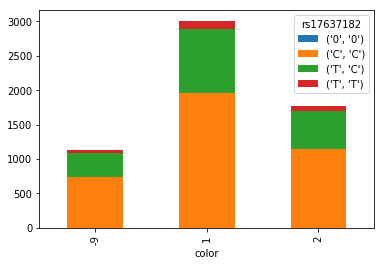

rs17556203


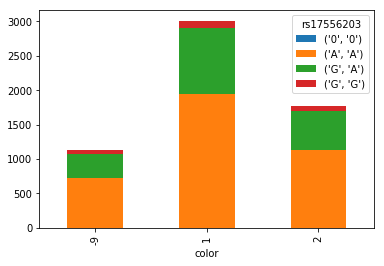

exm1142792


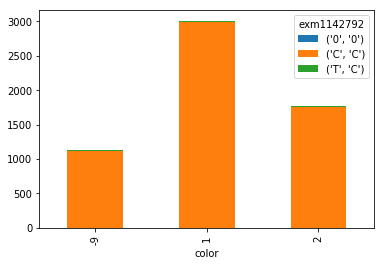

exm1142793


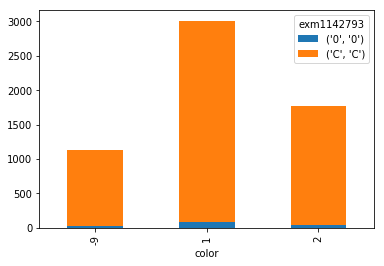

exm1142798


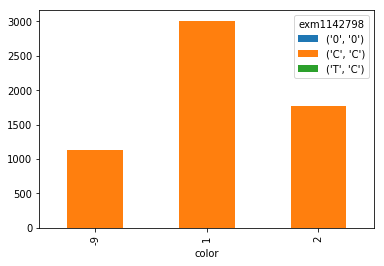

exm2252077


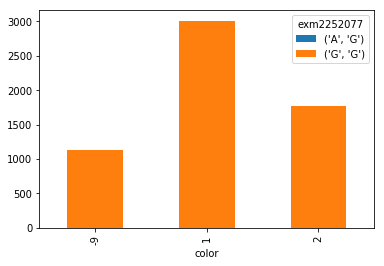

rs12595426


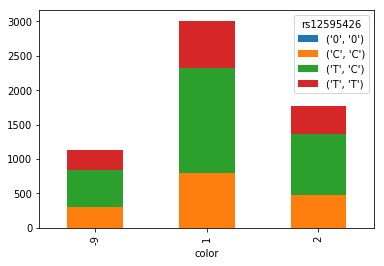

rs4906771


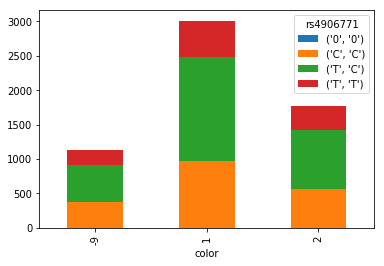

rs8037418


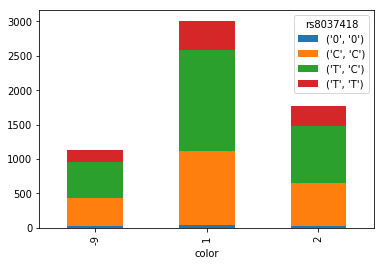

rs1345101


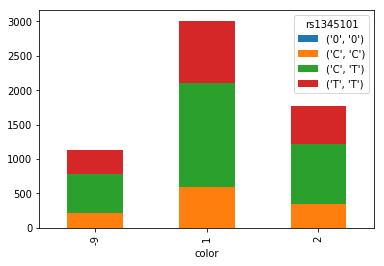

rs8023362


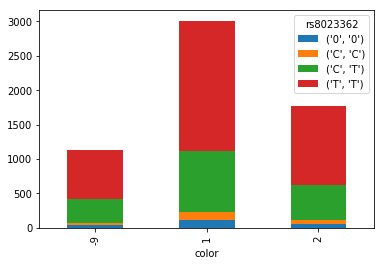

rs8030552


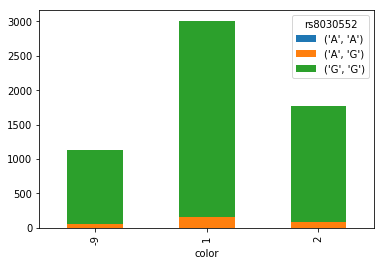

rs2317392


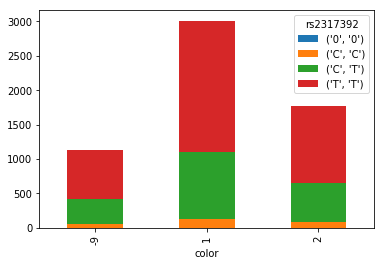

rs12438316


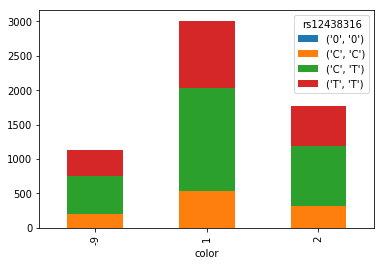

rs10873609


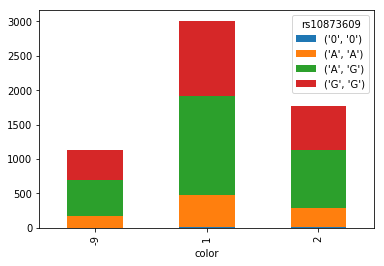

rs11629954


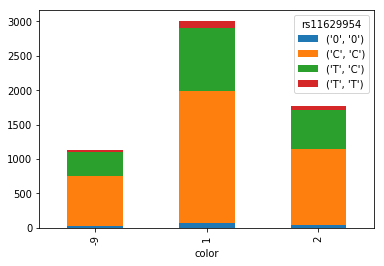

rs17116234


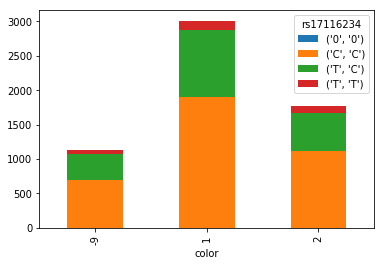

rs4906784


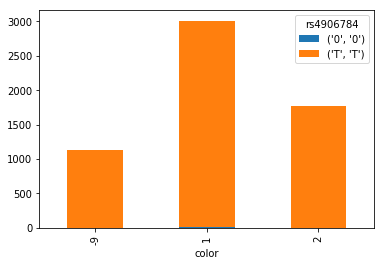

rs12904249


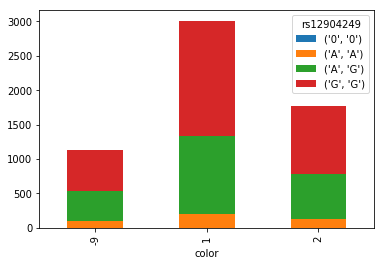

rs11638843


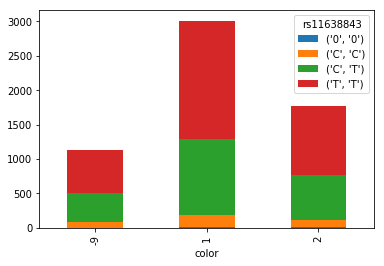

rs12101499


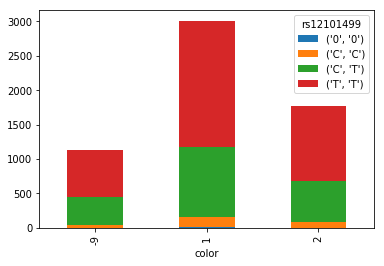

rs8024381


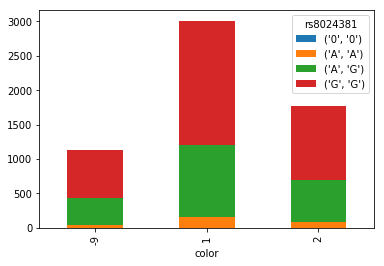

rs11637218


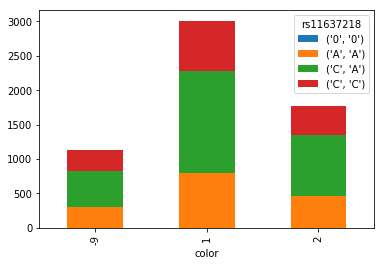

rs11630247


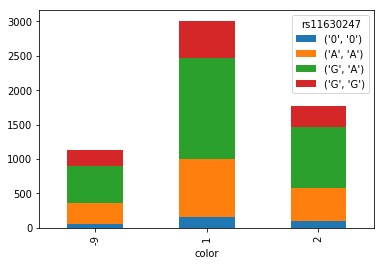

rs1553895


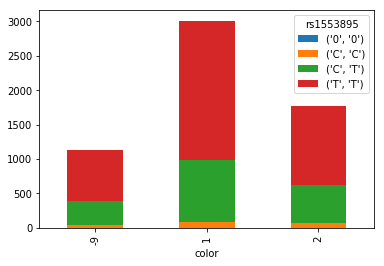

rs1553893


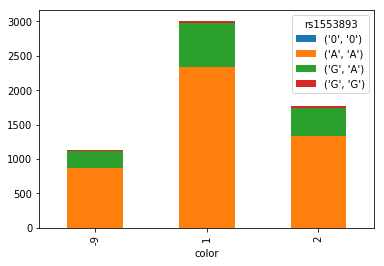

rs7178765


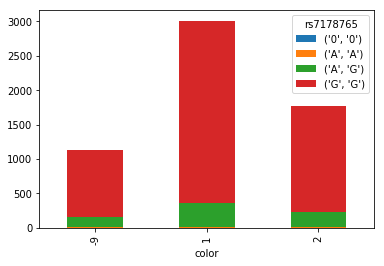

rs11161249


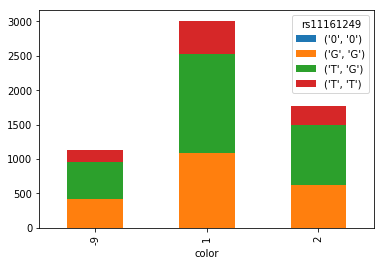

rs4906640


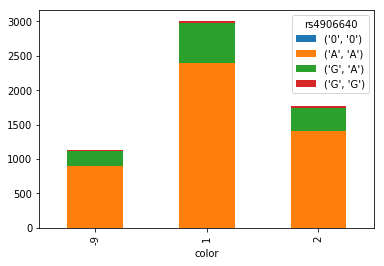

rs4260026


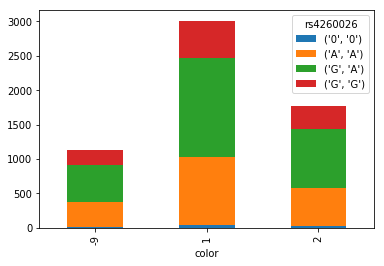

rs17116307


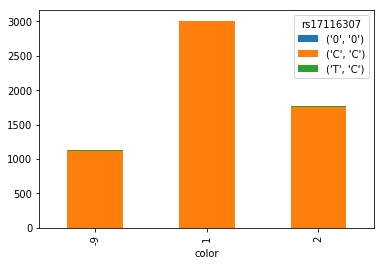

rs968332


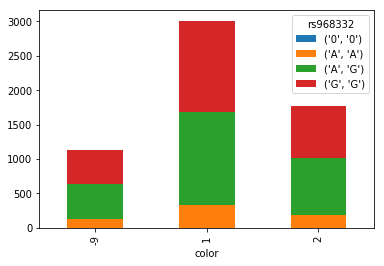

rs11635436


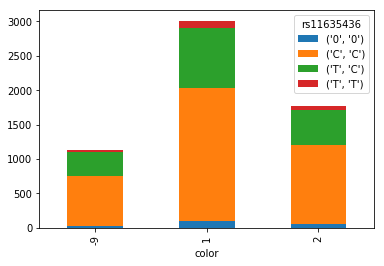

rs12917095


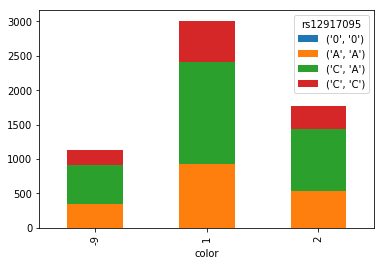

rs8028085


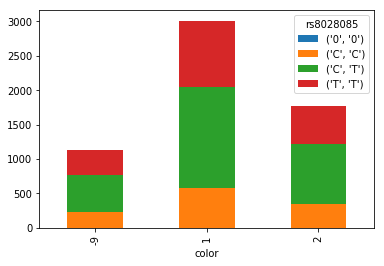

rs907331


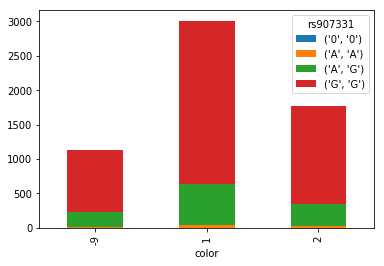

rs7173059


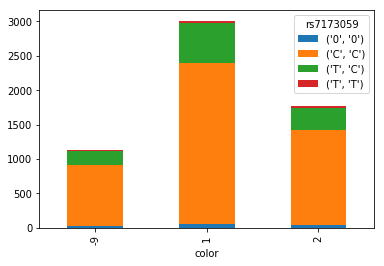

rs10451030


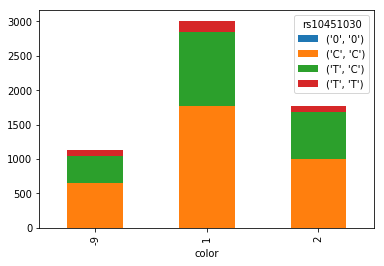

rs11161254


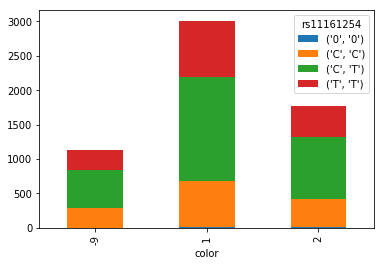

rs17116346


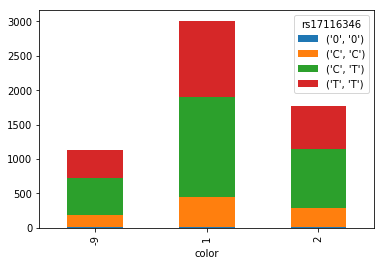

rs17735939


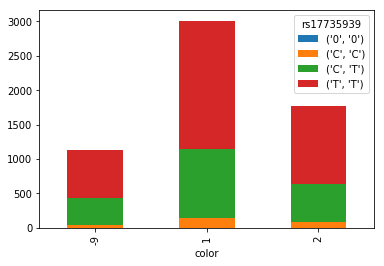

rs4467042


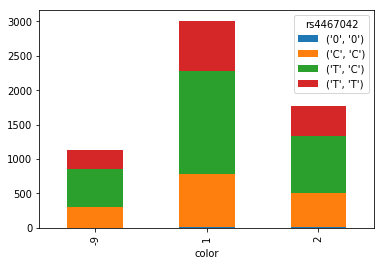

rs11161256


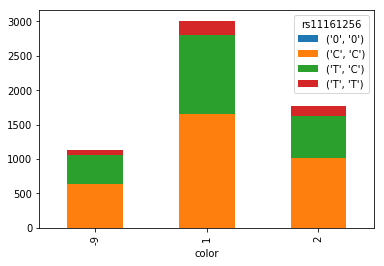

rs12911234


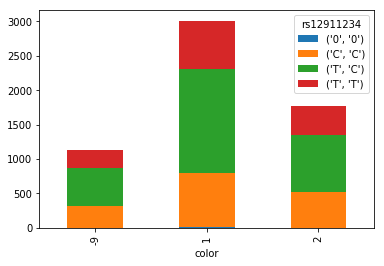

rs7182988


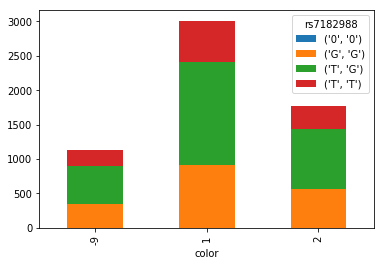

rs4906822


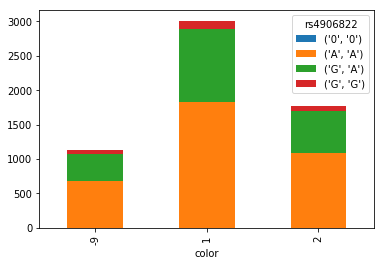

rs1511493


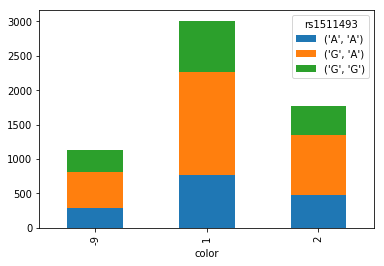

rs12903744


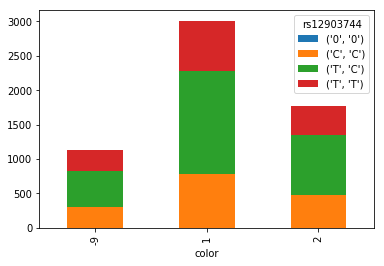

rs11161269


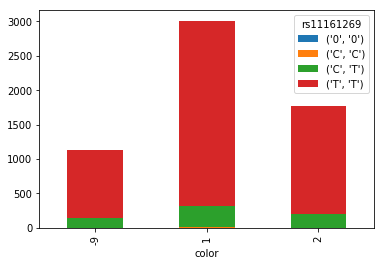

rs6576498


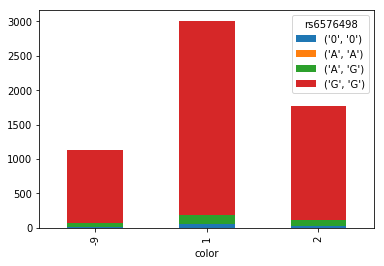

rs2055893


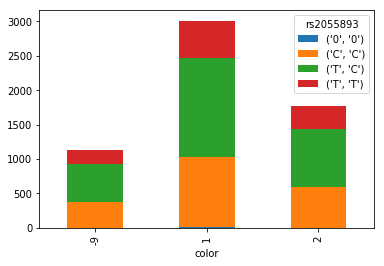

rs1511487


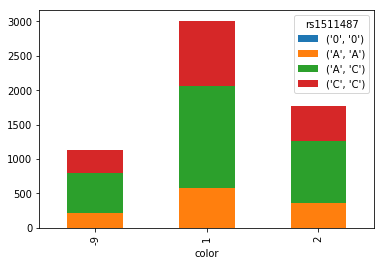

rs12910878


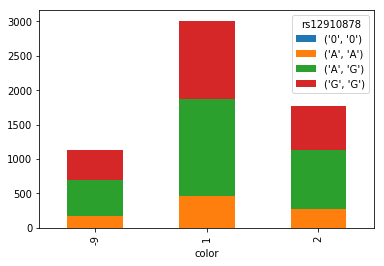

rs11635697


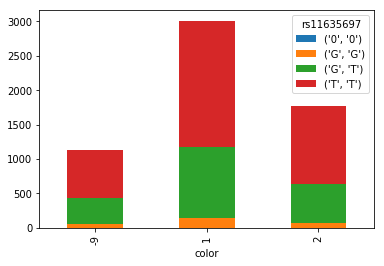

rs7178079


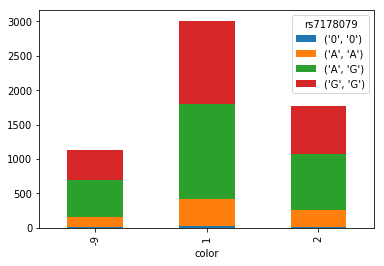

rs7163227


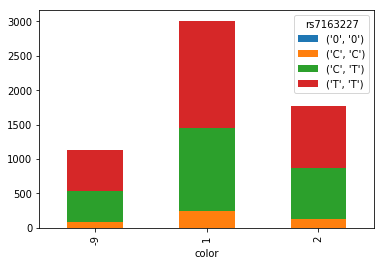

1KG_15_26260492


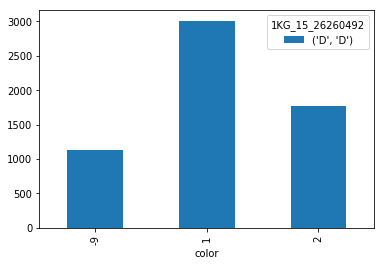

rs17557947


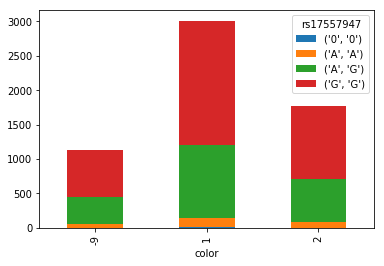

rs17116519


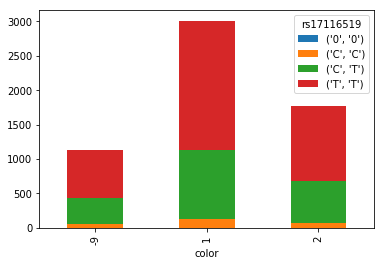

rs4906654


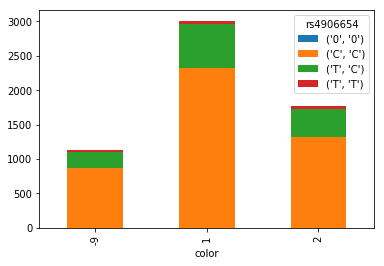

rs7164409


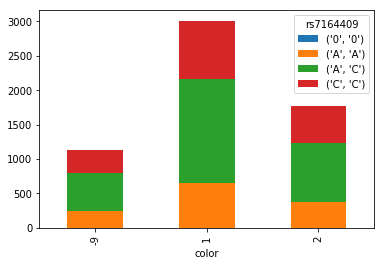

rs4906844


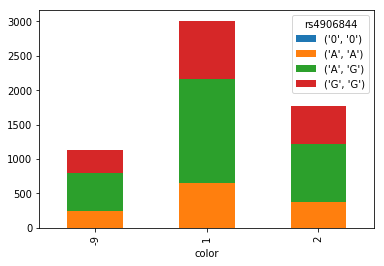

rs4243760


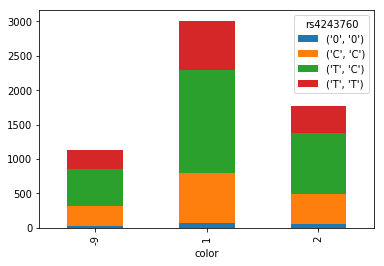

rs4906849


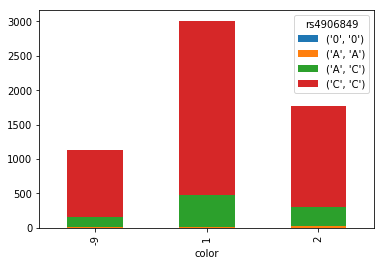

rs6576507


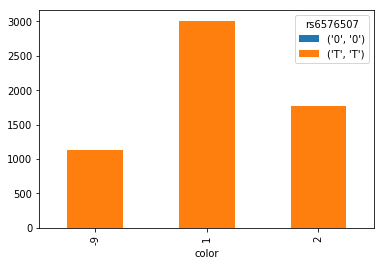

rs17644252


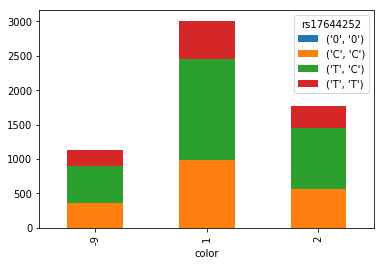

rs7173112


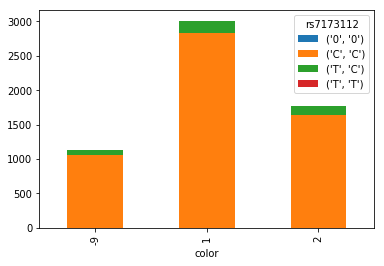

rs8042941


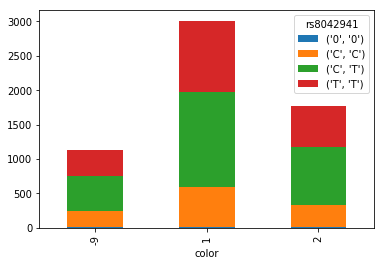

rs4906656


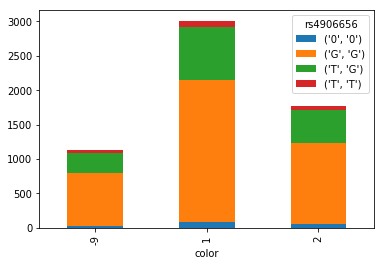

rs8024188


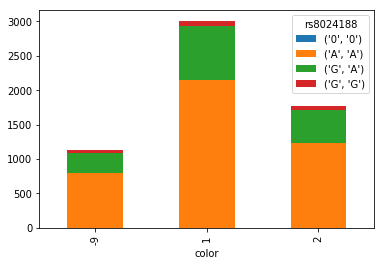

rs4313785


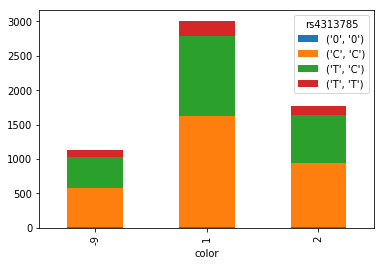

rs2030598


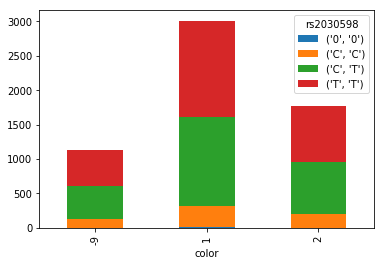

rs4254296


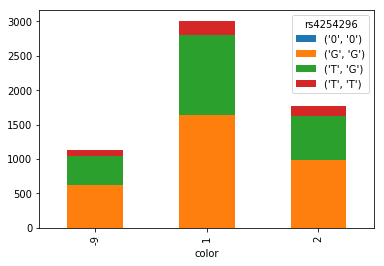

rs13329286


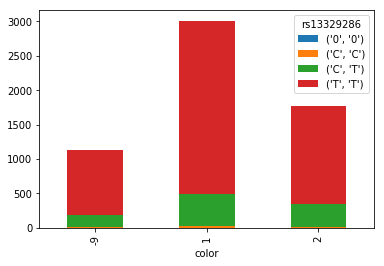

rs8025577


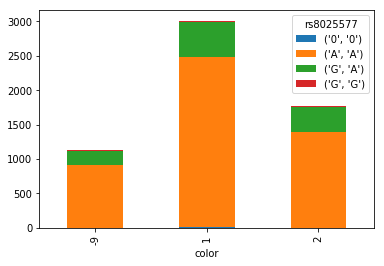

rs11854068


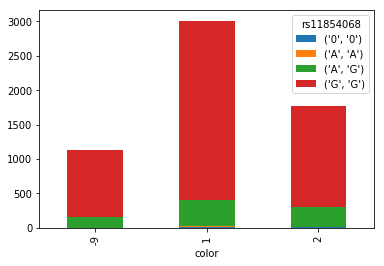

rs1880028


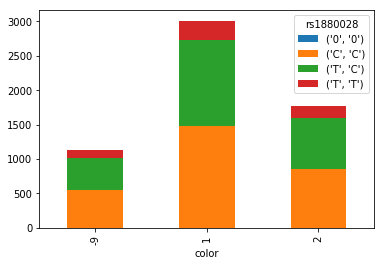

rs17644708


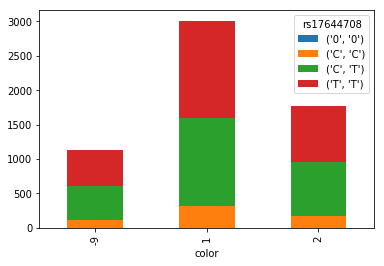

rs476730


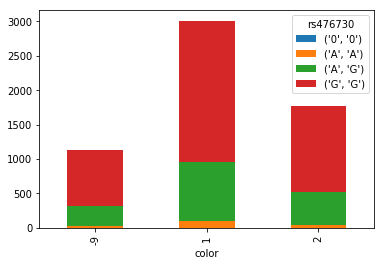

rs9806314


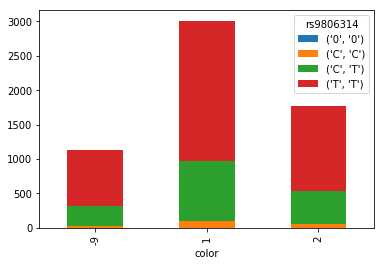

rs9635421


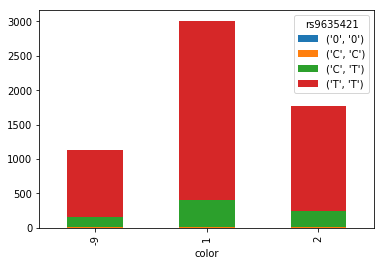

rs1435838


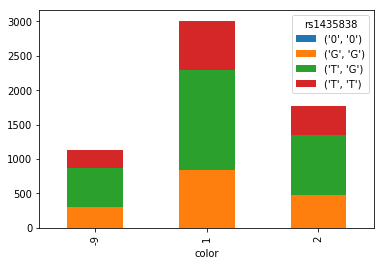

exm2272213


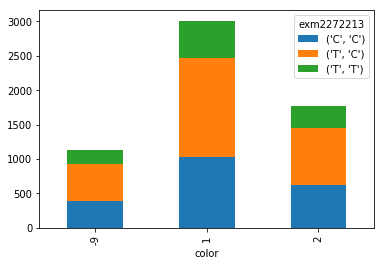

rs7175795


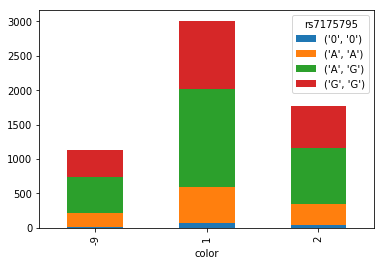

rs7176296


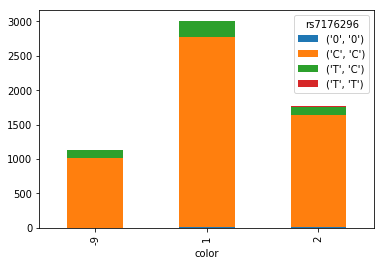

rs4906866


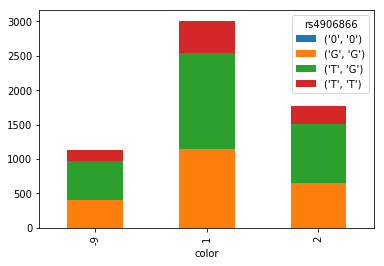

rs7169491


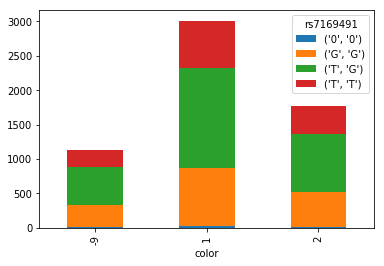

rs10083586


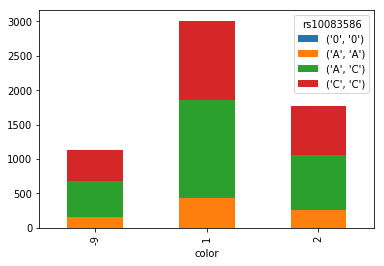

rs493028


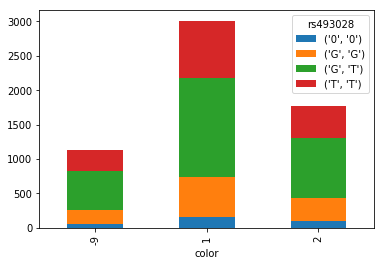

rs573075


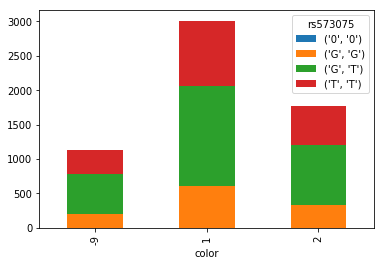

rs17116654


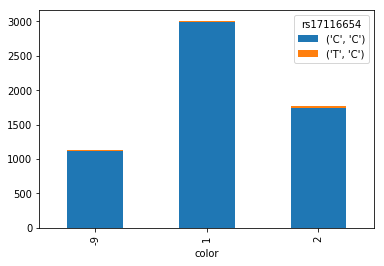

rs2217865


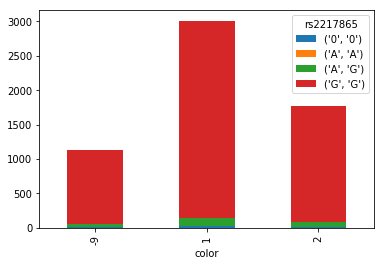

rs4617829


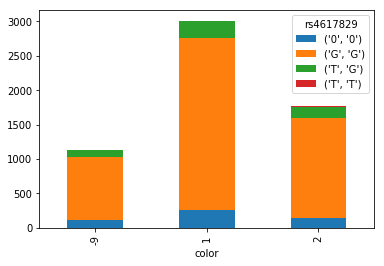

rs4396508


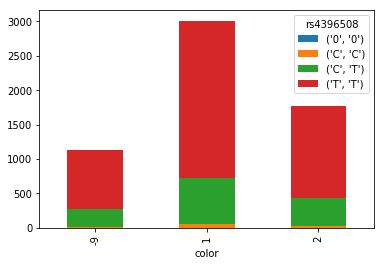

rs8026670


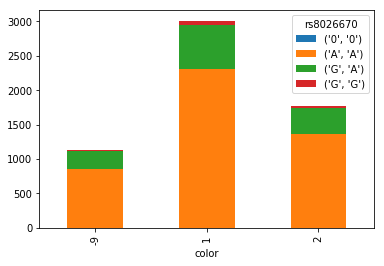

rs2715573


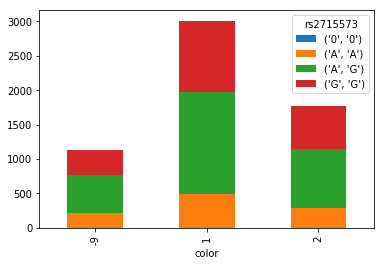

rs2573697


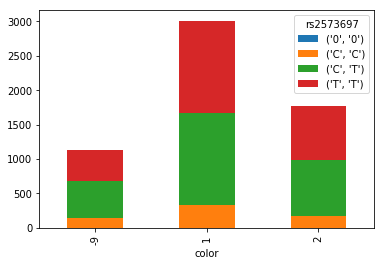

rs17669485


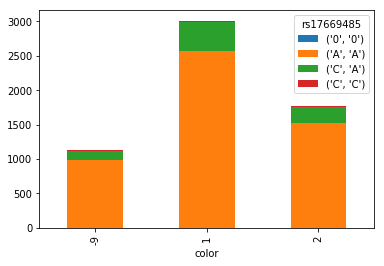

rs7167693


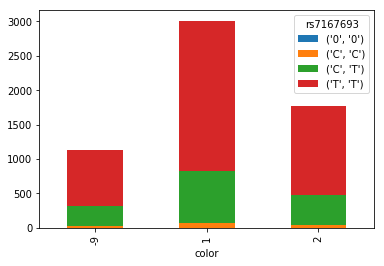

rs11488903


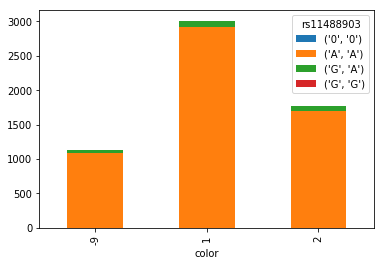

rs920114


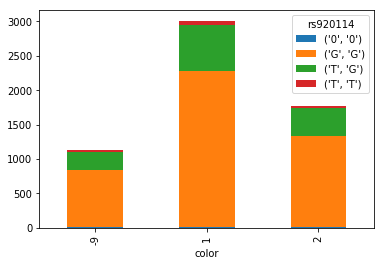

rs1435840


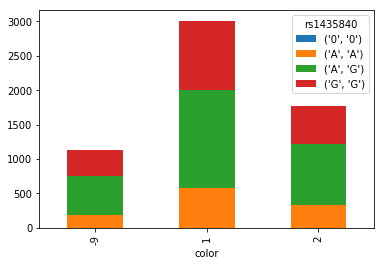

rs4906872


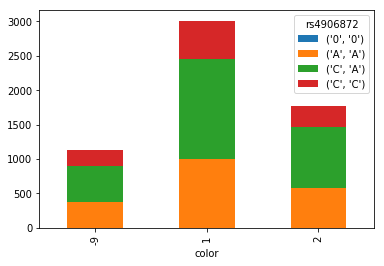

rs12912470


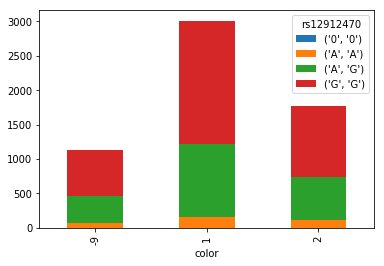

rs4073144


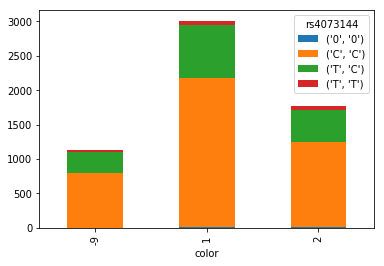

rs12903035


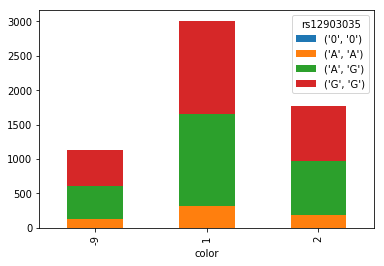

rs7171237


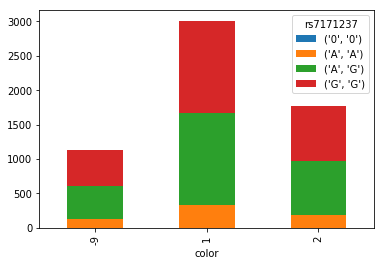

rs12914178


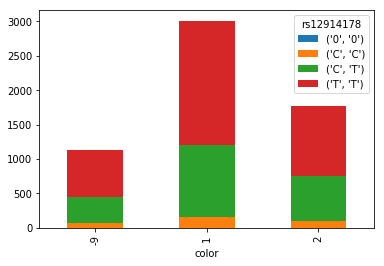

rs6576565


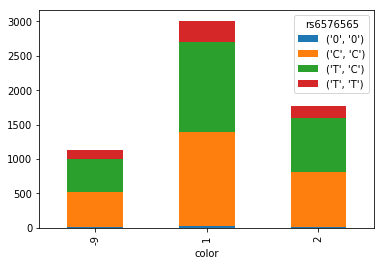

rs7163468


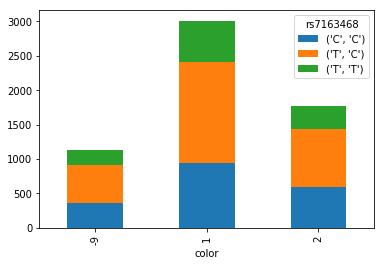

rs3922665


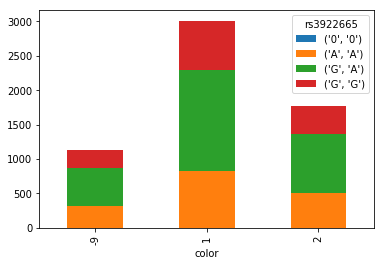

rs11853420


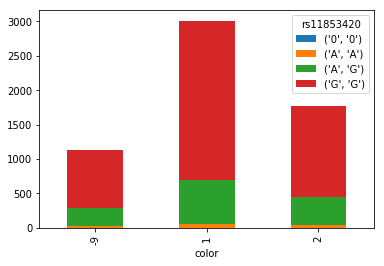

rs11630094


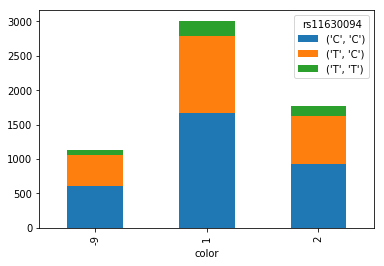

rs10431855


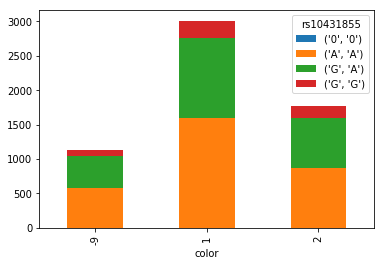

rs10431862


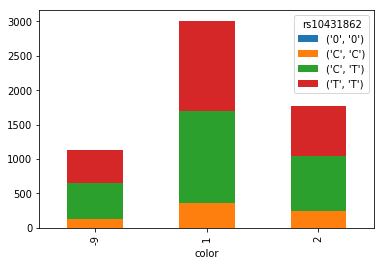

rs8038232


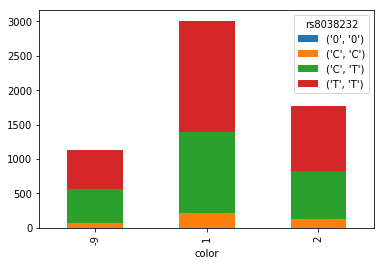

rs11637135


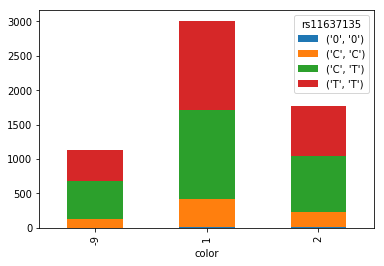

rs11632951


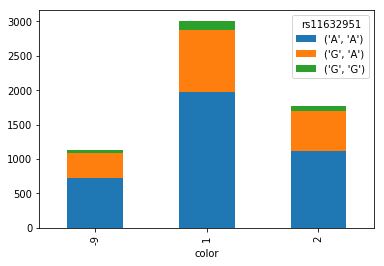

rs1365595


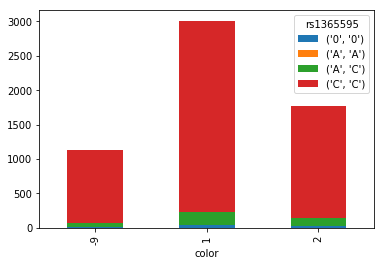

rs6576570


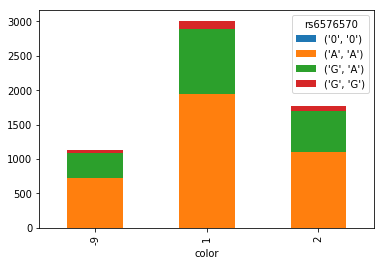

rs8027533


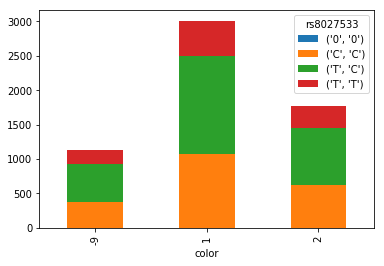

rs7167848


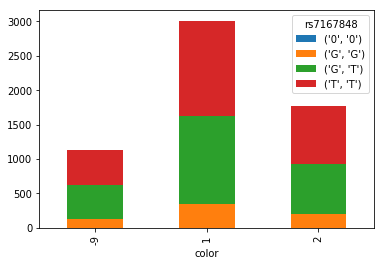

rs1426894


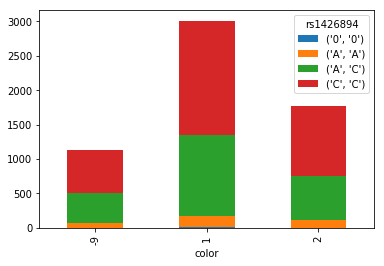

rs11161309


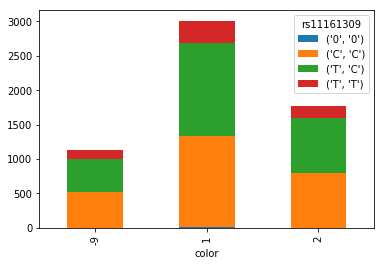

rs12917321


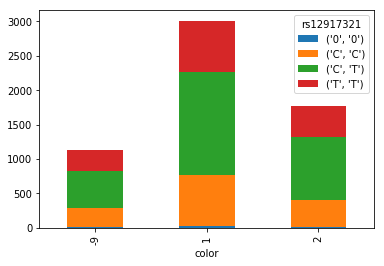

rs10873631


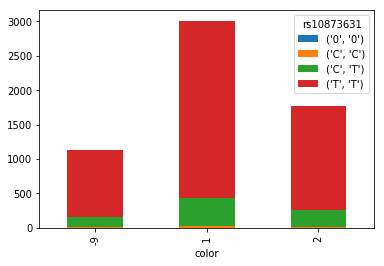

rs12440234


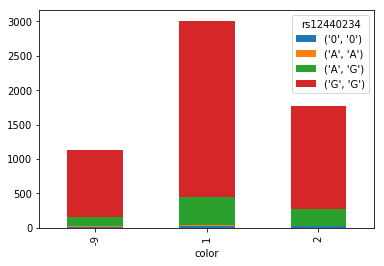

rs2928703


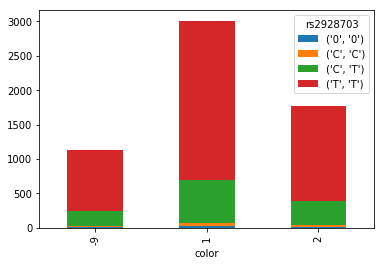

rs8027455


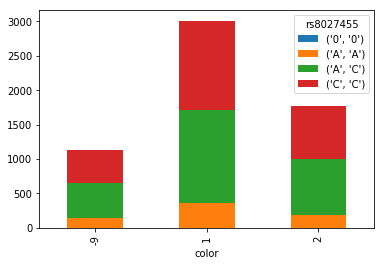

rs1593609


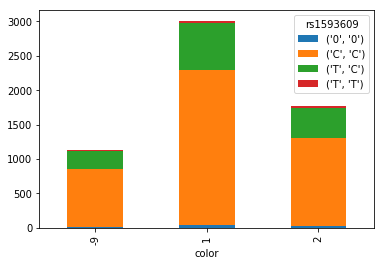

rs1365587


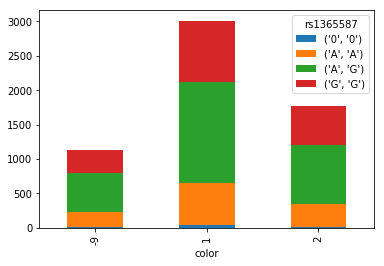

rs2928715


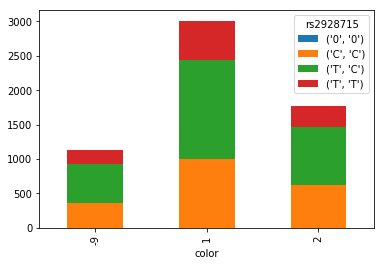

rs1896195


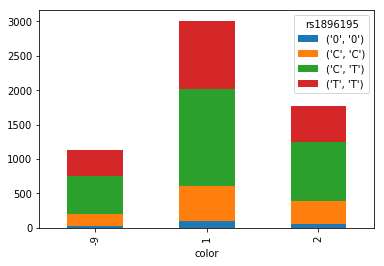

exm1825770


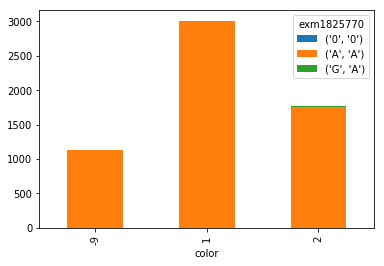

rs3751582


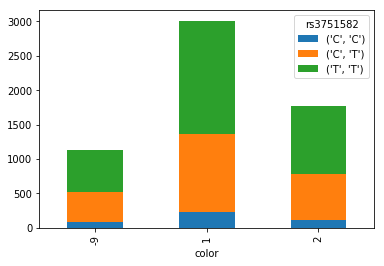

exm1142832


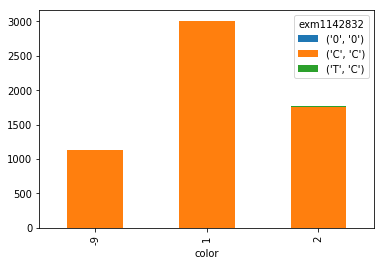

rs981347


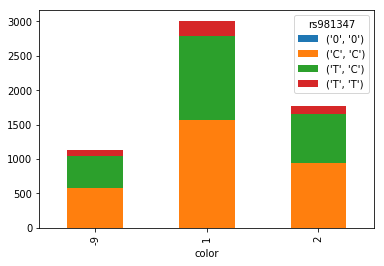

variant.34273


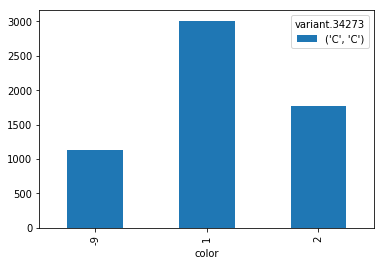

rs4906679


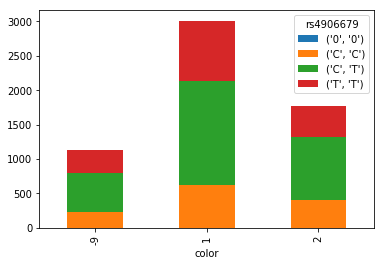

rs1426217


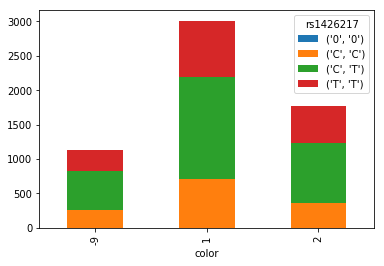

rs8024256


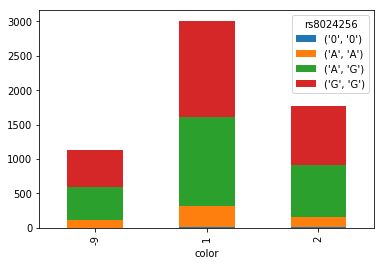

rs12910968


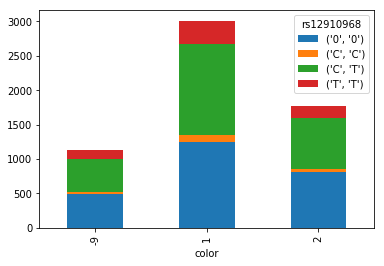

rs1426220


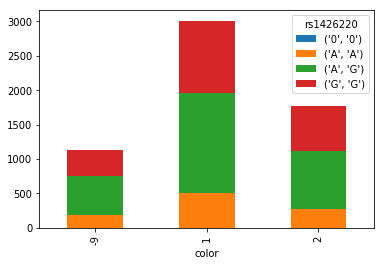

rs17117177


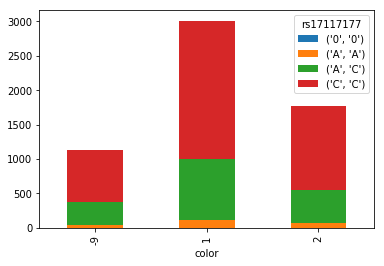

rs17646626


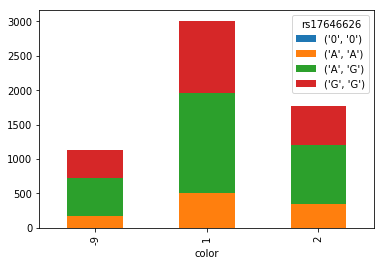

rs11856990


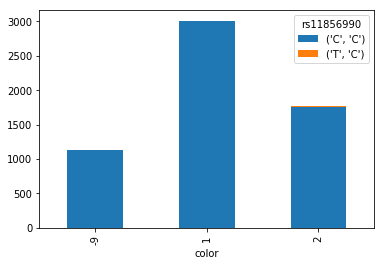

exm-rs10873636


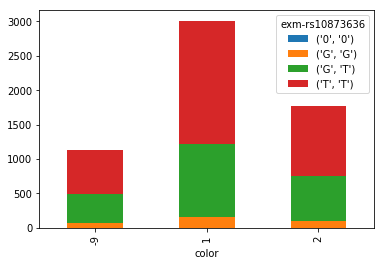

rs10873636


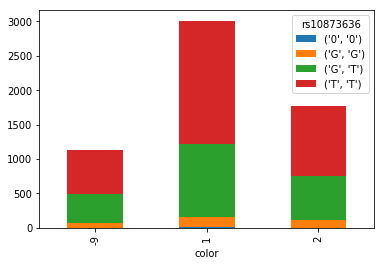

rs1863459


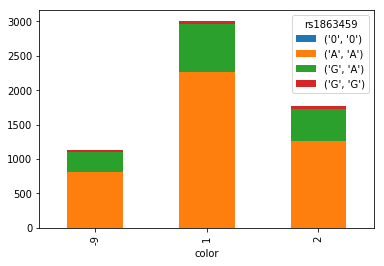

rs11629819


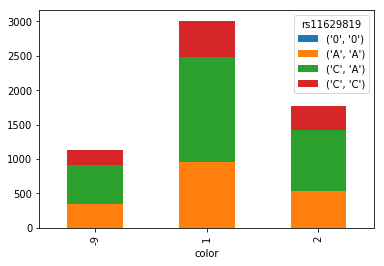

rs890319


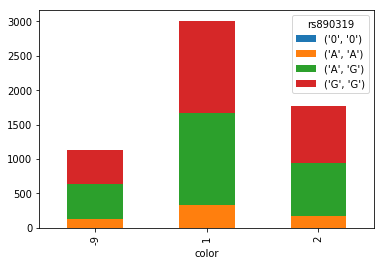

rs4906892


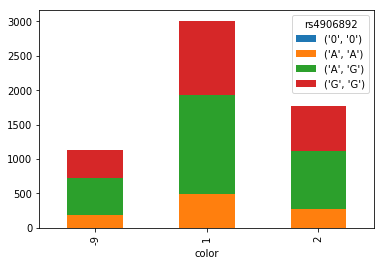

rs10873637


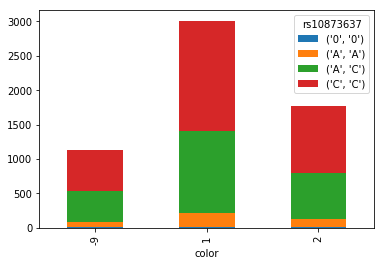

rs752414


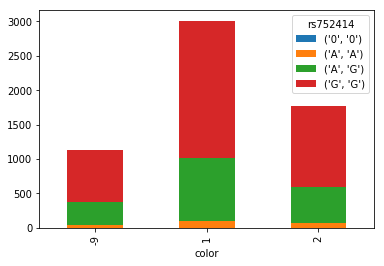

rs11161330


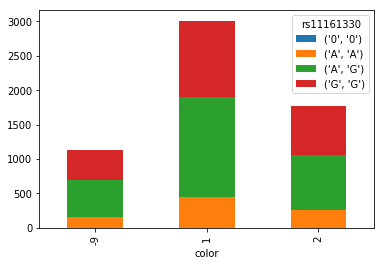

rs17738278


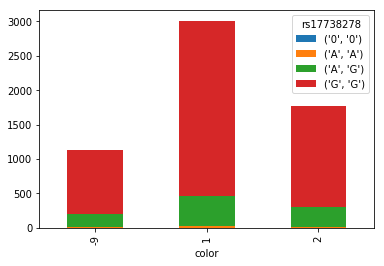

rs17738349


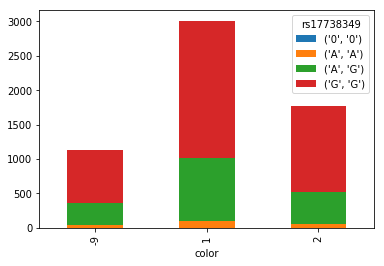

exm2272214


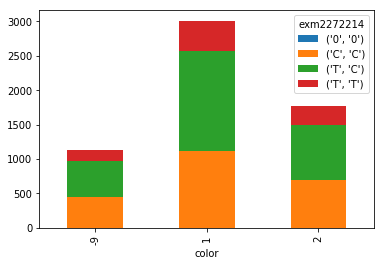

exm-rs8043440


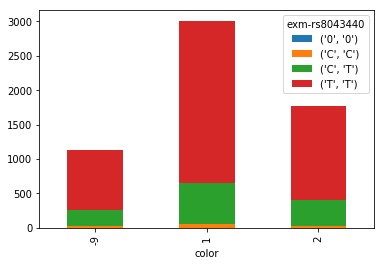

rs10519566


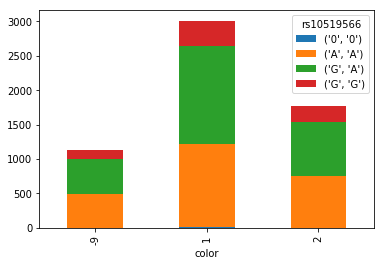

rs6576602


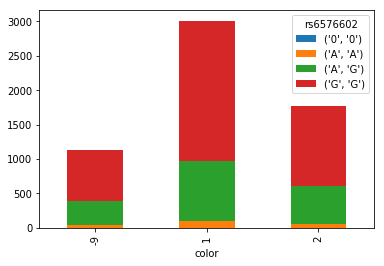

rs12437487


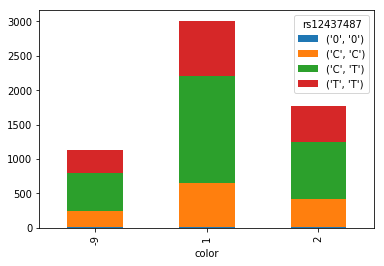

rs10152421


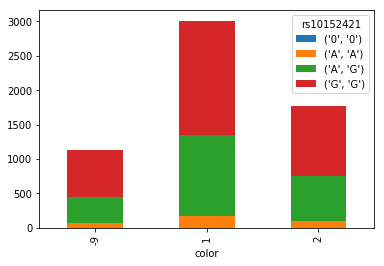

rs8038471


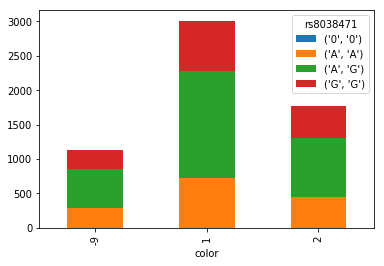

rs6576603


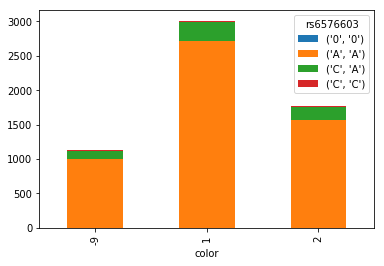

rs17117335


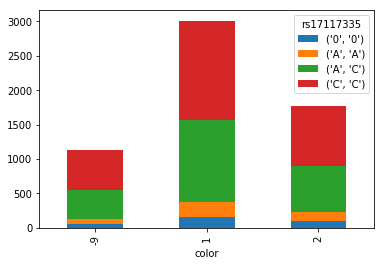

exm-rs3212335


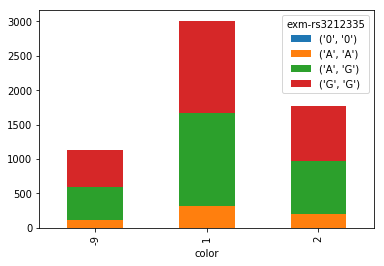

rs3212334


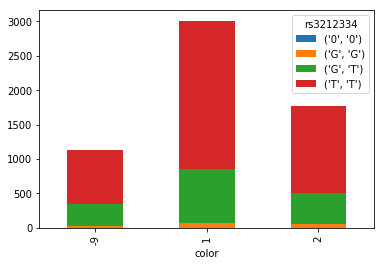

rs4486851


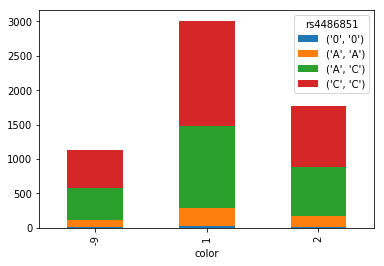

rs7168574


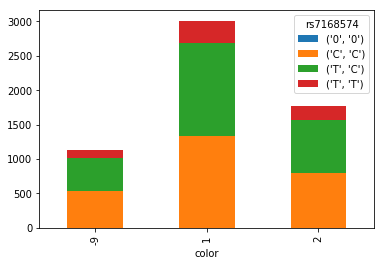

rs6576617


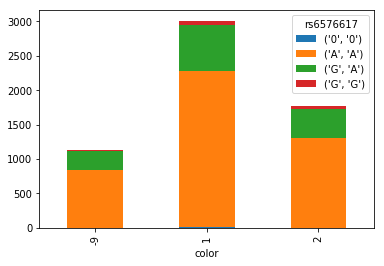

rs11629509


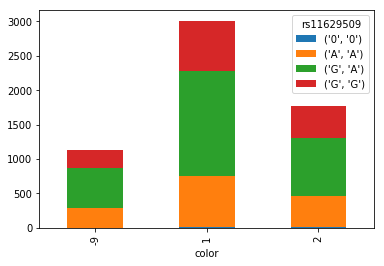

rs4517759


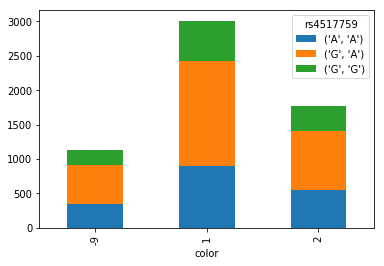

rs4491481


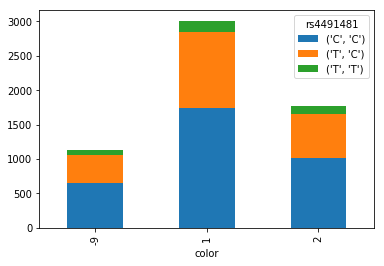

rs6576622


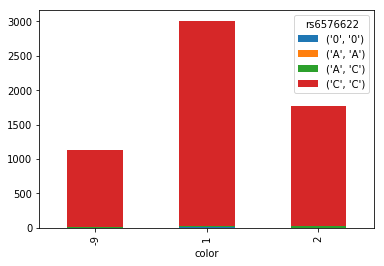

rs4906913


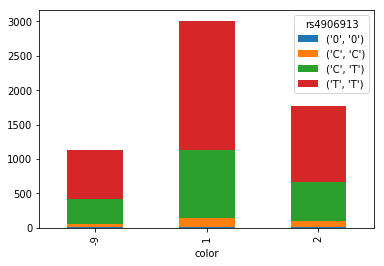

rs12441474


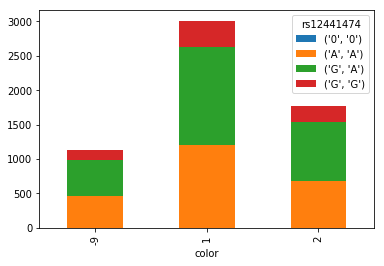

rs11637817


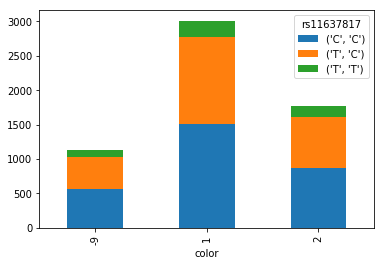

rs6576628


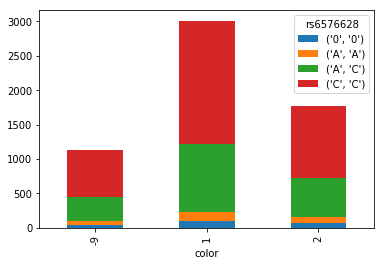

rs6576636


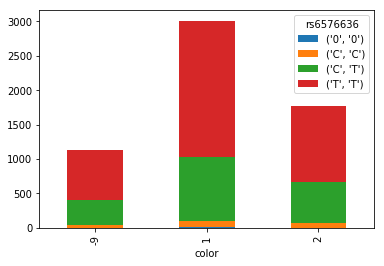

rs6576638


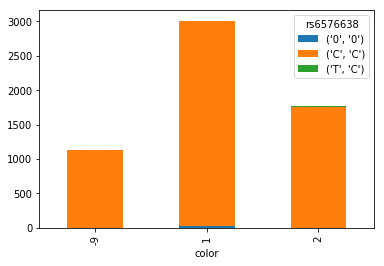

rs7496866


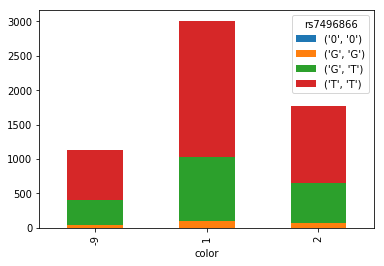

variant.34278


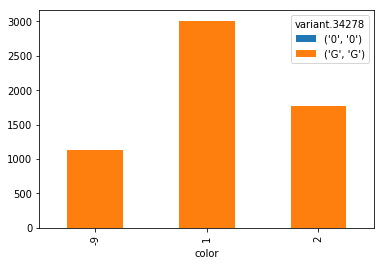

rs7173687


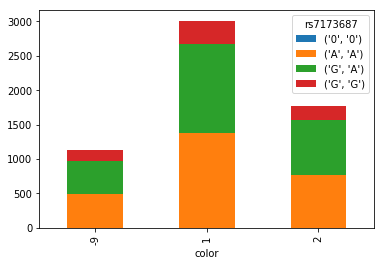

rs9286393


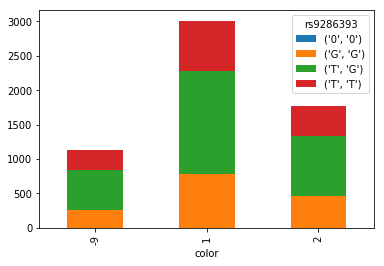

rs28426996


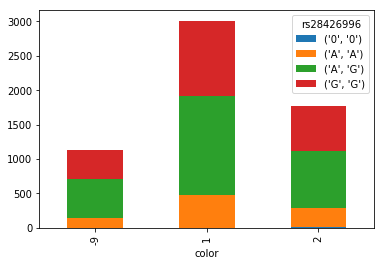

exm1142893


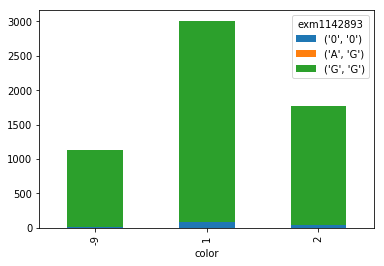

indel.34280


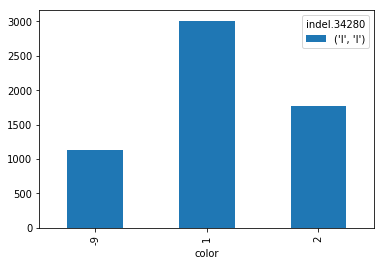

rs10519587


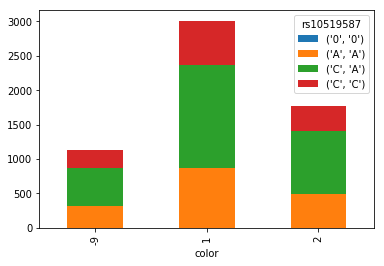

rs140684


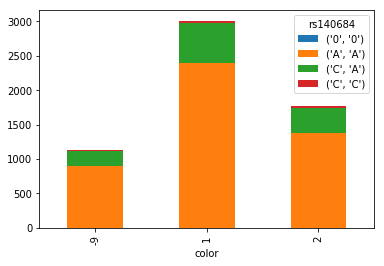

exm1142919


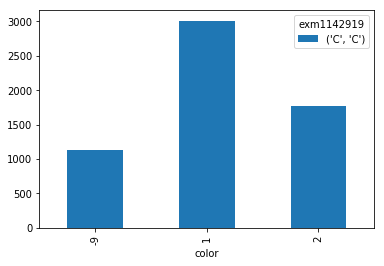

exm1142920


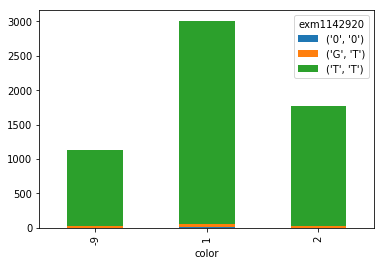

rs7183980


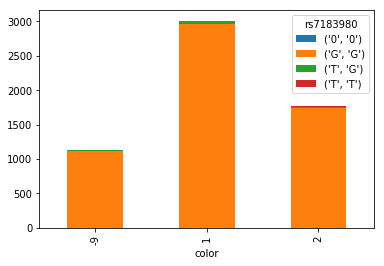

rs12185122


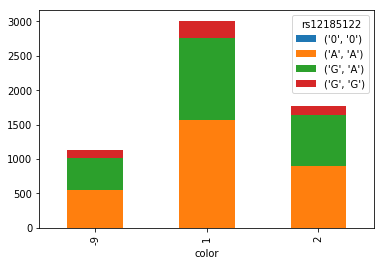

rs7403021


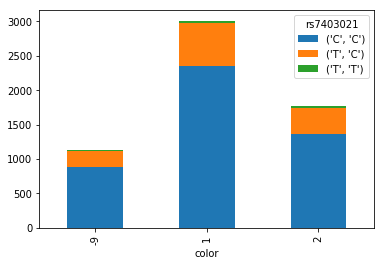

rs2376481


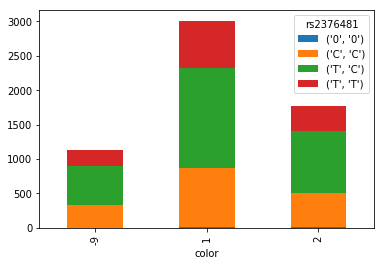

exm1142937


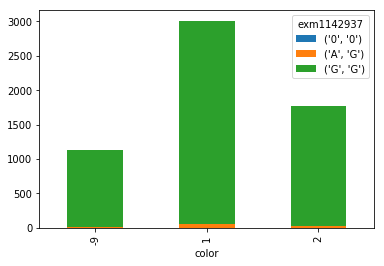

exm-rs1432133


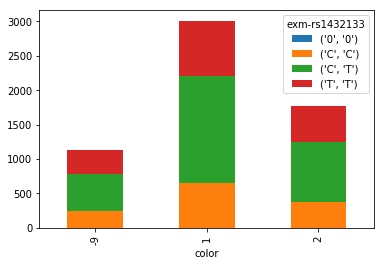

rs1432132


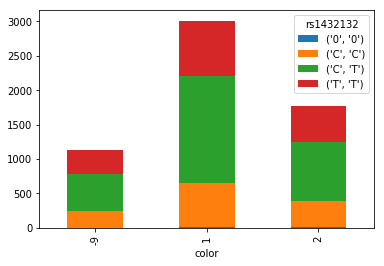

rs7495797


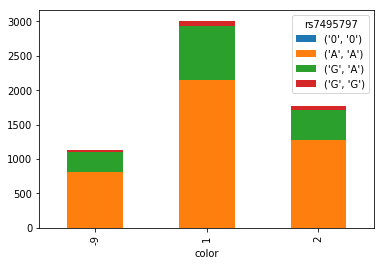

rs1368022


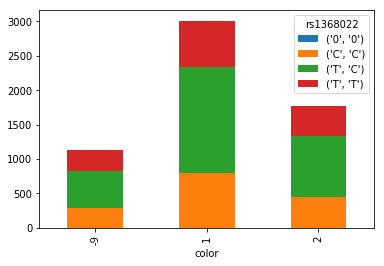

rs724456


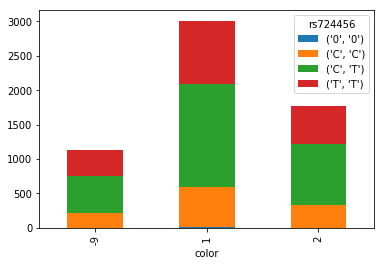

rs7167986


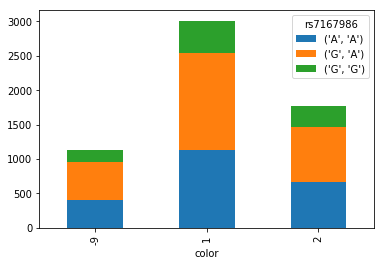

rs7168179


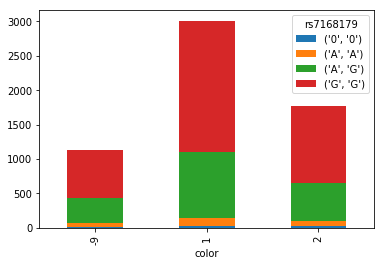

rs7403483


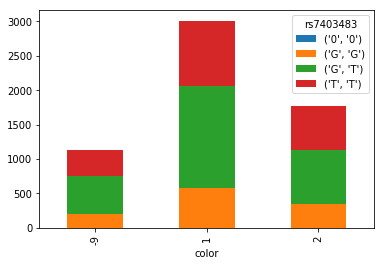

rs10519582


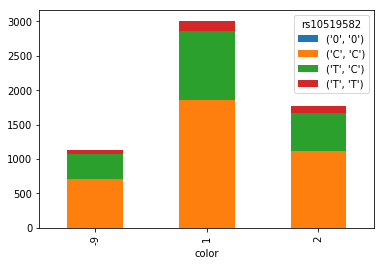

rs7171954


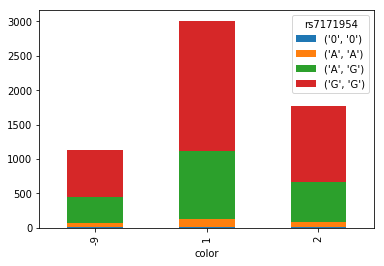

rs6606865


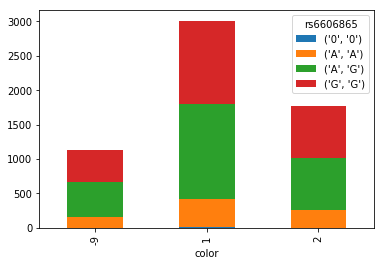

rs11263701


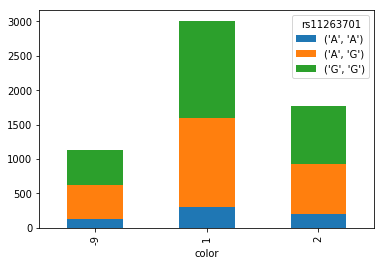

rs12913876


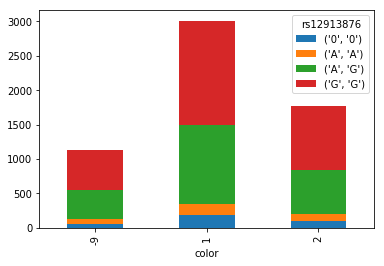

rs11852692


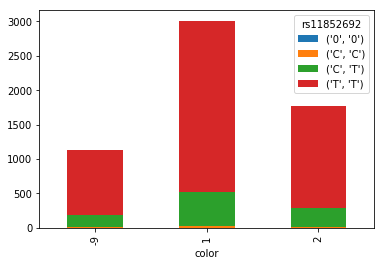

rs17648036


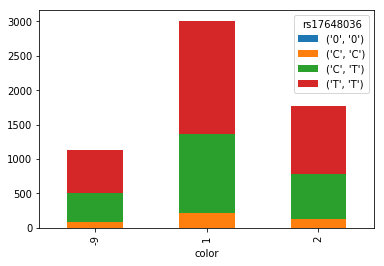

rs9330237


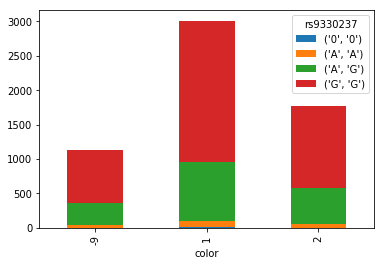

rs4887554


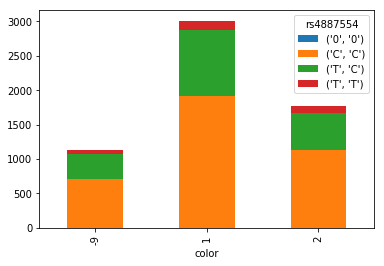

rs4887525


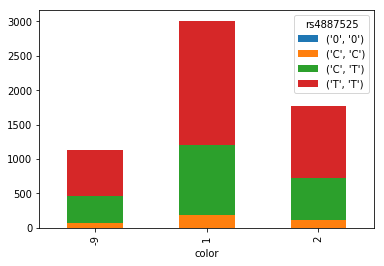

rs4354903


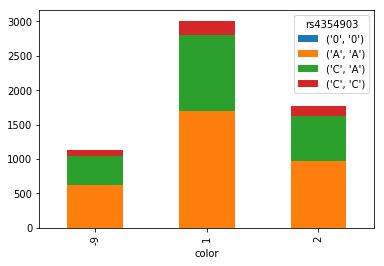

rs8036123


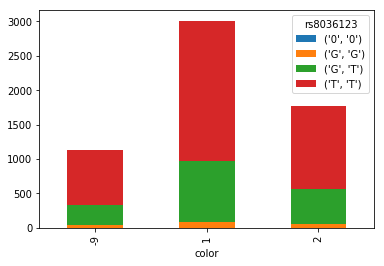

rs6606873


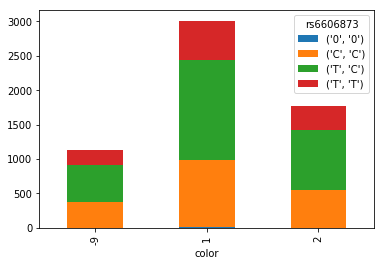

rs208177


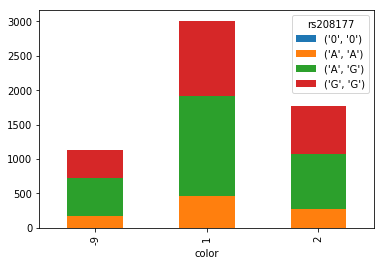

rs208176


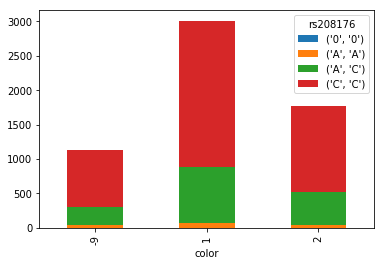

rs969754


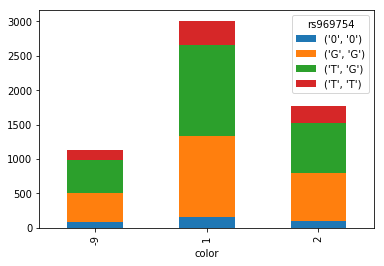

rs6606877


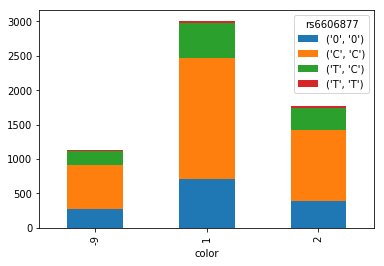

rs2376837


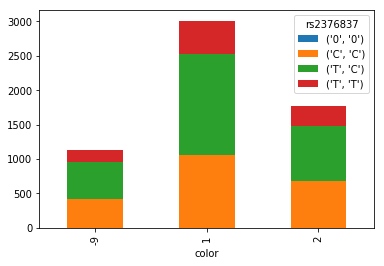

rs7495487


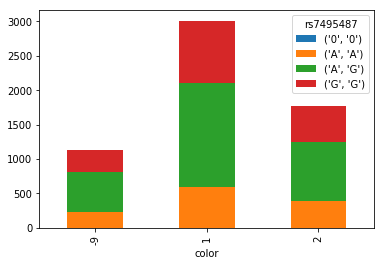

rs2045153


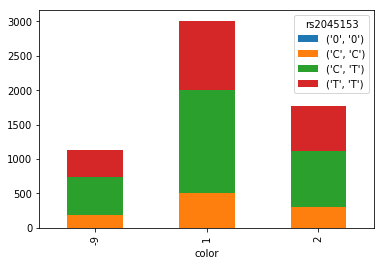

rs7402147


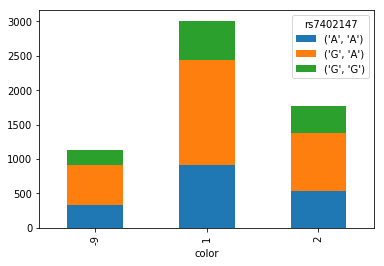

exm2272215


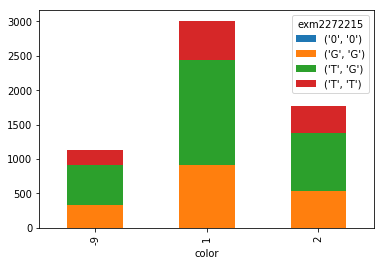

rs1378101


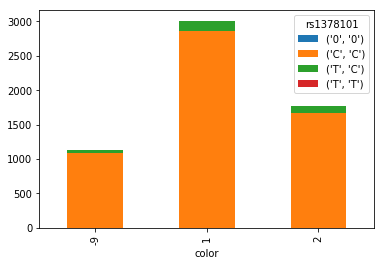

rs8030244


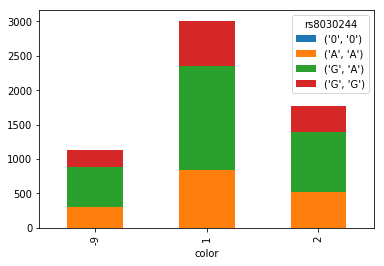

rs997140


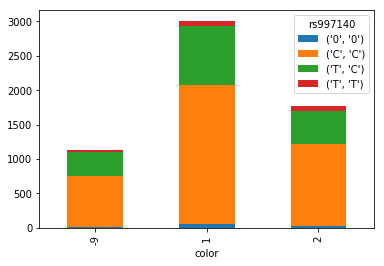

rs12907392


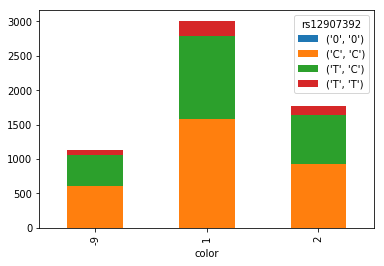

rs6422904


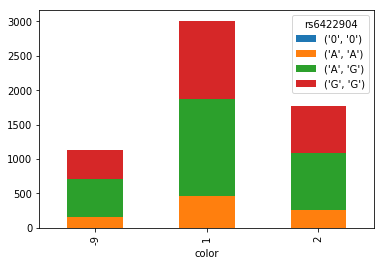

rs9972391


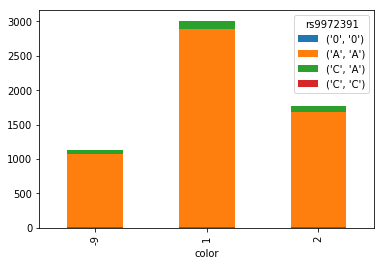

rs897173


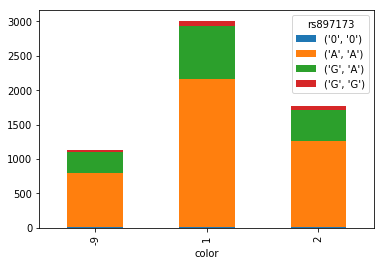

rs4243105


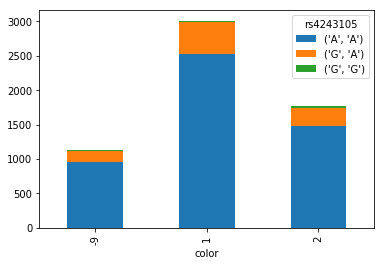

rs1026358


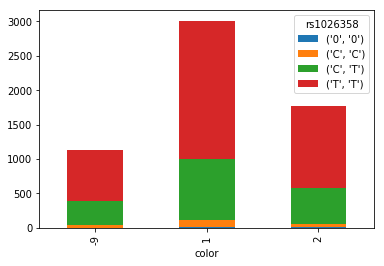

rs6606892


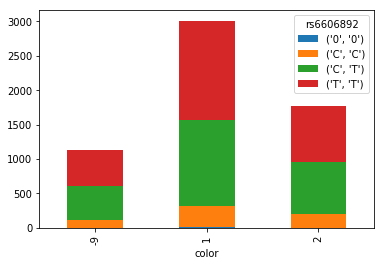

rs7174776


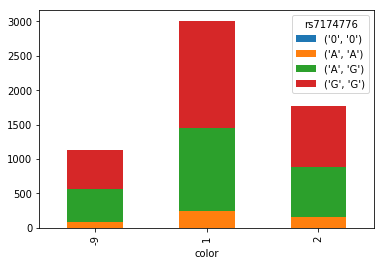

rs1869599


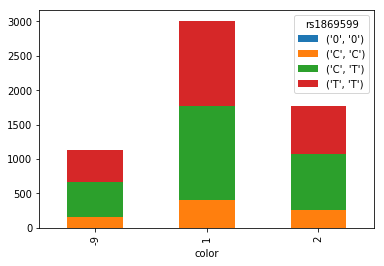

rs11263713


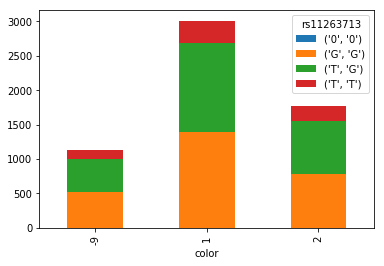

rs7177867


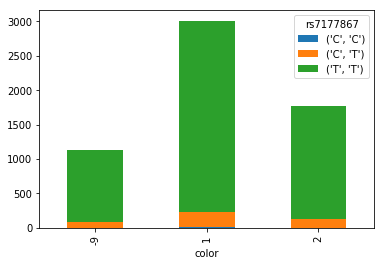

rs8037609


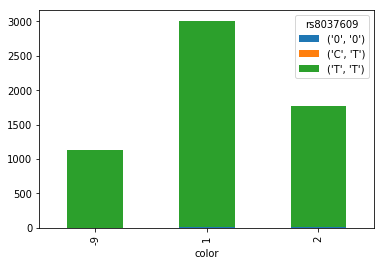

rs4600441


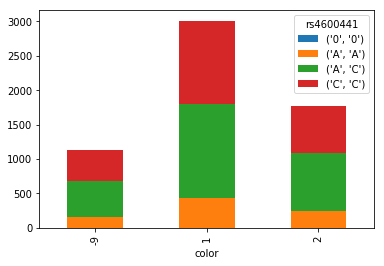

rs140672


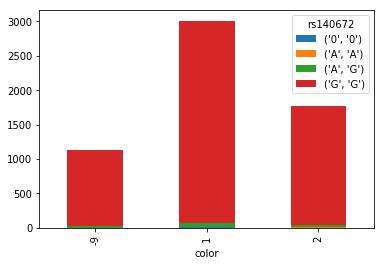

rs10083549


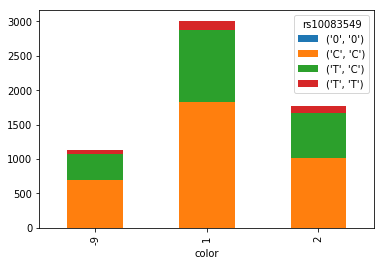

rs9672543


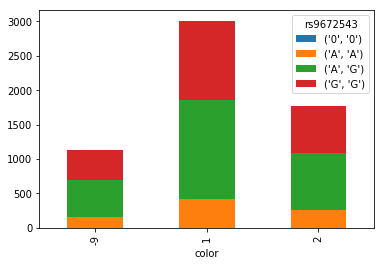

rs9635412


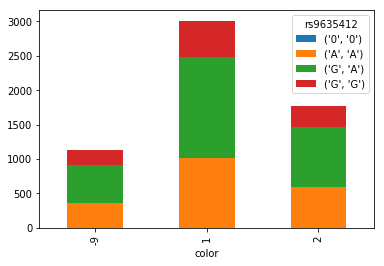

rs4238490


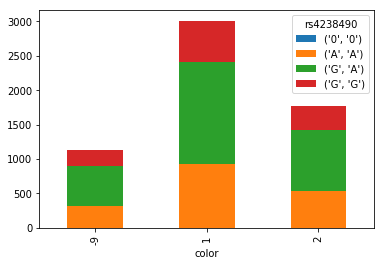

rs4132750


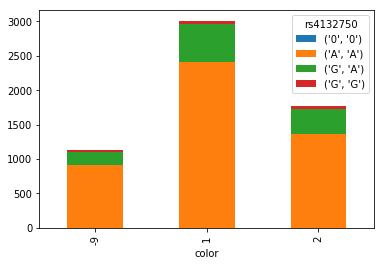

rs12595777


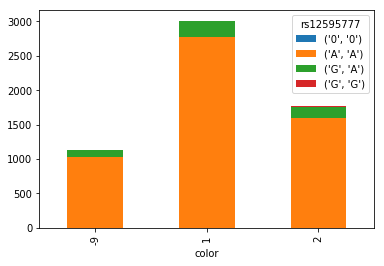

rs8030501


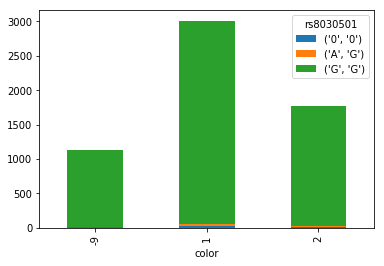

rs11074316


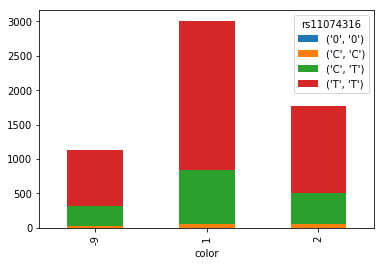

exm2260410


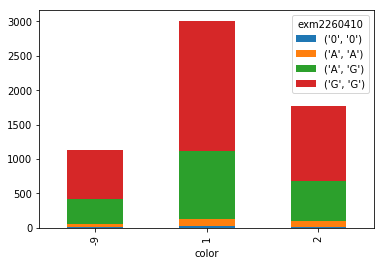

rs9920954


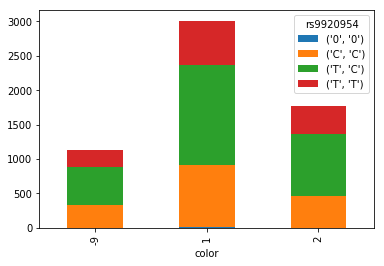

rs6497269


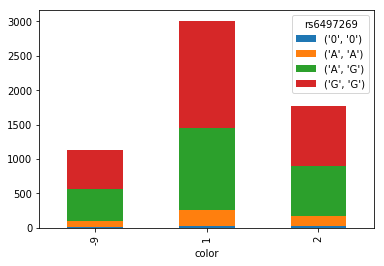

rs12906172


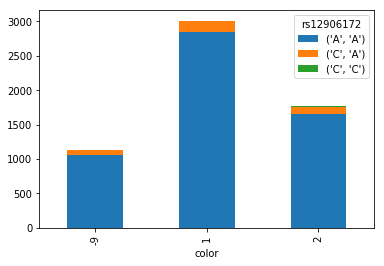

rs7167588


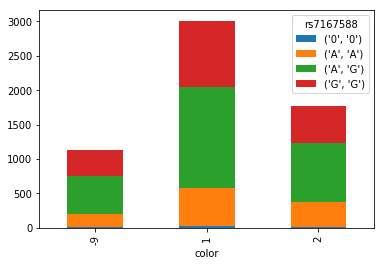

rs4778109


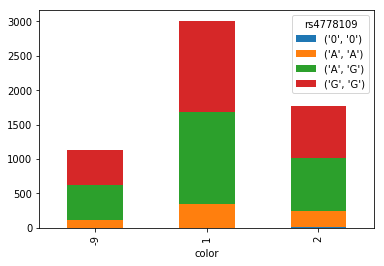

exm1142967


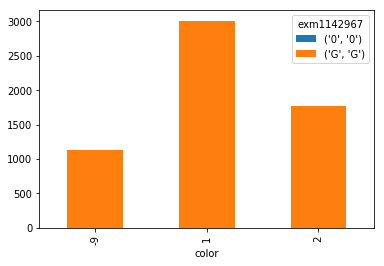

rs11638842


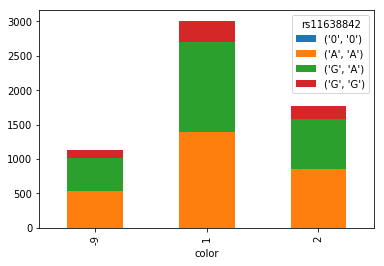

rs8027309


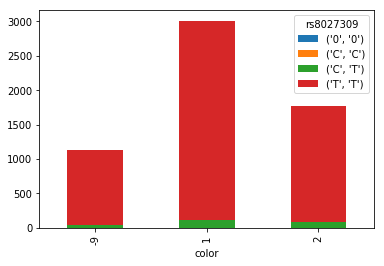

rs8027835


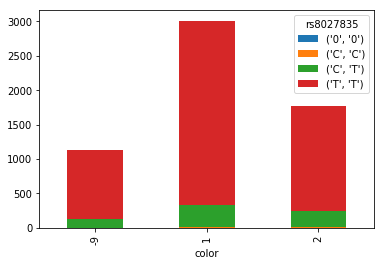

rs4778147


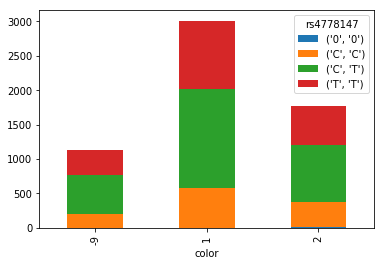

rs11635983


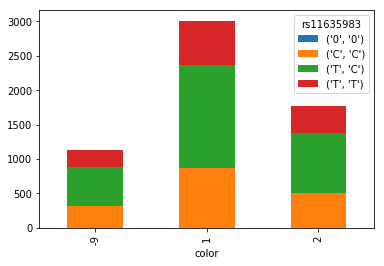

exm1142973


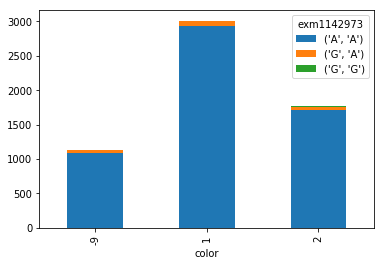

exm1142976


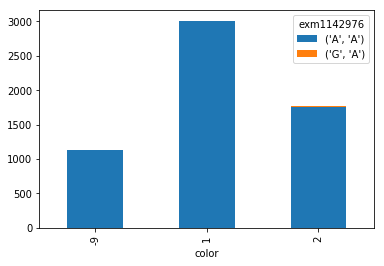

exm1142979


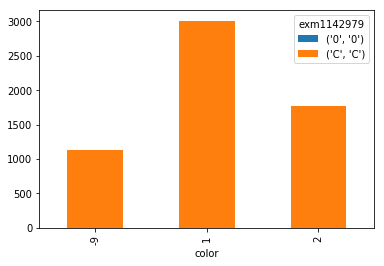

exm1142986


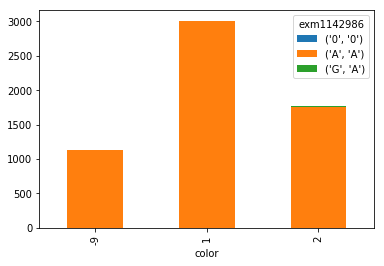

exm-rs715467


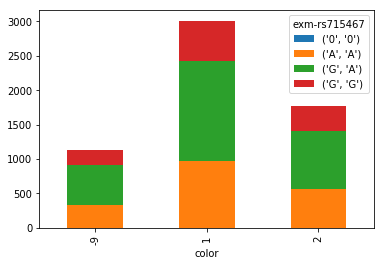

rs10852212


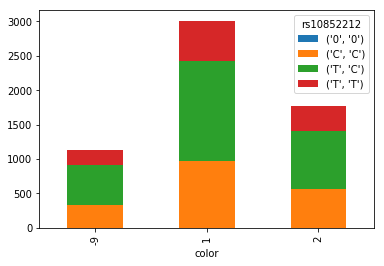

rs3097473


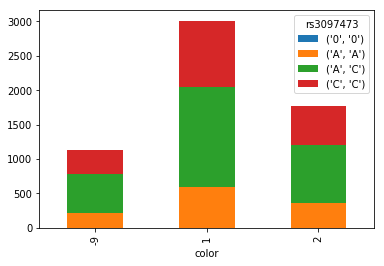

exm2267752


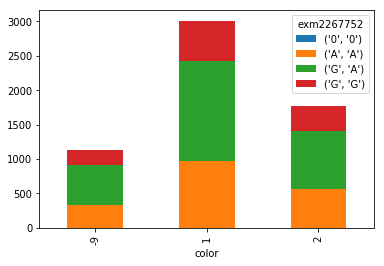

rs3098538


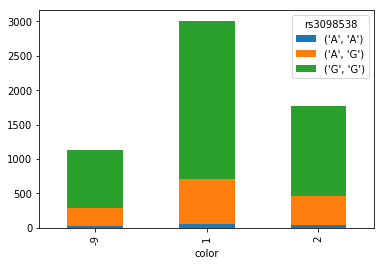

rs7165441


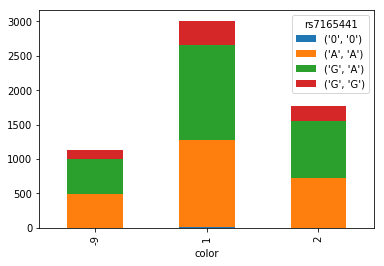

rs3098532


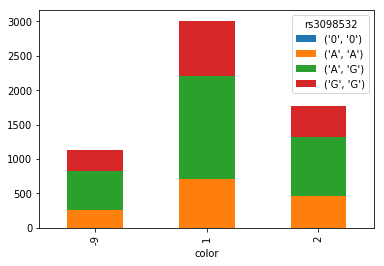

rs1531502


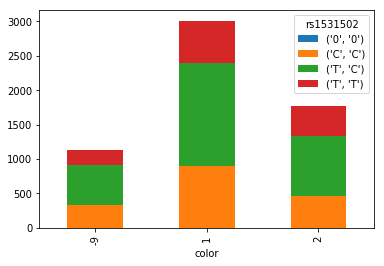

rs1812315


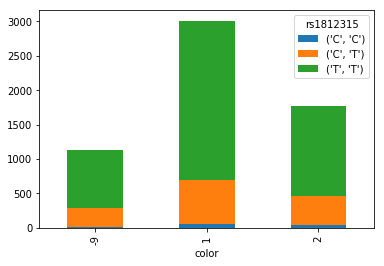

rs1551872


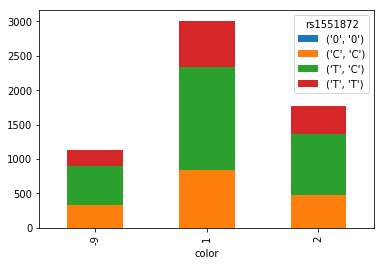

rs2126706


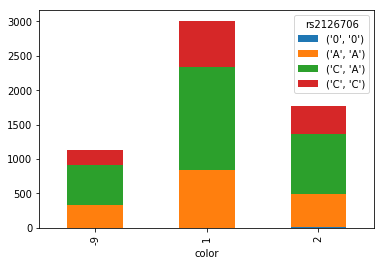

rs1477818


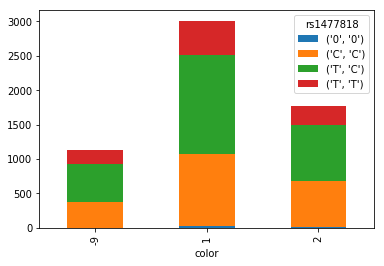

rs12908692


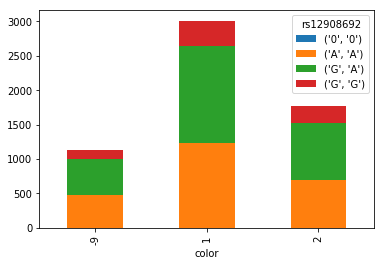

rs3097437


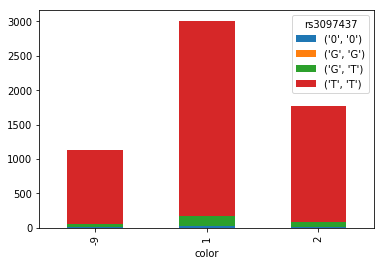

rs3098547


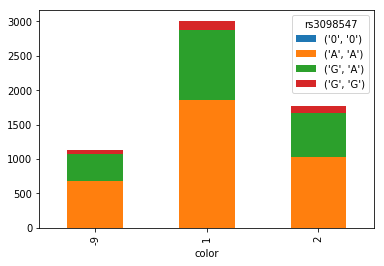

rs16950272


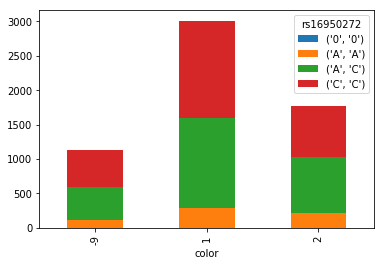

rs6497218


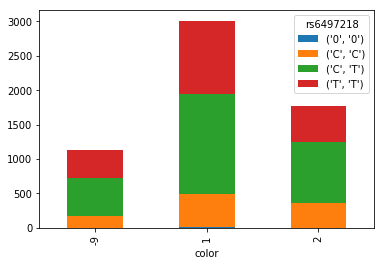

rs2086042


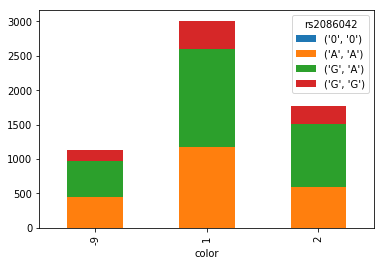

exm-rs1871017


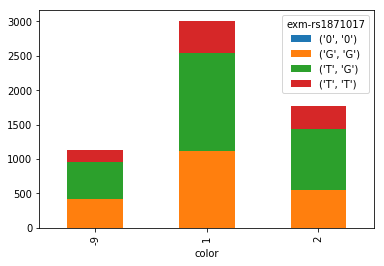

rs1871017


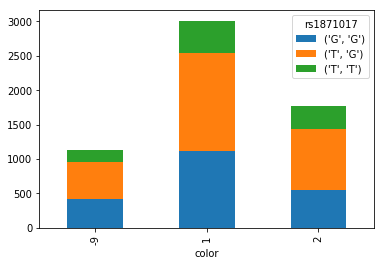

rs1947747


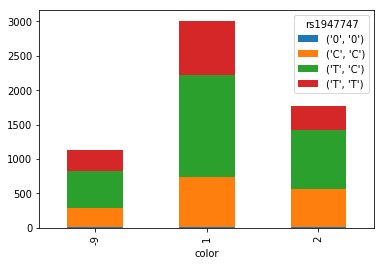

rs1968813


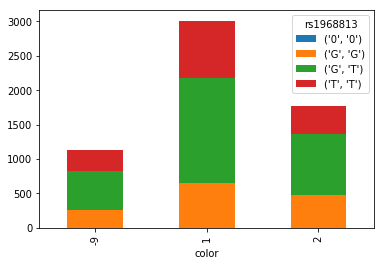

rs9972608


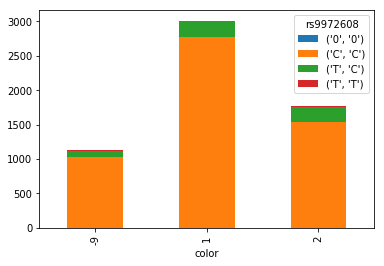

rs3097533


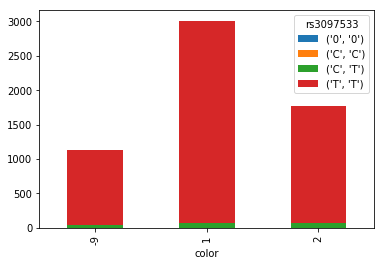

rs3097531


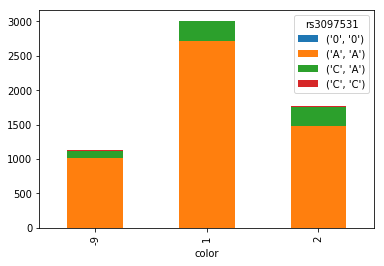

rs1382054


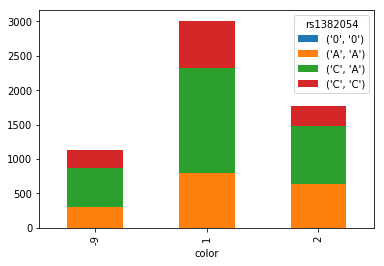

rs3098583


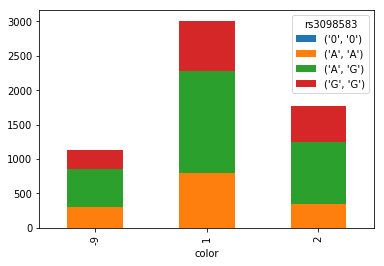

rs3104510


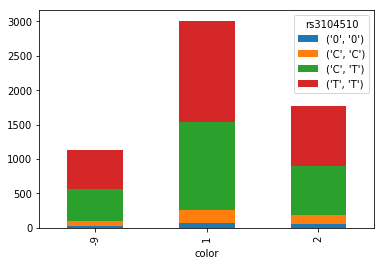

rs7180489


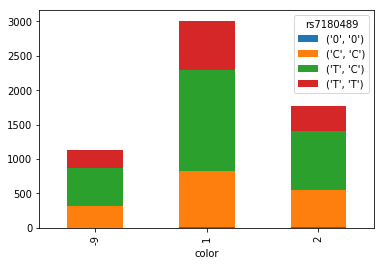

rs3101649


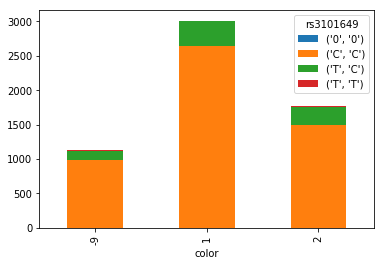

rs3101648


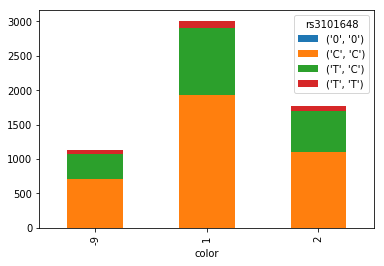

rs12592963


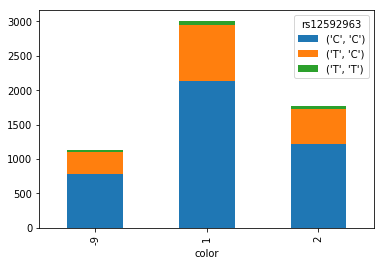

rs1603785


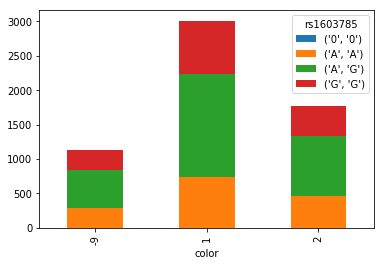

rs8023543


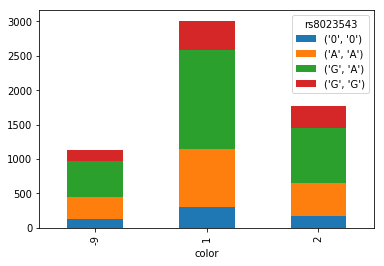

rs3110489


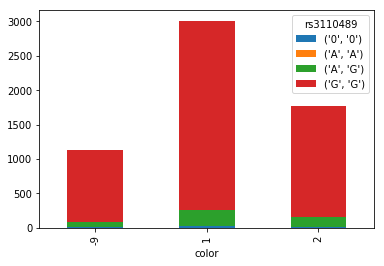

rs8031442


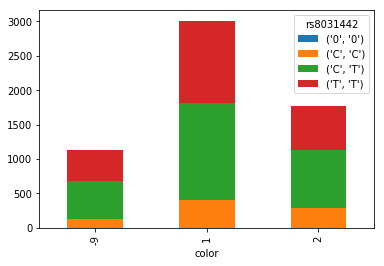

rs16950385


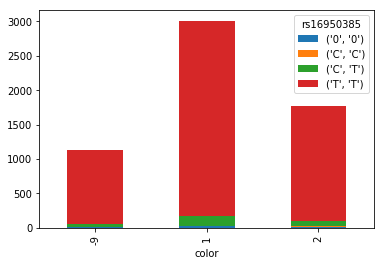

rs17565757


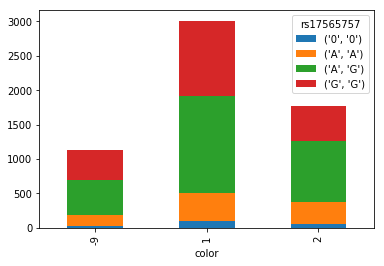

rs4322616


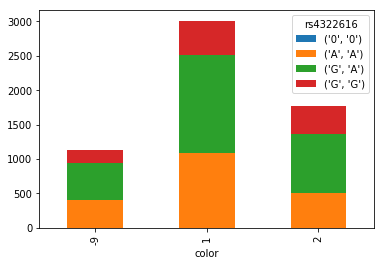

rs2871772


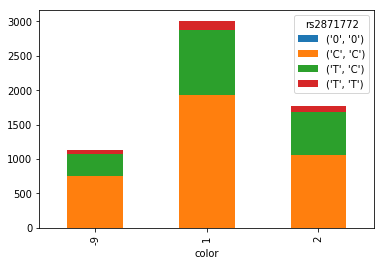

exm-rs17565841


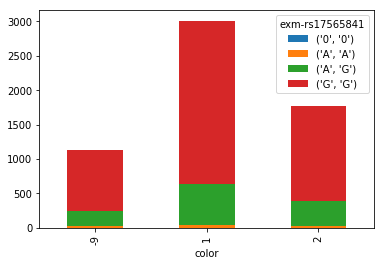

rs112155098


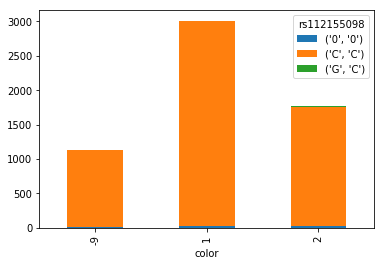

rs75043266


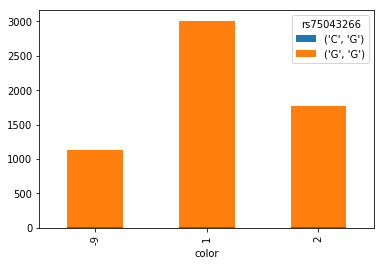

rs111782177


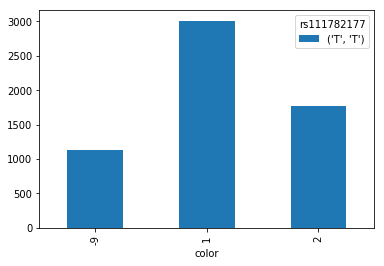

rs111864417


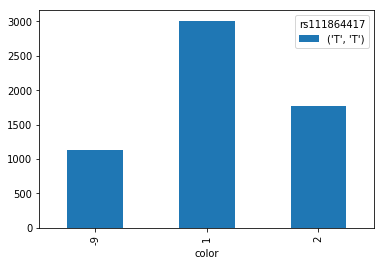

rs190819188


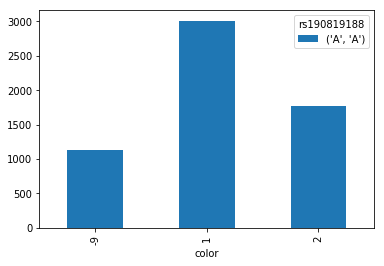

rs151210258


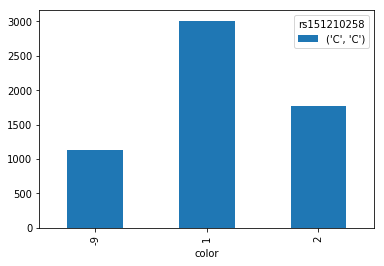

rs182290687


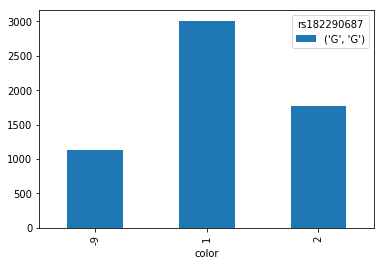

rs187757375


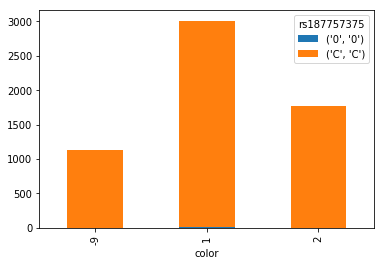

rs192734230


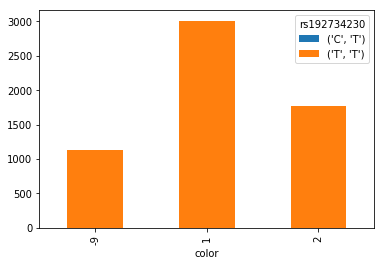

rs7175266


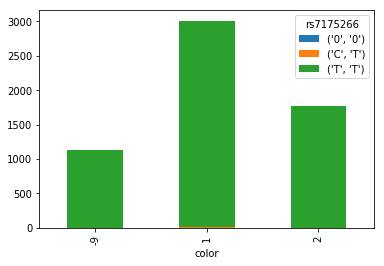

rs200732154


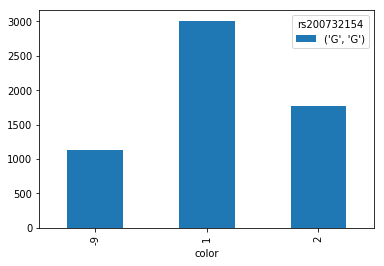

rs138228425


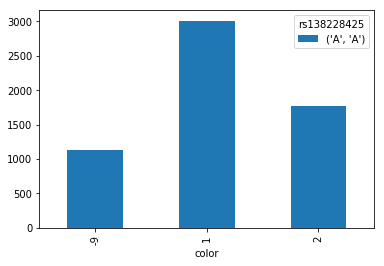

exm1142992


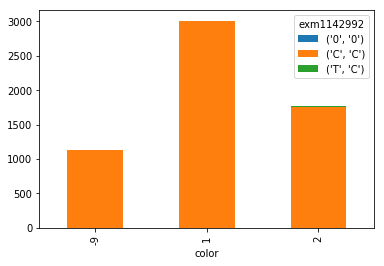

rs183101063


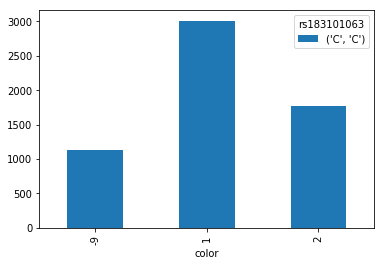

rs11074304


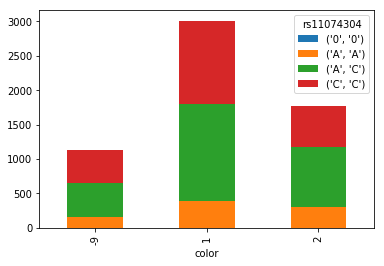

rs7164752


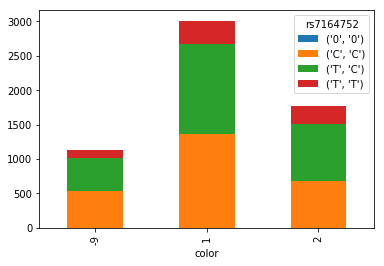

rs1603784


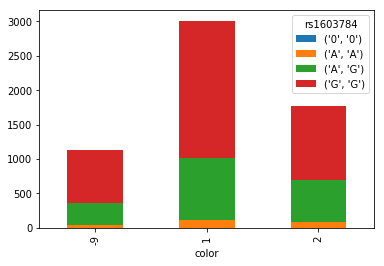

rs989869


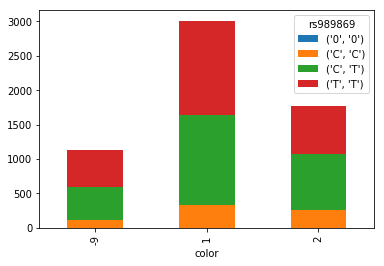

rs11637518


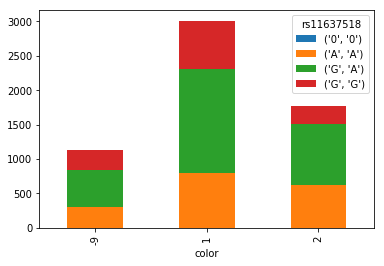

rs1498519


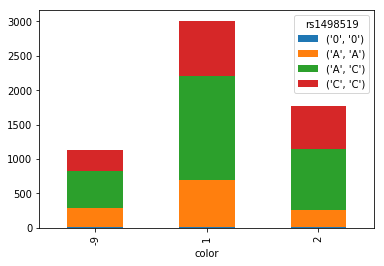

rs4778179


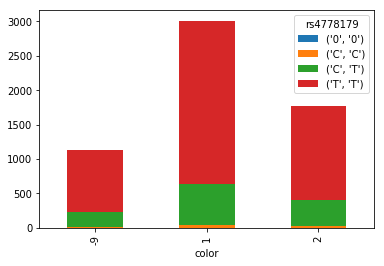

rs3947367


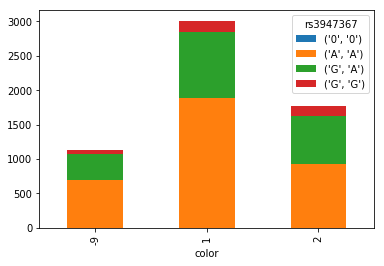

rs2279728


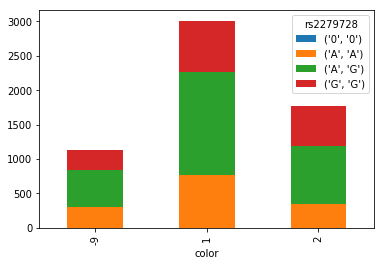

rs11631195


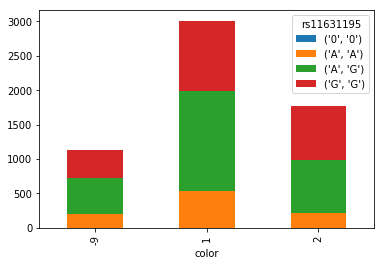

rs1498509


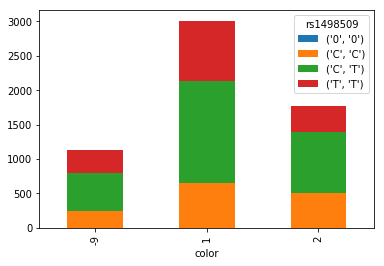

rs17674017


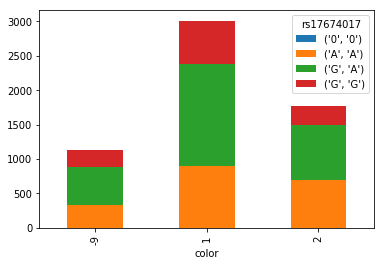

rs12592159


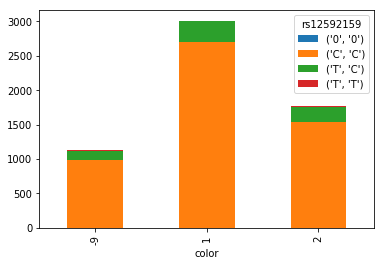

rs6497233


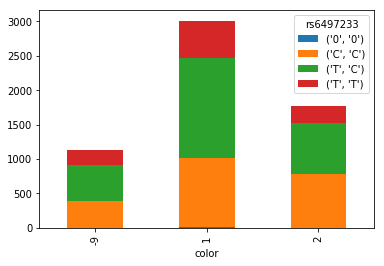

rs11074306


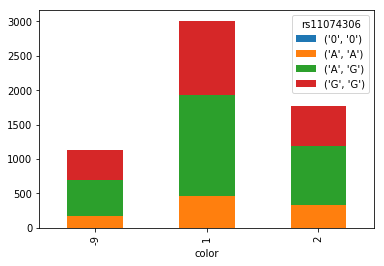

rs6497235


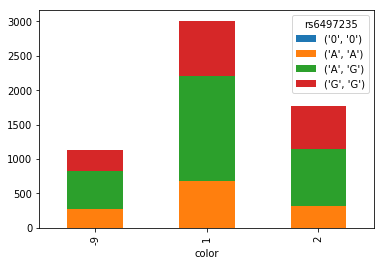

rs6497238


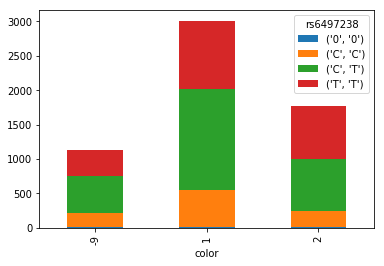

rs7183532


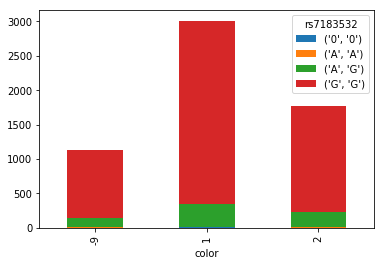

rs4778192


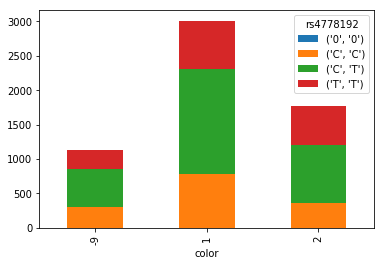

rs8035334


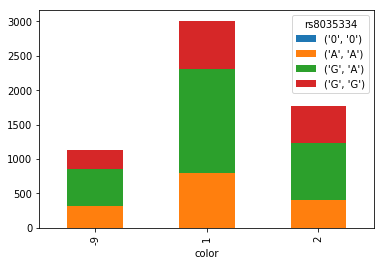

rs11858340


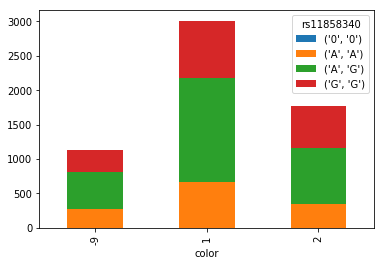

rs11852452


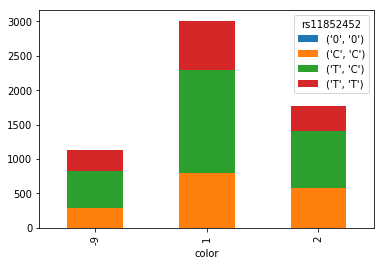

rs2311470


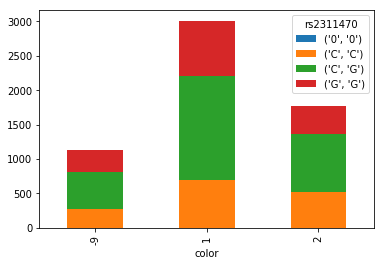

rs1018105


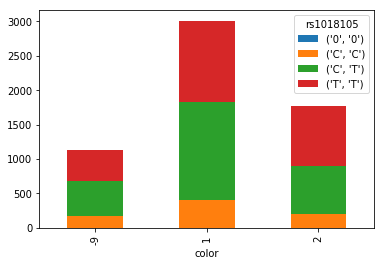

rs146505199


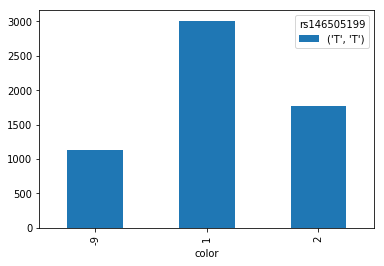

rs183743105


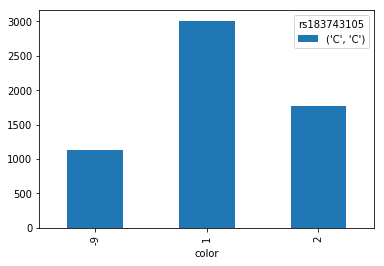

rs12592307


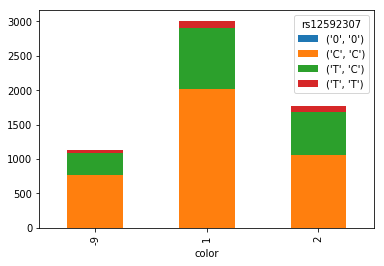

rs147736385


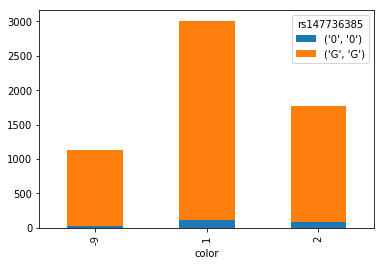

exm1142998


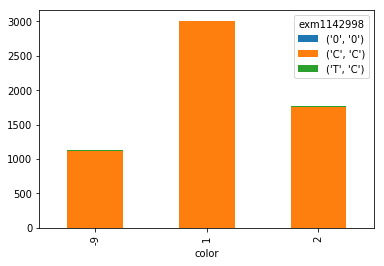

rs142988897


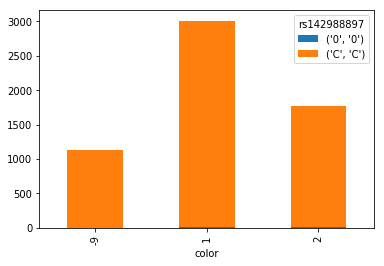

rs144863864


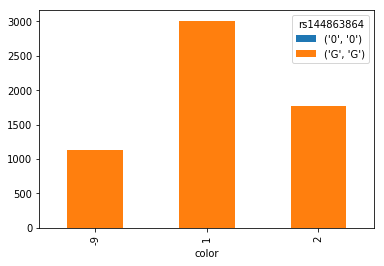

rs148153776


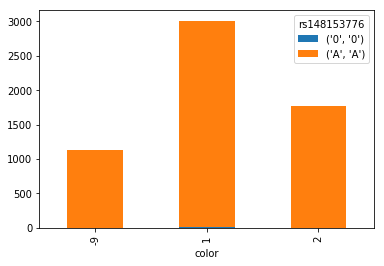

rs141949212


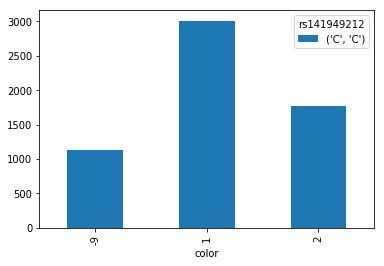

rs6497246


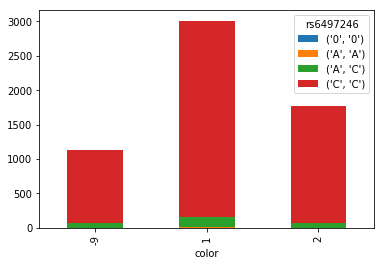

rs8037534


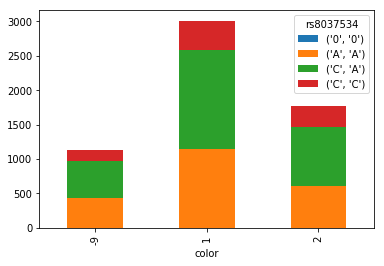

rs144064082


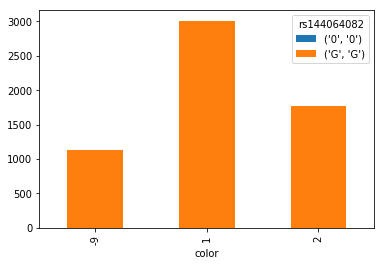

rs145968118


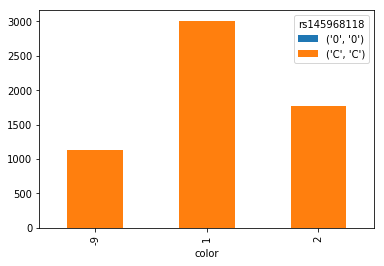

rs139837760


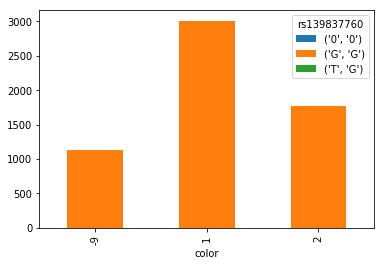

rs143116542


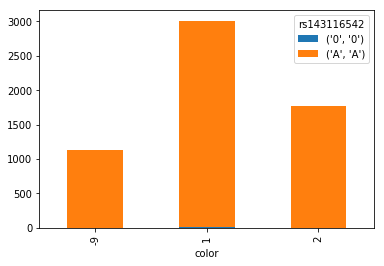

rs148894313


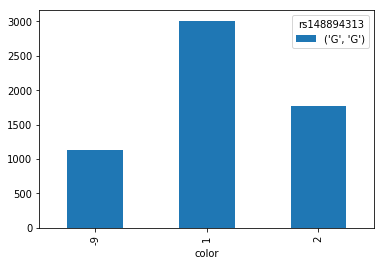

rs142627134


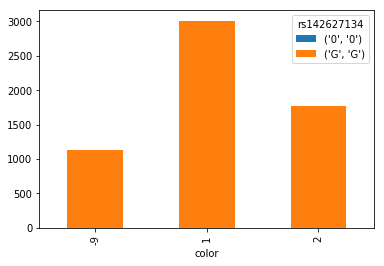

rs13313425


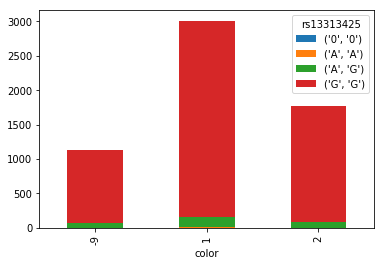

rs1004611


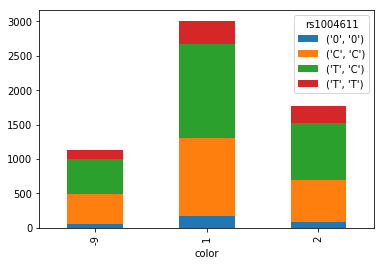

rs768546


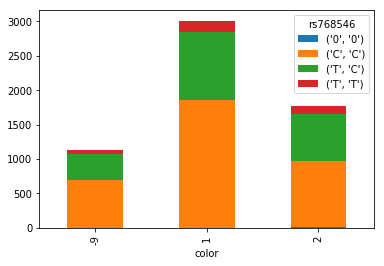

rs4778199


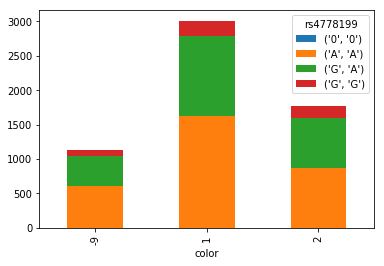

rs7177529


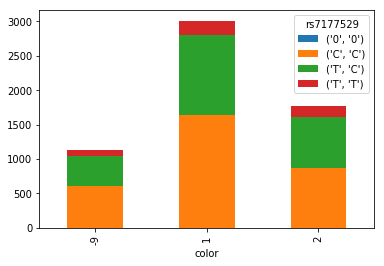

rs150990900


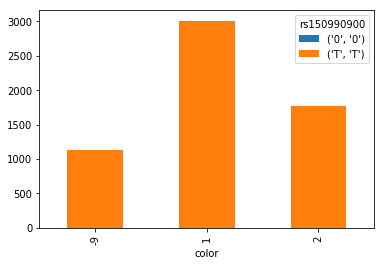

rs1800418


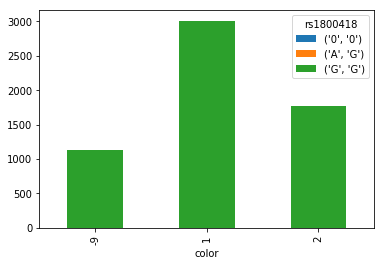

variant.34281


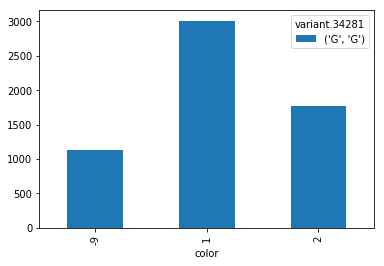

rs146641083


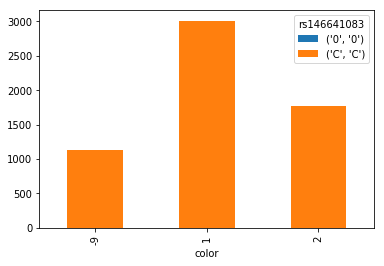

exm1143019


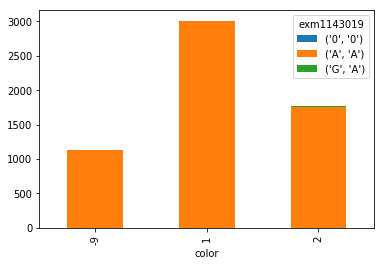

rs1800417


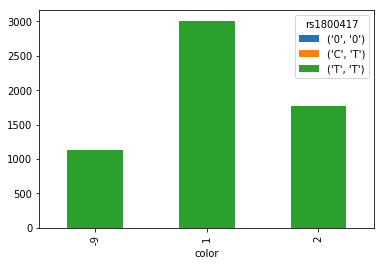

rs141545475


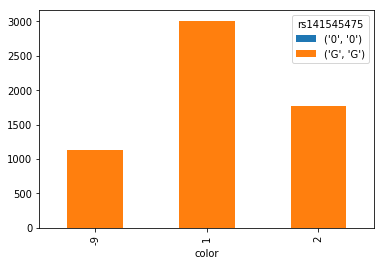

rs16950486


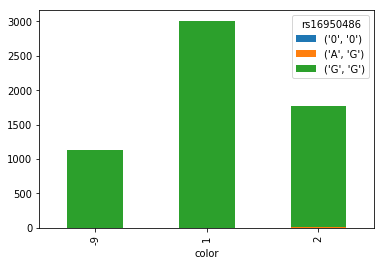

rs1375166


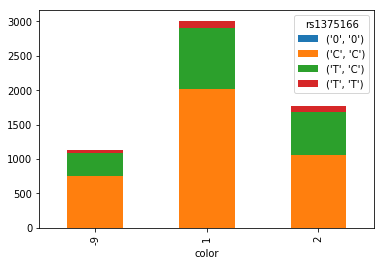

rs2703983


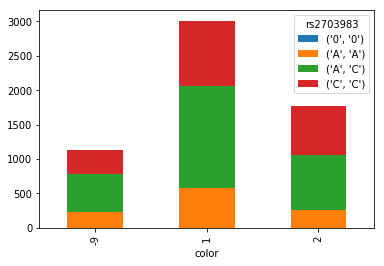

rs2044627


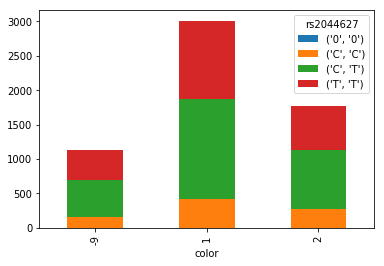

rs8039856


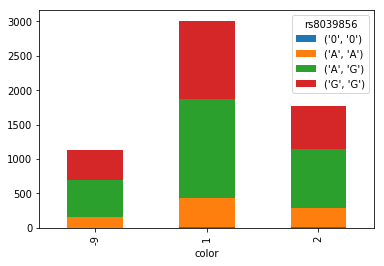

rs2703942


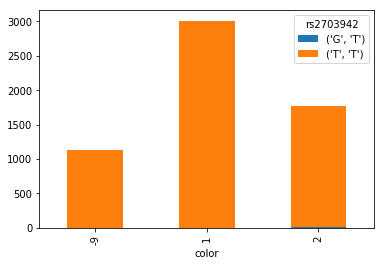

rs1597200


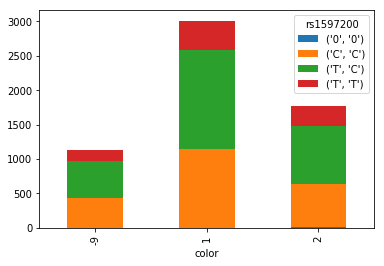

rs3751651


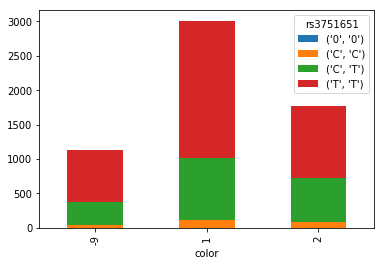

variant.34284


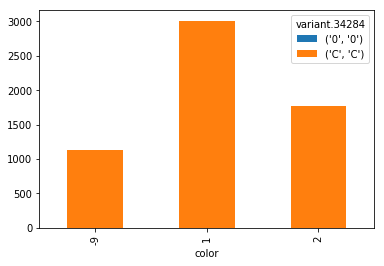

rs138335119


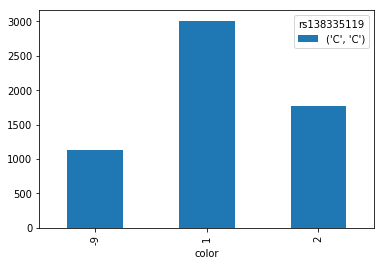

rs186953916


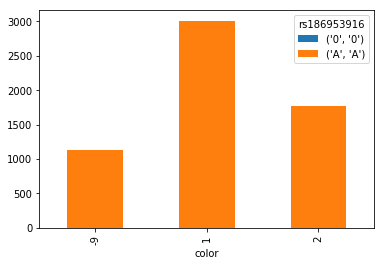

rs2594934


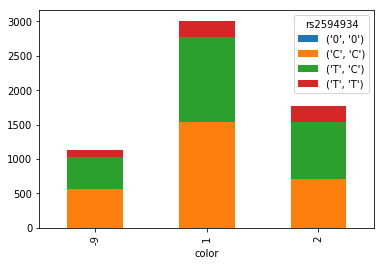

rs1448490


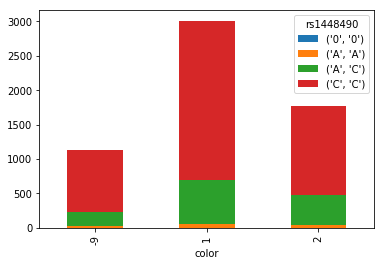

rs1562592


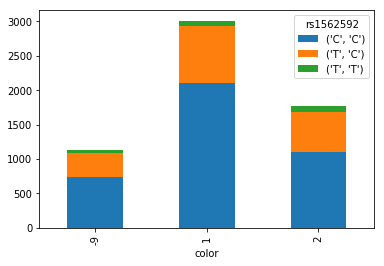

rs7170451


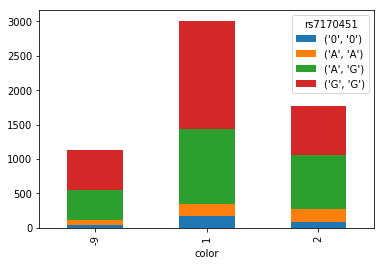

rs7173419


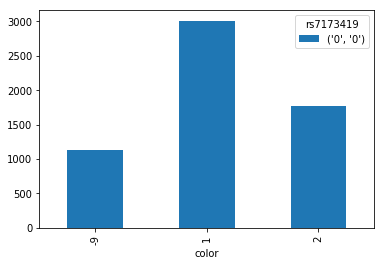

rs138985876


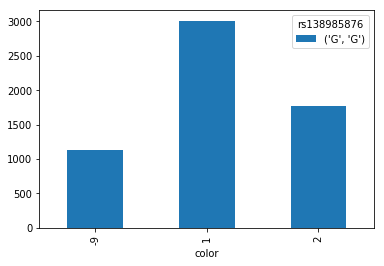

rs200692258


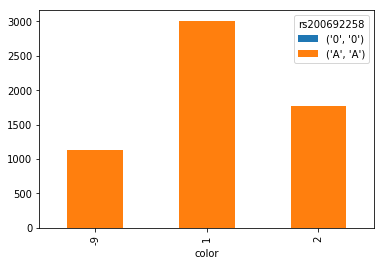

rs1800415


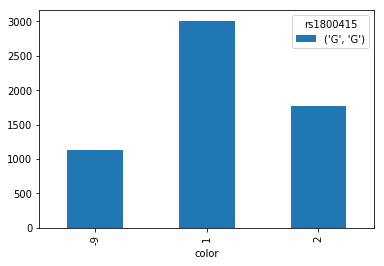

rs7164127


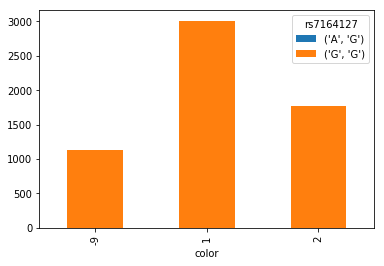

exm1143042


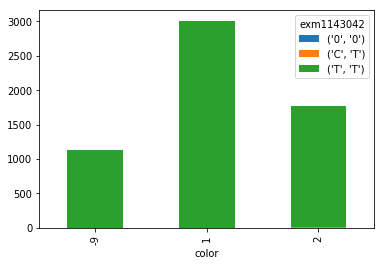

rs1800414


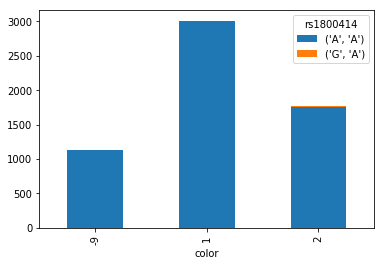

rs921221


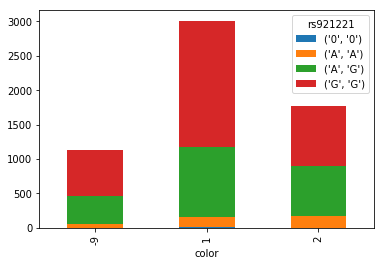

rs139844766


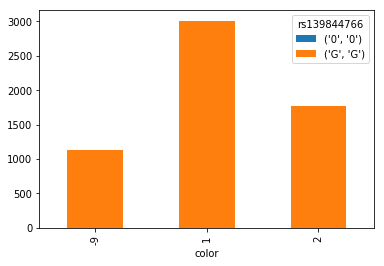

exm1143047


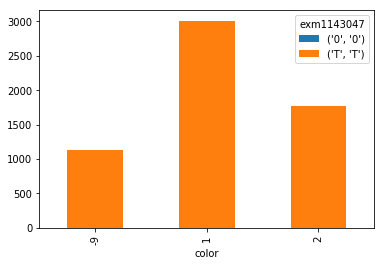

rs141159640


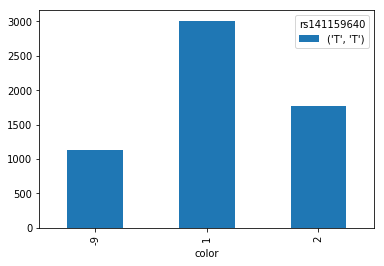

rs7176632


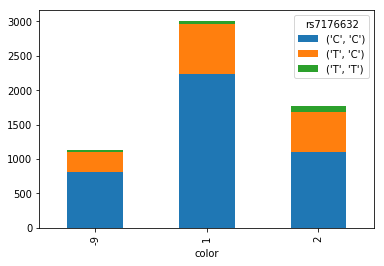

rs11638265


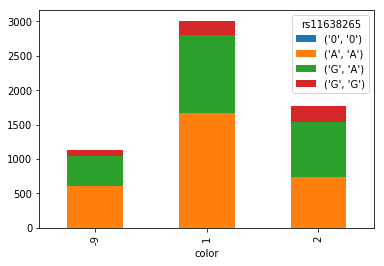

exm1143051


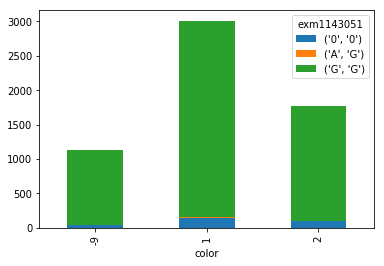

rs151225947


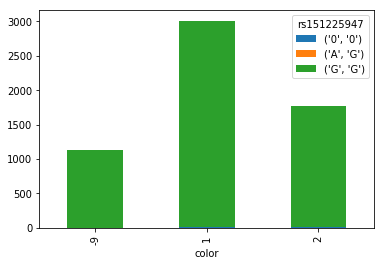

rs61751032


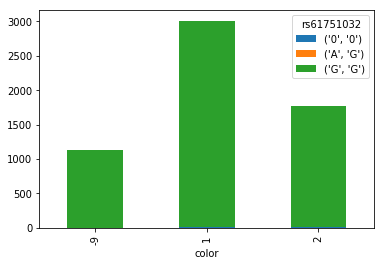

rs147638738


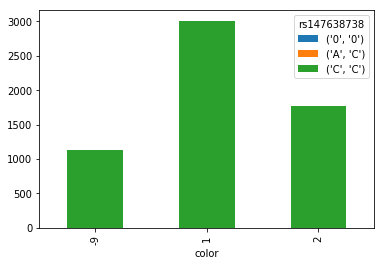

rs140556122


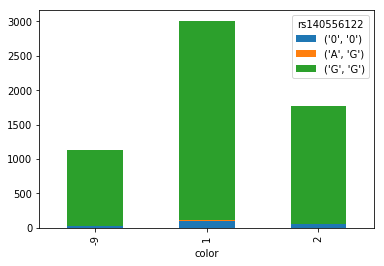

exm1143057


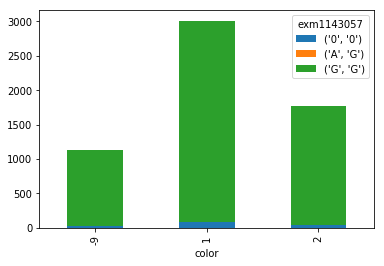

exm1143058


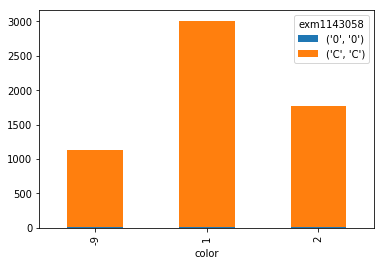

rs35110389


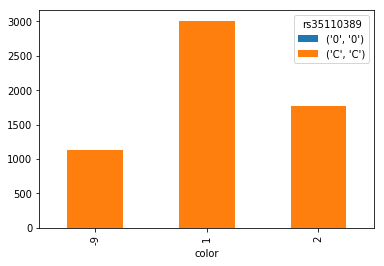

rs147905292


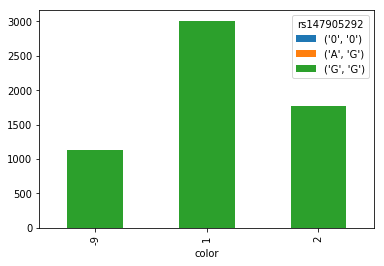

rs141611162


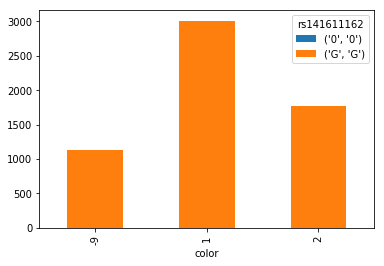

rs4778218


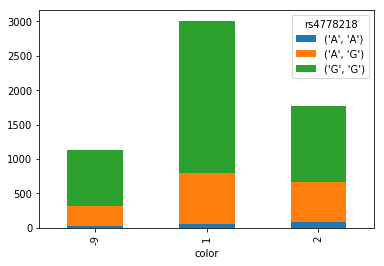

exm1143061


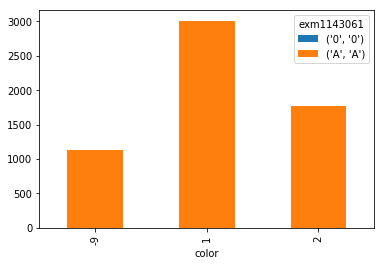

rs34141095


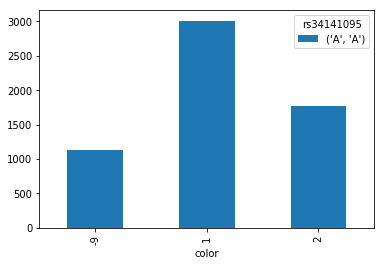

exm1143063


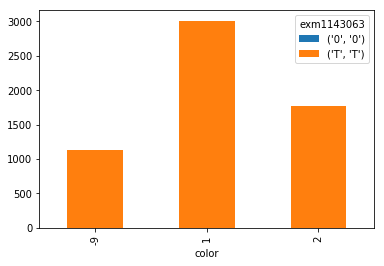

rs143699063


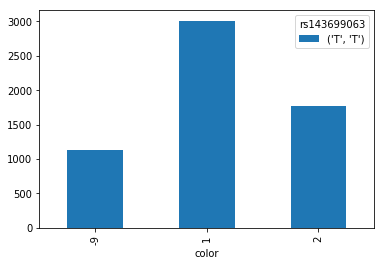

rs151046206


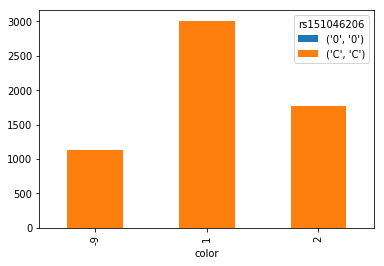

rs140932222


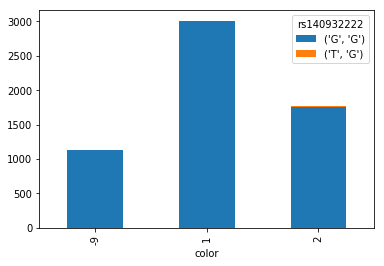

exm1143067


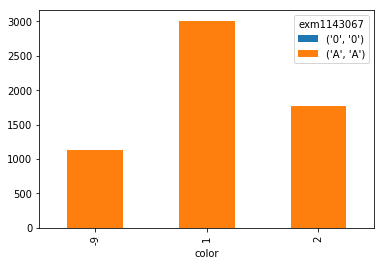

newrs41446944


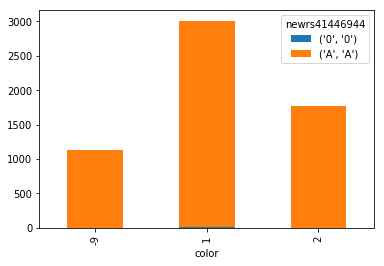

rs1800411


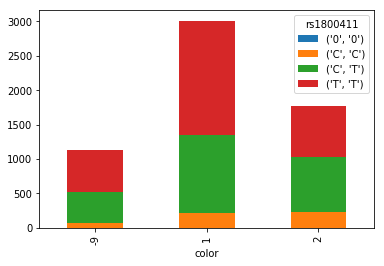

rs142152913


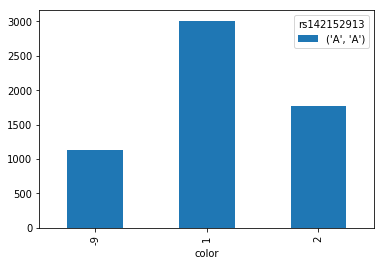

exm1143070


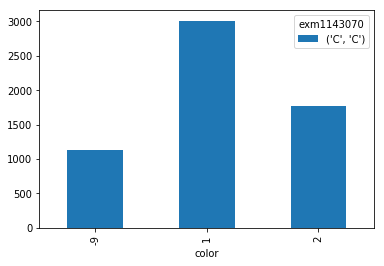

exm1143072


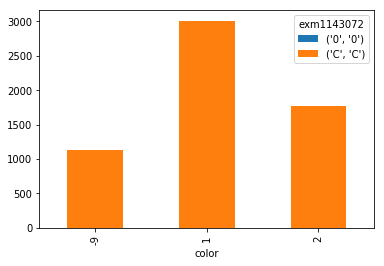

rs201095055


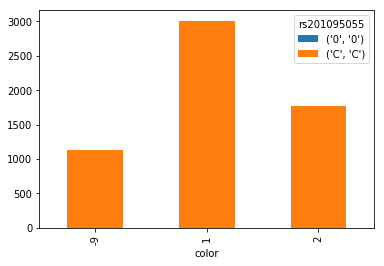

variant.34289


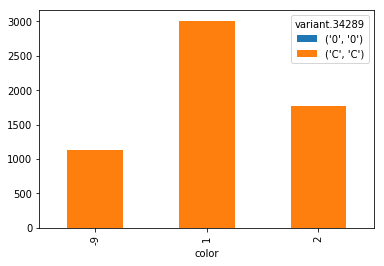

rs202126510


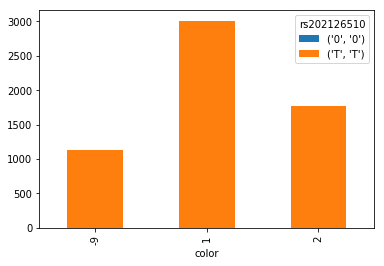

exm1143074


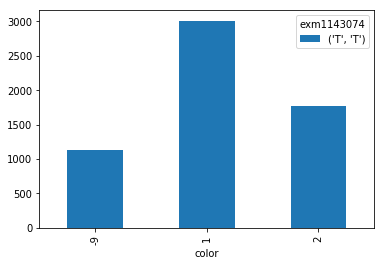

exm1143075


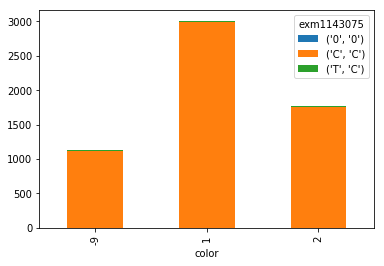

rs148413474


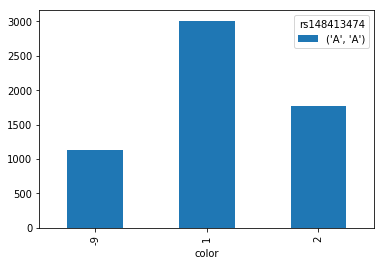

rs76026235


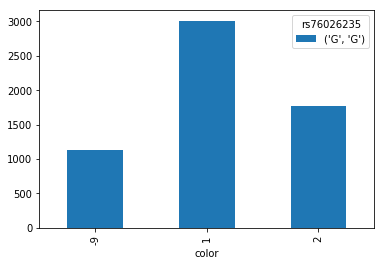

rs141627675


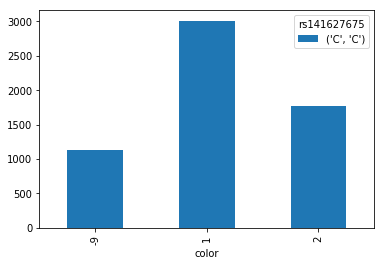

rs1900758


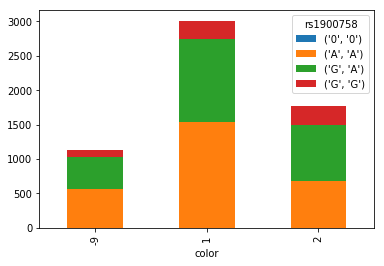

rs1800410


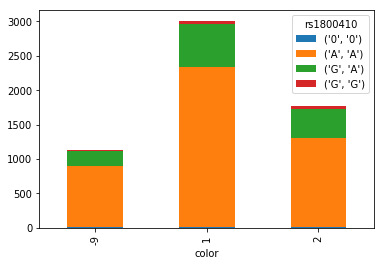

exm1825976


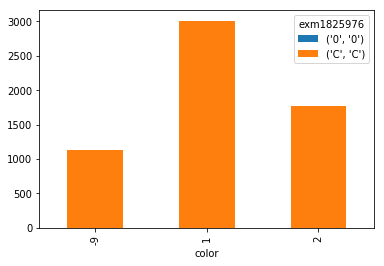

rs139853866


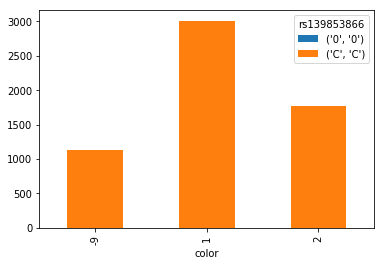

exm1143084


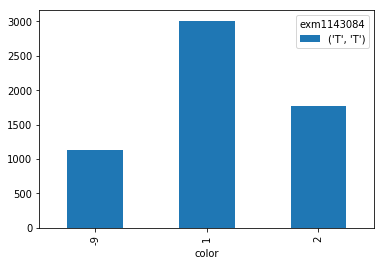

rs140566426


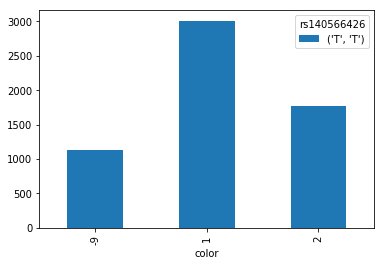

exm1143086


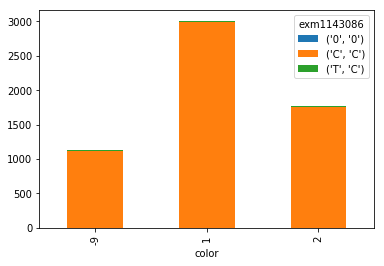

rs147816326


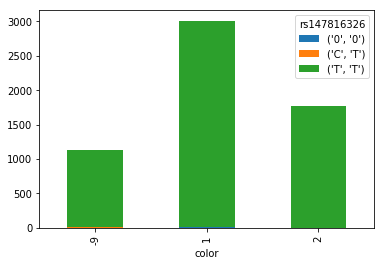

exm1143088


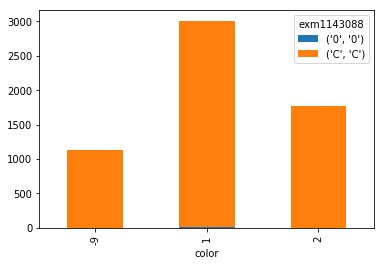

rs1800408


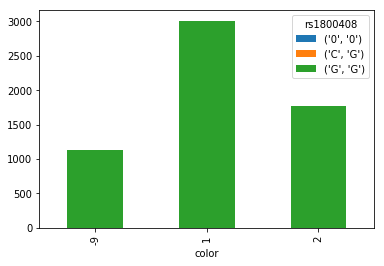

rs150020919


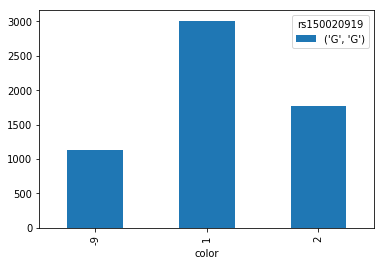

rs201484597


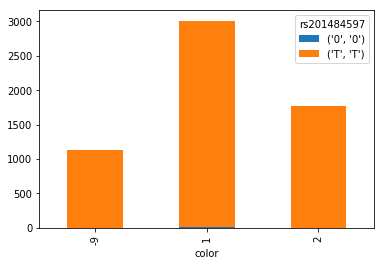

exm1143095


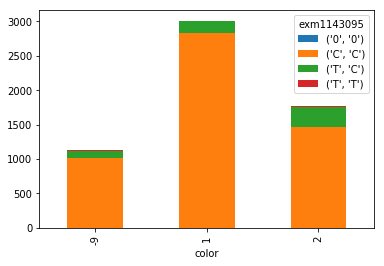

rs1800407


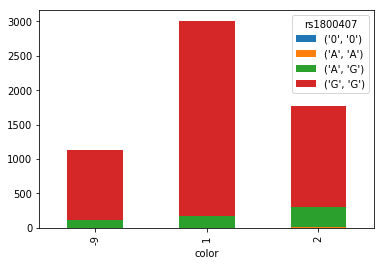

exm1143096


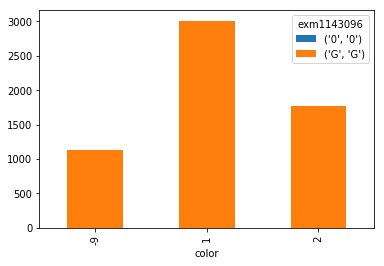

rs1037208


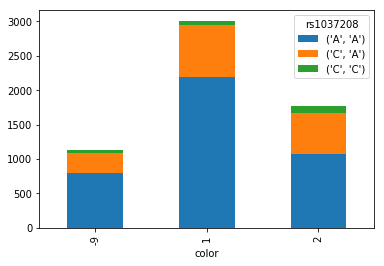

exm1143100


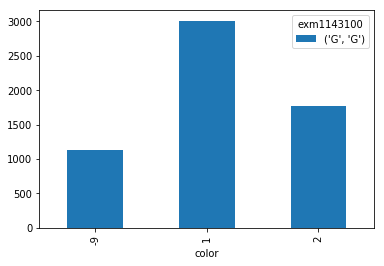

rs140703213


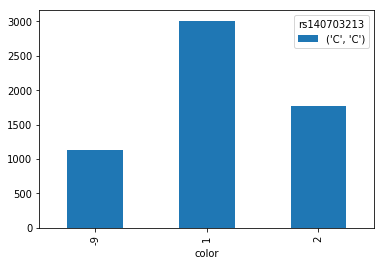

exm1143102


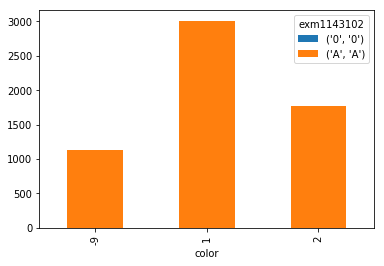

exm1143104


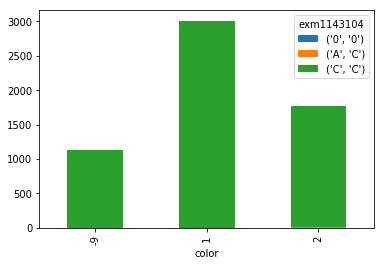

rs10852218


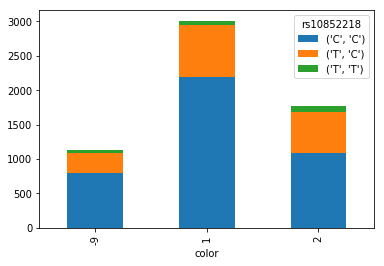

rs141037970


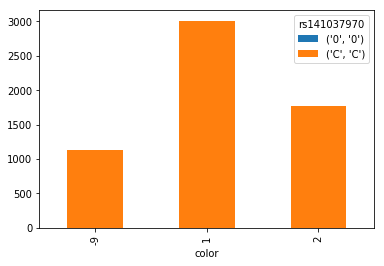

exm1143110


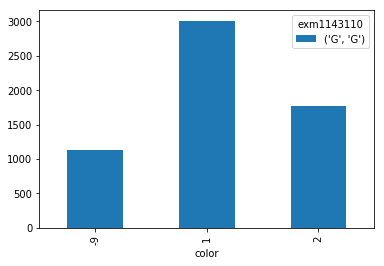

rs137956605


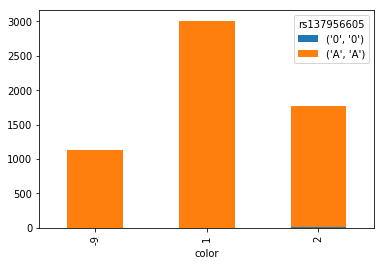

exm1143112


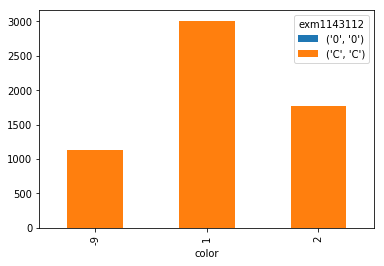

rs1800405


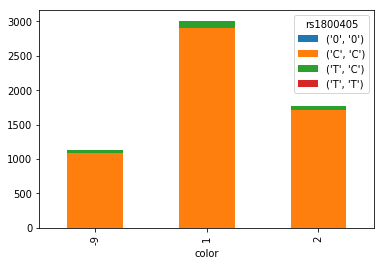

exm1143117


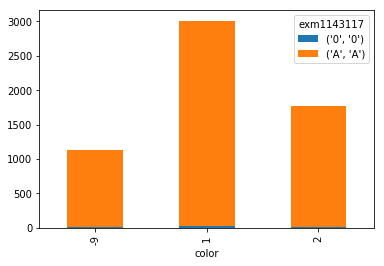

exm1143118


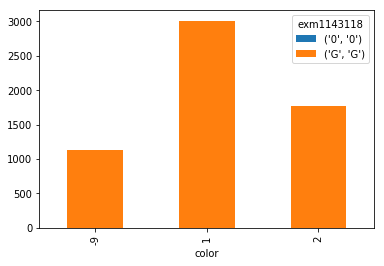

rs200398581


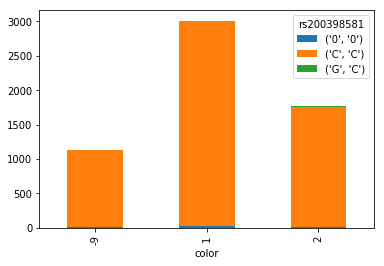

rs1800404


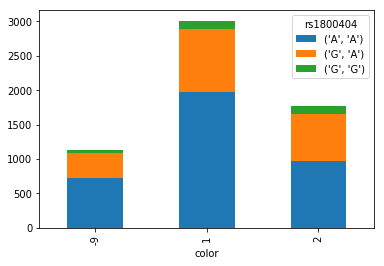

rs7178315


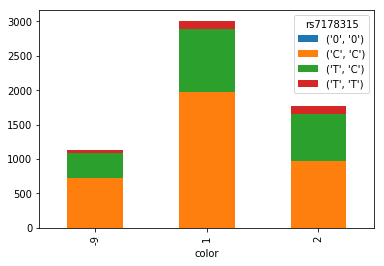

rs185504549


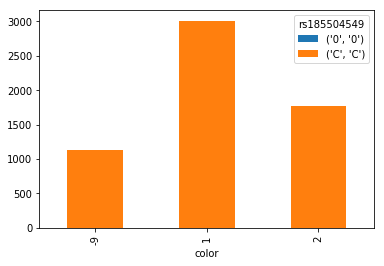

rs1800403


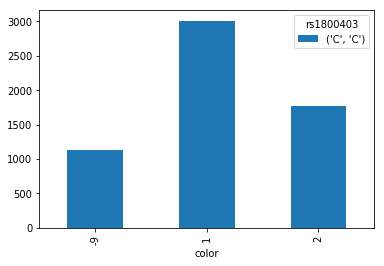

exm1143121


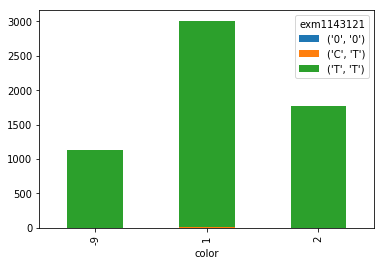

rs74695474


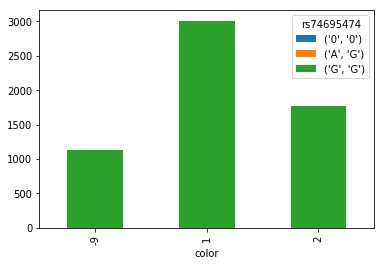

exm1143123


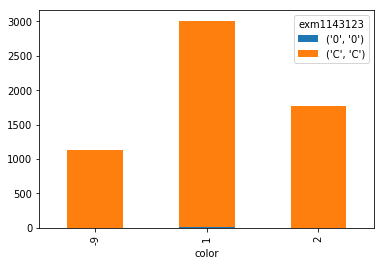

rs142591701


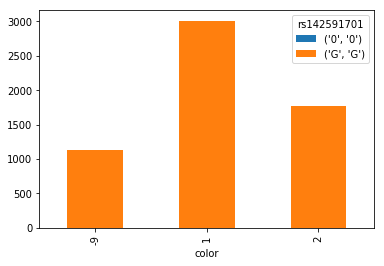

exm1143125


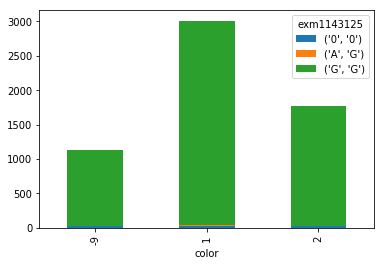

rs34010619


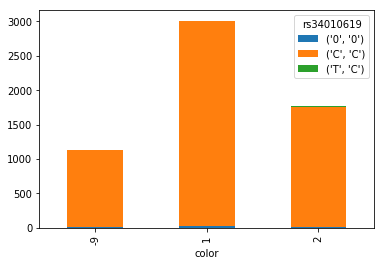

rs139743429


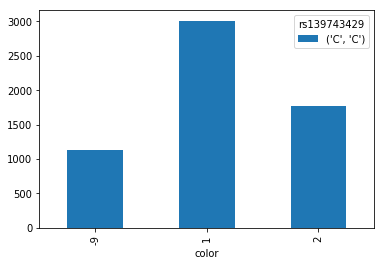

exm1143127


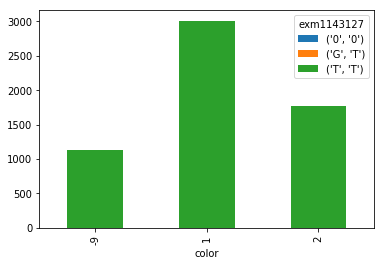

exm1143129


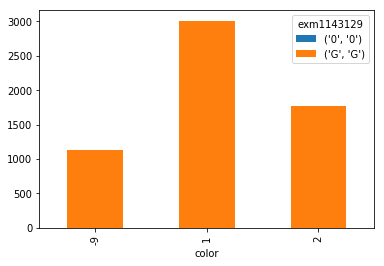

rs140492425


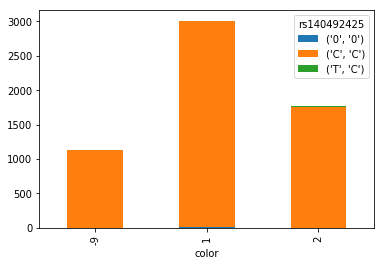

rs201481836


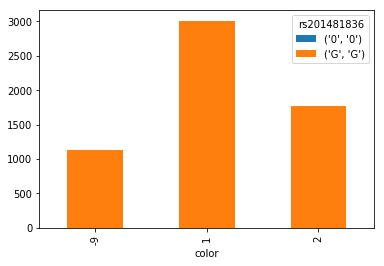

exm1143131


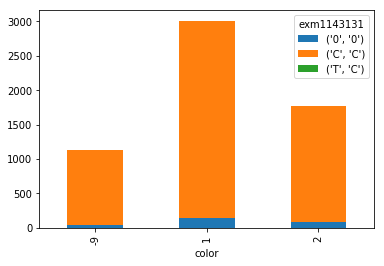

exm1143132


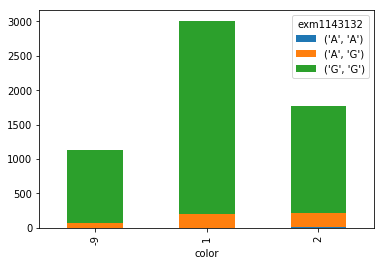

rs149191701


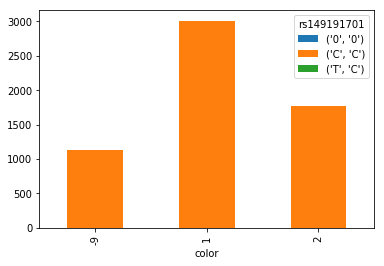

rs200651760


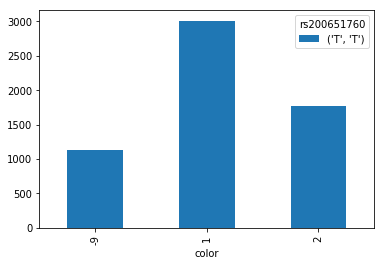

exm1143142


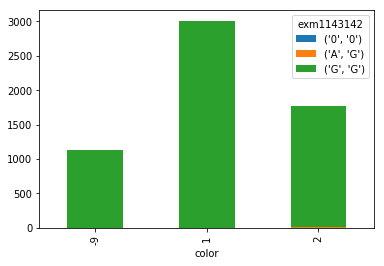

exm1143144


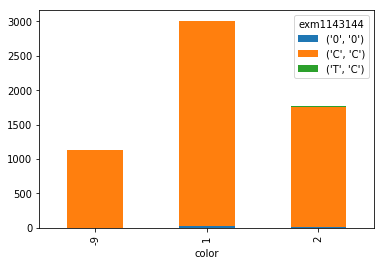

rs147432138


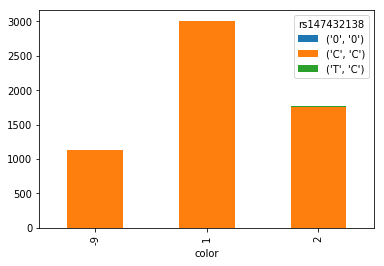

exm1143145


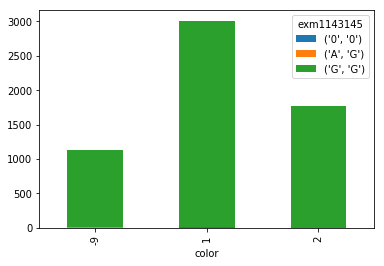

rs144011656


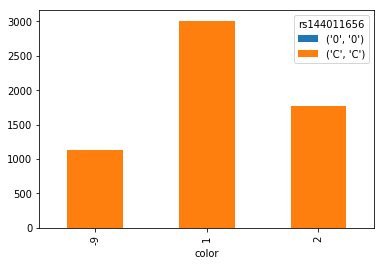

rs148659233


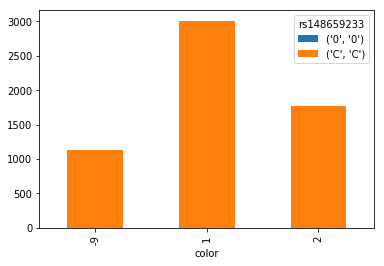

rs143734809


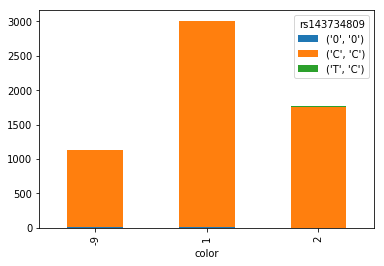

exm2272216


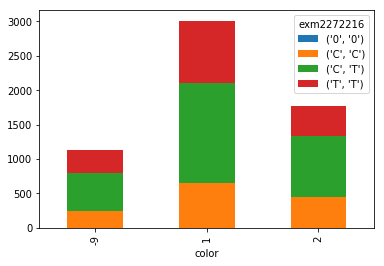

exm1826040


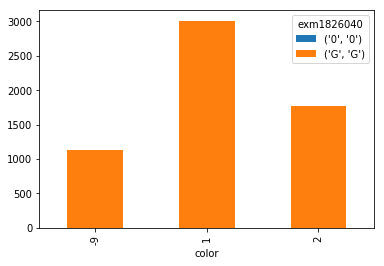

exm1143155


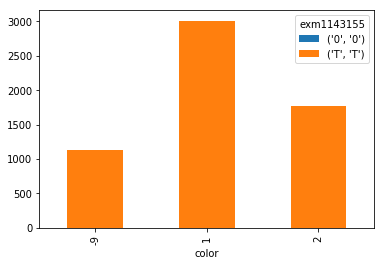

rs139562520


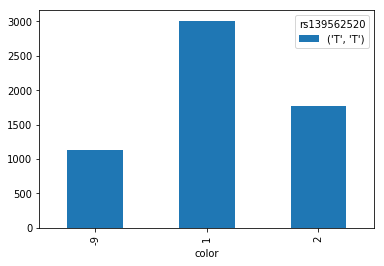

rs183487020


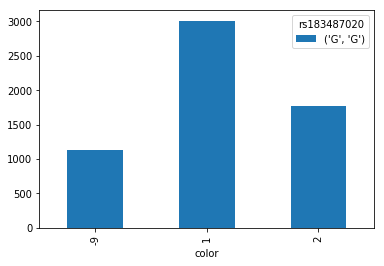

rs144175965


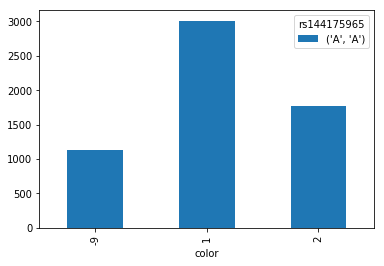

newrs145242923


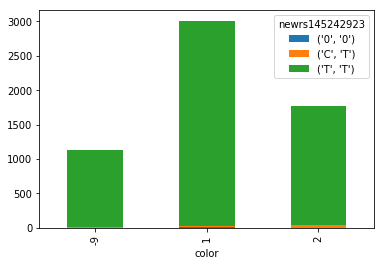

rs749846


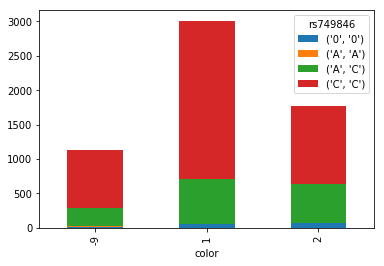

rs3794604


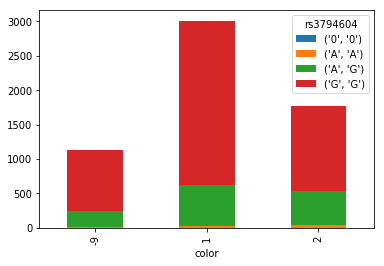

rs151118268


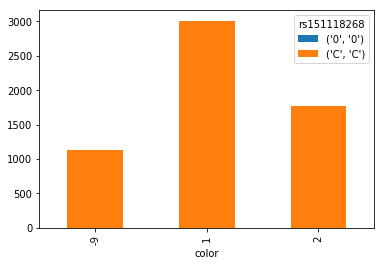

rs139950883


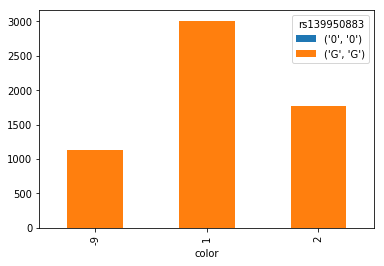

rs35764631


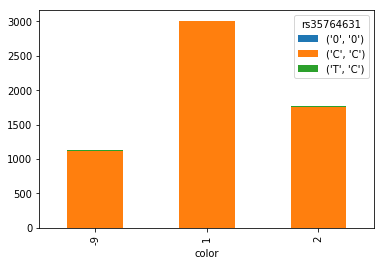

rs201791790


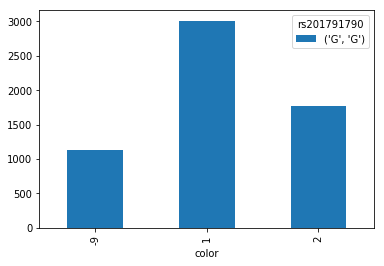

exm1143166


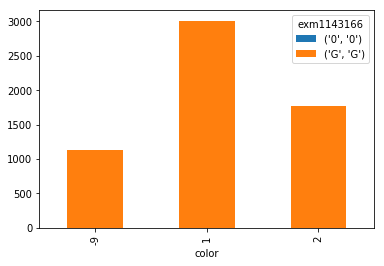

rs4427755


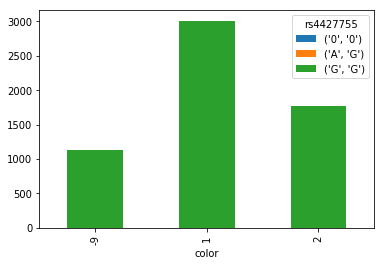

rs4778232


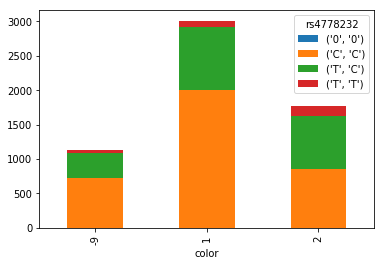

exm2260411


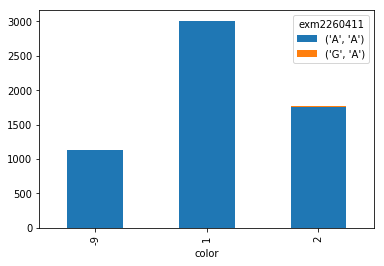

rs16950821


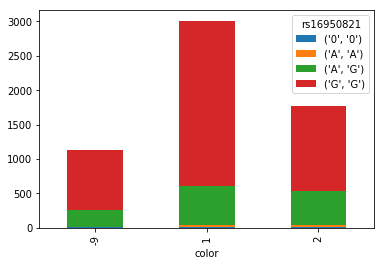

rs12324648


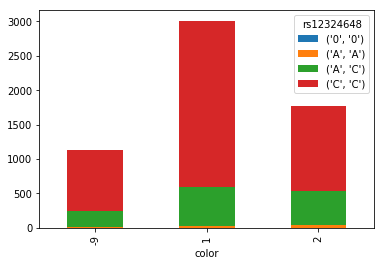

rs1470608


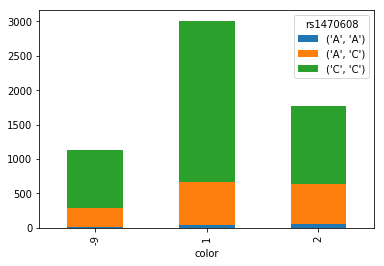

rs12442147


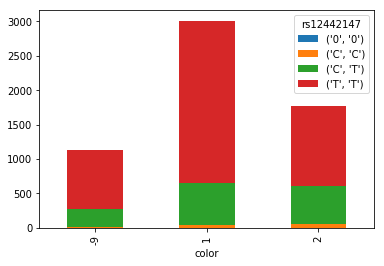

rs1597196


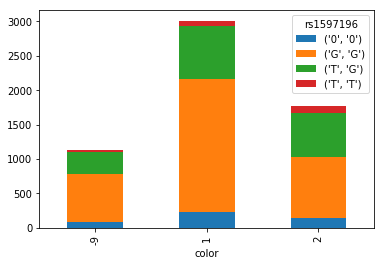

rs895831


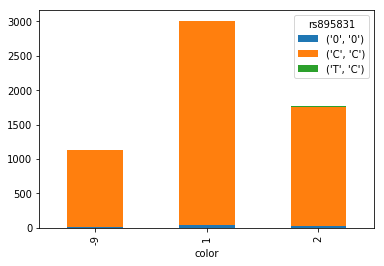

rs7162117


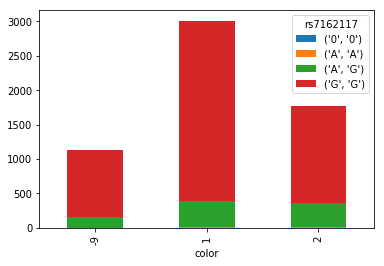

rs7179419


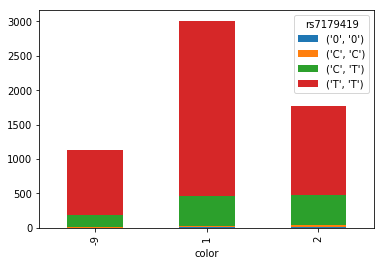

rs7179994


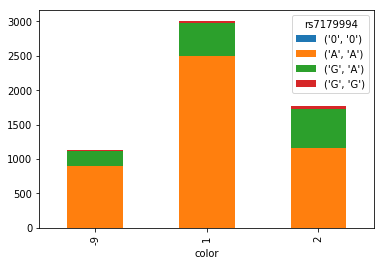

exm1143170


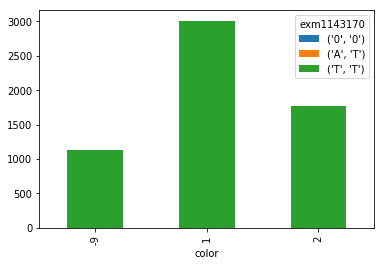

rs147785669


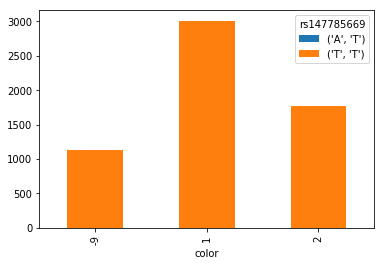

rs200885801


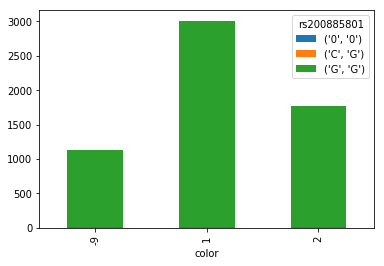

rs141135991


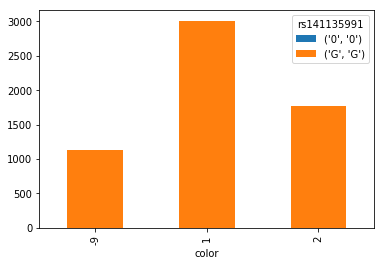

rs148066812


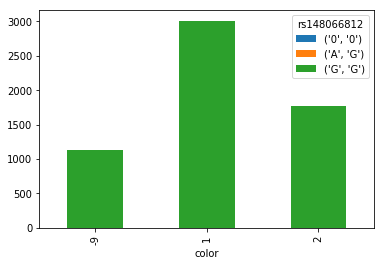

rs141803386


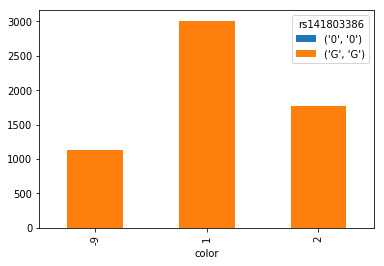

exm1143178


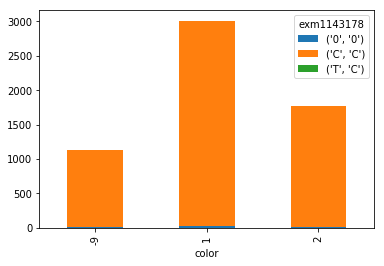

rs138611712


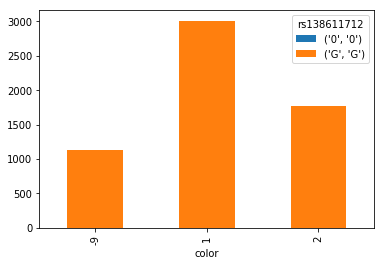

rs61742223


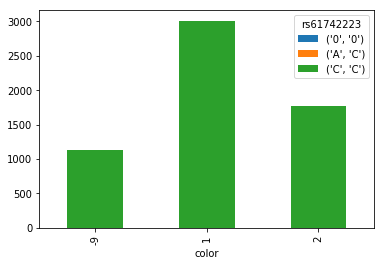

rs201291702


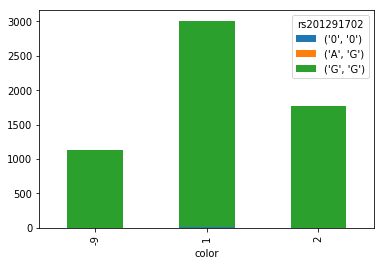

exm1143183


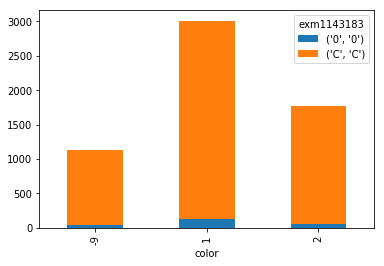

rs7174027


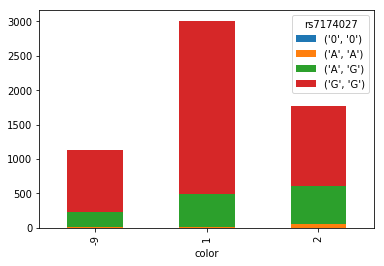

exm-rs4778138


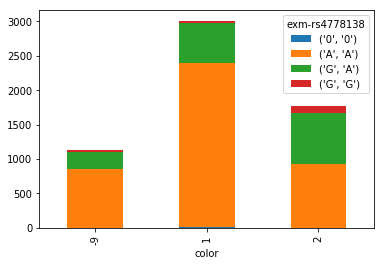

rs4778241


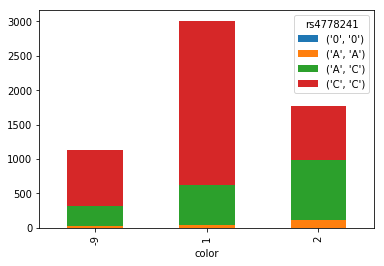

rs7495174


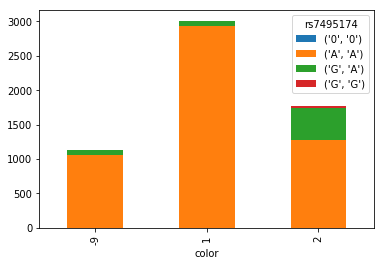

rs4778244


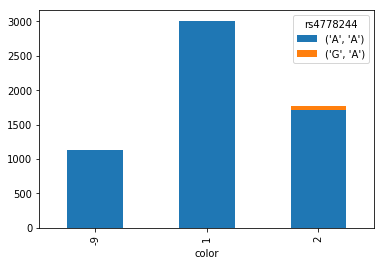

rs114097653


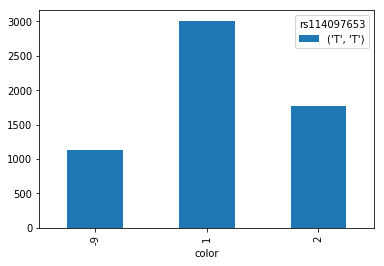

rs7496685


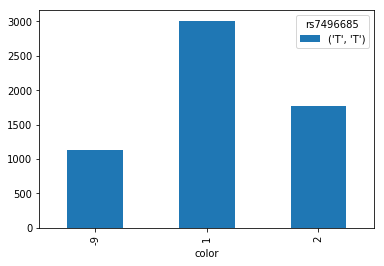

rs145385813


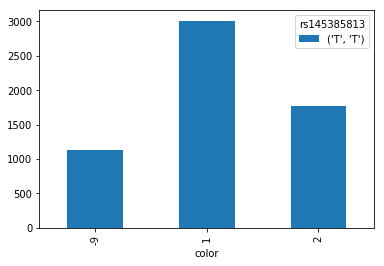

rs147271386


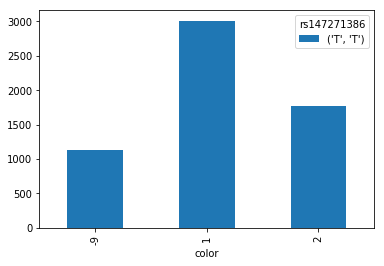

rs192999801


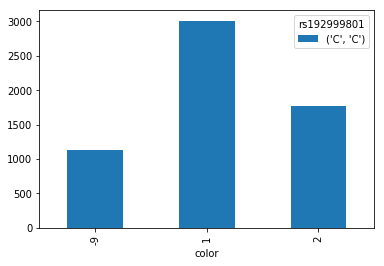

rs182874358


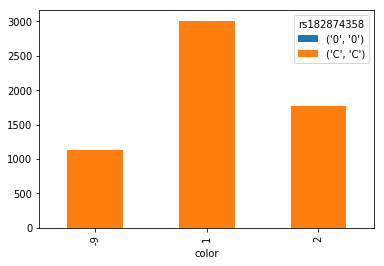

rs1129038


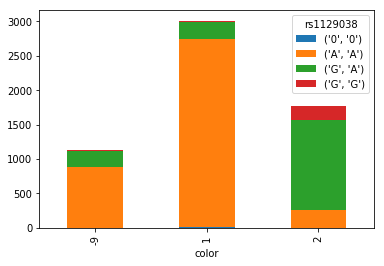

rs141739498


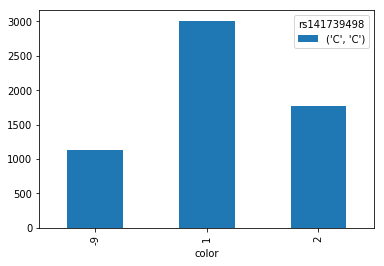

rs146332822


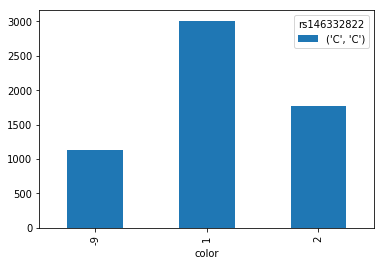

exm1143193


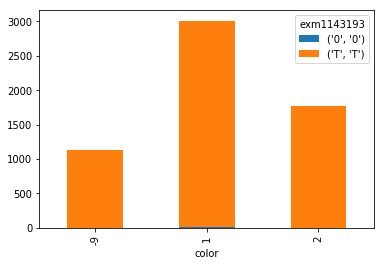

rs188787231


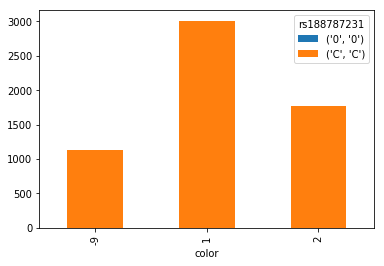

rs142779606


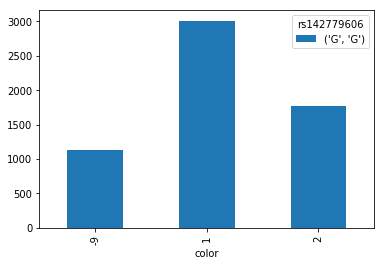

exm1143196


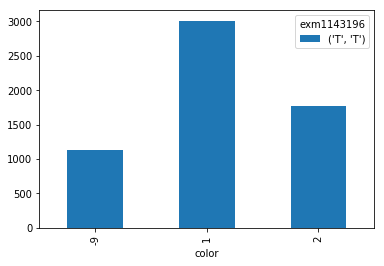

rs148711194


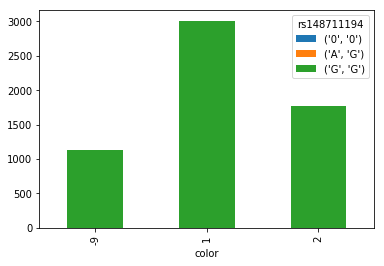

rs148731297


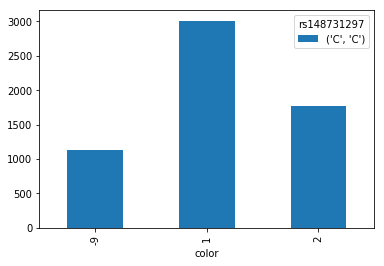

rs142354999


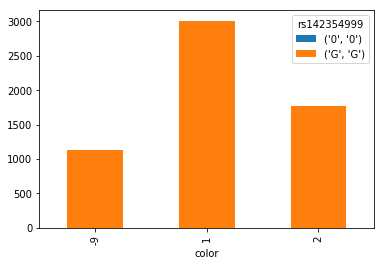

rs151325729


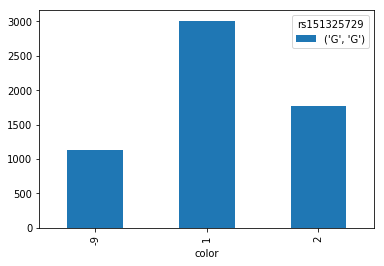

rs145193373


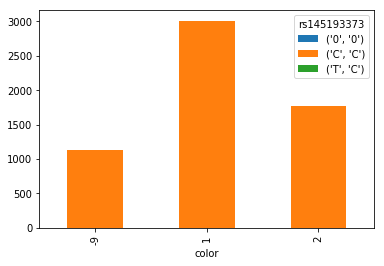

rs147802077


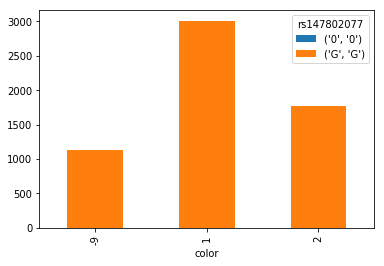

rs141203755


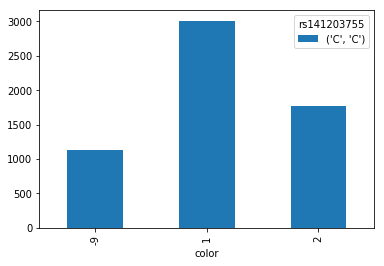

rs137918449


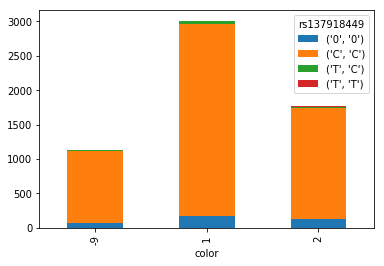

rs201971030


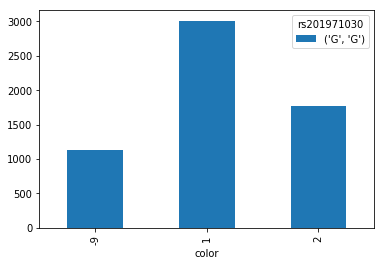

rs144912188


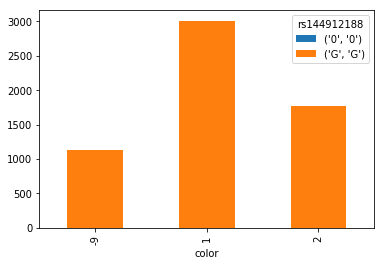

exm2252084


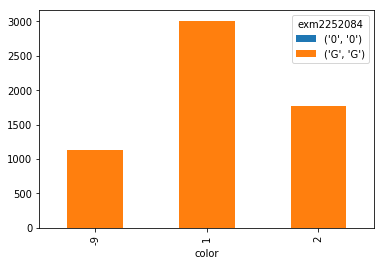

exm2223096


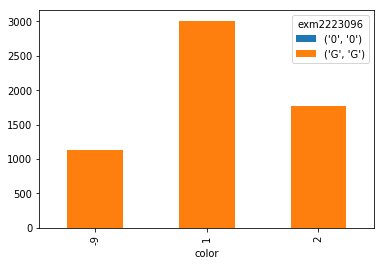

rs143209042


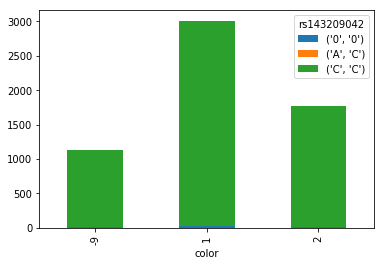

exm1143222


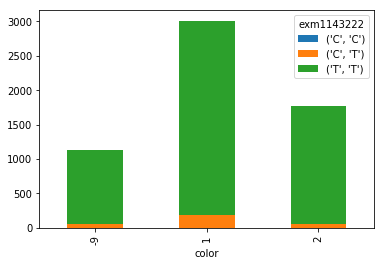

rs138594015


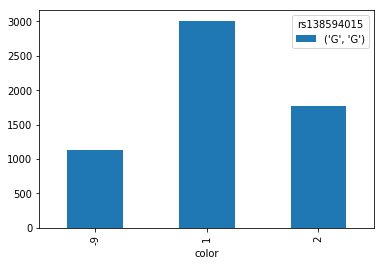

rs201003752


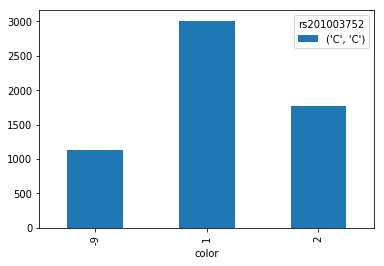

rs200336266


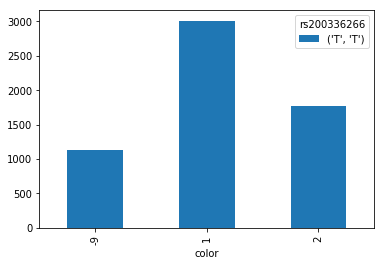

rs145413211


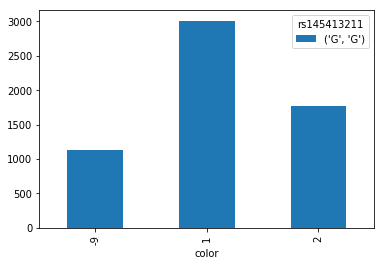

rs138341710


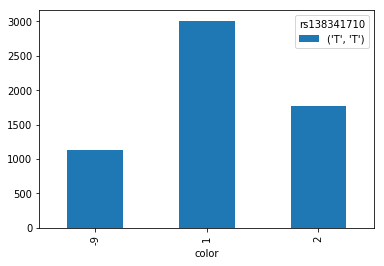

rs142882696


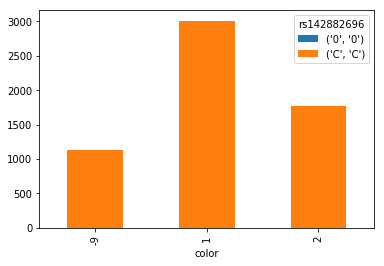

rs150636762


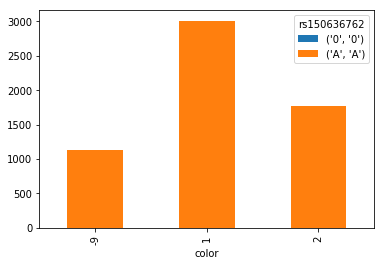

exm2252085


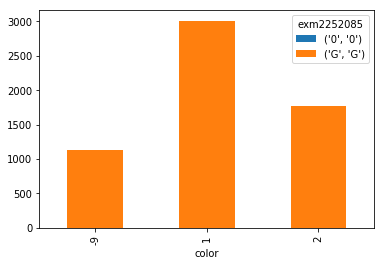

rs139713317


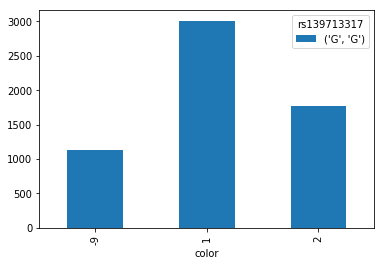

exm1143235


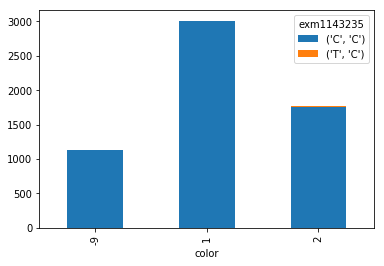

rs144844826


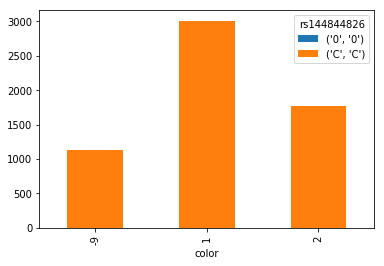

rs200993824


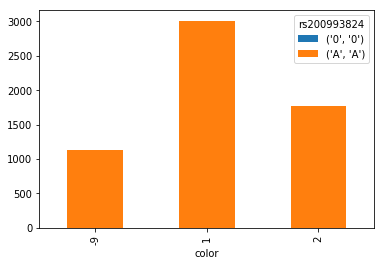

rs199500960


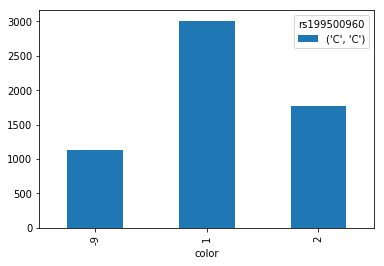

rs201520077


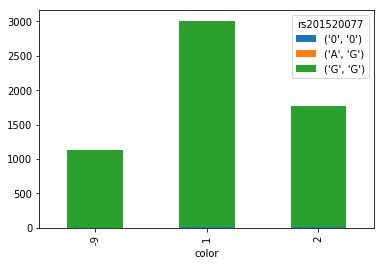

rs140153389


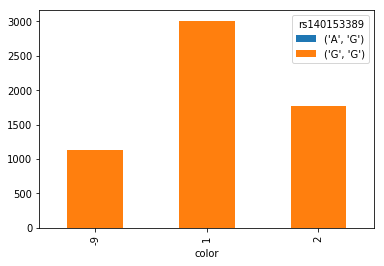

exm-rs12913832


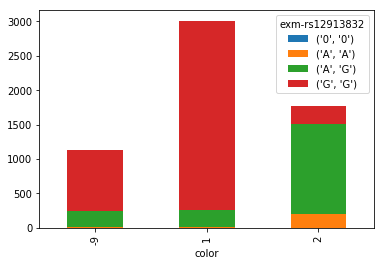

rs7183877


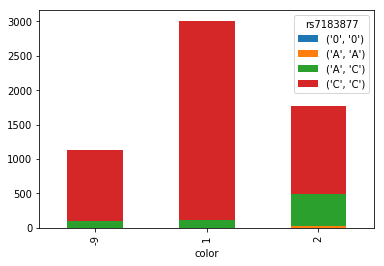

rs142085566


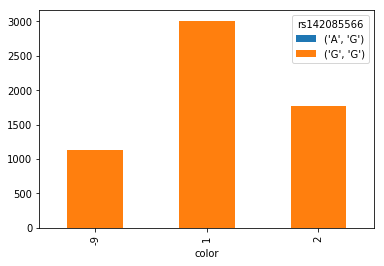

rs11074321


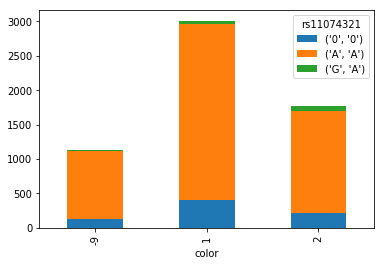

rs11635884


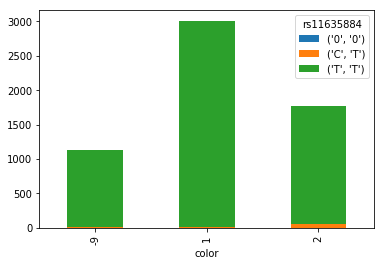

rs111263444


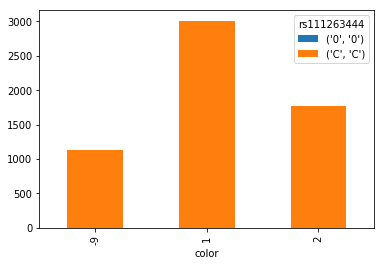

rs140907462


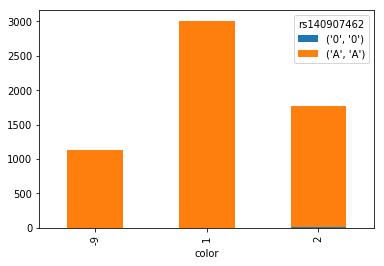

rs11854005


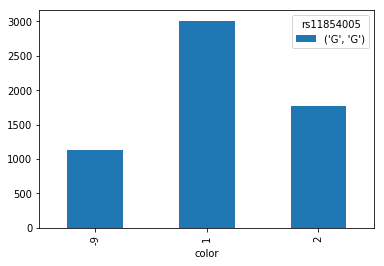

rs150956191


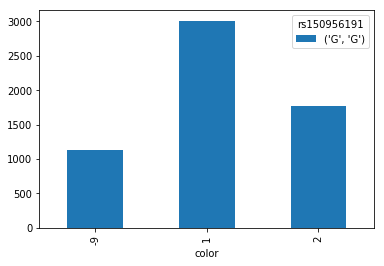

exm1143264


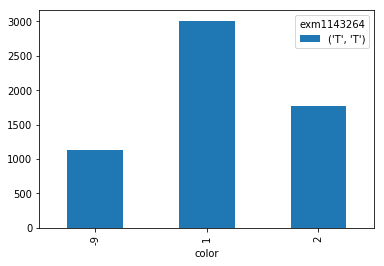

rs140708332


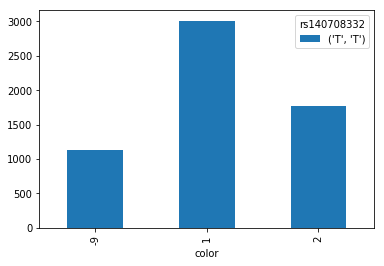

rs200220947


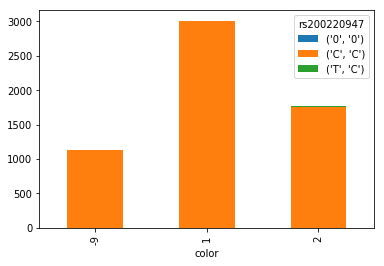

rs149655254


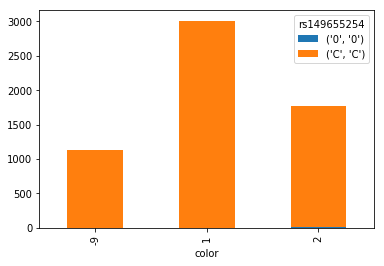

rs139596817


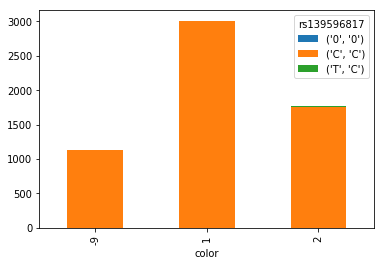

rs146760133


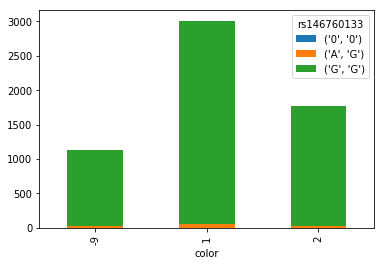

exm2252086


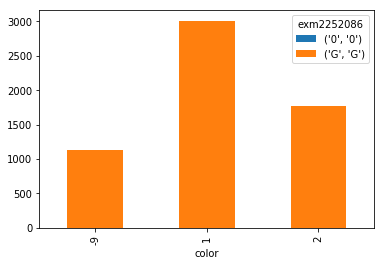

rs201857249


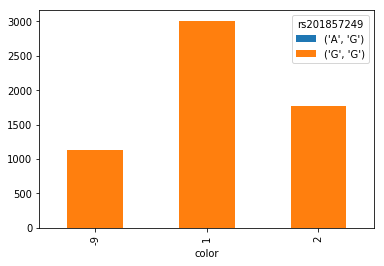

rs3935591


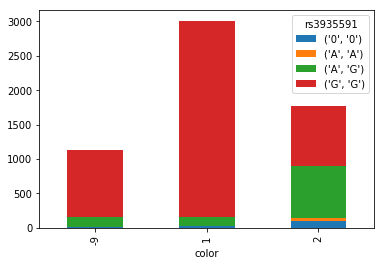

exm1143278


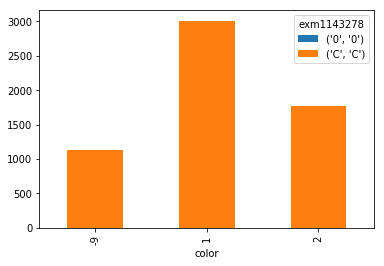

exm1143280


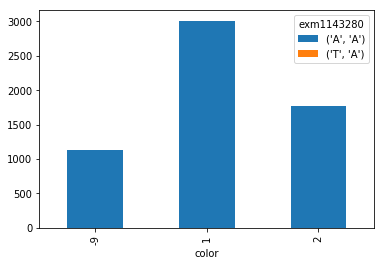

rs138063419


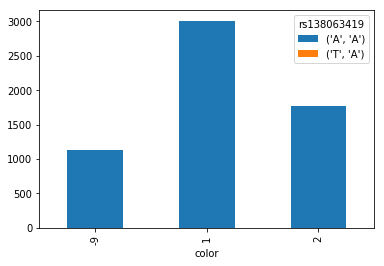

rs61756151


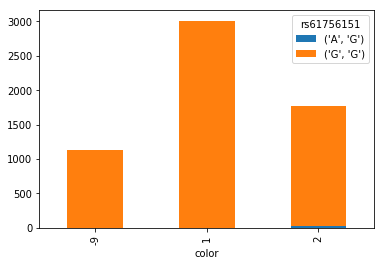

rs143291915


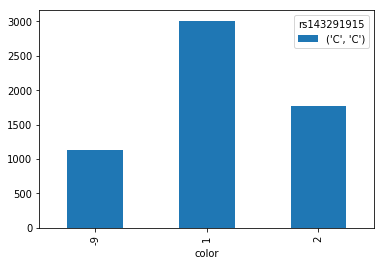

rs148314808


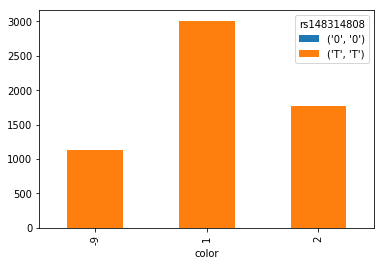

rs146646815


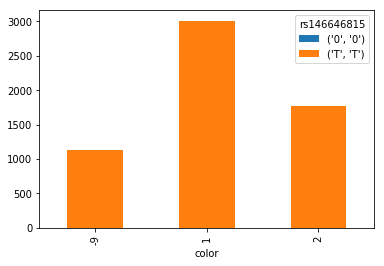

rs147450103


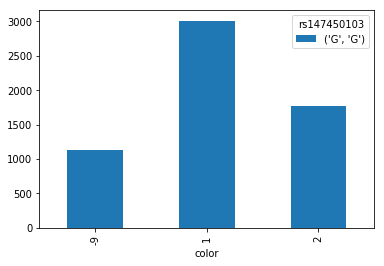

rs138275754


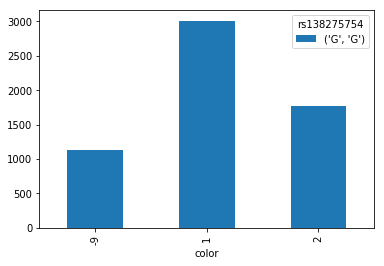

rs144135464


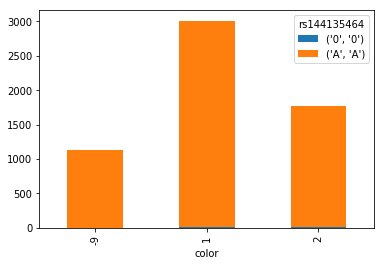

rs147323805


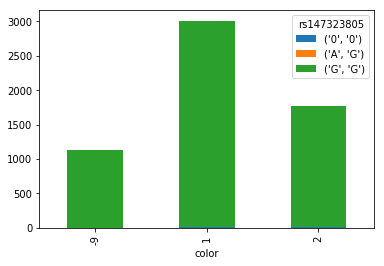

rs140970725


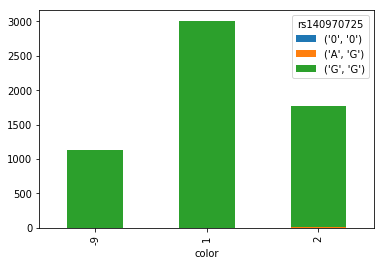

rs200047478


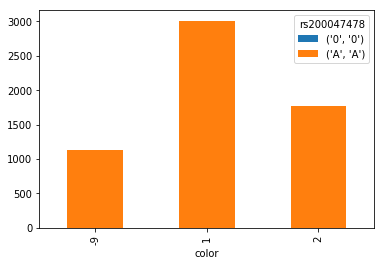

rs185562168


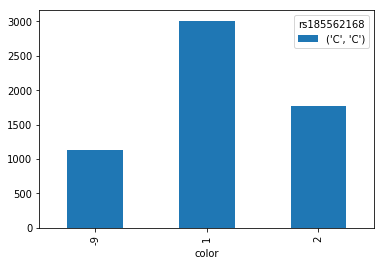

rs201061030


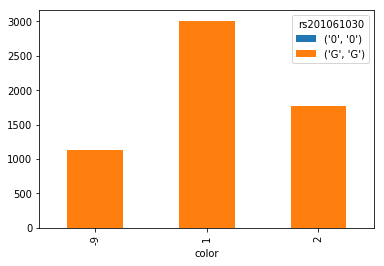

rs139351974


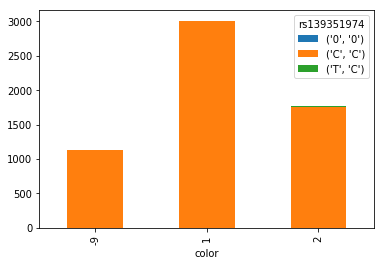

rs143956101


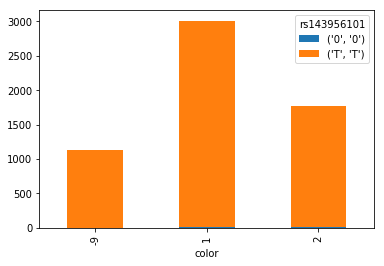

rs148628168


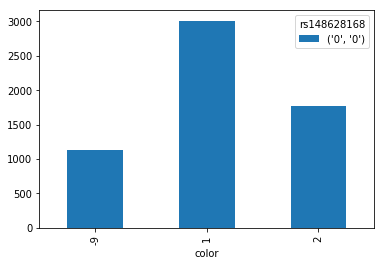

rs142071453


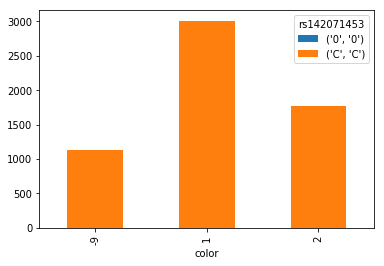

rs146673561


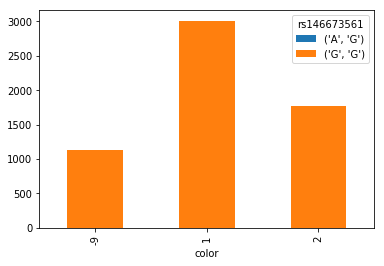

rs11636232


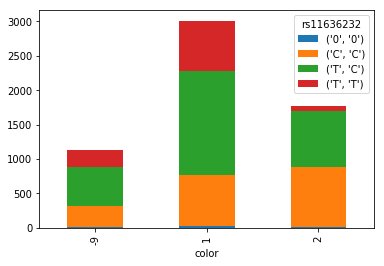

rs191221988


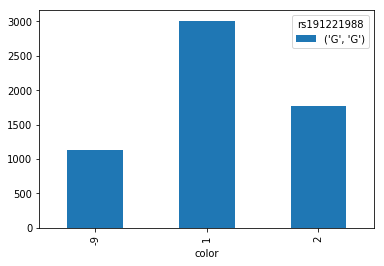

rs142169064


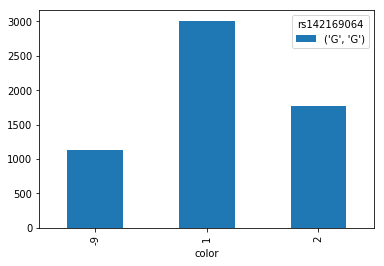

exm1143310


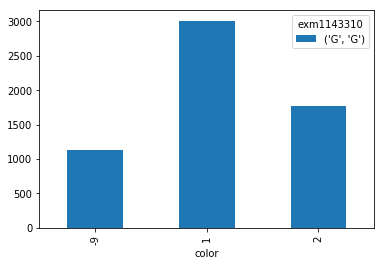

rs149707599


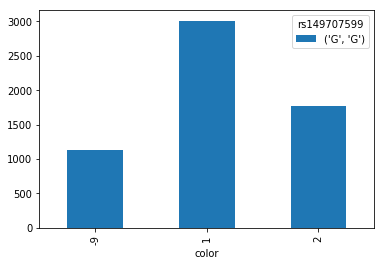

rs145571215


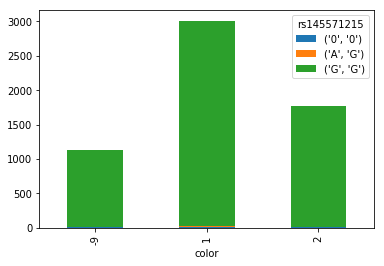

rs140835326


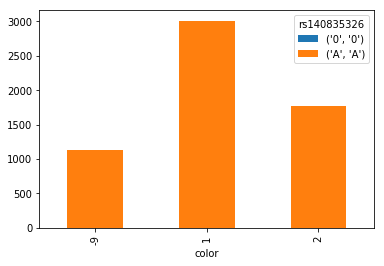

rs150131561


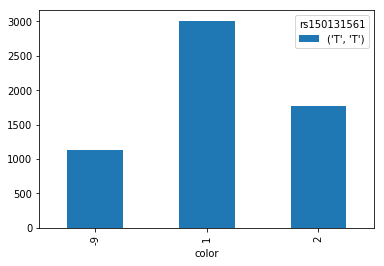

rs202215092


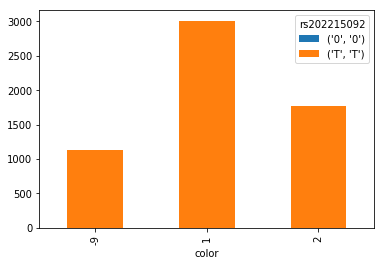

rs138827571


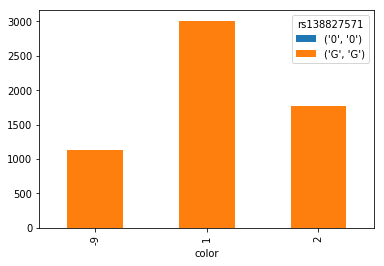

rs148963117


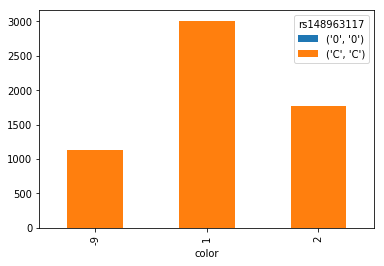

rs147059020


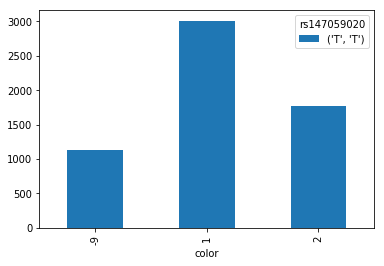

rs143832423


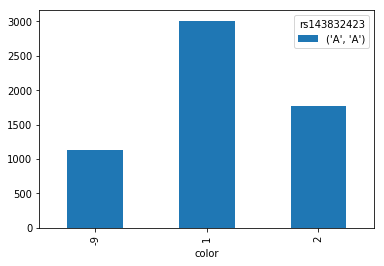

rs142880342


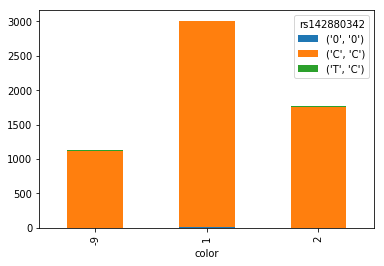

rs148365790


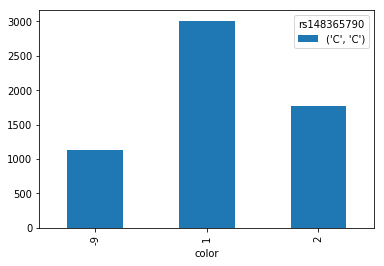

variant.34325


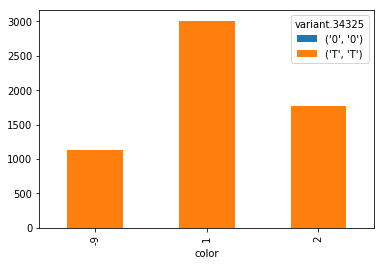

rs141528436


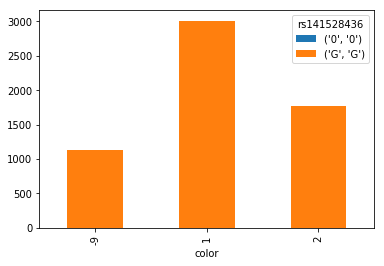

rs190897866


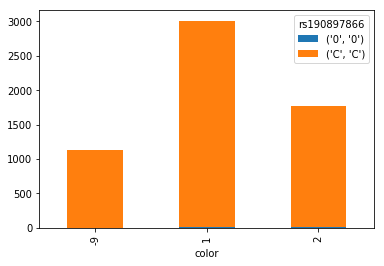

rs114532098


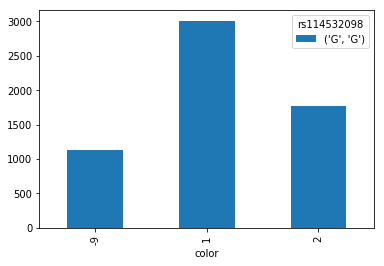

rs183106063


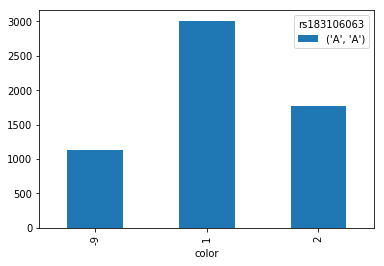

rs139346881


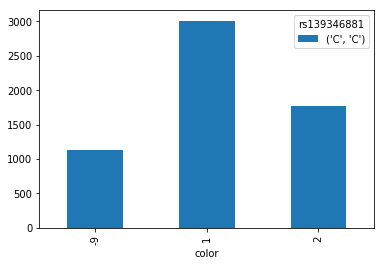

rs149280444


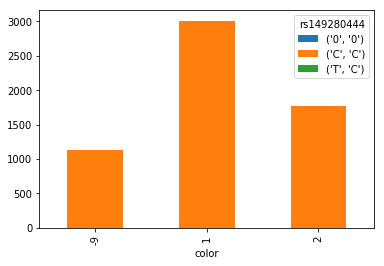

rs146210350


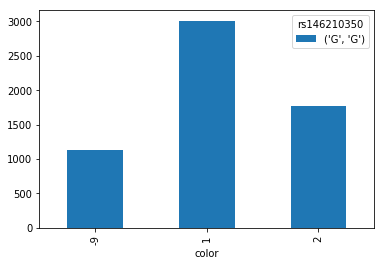

rs1133496


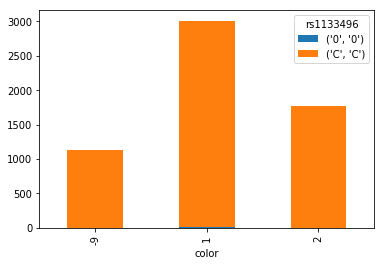

exm1143342


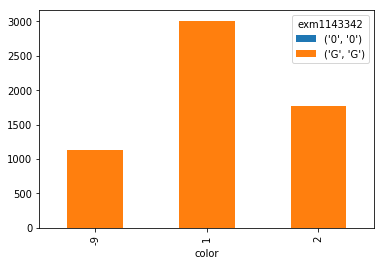

rs143963667


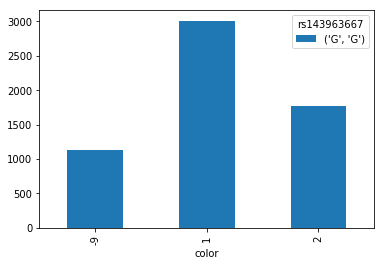

rs146521940


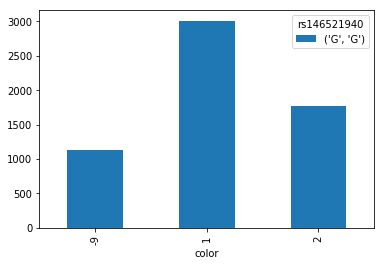

rs139953376


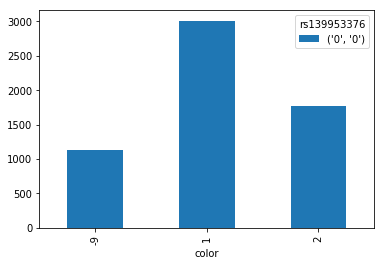

rs142209264


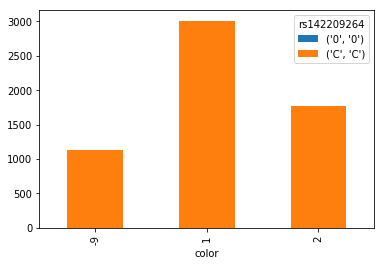

exm1143356


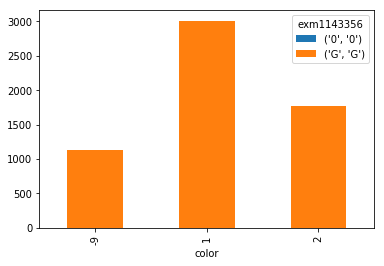

rs140289168


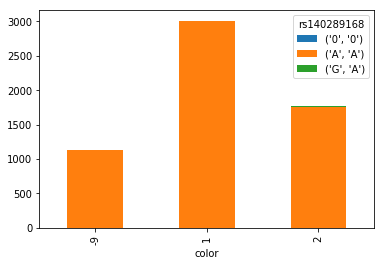

rs200121672


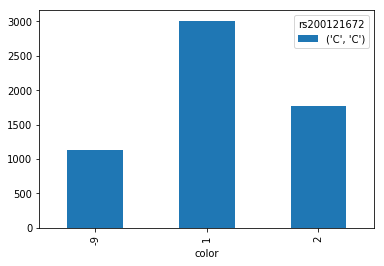

rs201578529


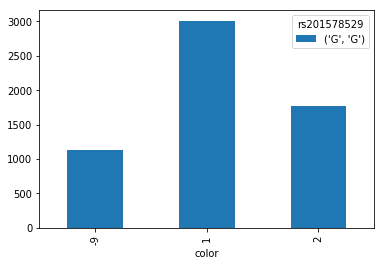

rs147681848


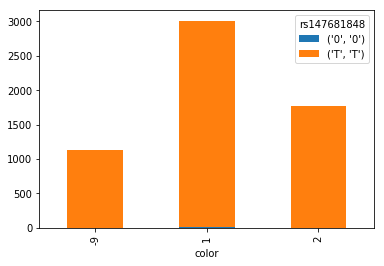

rs61756152


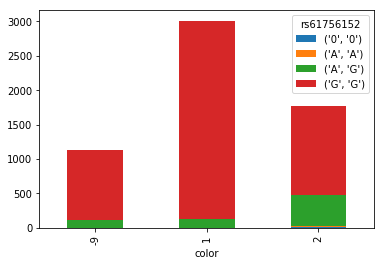

rs200158883


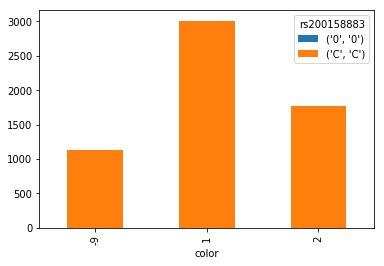

exm1143365


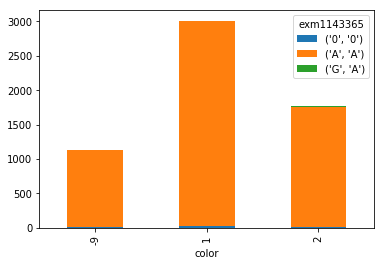

exm1143368


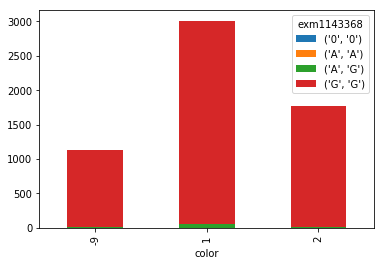

rs146303265


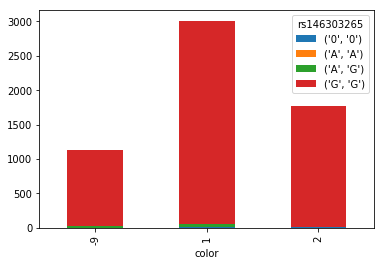

rs138954615


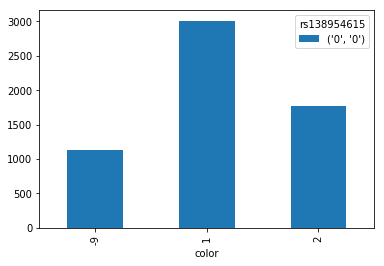

rs201933251


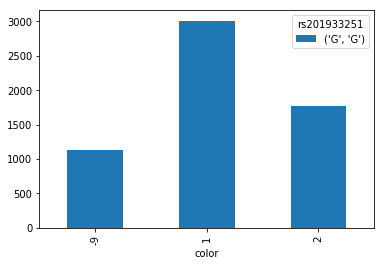

exm1143371


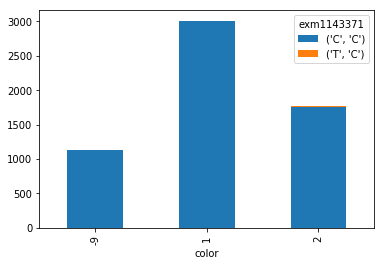

rs149437745


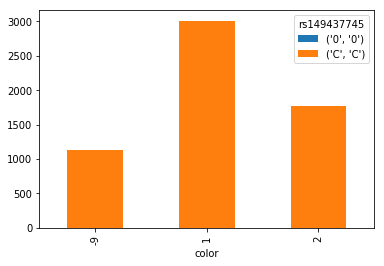

rs148786700


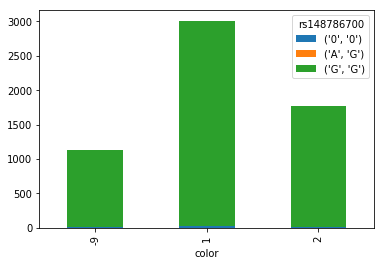

exm1143373


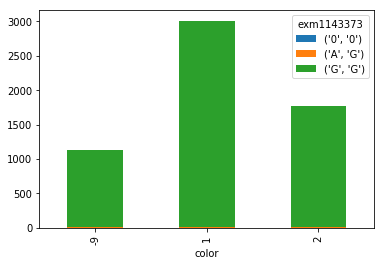

rs145438661


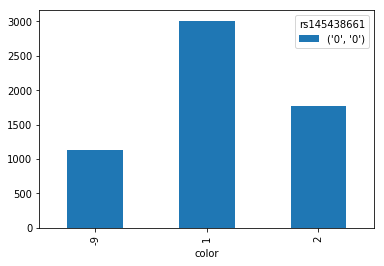

rs139163401


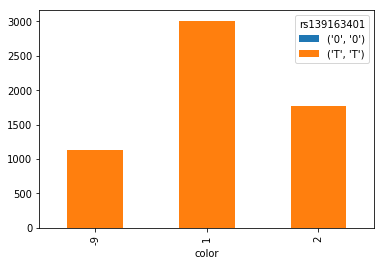

rs150517241


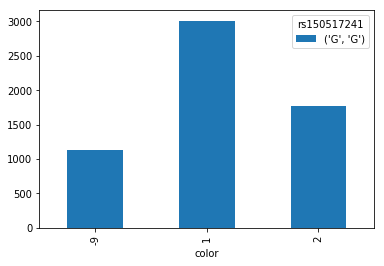

exm1143381


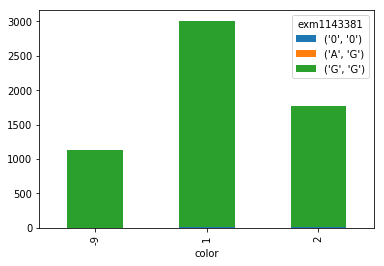

rs201715294


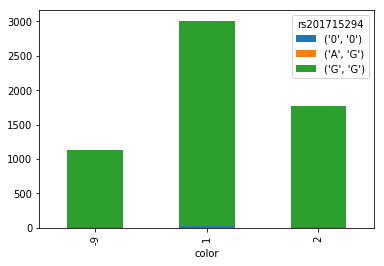

rs192607416


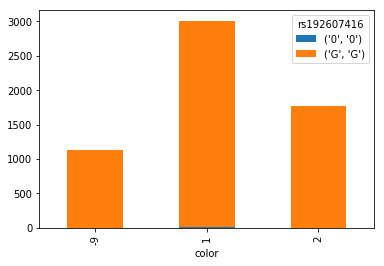

rs149756942


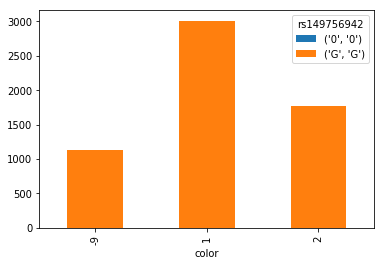

rs7494786


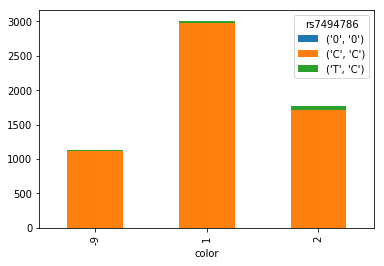

rs148456855


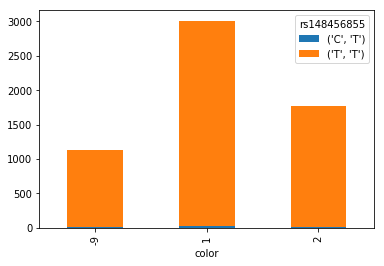

rs185547854


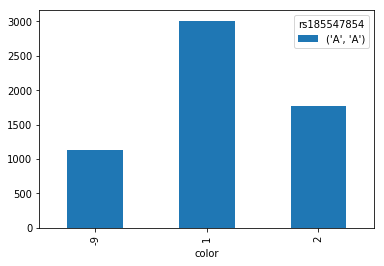

rs113455813


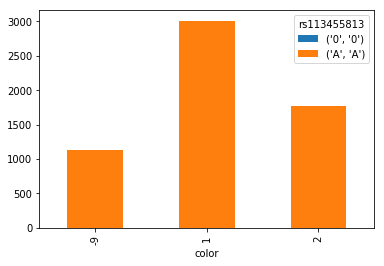

rs145190727


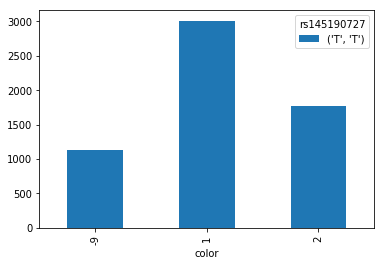

exm1143388


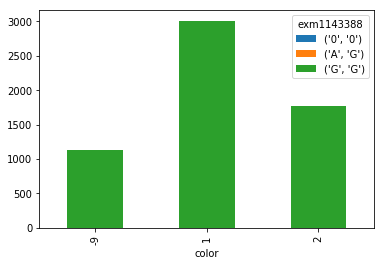

rs147697168


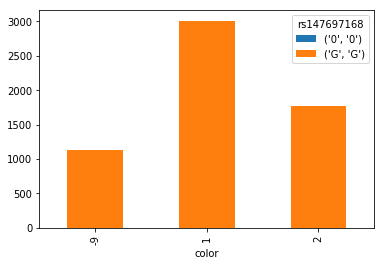

rs201182375


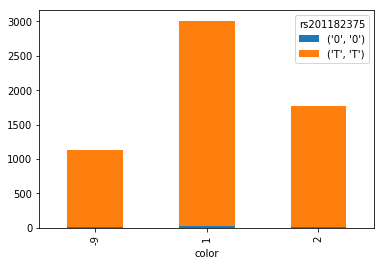

rs146504253


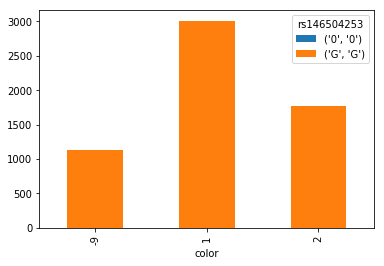

rs151256890


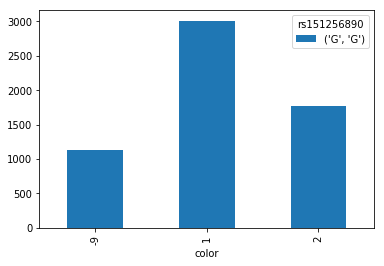

rs141441362


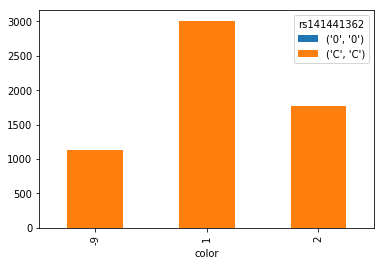

rs138301091


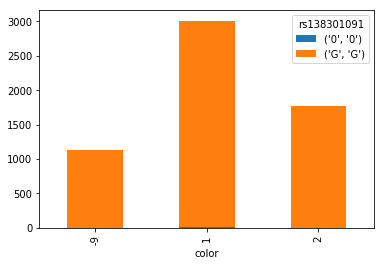

rs77865049


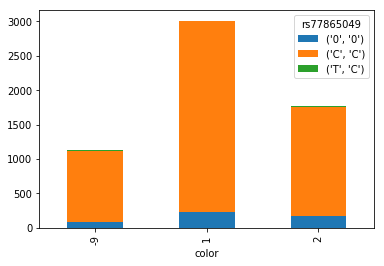

rs78696453


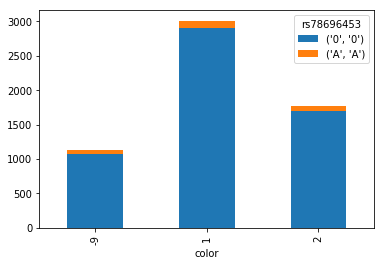

rs117437554


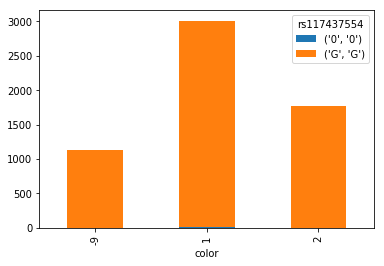

rs149592795


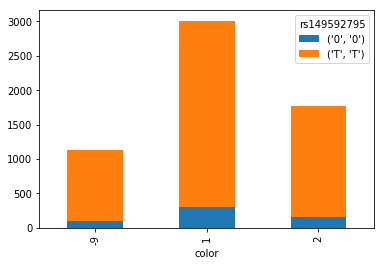

rs113016718


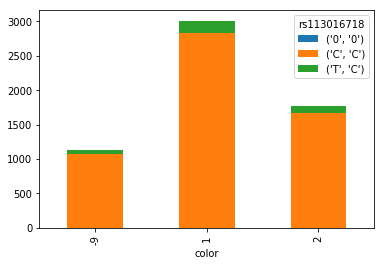

rs113427095


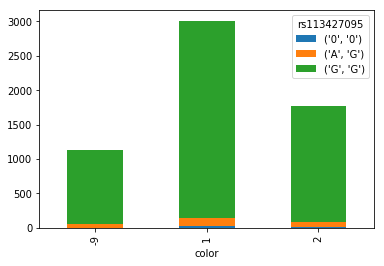

rs139335991


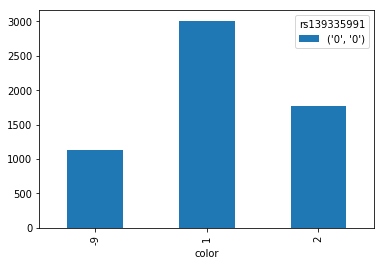

rs139728053


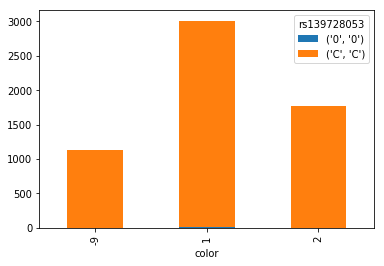

rs145255977


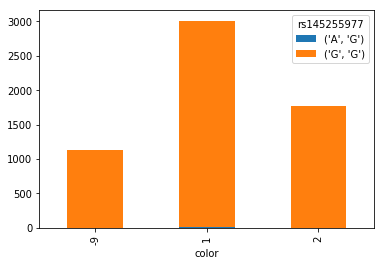

rs139973203


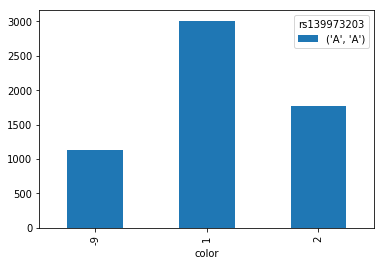

rs149809183


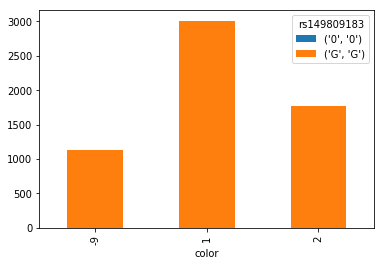

rs145759817


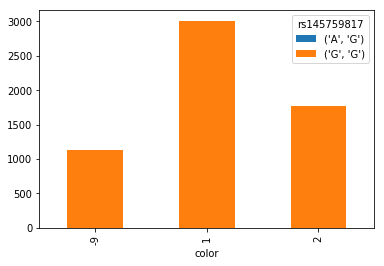

rs148929519


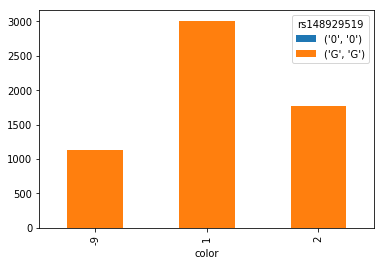

exm1143427


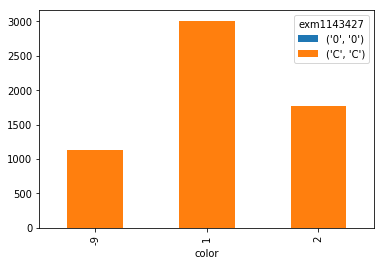

rs151122646


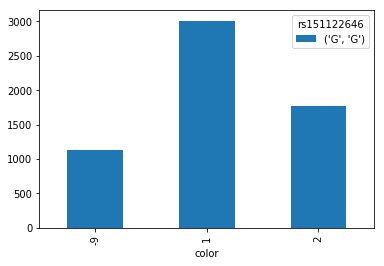

rs141457389


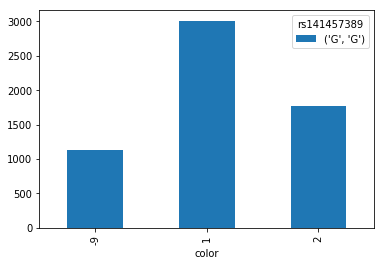

rs61756153


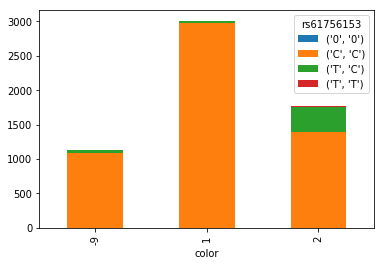

rs61756154


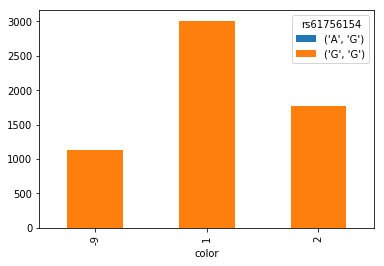

exm1143433


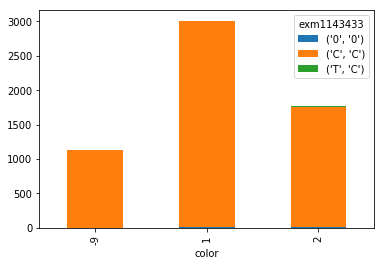

rs202126440


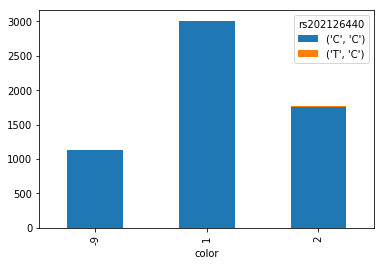

rs148092853


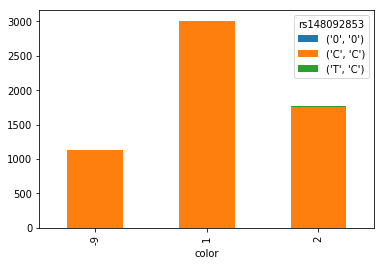

rs9806328


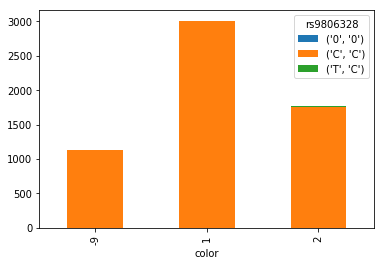

rs200931637


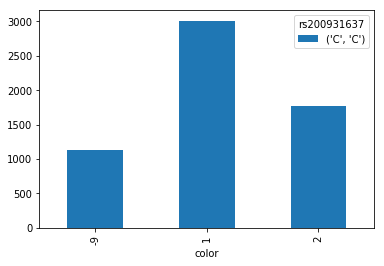

rs199850400


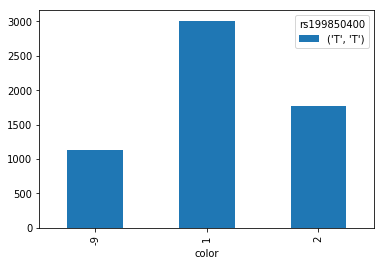

rs144426894


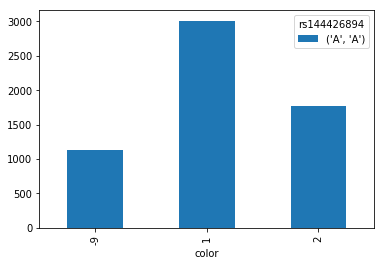

rs137879939


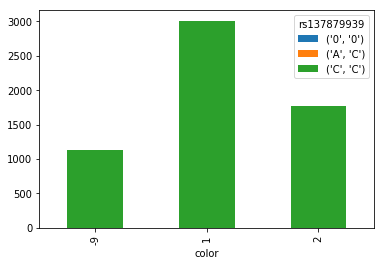

rs61755663


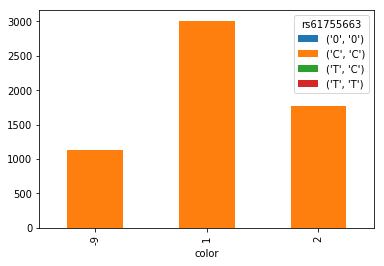

rs185388345


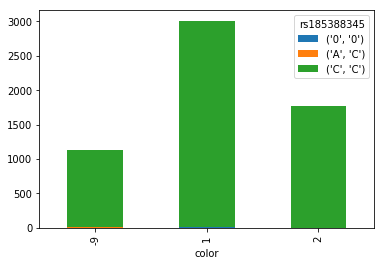

rs147216292


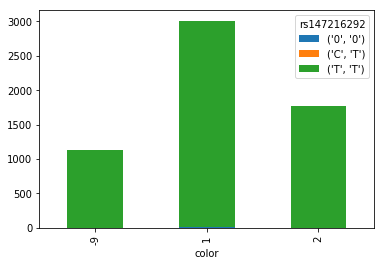

exm1826173


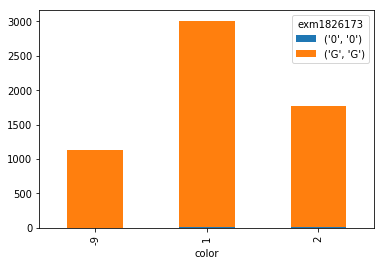

rs201136198


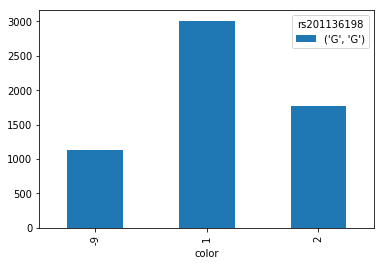

rs140556070


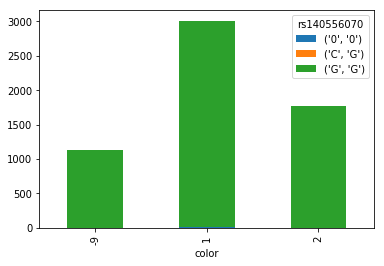

rs142140993


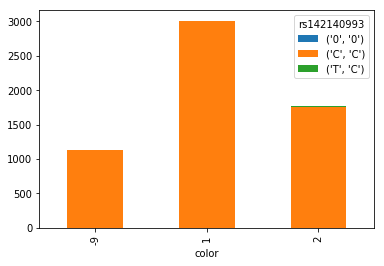

exm1143448


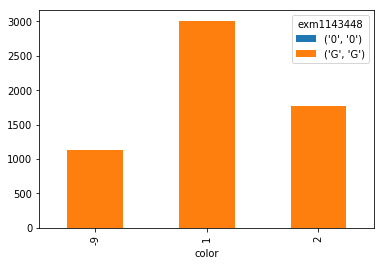

rs139292388


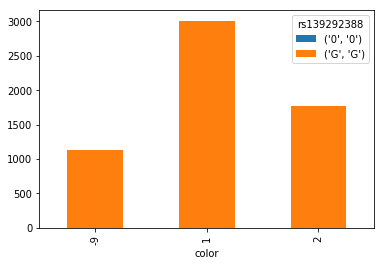

exm1826183


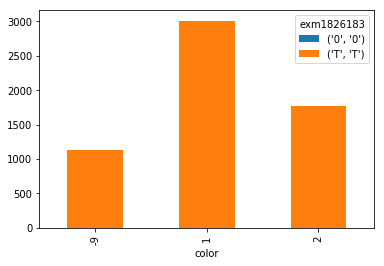

rs140167298


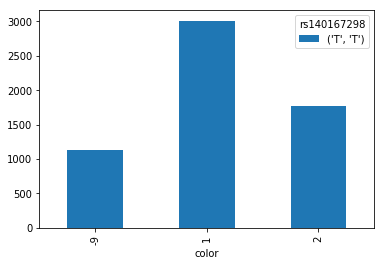

exm1143455


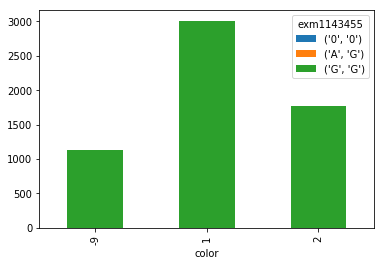

rs143706639


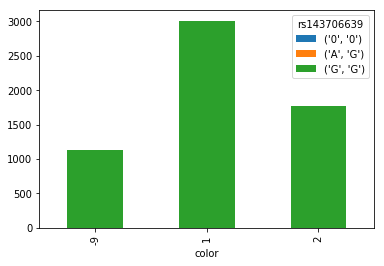

rs146558015


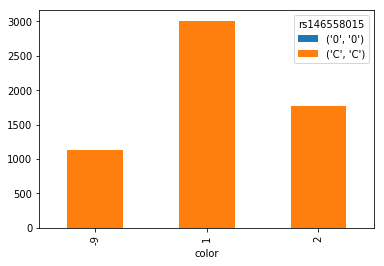

exm1826186


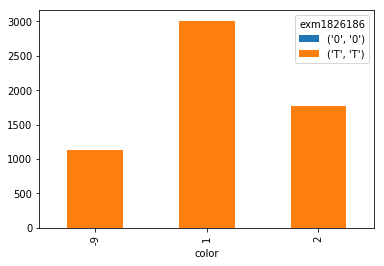

rs141210218


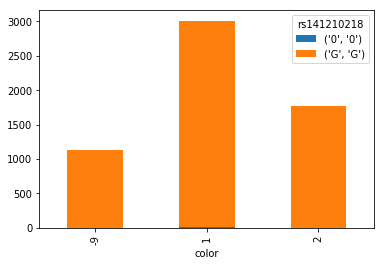

exm1143463


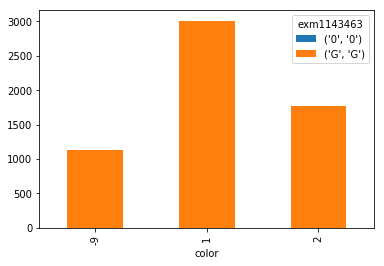

rs61755662


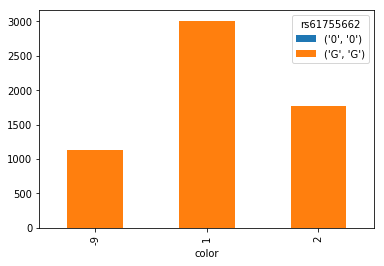

rs146864624


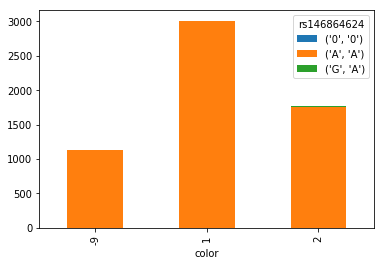

rs143746586


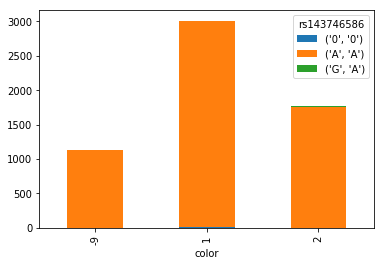

rs148225341


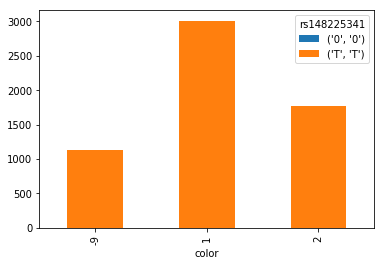

rs138960481


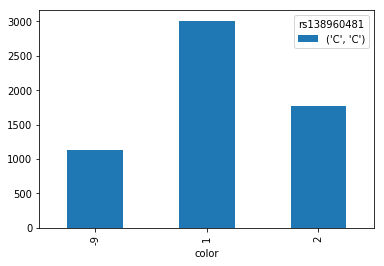

rs146366728


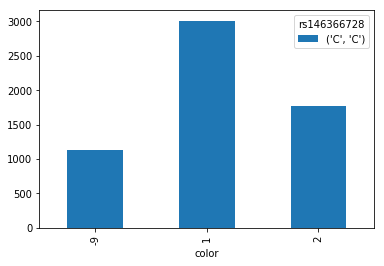

rs76296532


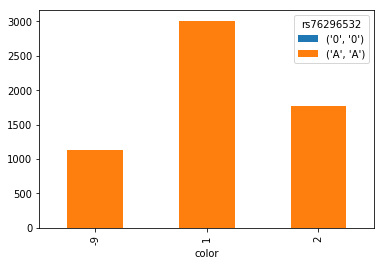

rs146159039


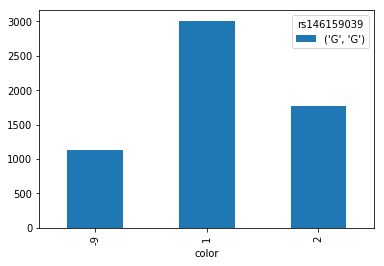

rs138887223


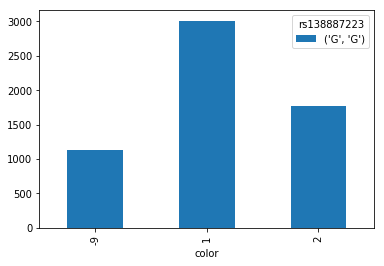

rs74005645


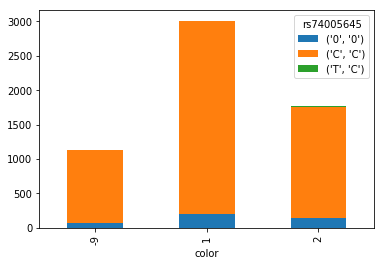

rs148451375


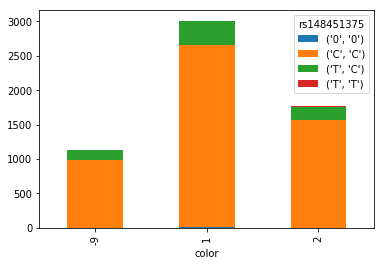

rs146090836


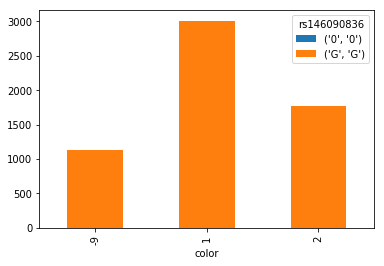

rs140027229


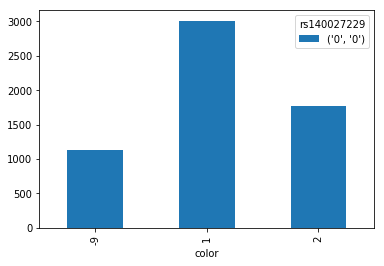

rs2905946


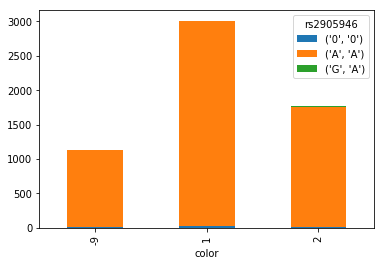

rs74789945


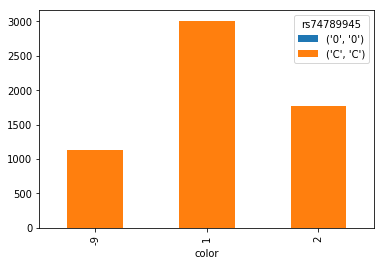

rs146883683


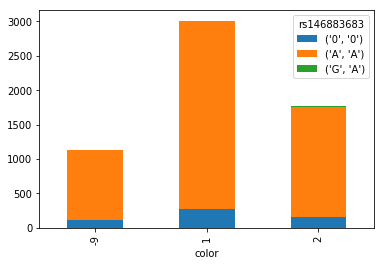

rs2238289


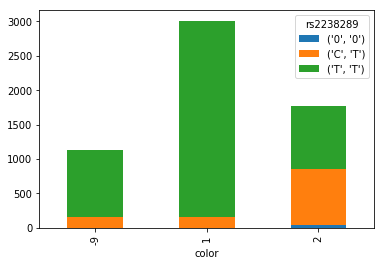

rs149188455


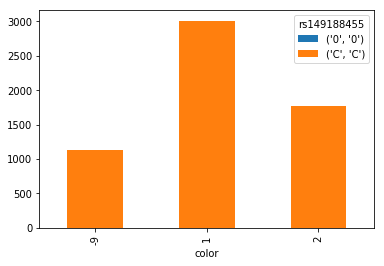

rs146969415


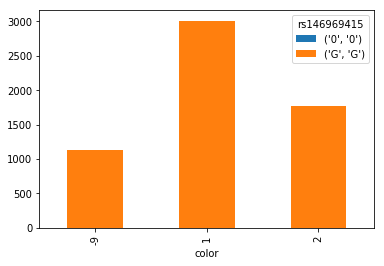

rs200651761


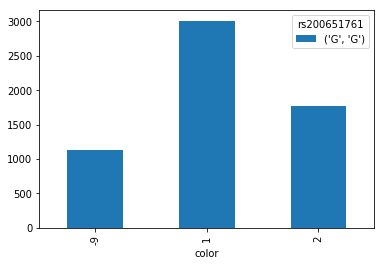

rs147576051


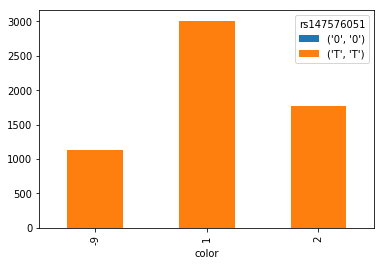

rs141969705


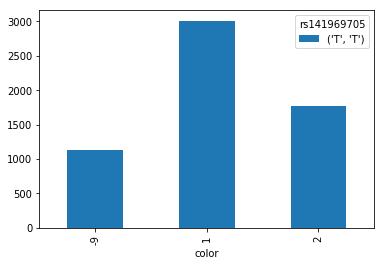

rs145730767


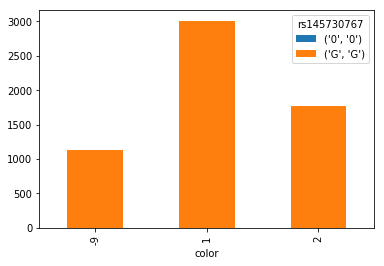

rs138636407


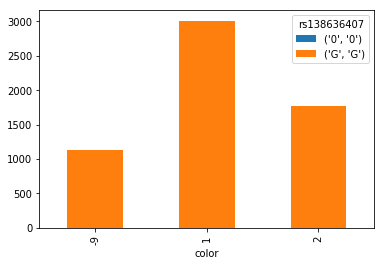

rs150374233


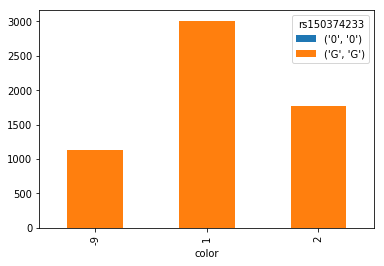

rs187225254


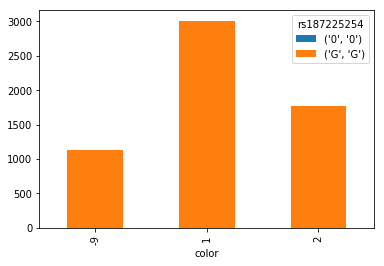

rs200605180


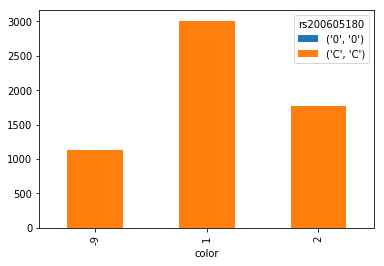

rs191942261


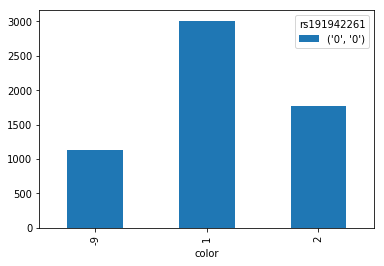

rs199647215


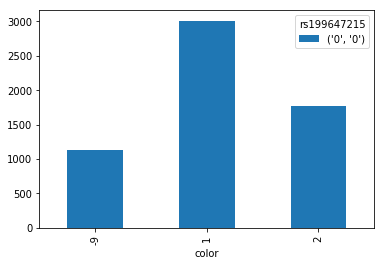

rs200377671


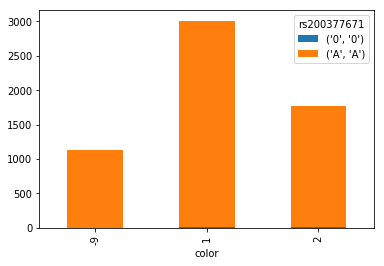

rs138059246


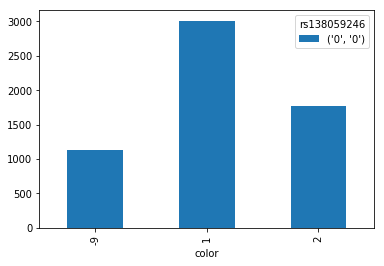

rs182540215


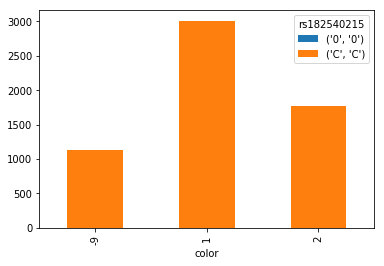

rs187585476


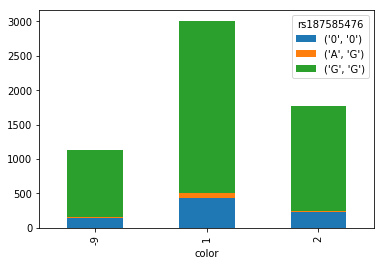

rs193014113


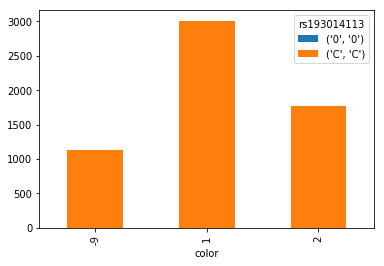

rs149498499


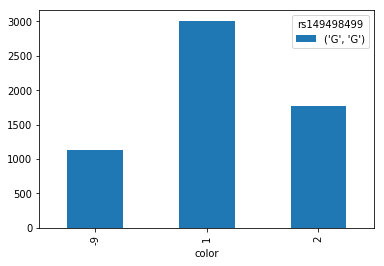

rs142615958


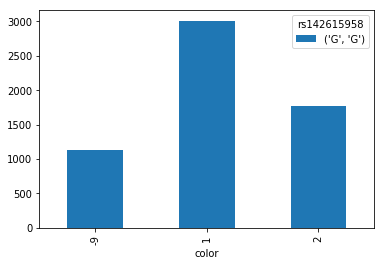

rs140060040


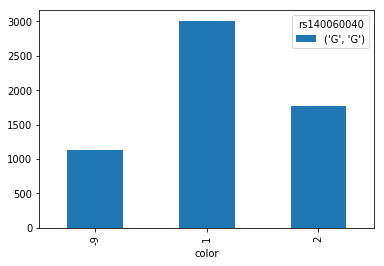

rs141981089


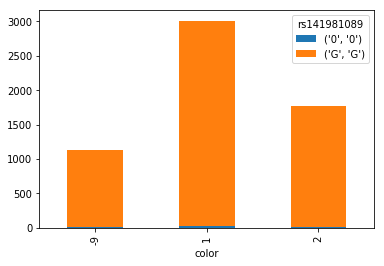

rs148503135


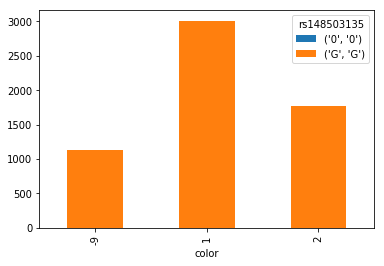

rs2905939


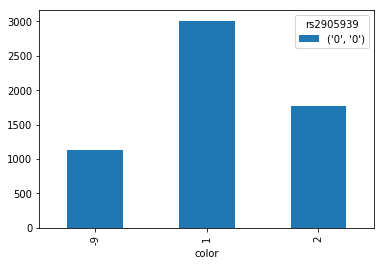

rs151115059


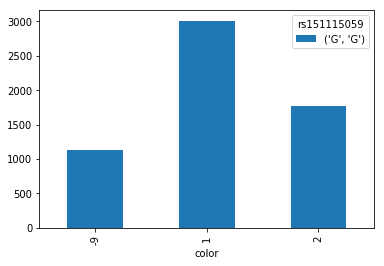

rs144780847


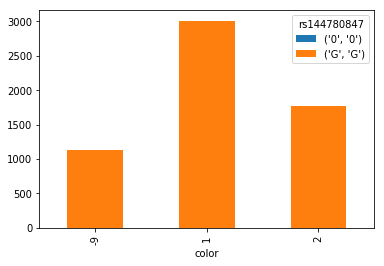

rs192403364


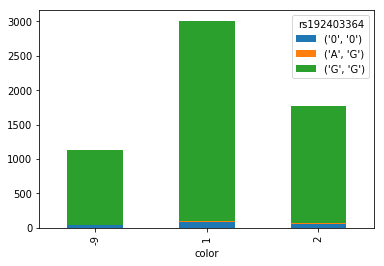

rs142034055


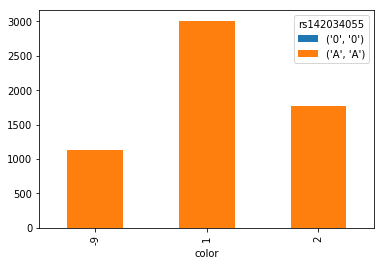

rs186663694


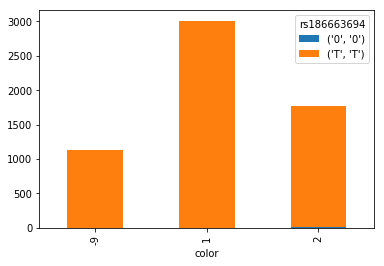

rs145481625


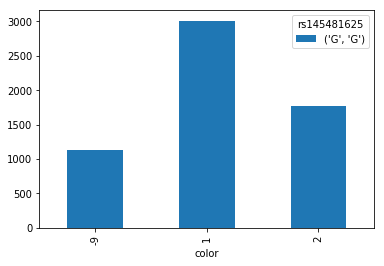

rs148823452


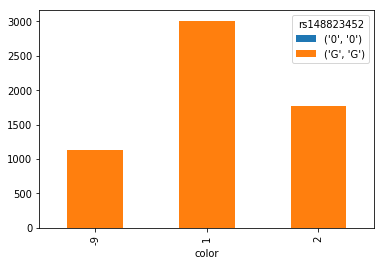

rs148050334


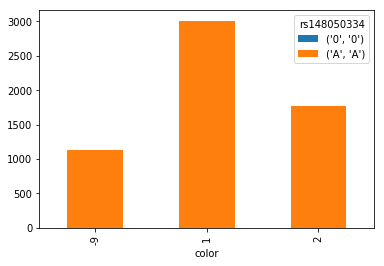

rs140839645


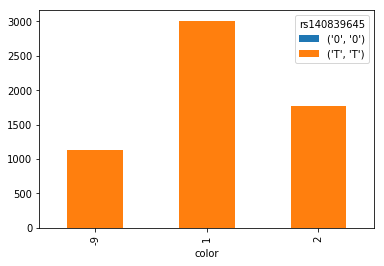

rs144750946


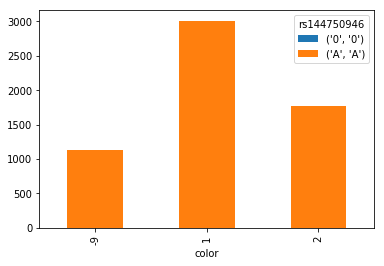

rs138650689


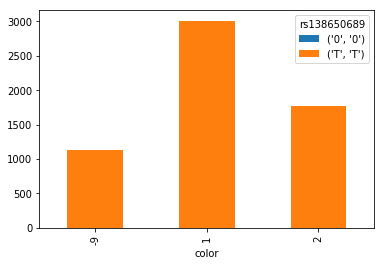

rs142072884


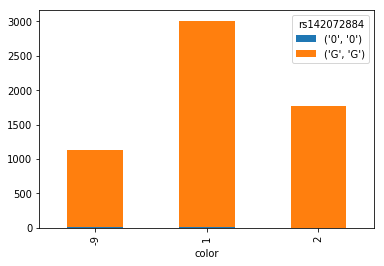

rs200571641


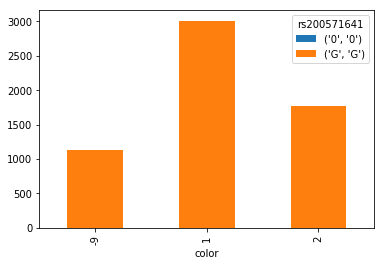

rs138177581


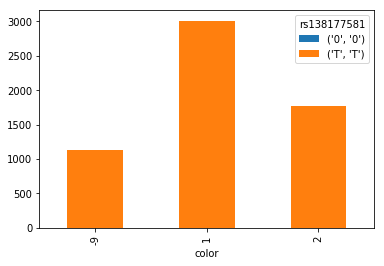

exm1143596


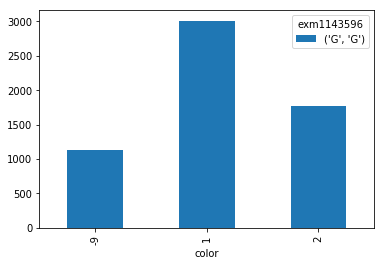

rs148787940


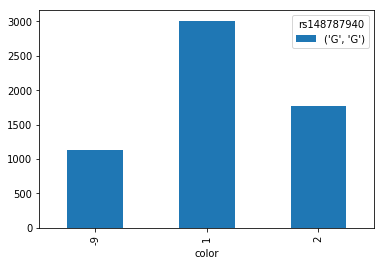

rs147519395


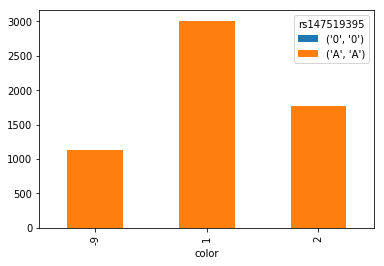

rs140073033


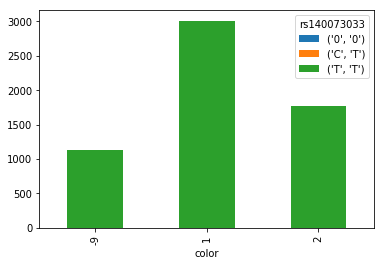

rs118112076


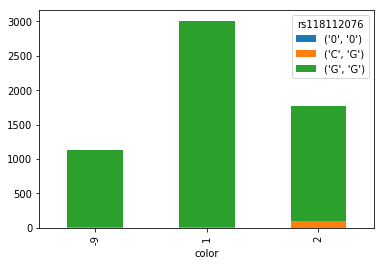

rs151157361


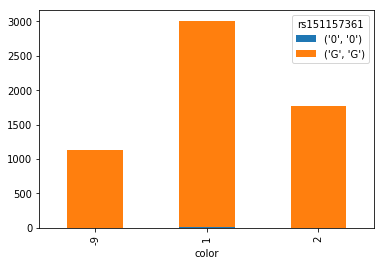

rs202102990


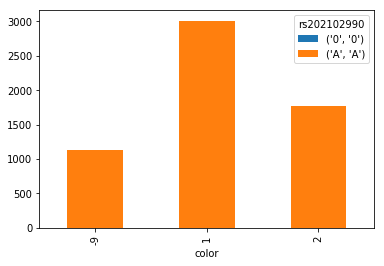

rs141145226


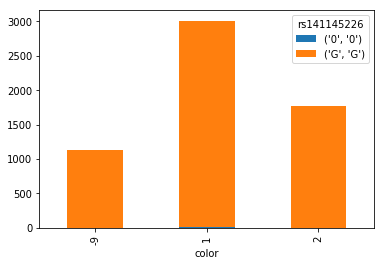

rs201872292


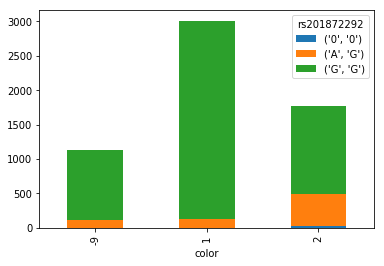

rs61757160


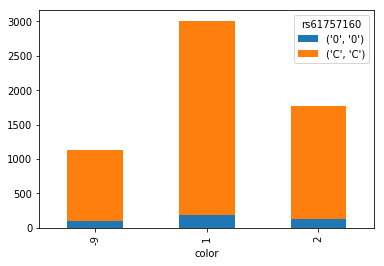

rs112385654


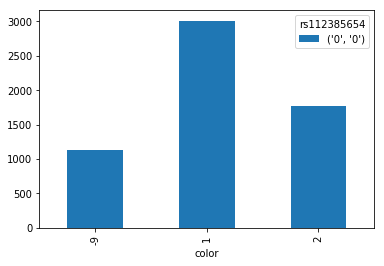

rs140338897


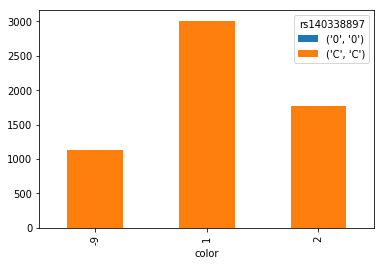

rs143710331


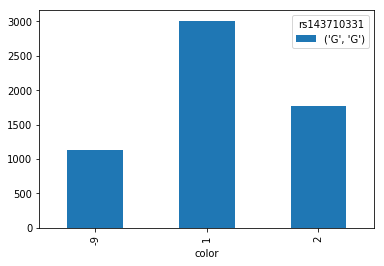

rs2525981


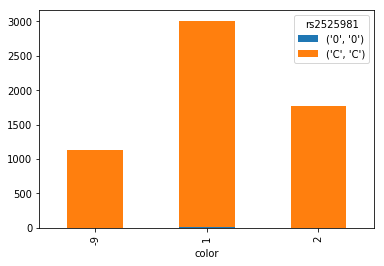

rs141847559


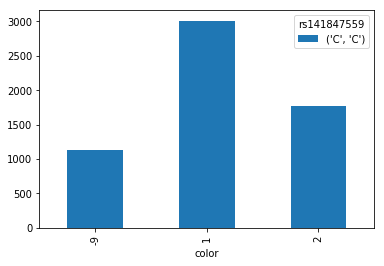

rs145594989


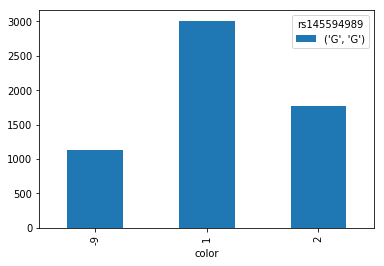

rs138699937


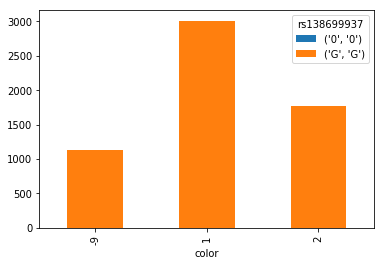

rs143358156


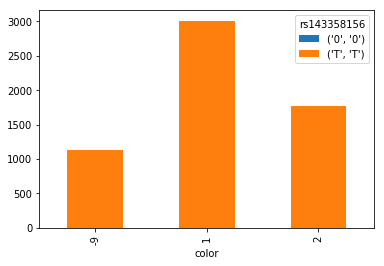

rs147535565


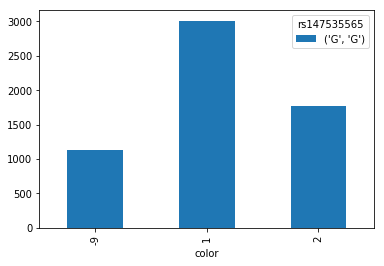

rs140087429


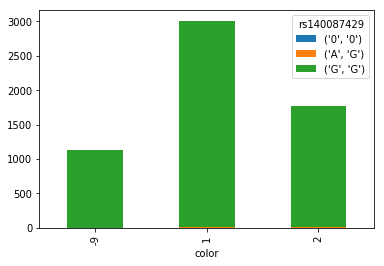

rs145512084


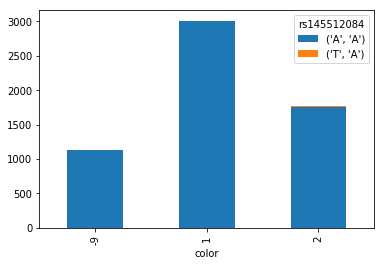

rs144504965


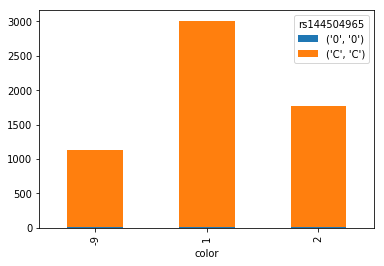

rs143130515


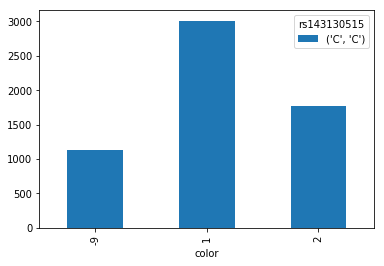

rs142553001


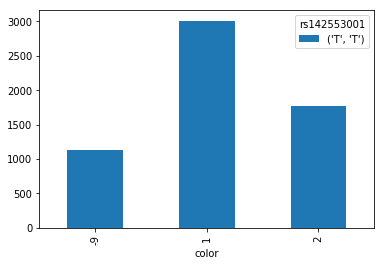

rs149204675


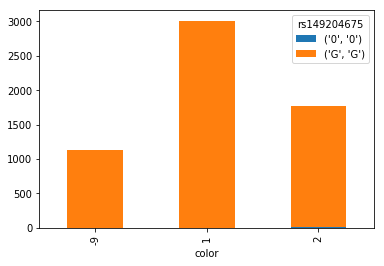

rs146777193


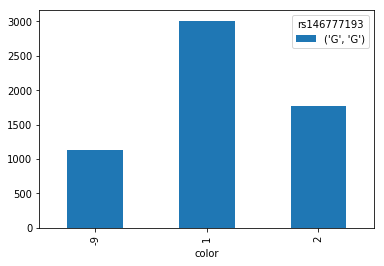

rs201929435


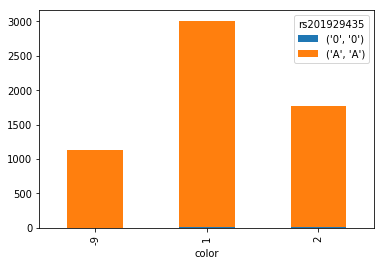

rs8028689


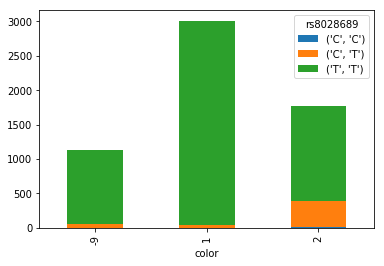

rs143530683


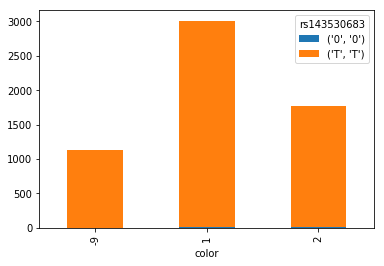

exm1143660


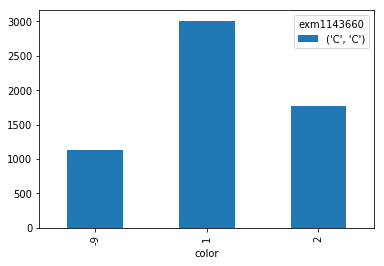

rs112230913


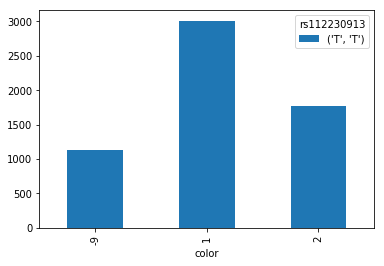

rs140345440


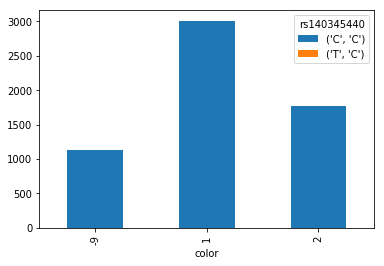

rs112980995


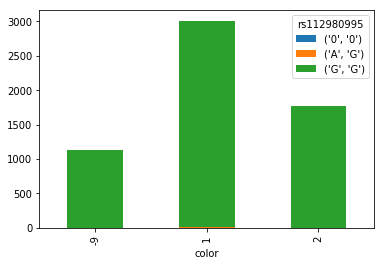

rs145261792


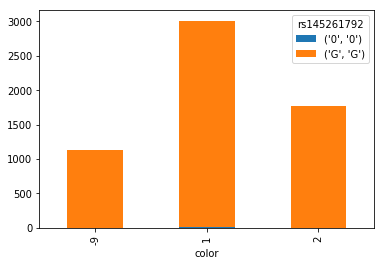

exm2223105


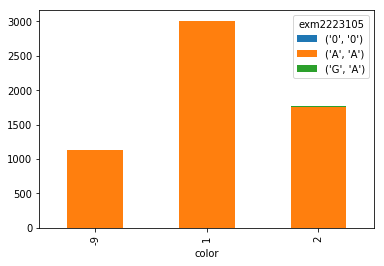

rs143557450


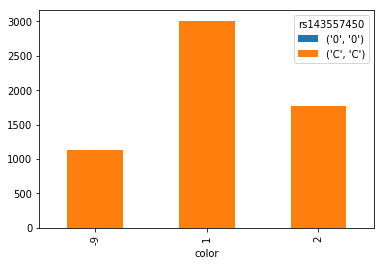

exm1143673


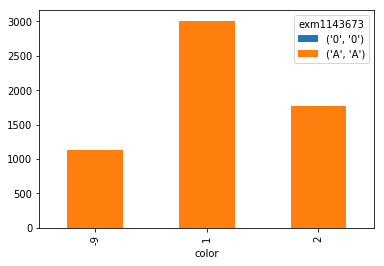

rs78460234


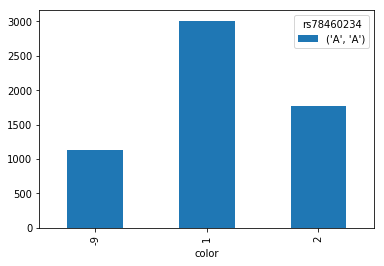

rs139087469


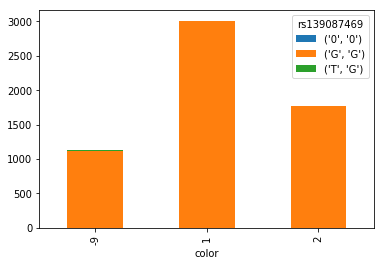

exm1143675


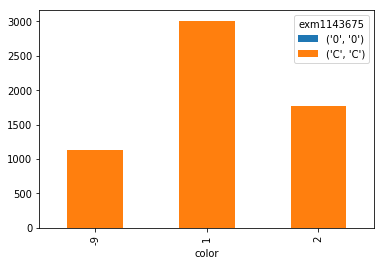

rs142950889


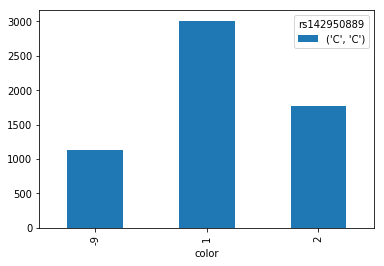

exm1143676


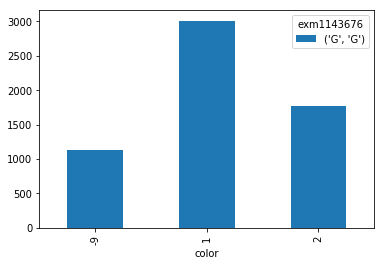

rs183120284


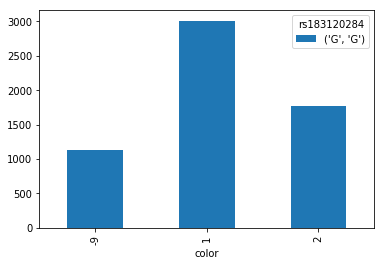

rs2240203


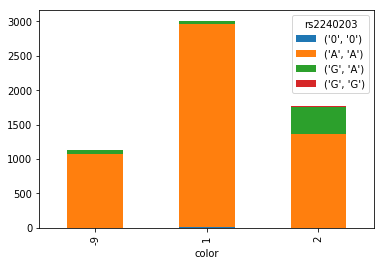

rs147116947


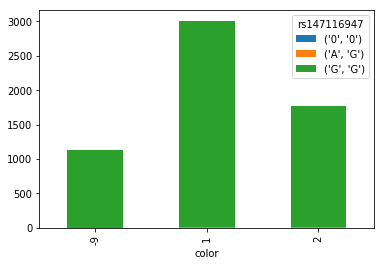

rs138520526


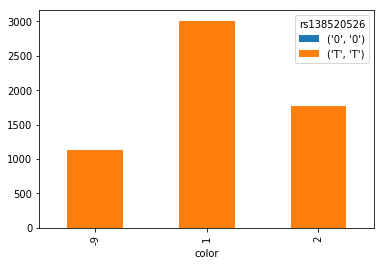

rs141958604


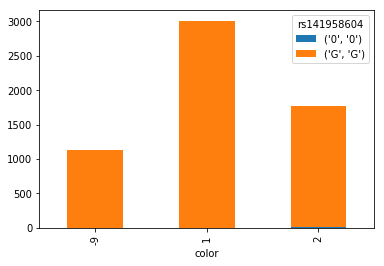

exm1143687


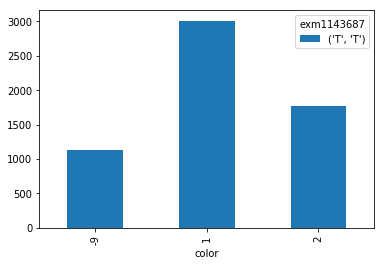

exm1143689


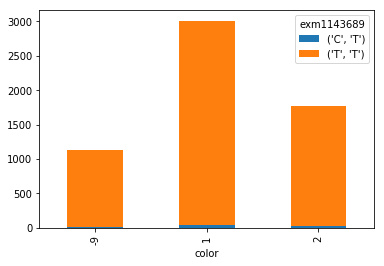

rs150675000


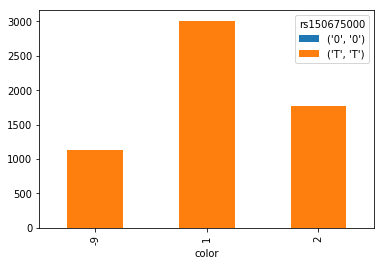

rs183596087


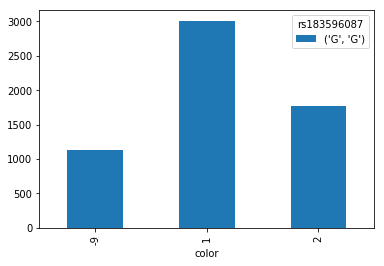

exm1143698


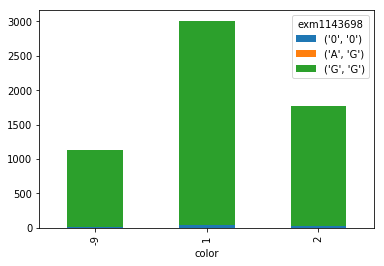

rs146056234


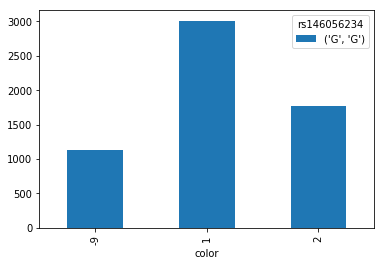

rs139718674


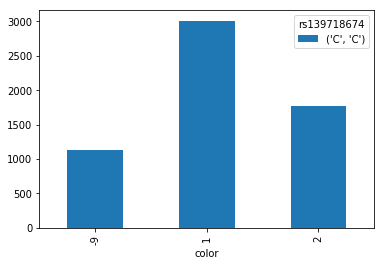

rs143948512


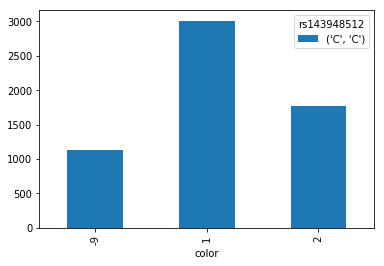

rs139813405


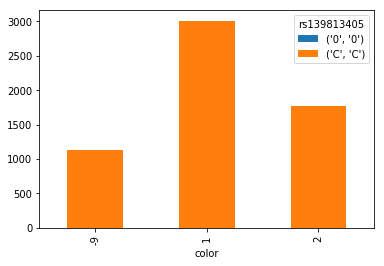

rs189875557


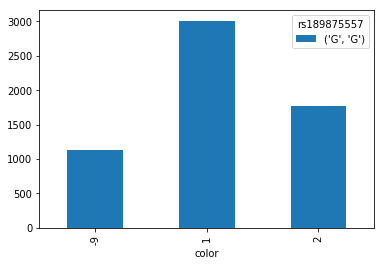

exm1143712


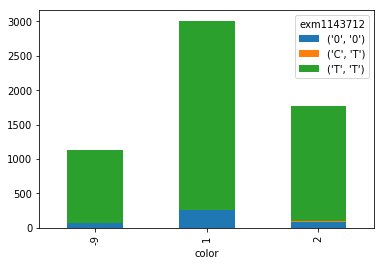

rs61754659


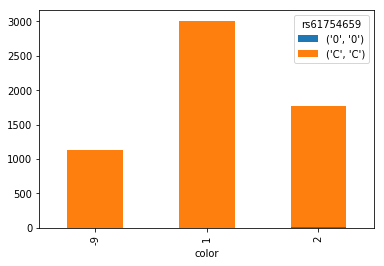

rs61754658


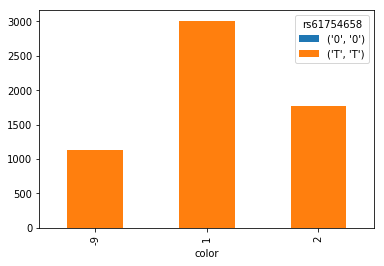

rs150992740


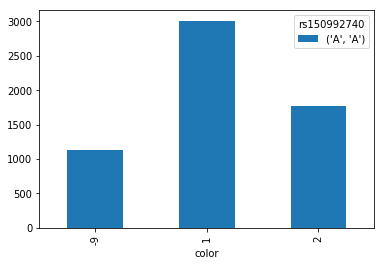

rs9302376


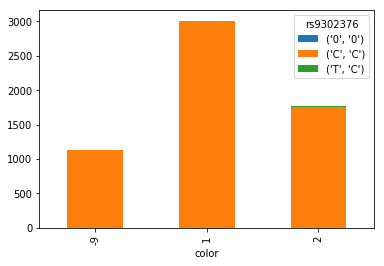

rs140828208


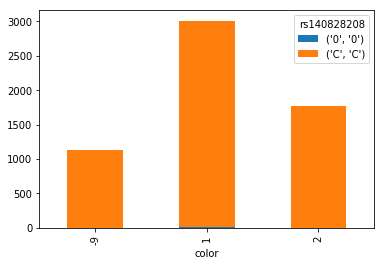

rs139612007


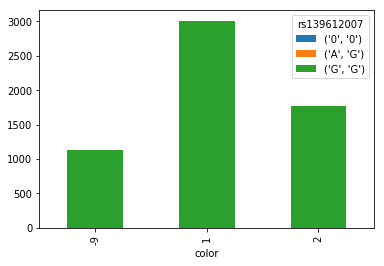

rs147892890


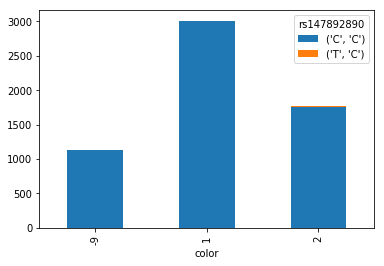

rs141562067


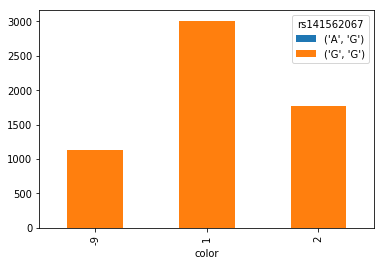

rs138275638


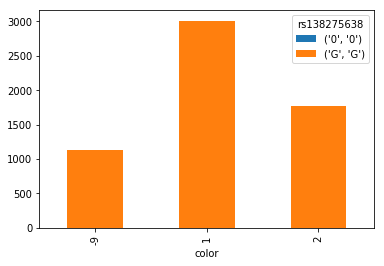

rs201542966


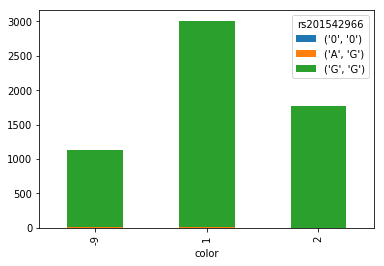

rs115292133


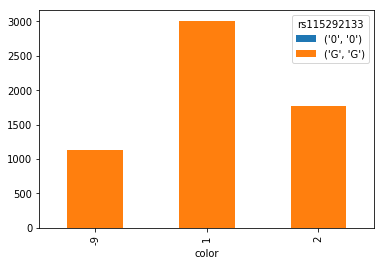

rs199900591


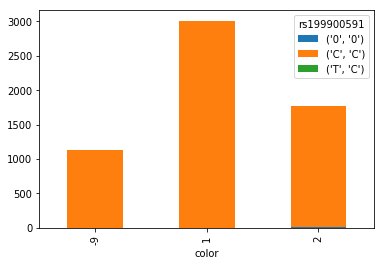

rs148362399


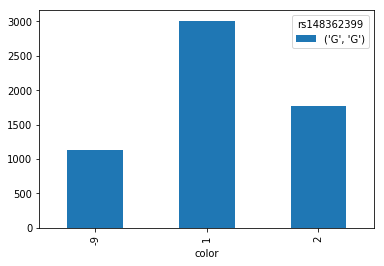

rs141495562


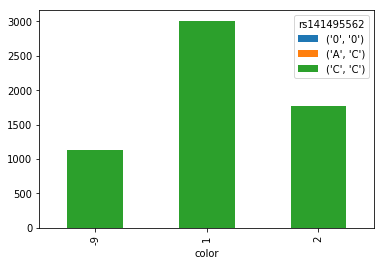

rs149755238


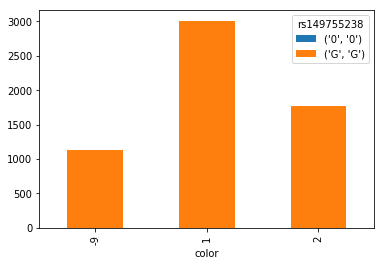

exm1143745


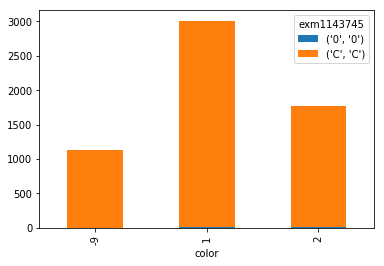

rs139846899


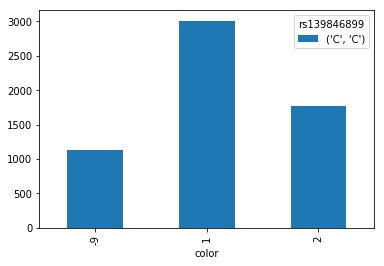

rs189497233


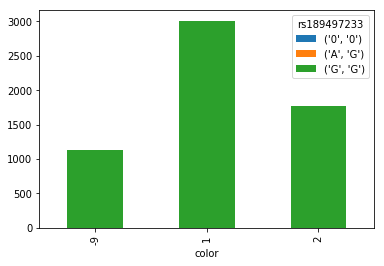

exm-rs916977


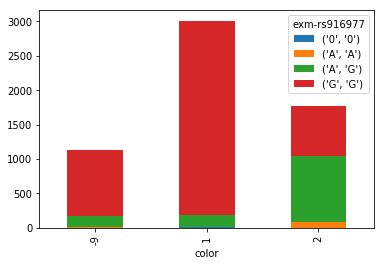

rs146191030


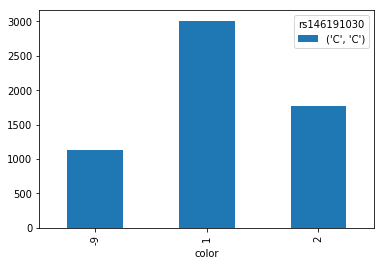

rs184405901


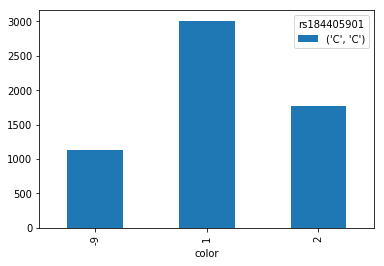

rs149969678


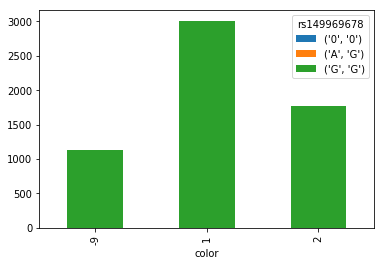

rs117702353


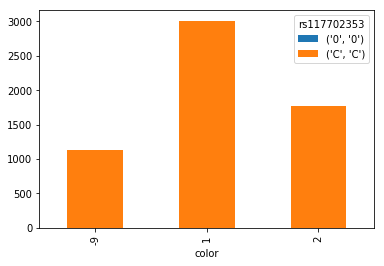

rs199686180


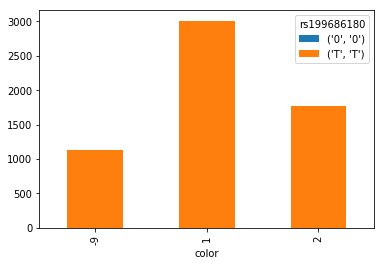

rs201936190


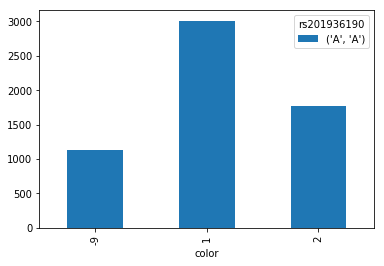

rs145043009


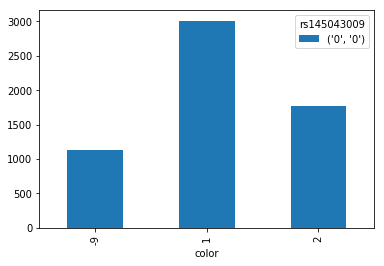

rs185860718


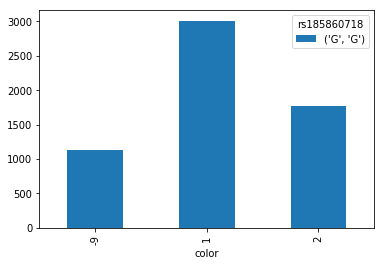

rs201661507


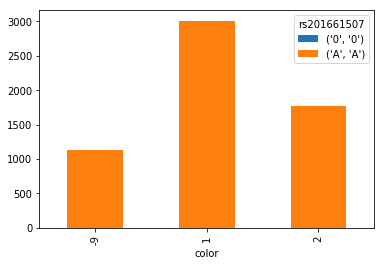

rs142149022


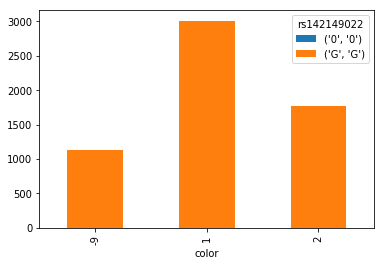

rs8039195


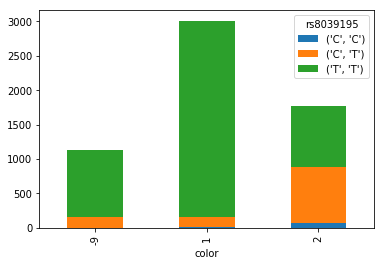

exm1143766


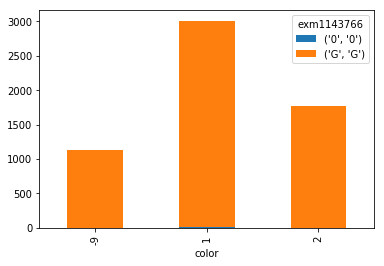

rs141677977


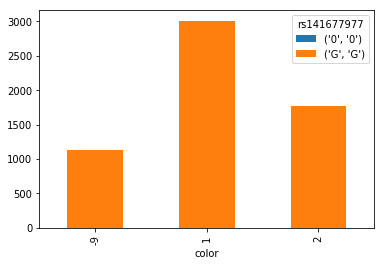

rs145436238


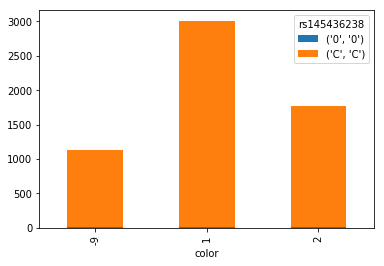

rs151179905


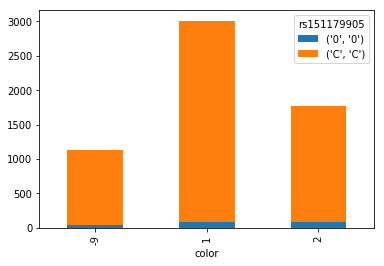

rs147678868


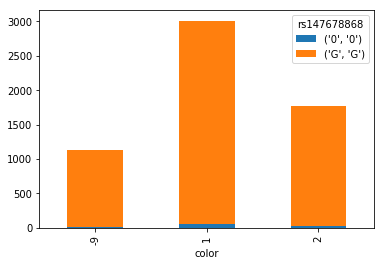

rs140932450


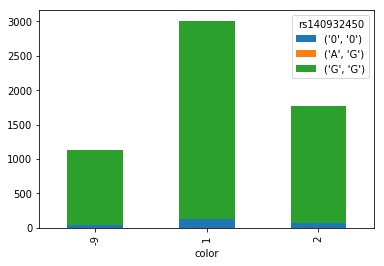

exm1143772


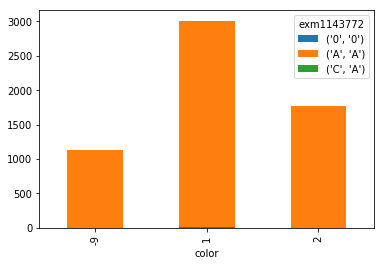

rs75181529


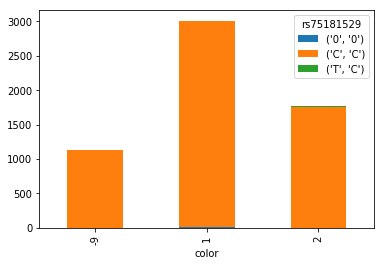

rs183864117


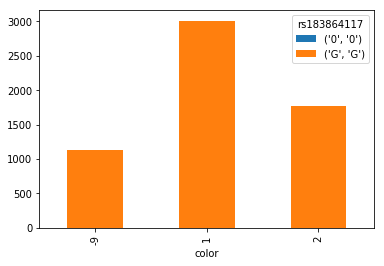

rs28457230


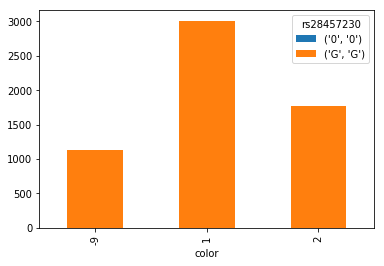

rs77399744


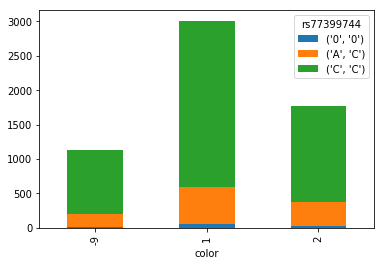

exm1143790


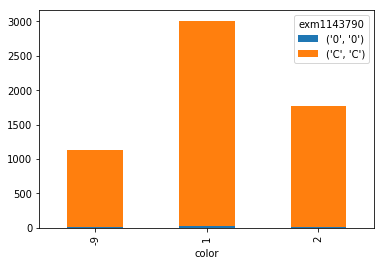

exm1143794


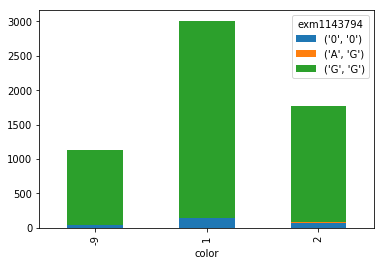

rs146210640


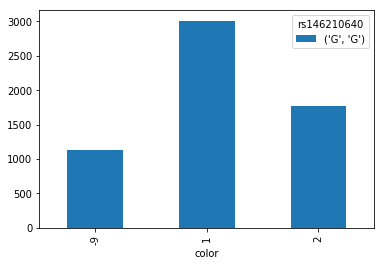

rs143576992


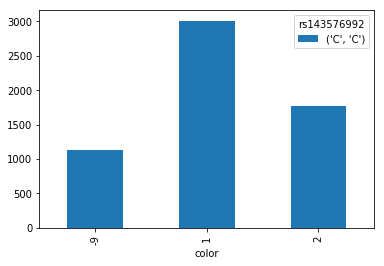

rs146826633


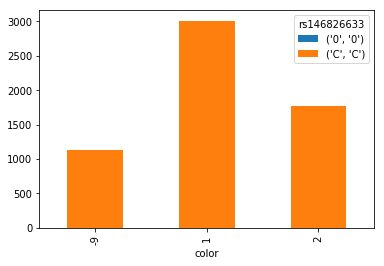

rs16950975


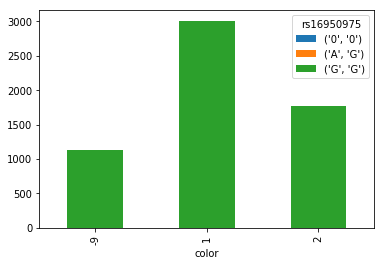

rs150593330


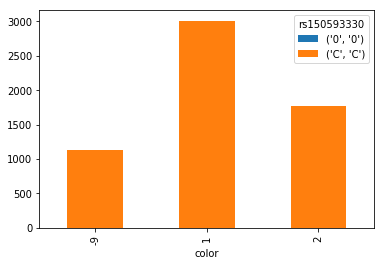

rs199790436


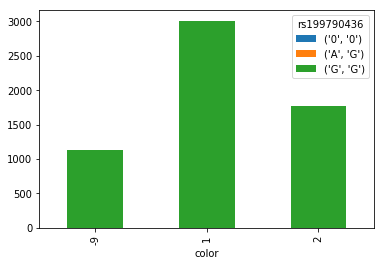

exm1143809


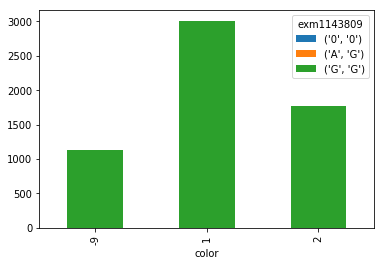

exm1143812


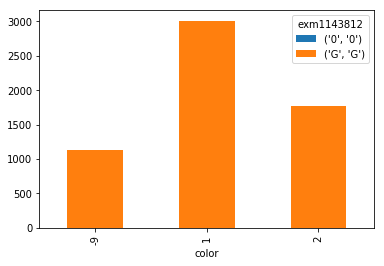

rs144496043


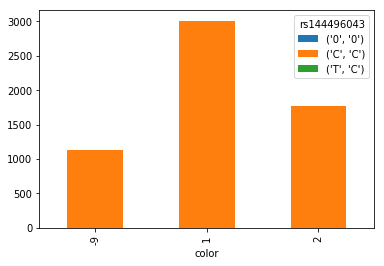

rs147414523


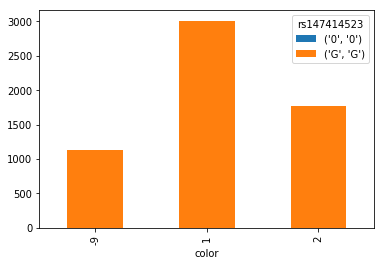

exm1143816


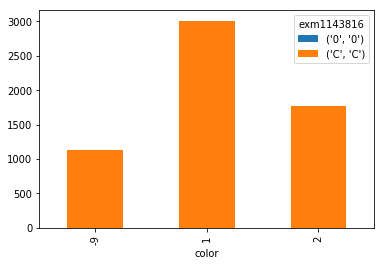

rs139657402


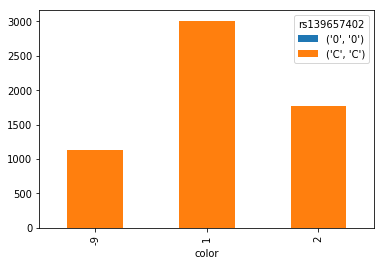

rs148005149


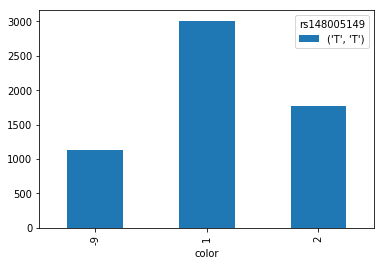

rs113149522


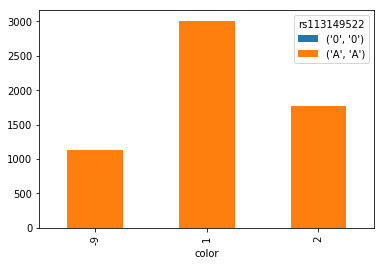

exm1143818


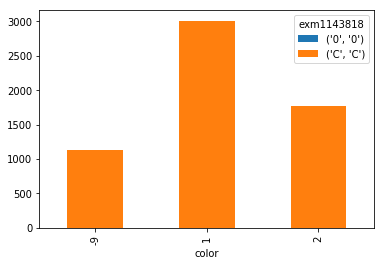

rs79860193


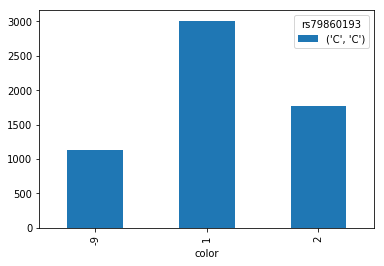

rs147680647


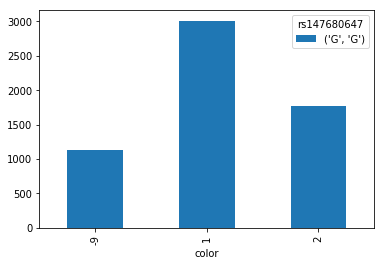

rs149140322


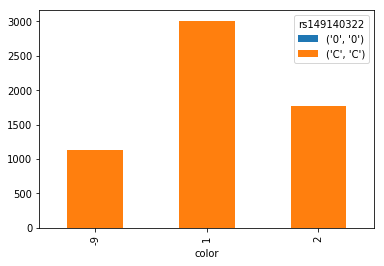

exm-rs1667394


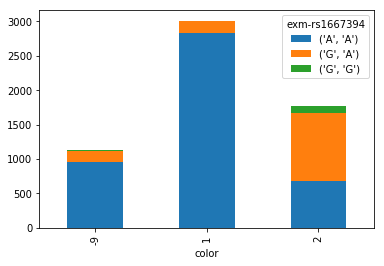

rs151331392


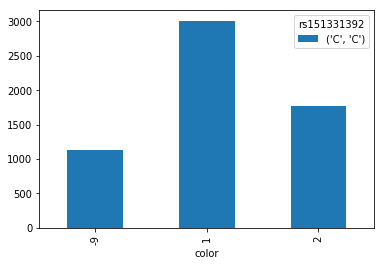

rs140630729


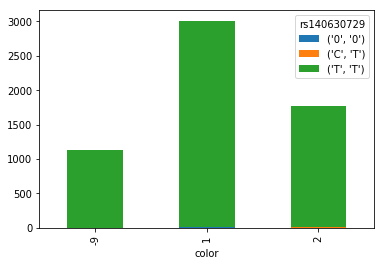

rs145883454


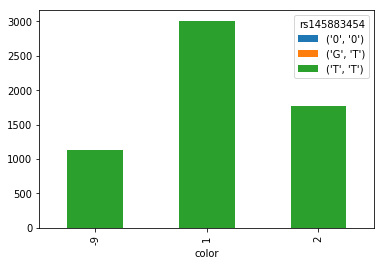

rs138445418


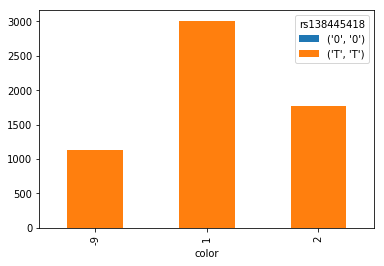

rs141325407


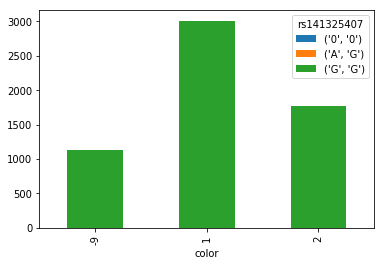

rs200255984


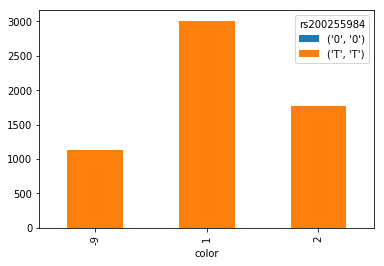

rs145357309


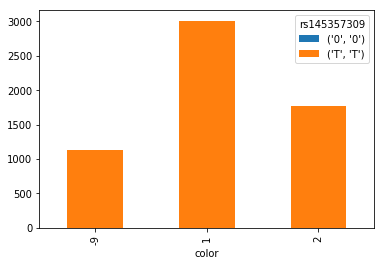

rs137965017


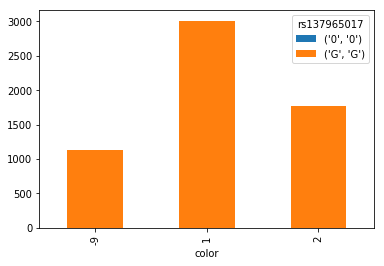

rs75131382


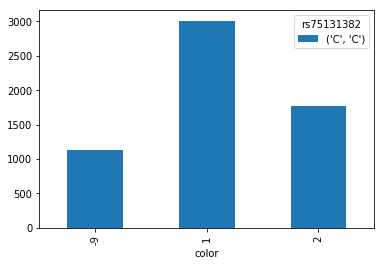

rs8036234


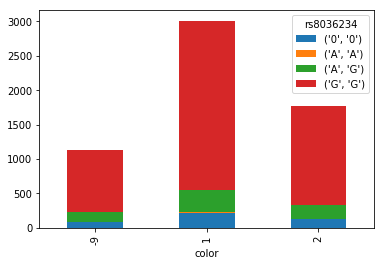

rs8040604


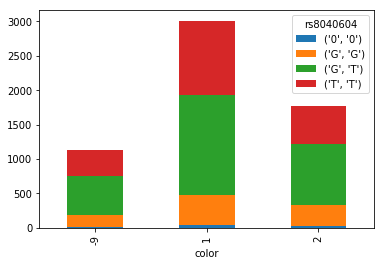

rs9744156


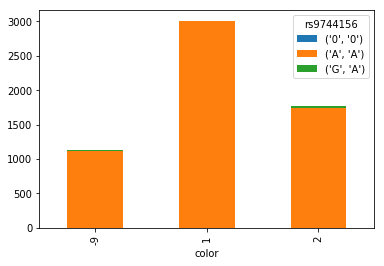

kgp11961511


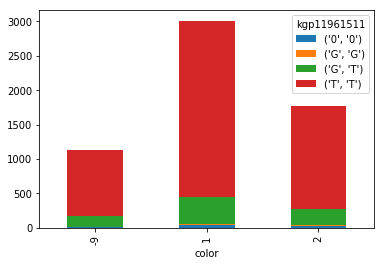

kgp9000632


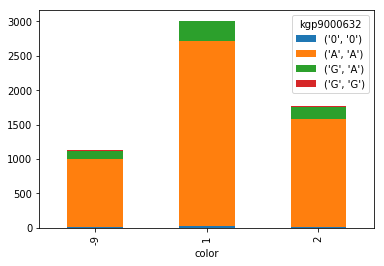

kgp7894071


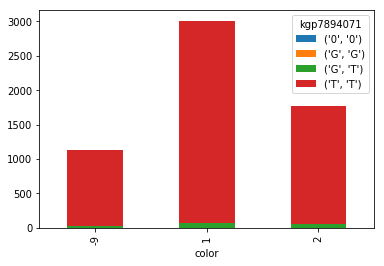

rs8025972


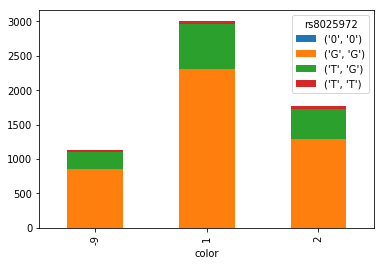

rs11070769


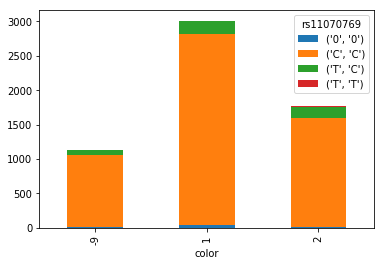

rs4591103


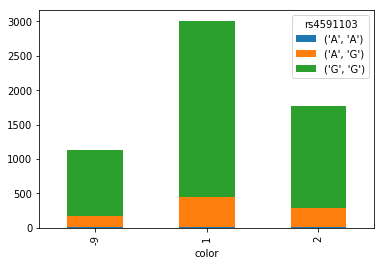

rs12324117


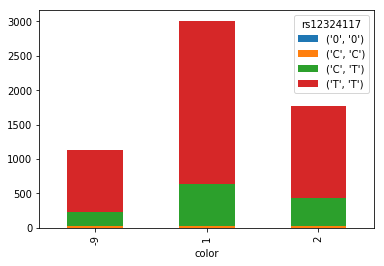

rs17680945


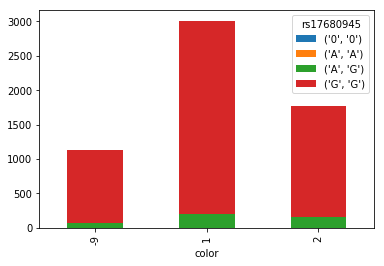

rs2336912


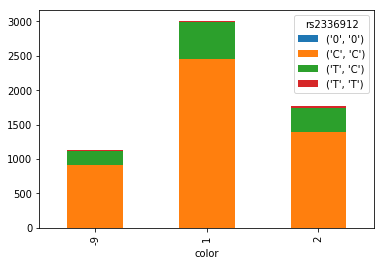

rs8035791


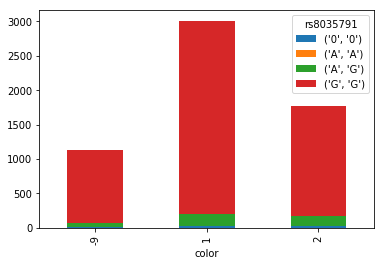

exm2264571


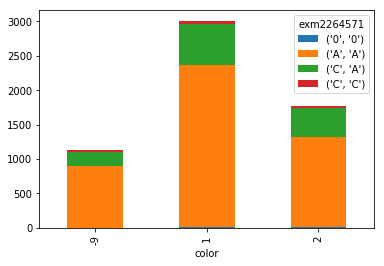

rs937050


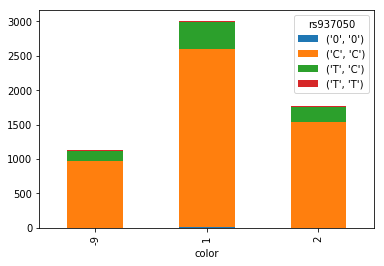

rs1994597


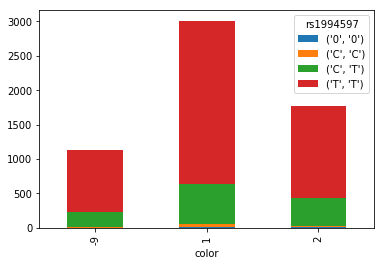

rs12595674


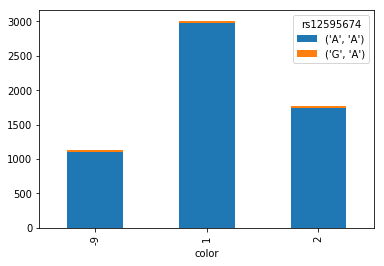

rs16954986


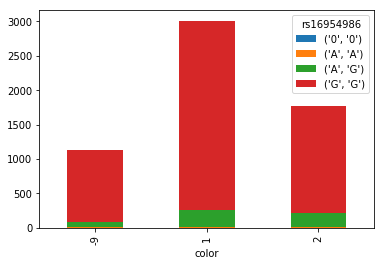

rs1490078


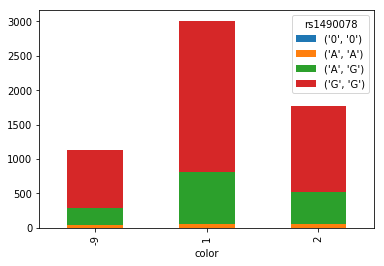

rs1490079


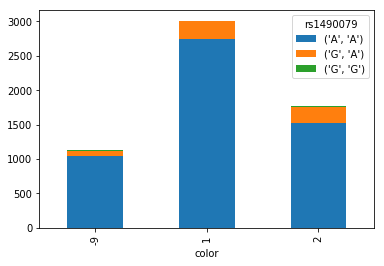

rs2077778


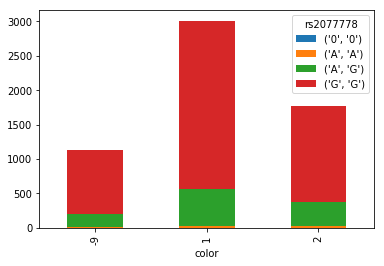

rs17748747


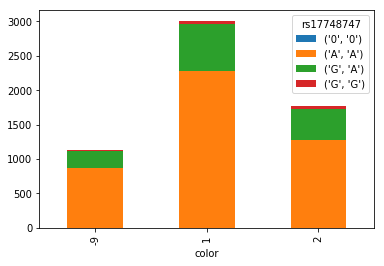

exm1143882


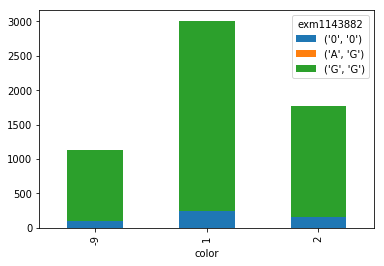

exm1143883


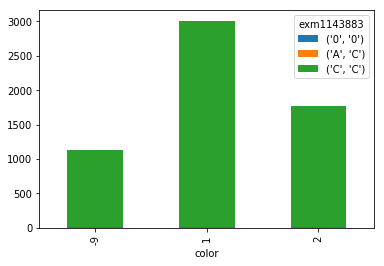

exm1143884


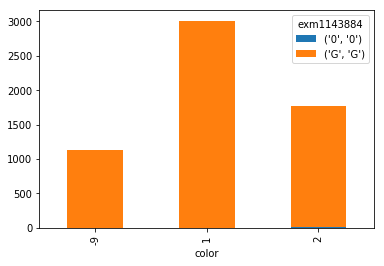

exm1143892


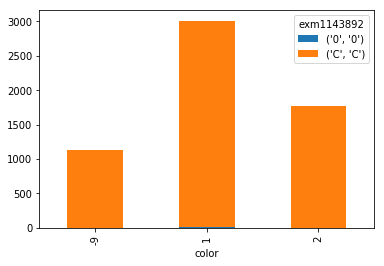

exm1143904


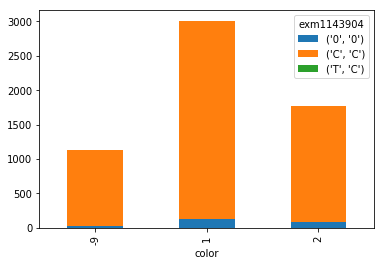

exm1143906


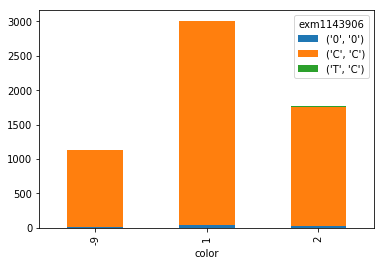

exm1143916


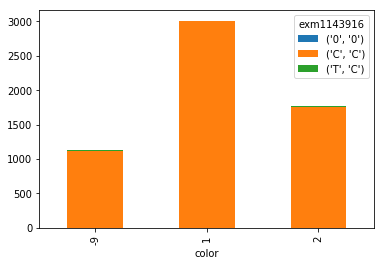

exm1143924


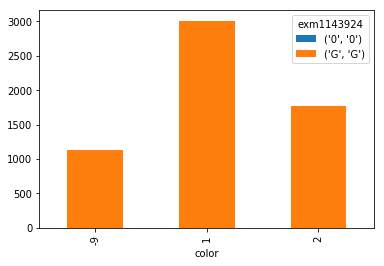

exm1143926


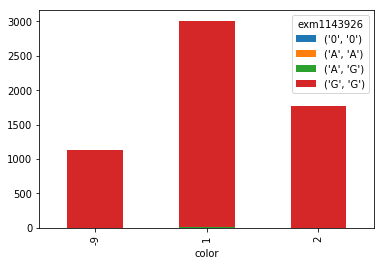

exm1143935


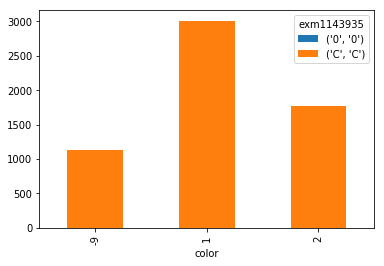

exm1143940


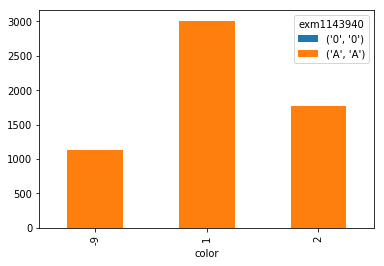

rs7173806


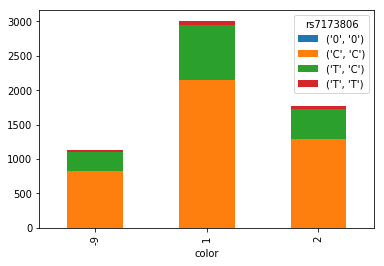

rs10851431


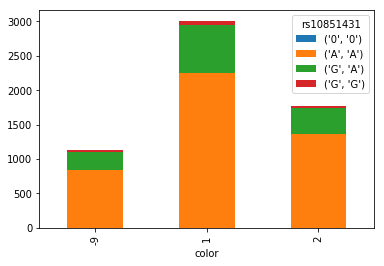

rs2171892


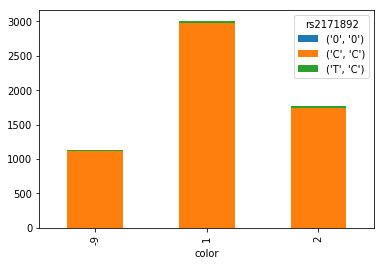

rs11070544


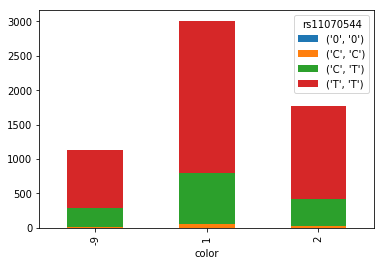

exm1143973


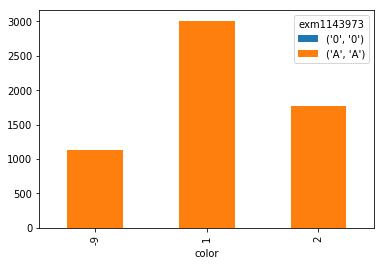

exm1144004


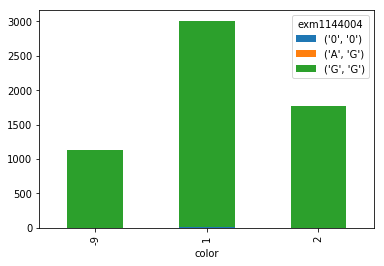

exm1144007


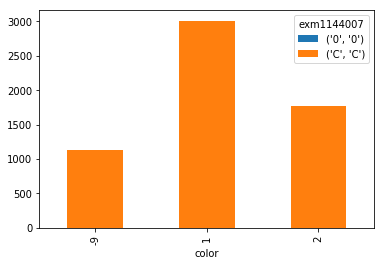

rs748501


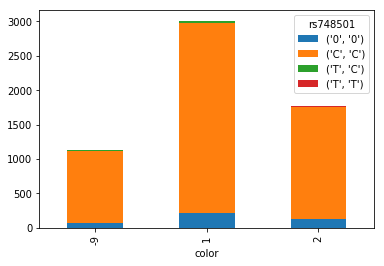

rs12050880


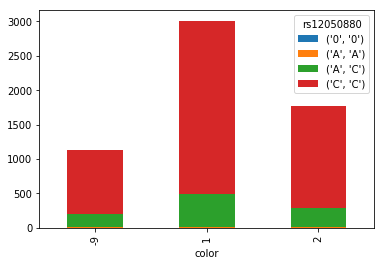

rs3829466


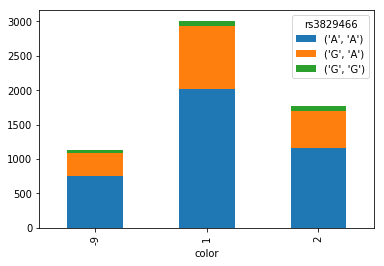

exm1144019


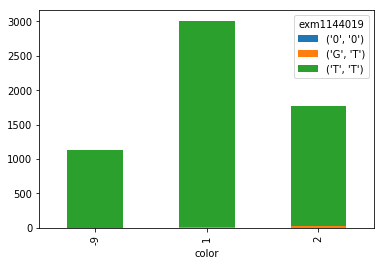

exm1144021


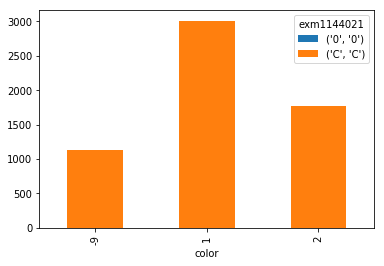

exm1144026


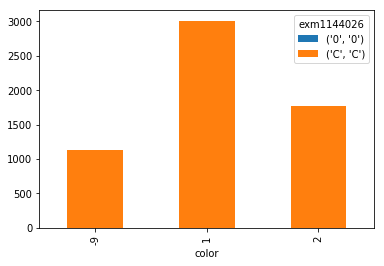

exm1144028


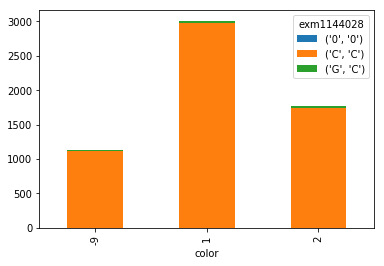

exm1144029


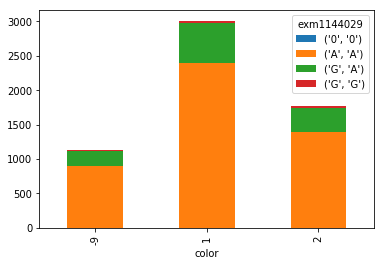

exm1144031


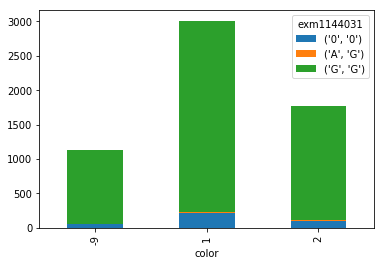

exm1144032


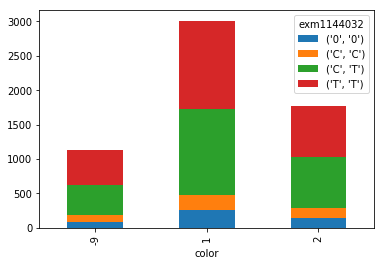

rs2672680


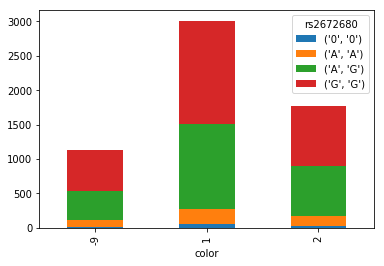

rs10851484


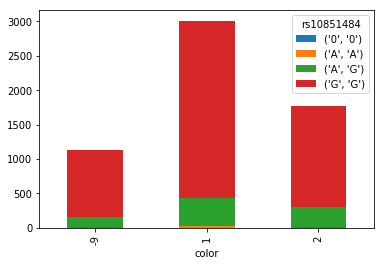

exm1144041


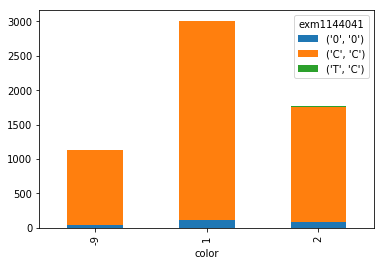

exm1144042


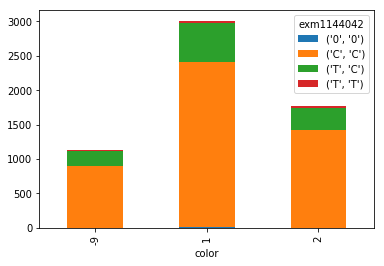

exm1144043


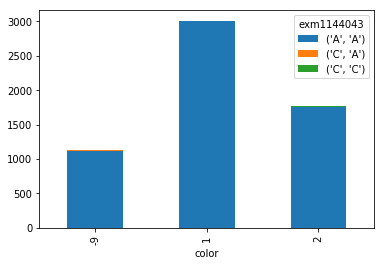

exm2252091


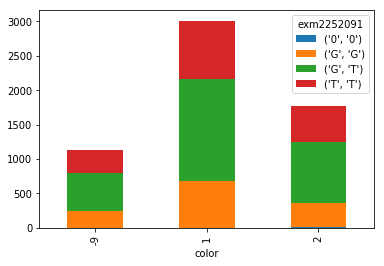

rs3764211


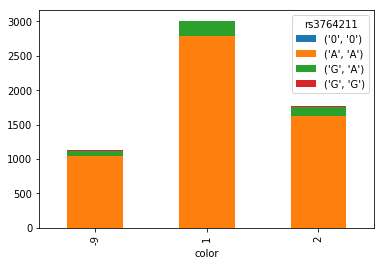

rs11858397


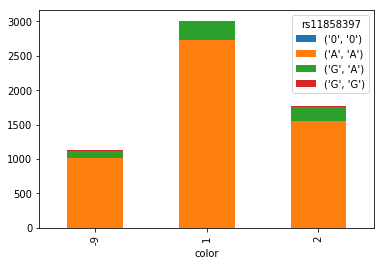

rs8026346


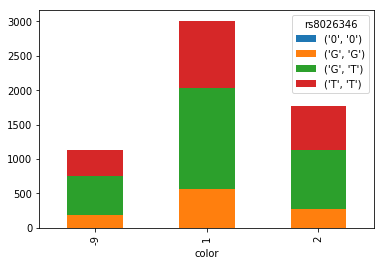

rs12911169


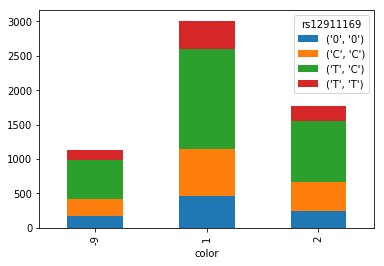

rs11071118


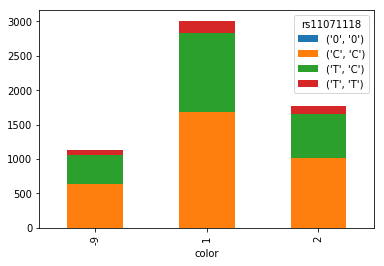

rs16955213


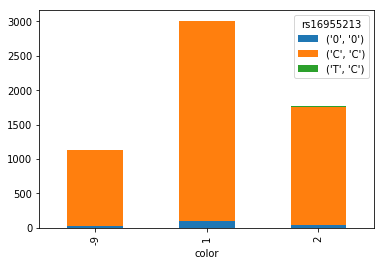

rs12443300


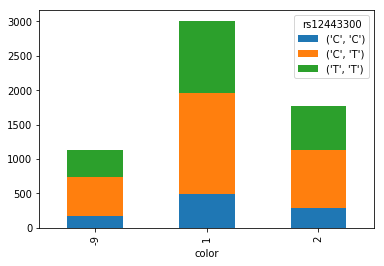

rs7176836


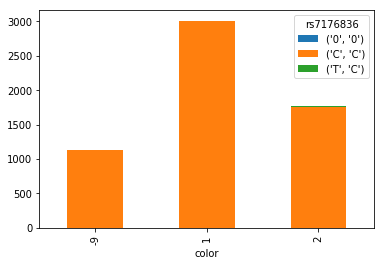

rs17681991


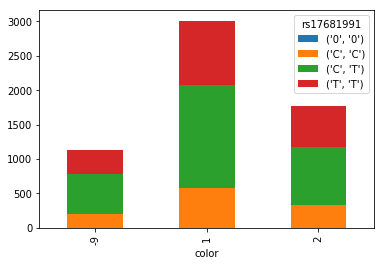

rs10519634


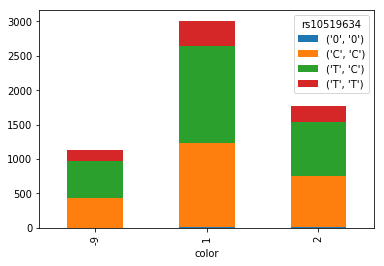

rs12912234


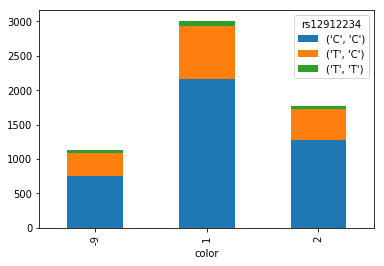

rs562921


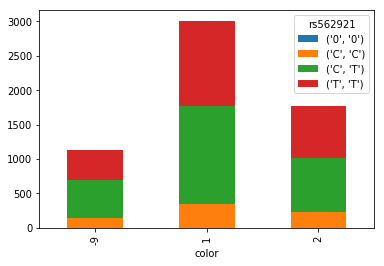

exm1144068


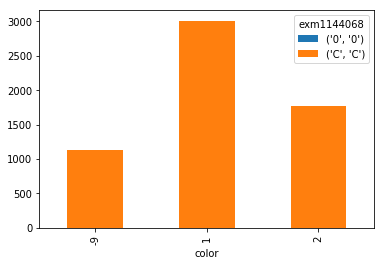

exm1144071


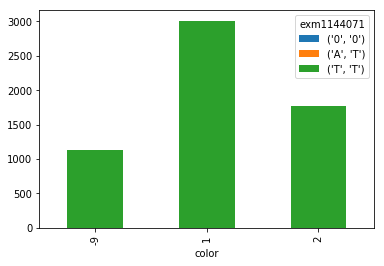

exm1144074


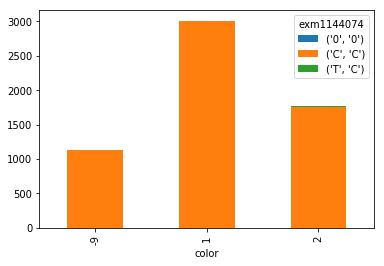

indel.34330


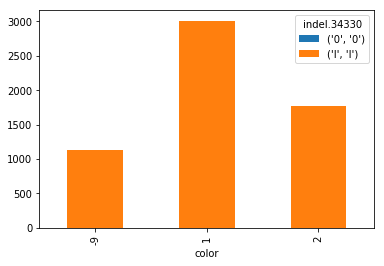

exm1144080


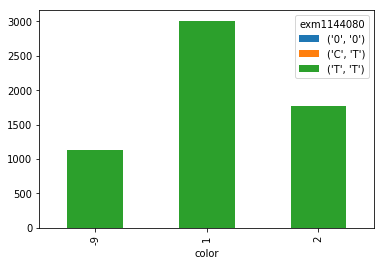

exm1144088


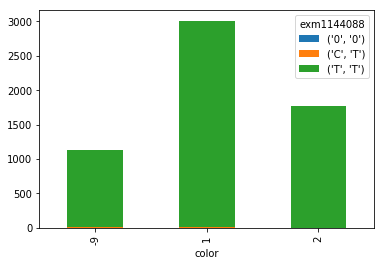

exm1144093


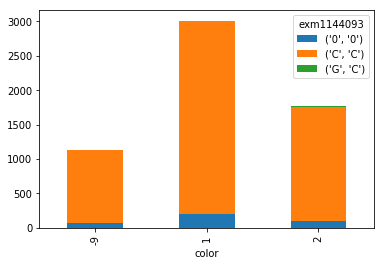

exm1144107


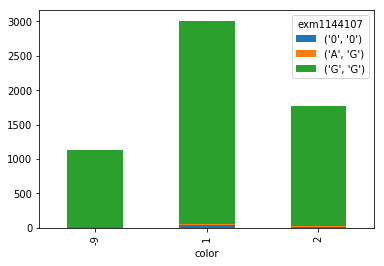

rs7178681


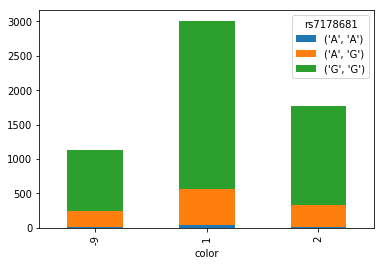

exm2272293


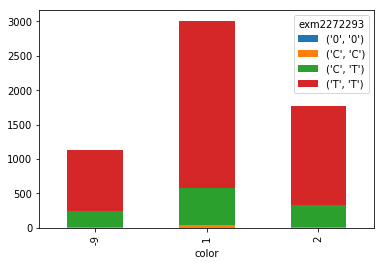

rs501397


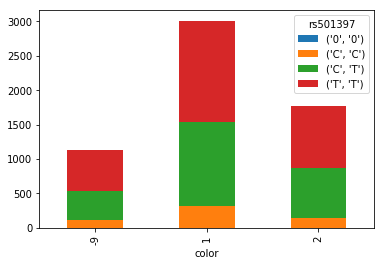

rs7165879


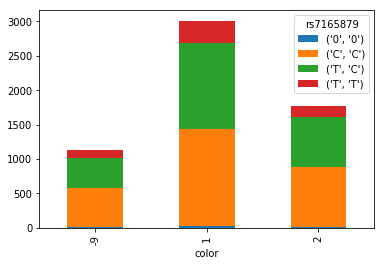

rs7163371


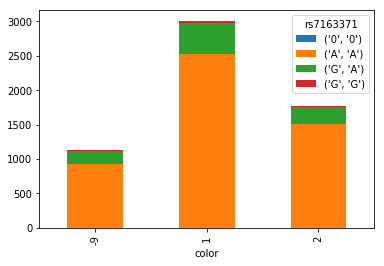

rs4780054


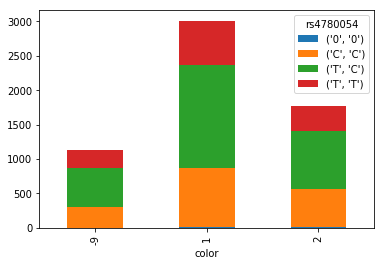

rs7163527


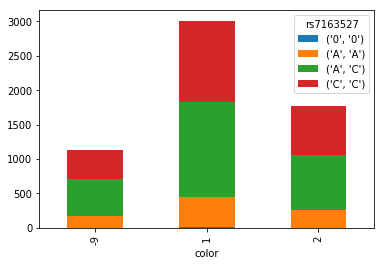

rs4522383


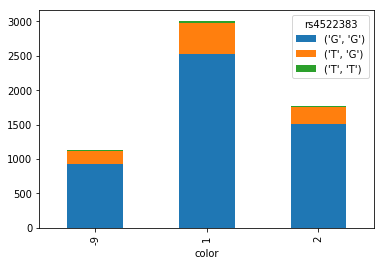

rs1584158


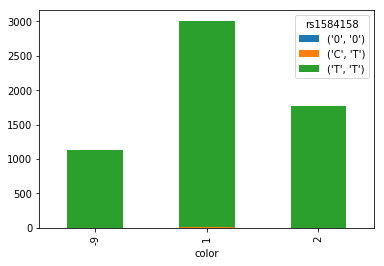

rs895250


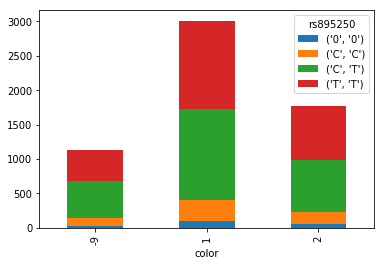

rs12441963


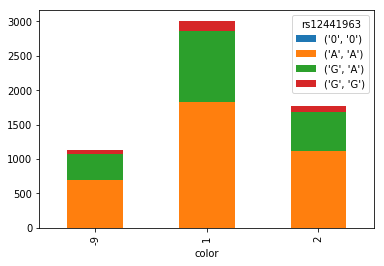

rs817961


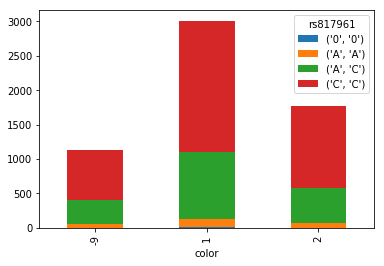

rs8043513


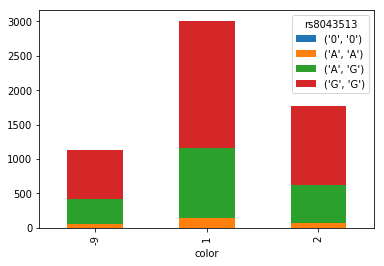

rs11854062


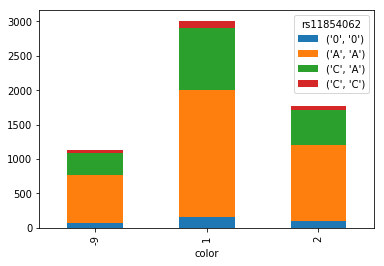

rs1520941


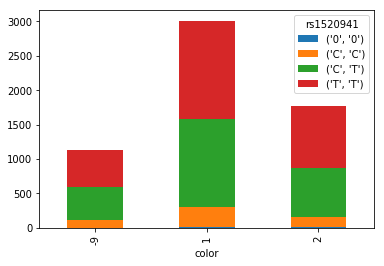

rs1520942


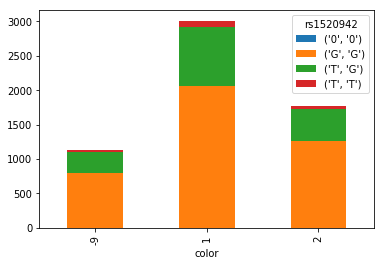

rs2337062


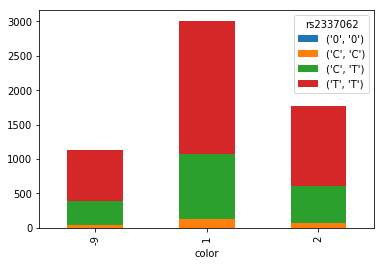

rs8036951


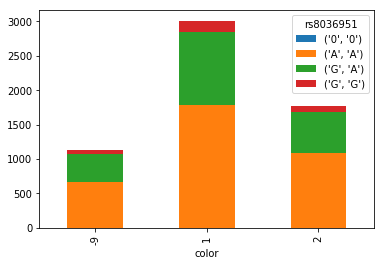

rs8041543


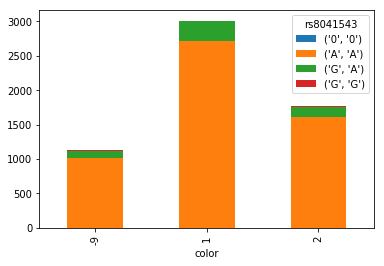

rs9920343


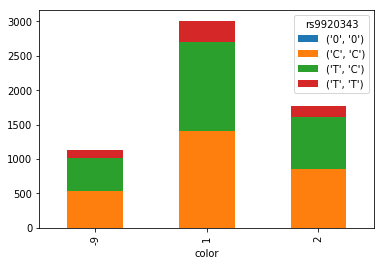

rs533554


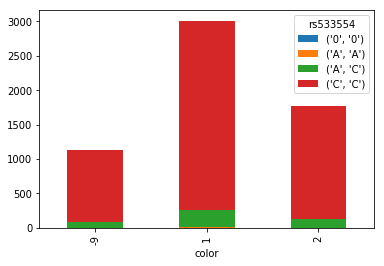

rs1195492


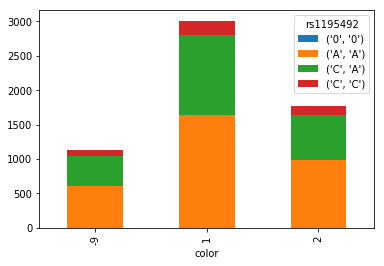

rs12439646


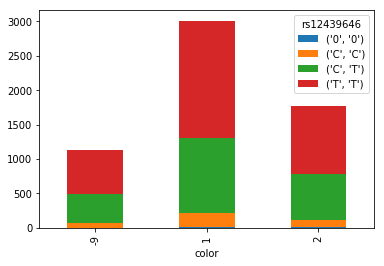

rs516628


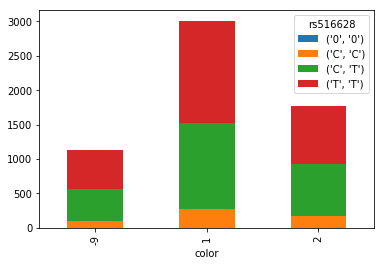

rs538077


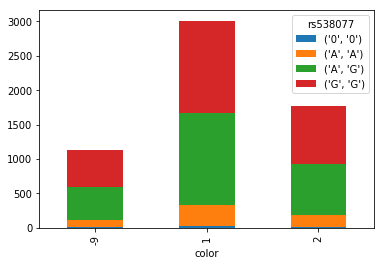

rs4780204


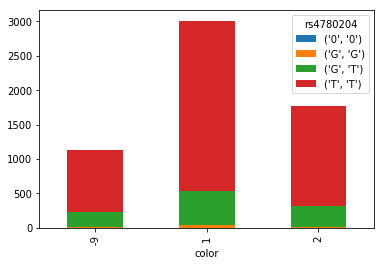

rs7171910


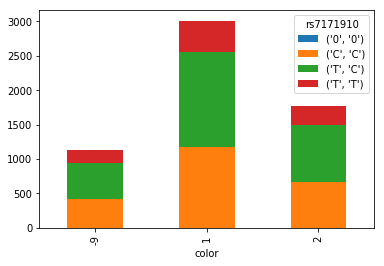

rs11634762


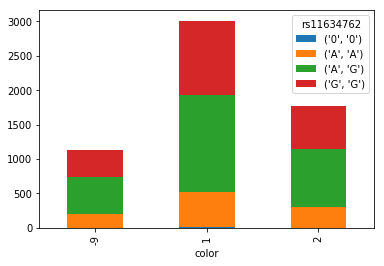

rs11856574


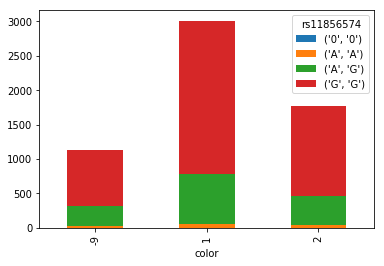

rs641603


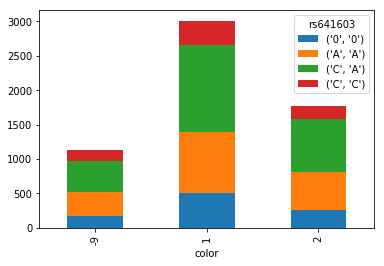

rs1655646


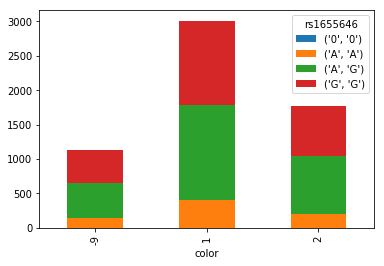

rs16955485


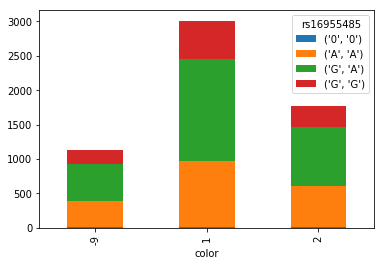

rs11073039


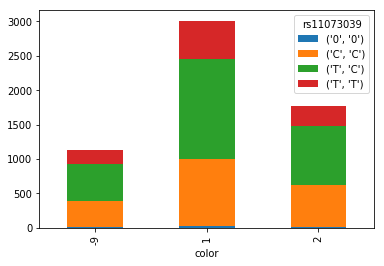

rs733612


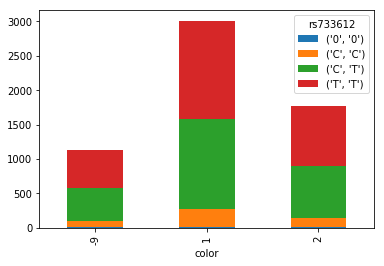

rs16955528


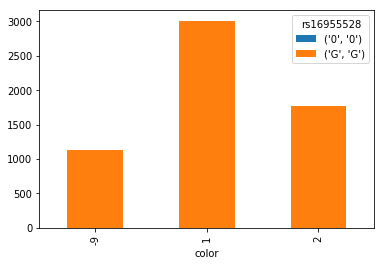

exm2272219


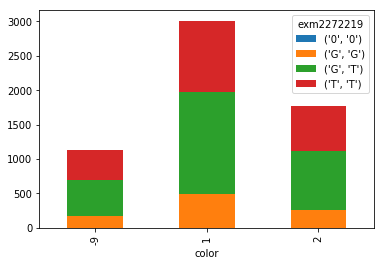

rs11854243


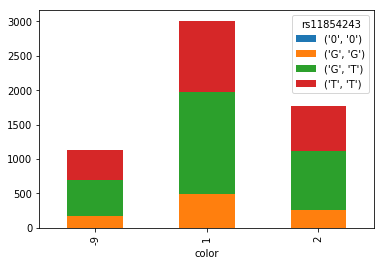

rs7168604


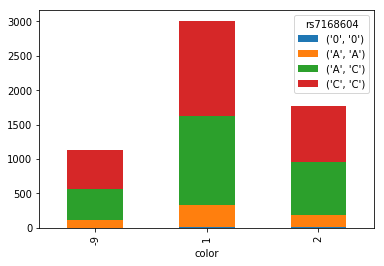

rs8032172


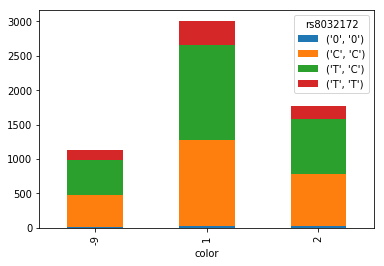

rs12917374


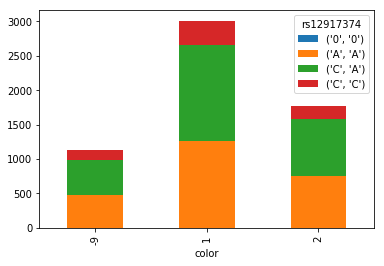

rs7170313


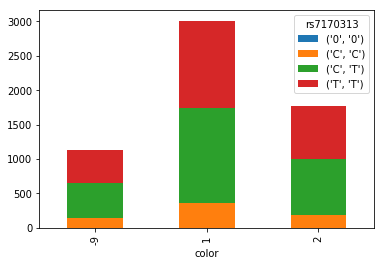

rs7359306


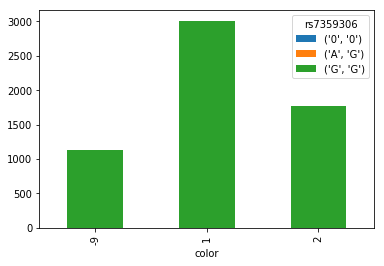

rs12913565


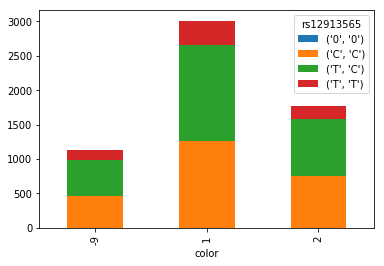

rs2337124


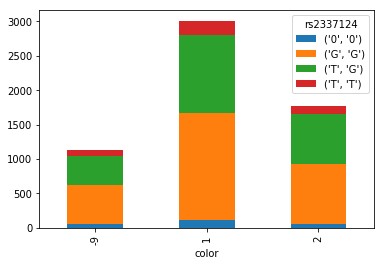

rs12438591


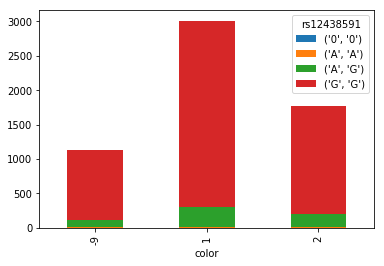

rs8031323


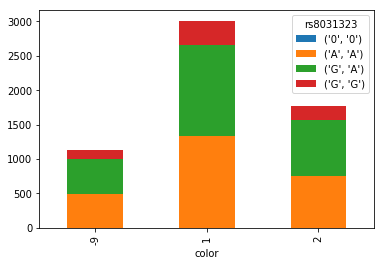

rs12324008


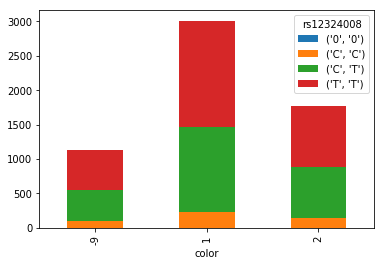

exm-rs1471225


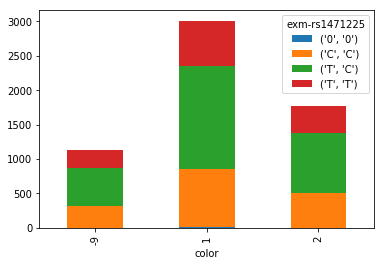

rs7163518


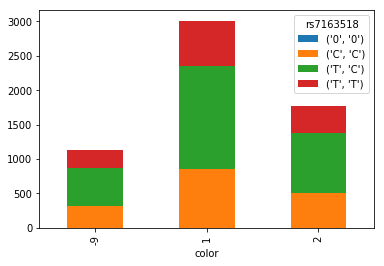

rs11630085


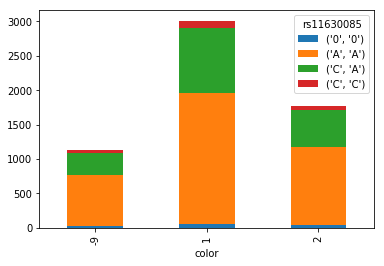

rs8030767


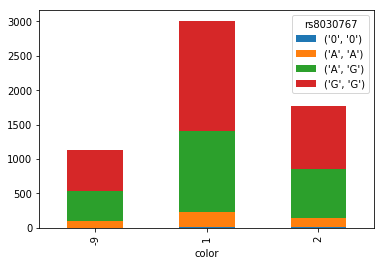

rs1459361


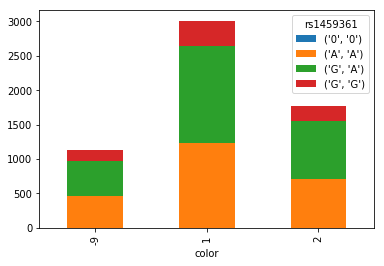

rs7177816


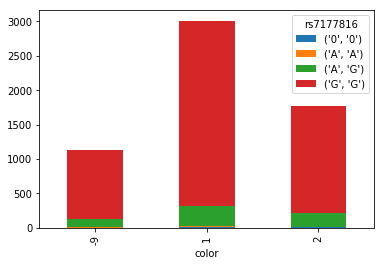

rs6495807


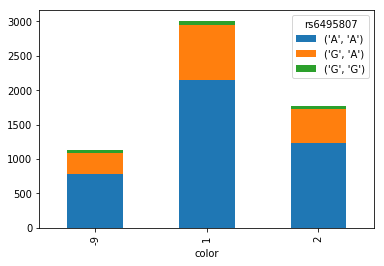

rs7169056


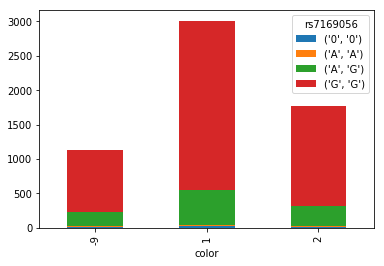

rs6495814


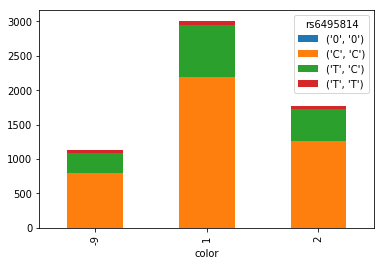

rs7168538


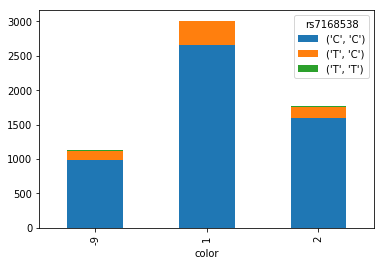

rs16955641


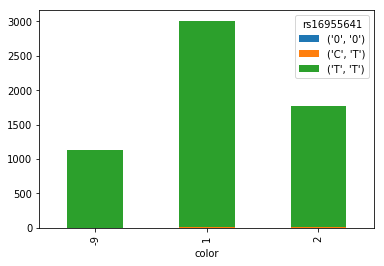

rs16955651


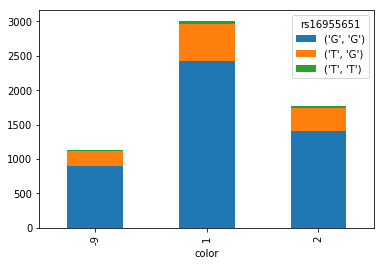

rs11855457


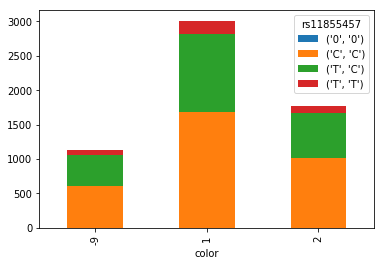

rs260529


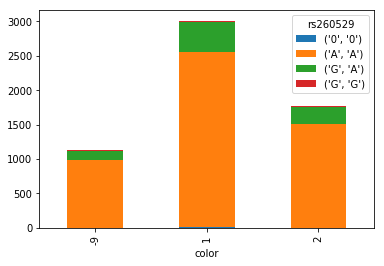

rs3784353


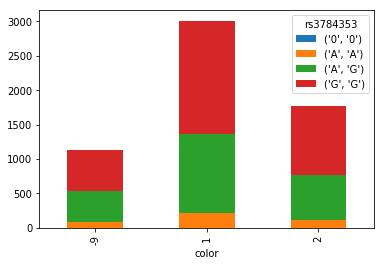

exm1144125


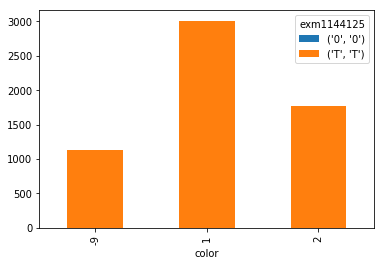

exm2223119


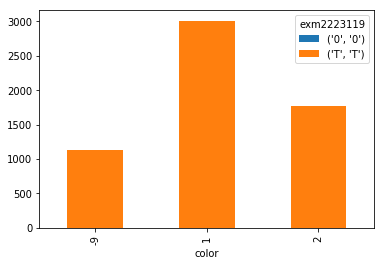

exm1144128


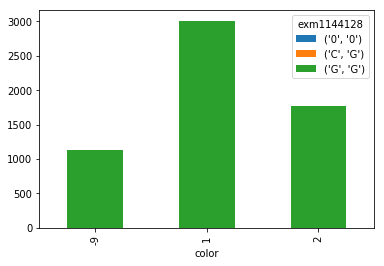

exm1144131


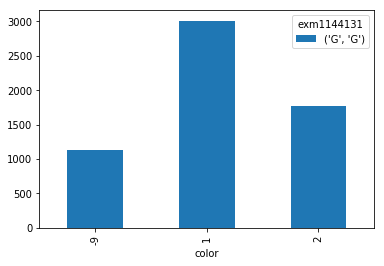

exm1144133


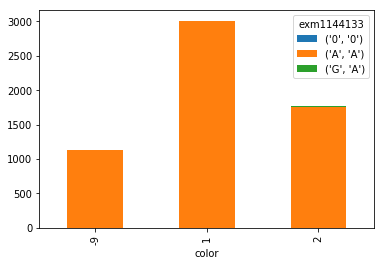

exm1144148


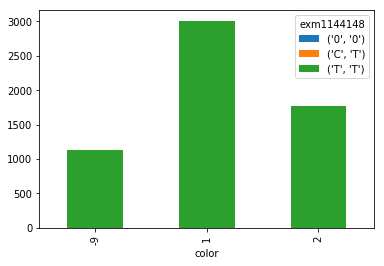

rs2229518


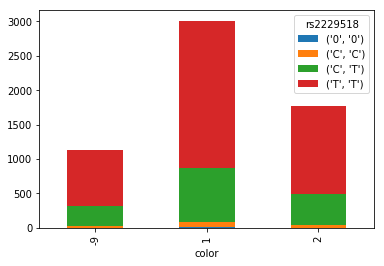

exm1144156


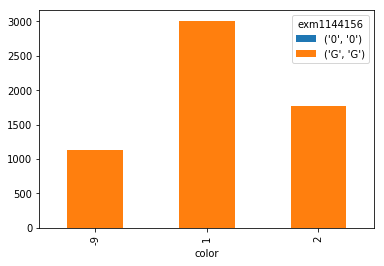

exm1144157


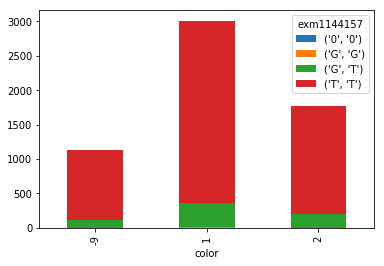

exm1144160


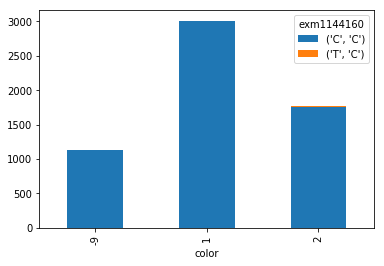

exm1144180


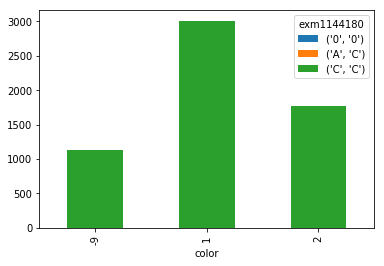

exm1144186


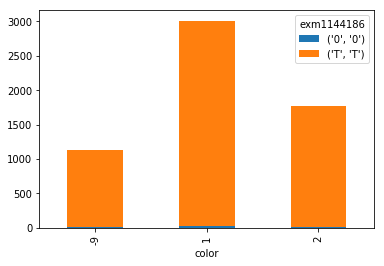

exm1144188


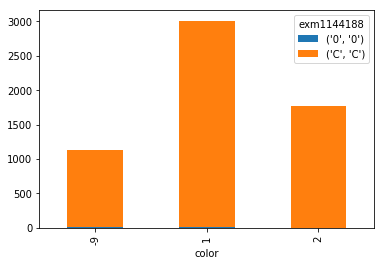

exm1144192


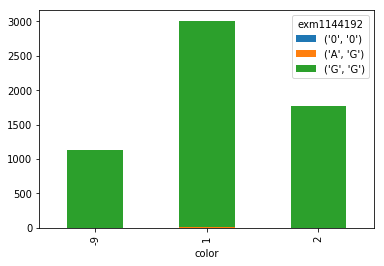

exm1144195


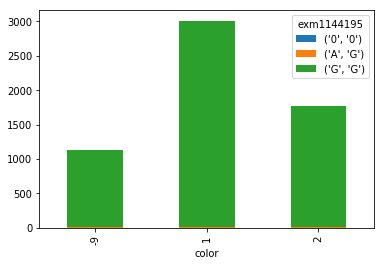

exm1144197


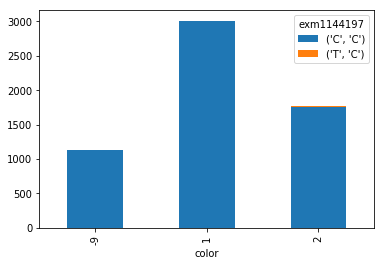

exm1144198


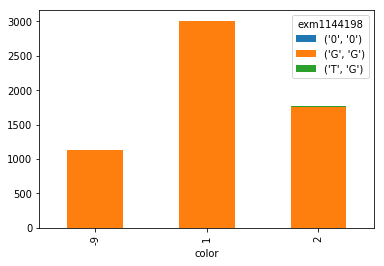

exm1826581


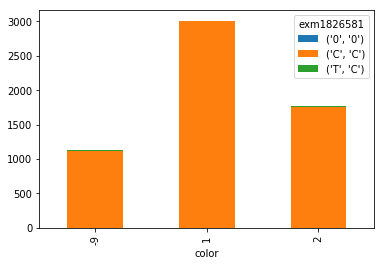

exm1144206


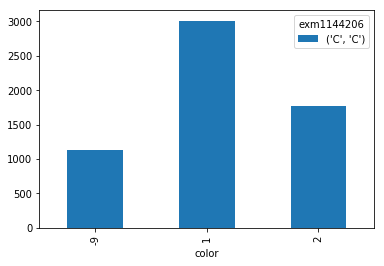

exm1144225


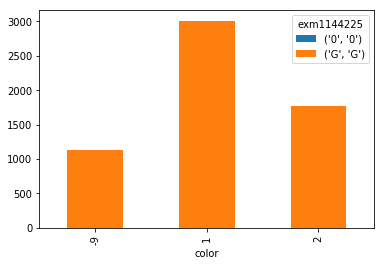

exm1144235


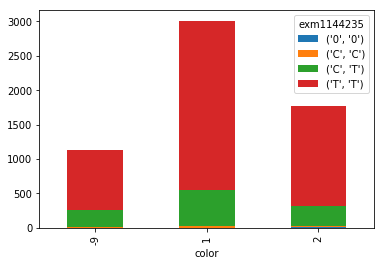

exm1144258


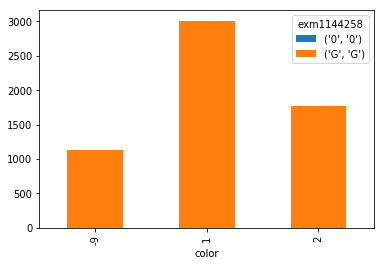

exm1144260


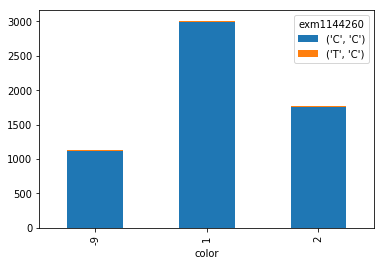

exm1144262


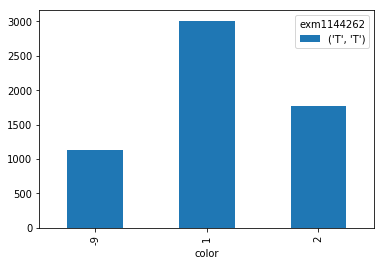

rs7176466


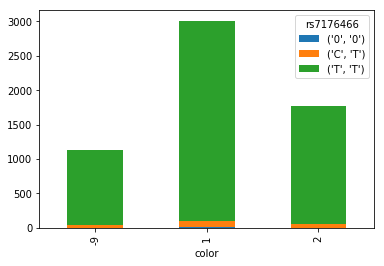

exm1144270


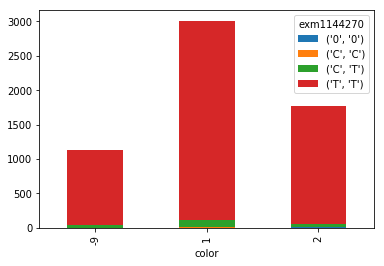

exm1826608


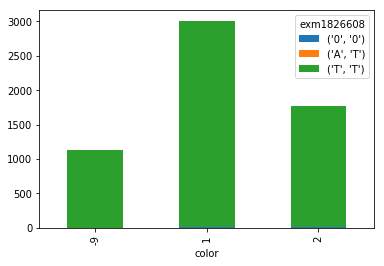

exm1144286


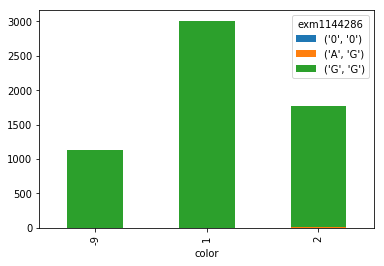

exm2223124


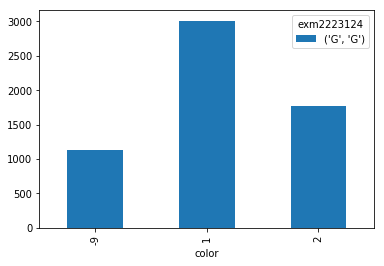

exm1144296


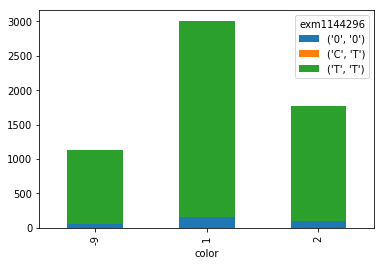

rs7170406


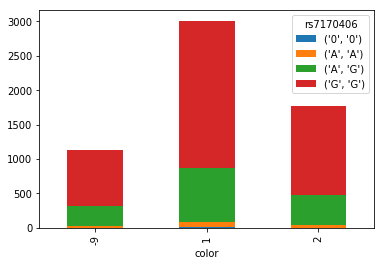

rs7176476


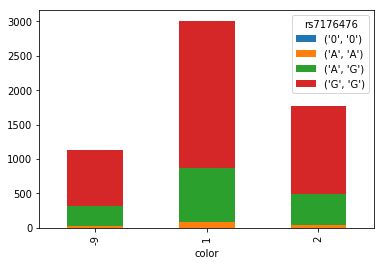

rs11853442


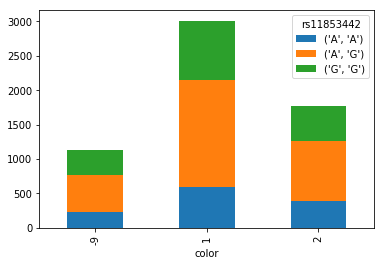

rs785440


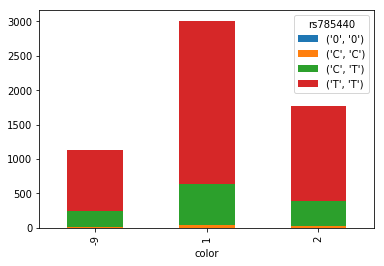

rs785441


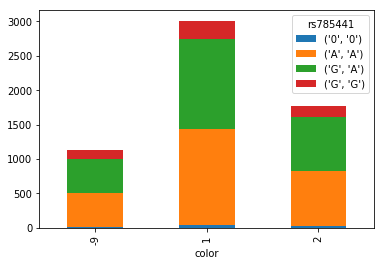

rs9302328


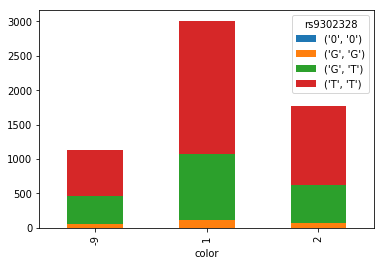

rs785421


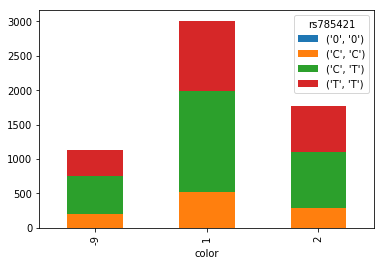

rs1719332


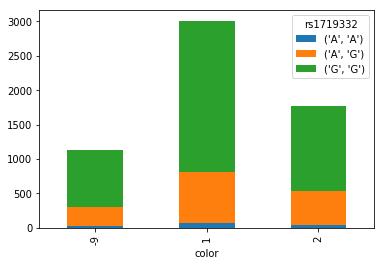

rs1719336


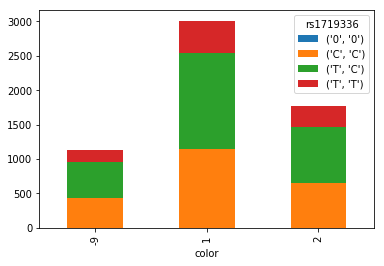

rs1719348


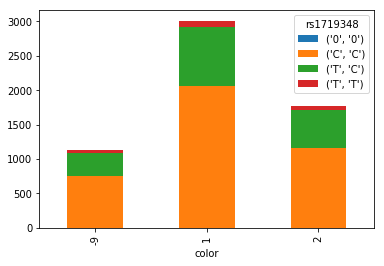

rs1357386


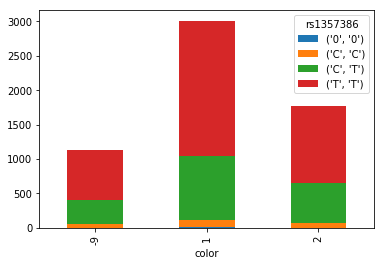

rs4779683


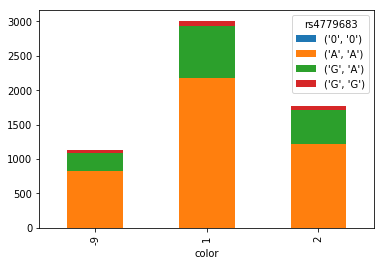

rs12899678


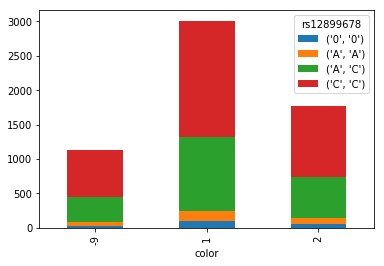

rs2049259


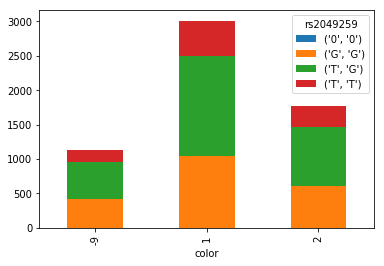

rs8033448


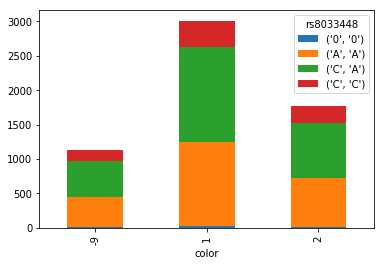

rs4779685


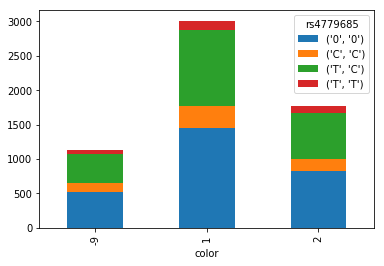

rs11634406


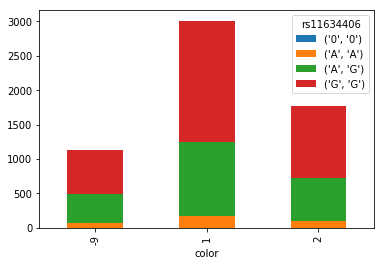

exm2272220


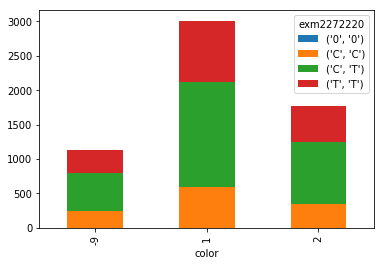

rs7173960


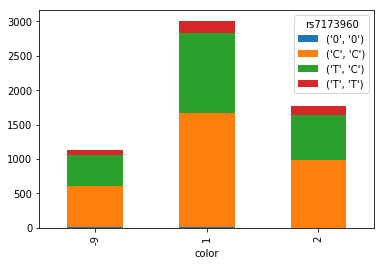

rs8036260


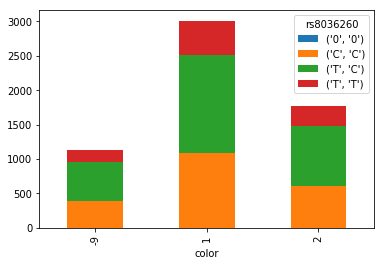

rs11631476


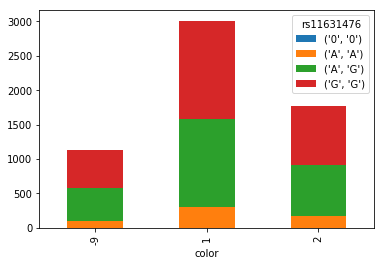

rs10152753


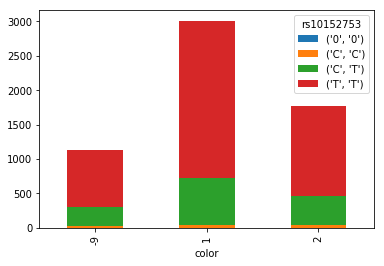

kgp11728692


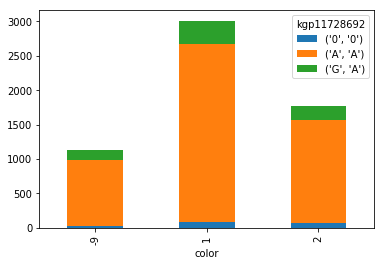

rs10467971


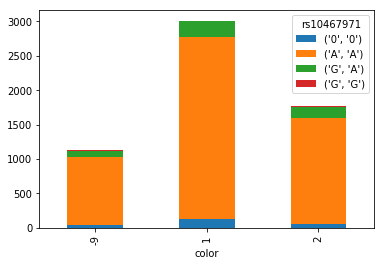

exm1144363


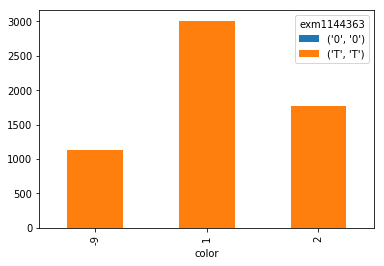

exm1144381


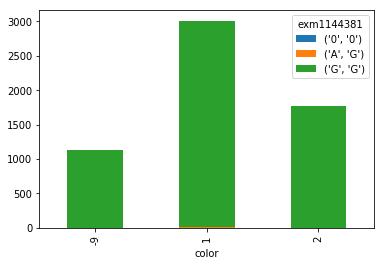

rs7166258


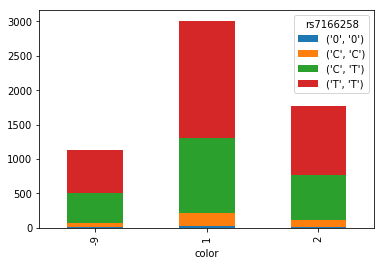

rs12910011


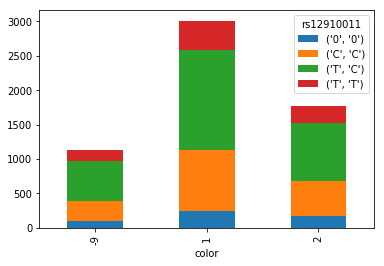

rs4779762


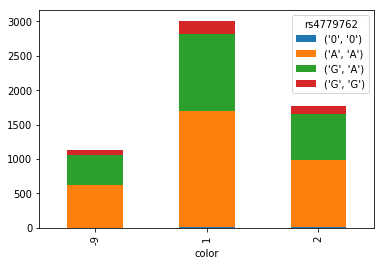

rs1809483


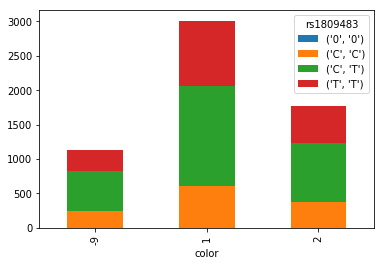

rs3964705


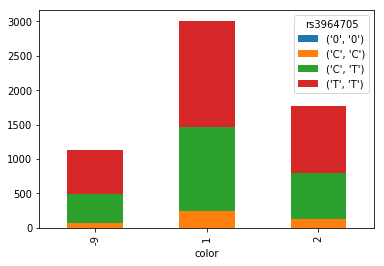

rs4779779


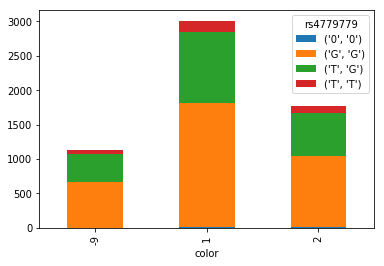

rs8026961


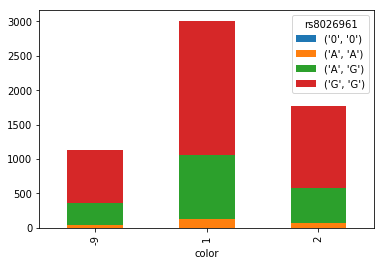

rs16956249


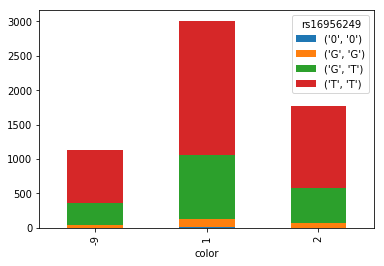

rs798138


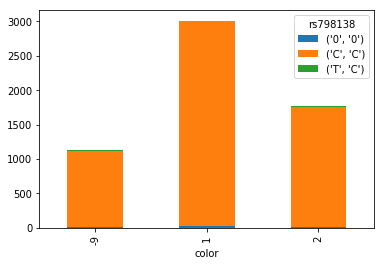

rs798139


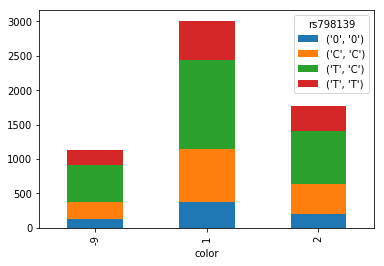

rs798081


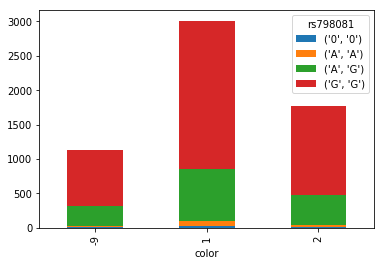

rs1088475


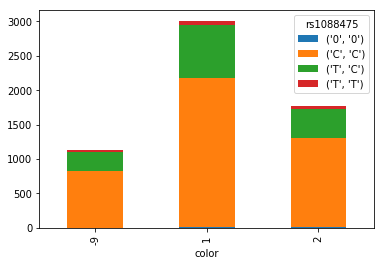

rs1524878


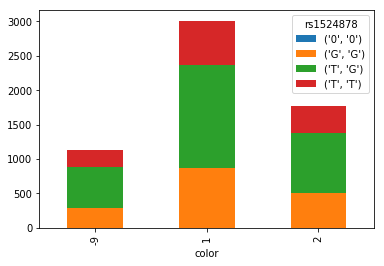

rs11632229


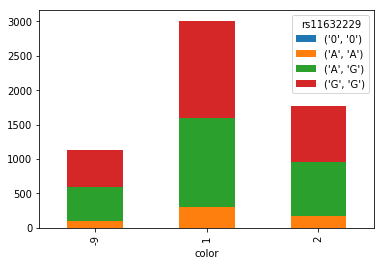

exm1144388


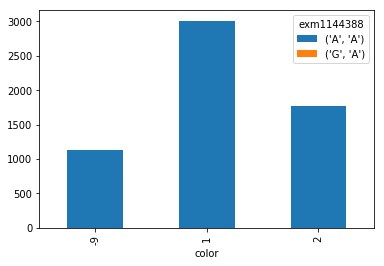

exm1144389


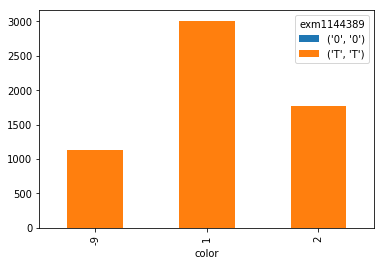

variant.34339


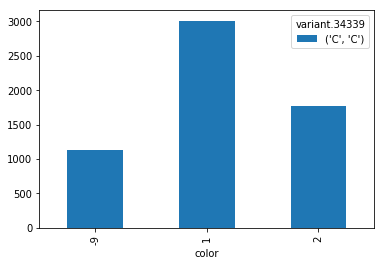

exm1144390


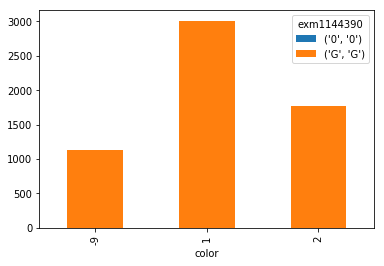

exm1144397


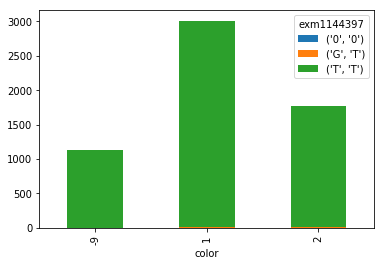

exm2223128


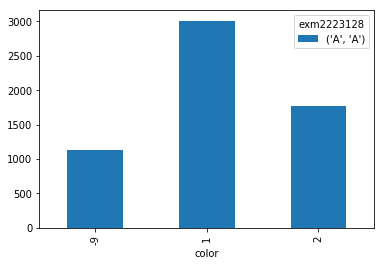

exm1144408


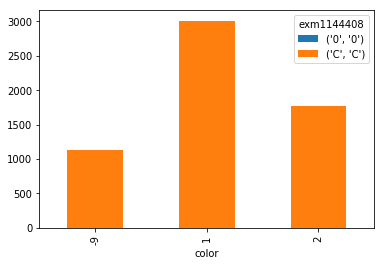

exm1144409


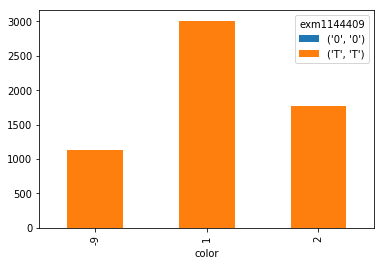

exm1144410


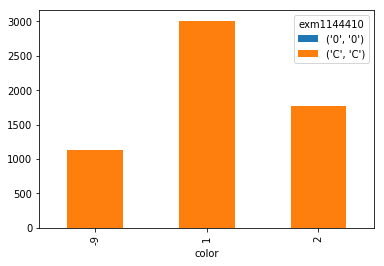

indel.34342


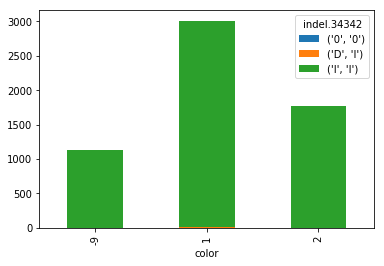

exm1826680


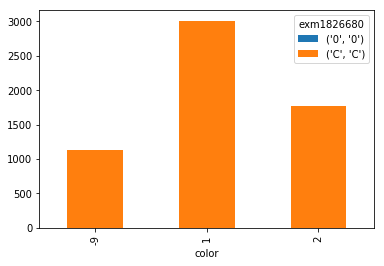

exm1144430


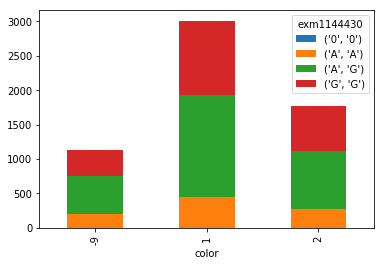

rs4779794


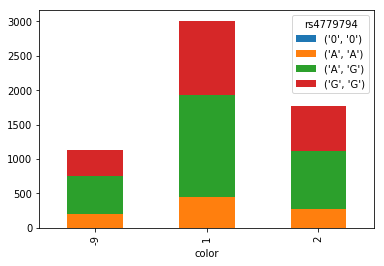

exm1144431


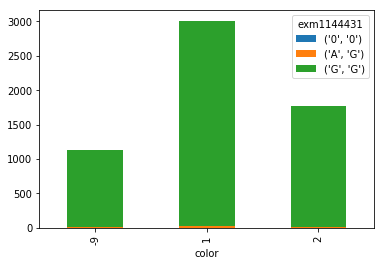

indel.34346


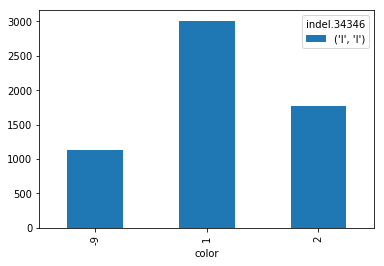

exm1144436


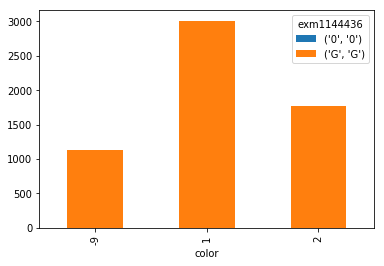

exm1144438


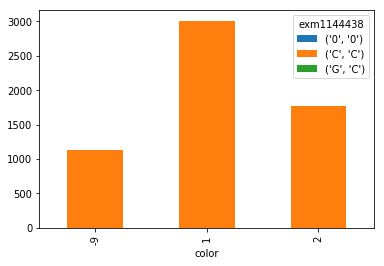

exm1826686


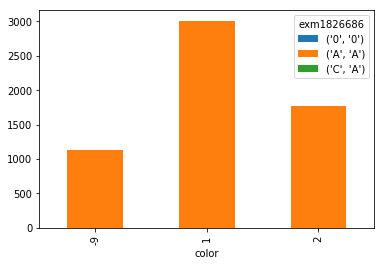

exm1144445


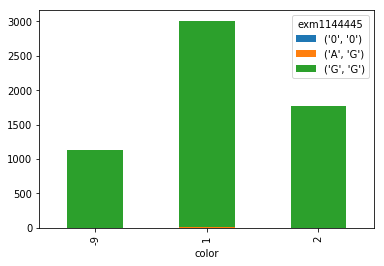

exm1144448


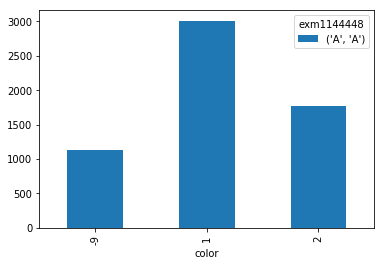

exm1144449


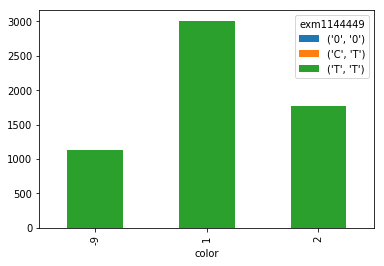

exm1144450


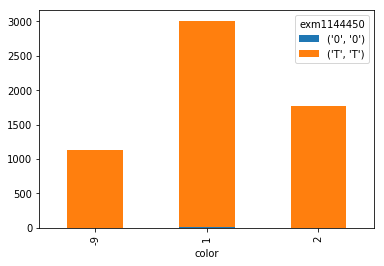

exm1144455


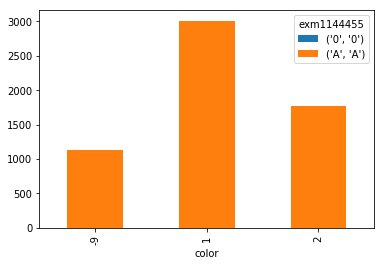

exm1144458


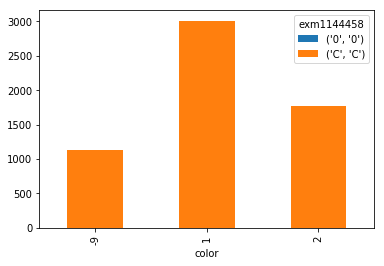

variant.34350


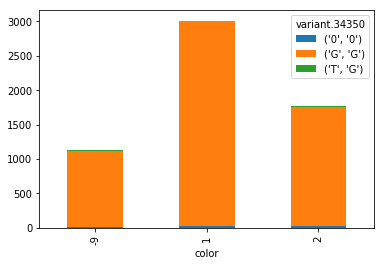

variant.34352


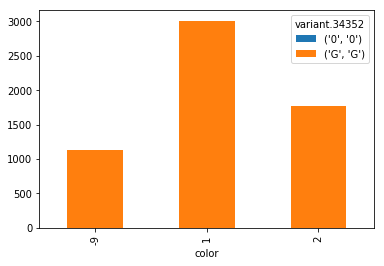

exm1144465


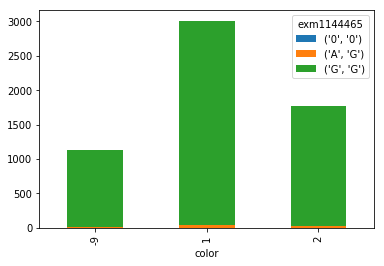

rs1056118


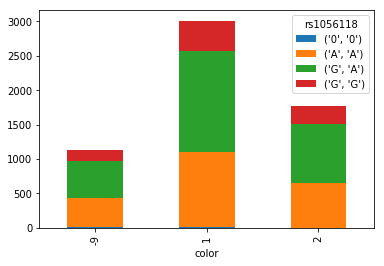

rs7176351


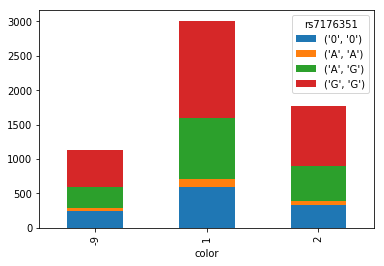

rs7169064


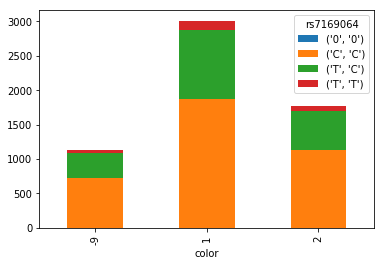

exm1144485


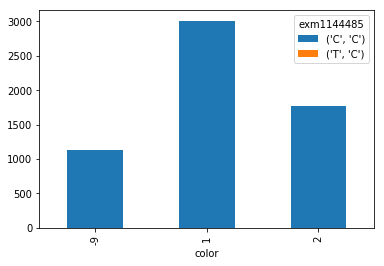

exm1144487


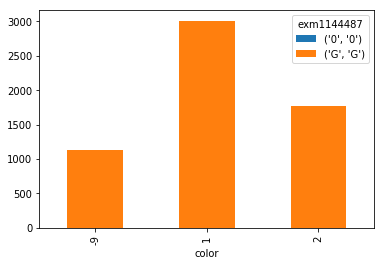

indel.34355


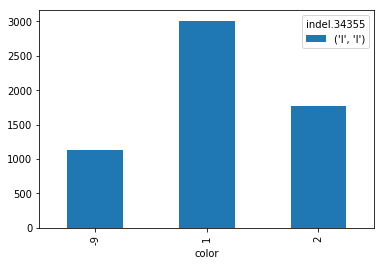

exm1144494


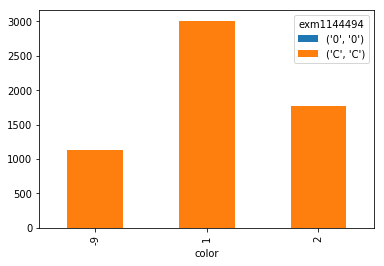

exm1144498


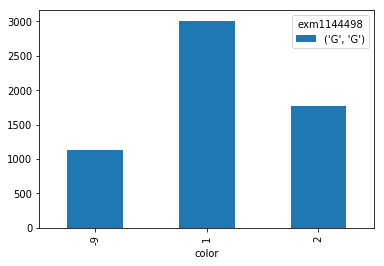

exm1144504


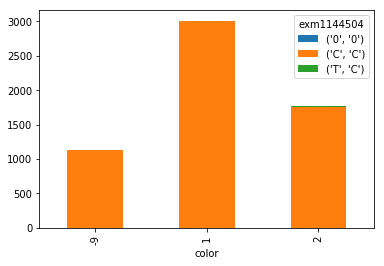

variant.34360


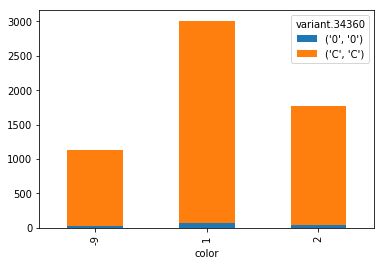

variant.34361


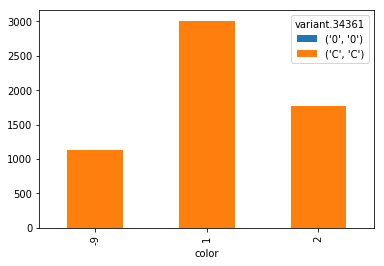

var_15_31217494


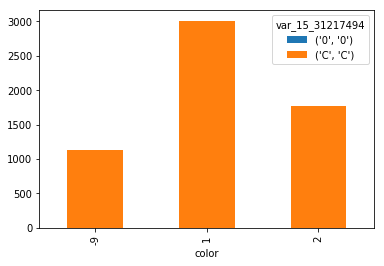

exm1144511


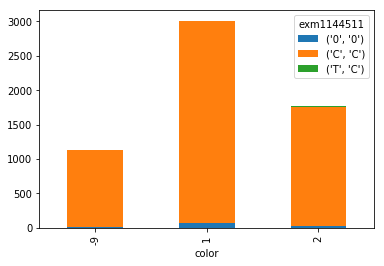

exm1144513


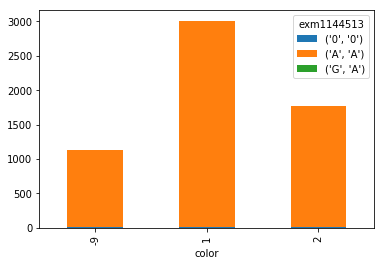

exm1144517


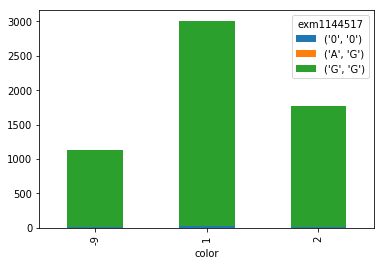

indel.34365


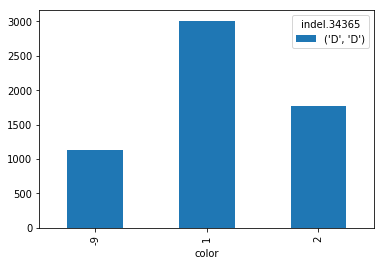

exm1144533


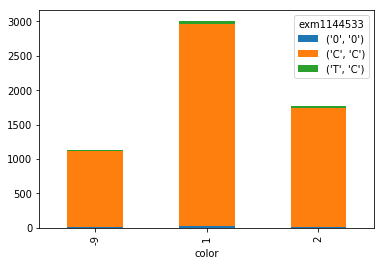

exm1144536


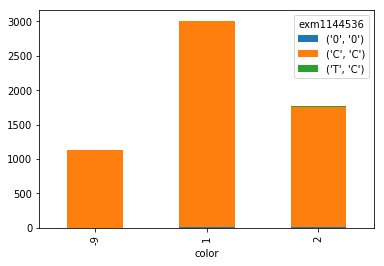

indel.34366


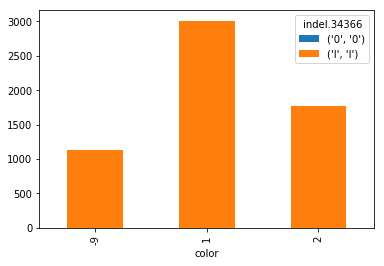

exm1144545


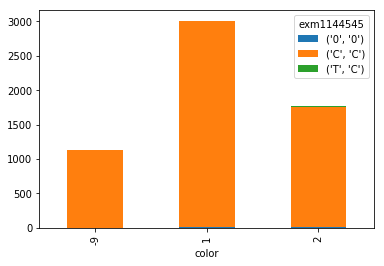

exm1144554


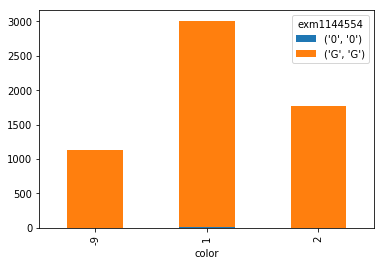

rs565


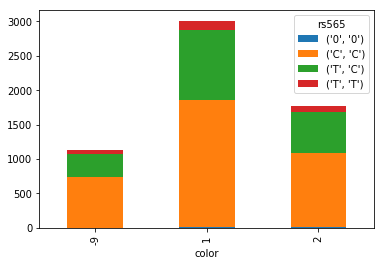

rs2873


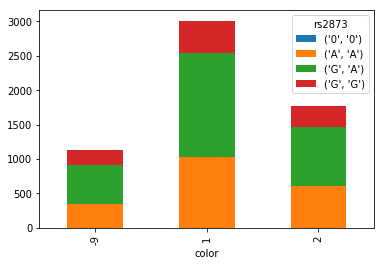

exm1144557


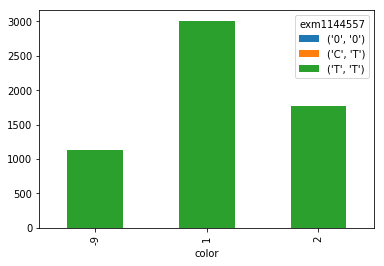

newrs146208994


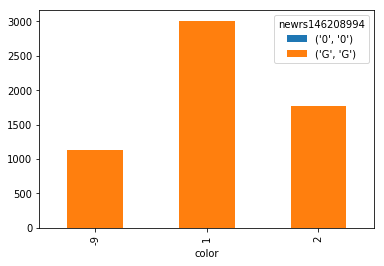

exm1144568


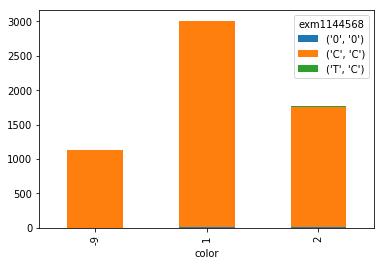

exm1826739


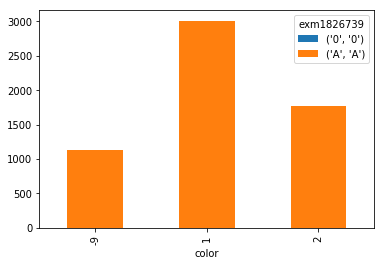

exm1144577


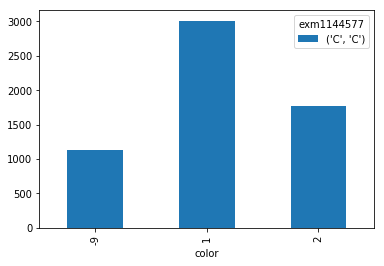

exm1144579


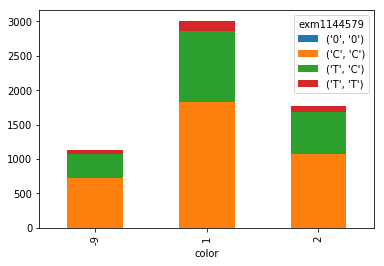

exm1144580


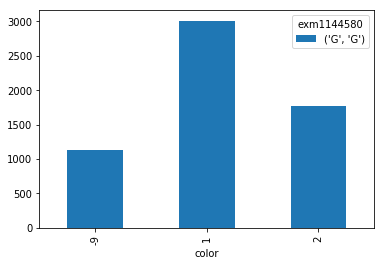

exm1144589


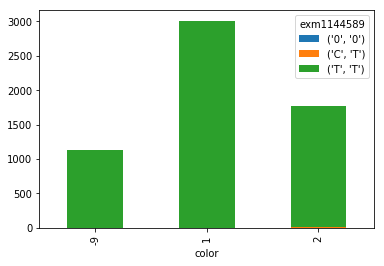

exm2252096


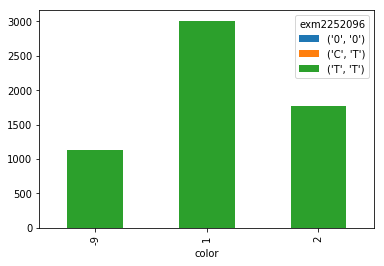

rs11293


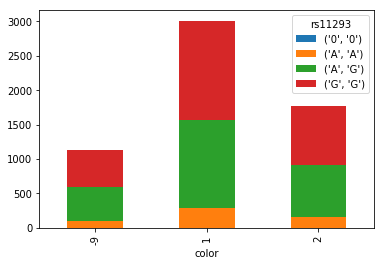

exm1144592


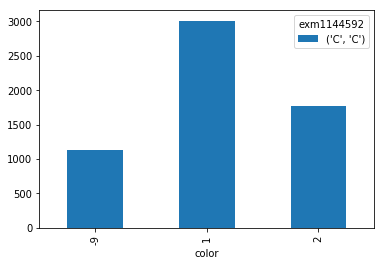

exm1144595


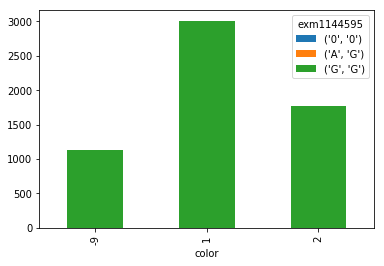

rs2949569


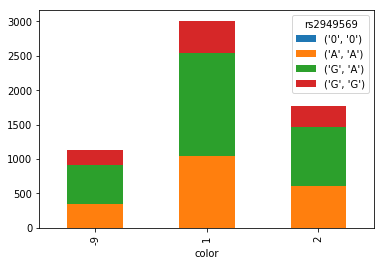

exm1144611


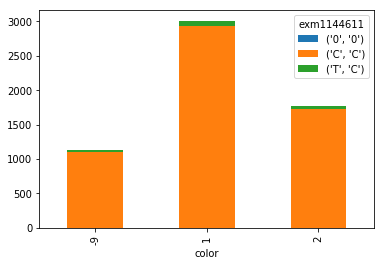

exm1144619


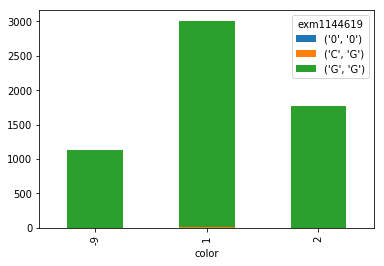

exm1144622


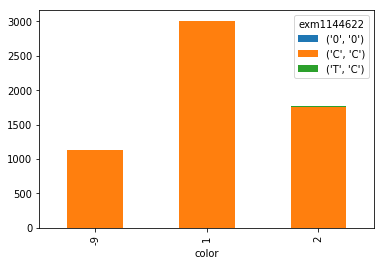

exm1144628


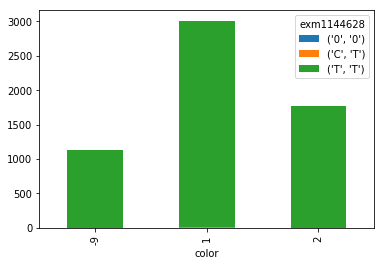

rs2949576


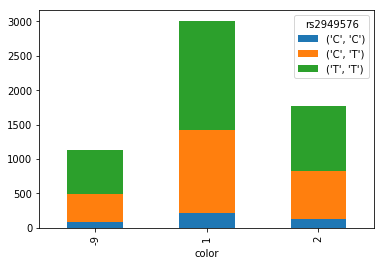

exm1144630


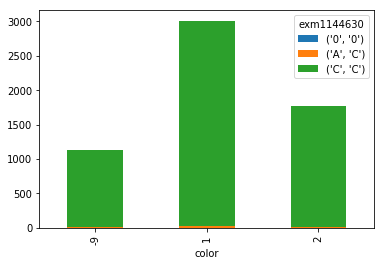

variant.34374


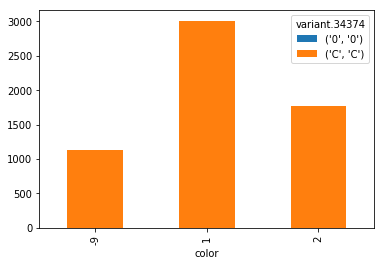

rs1133642


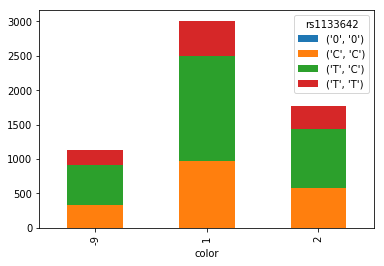

exm1144642


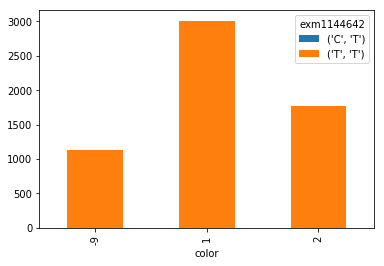

1KG_15_31283029


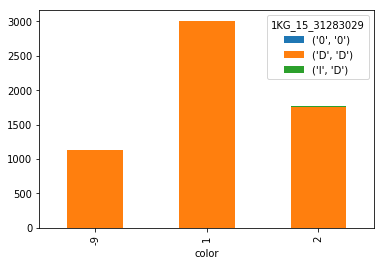

exm1144647


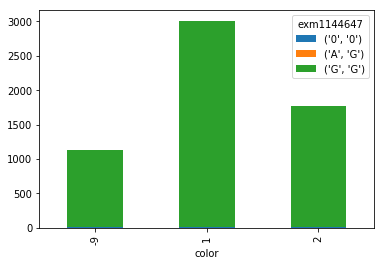

exm1144659


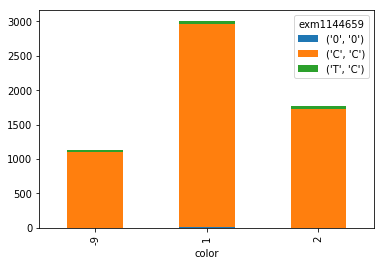

indel.34375


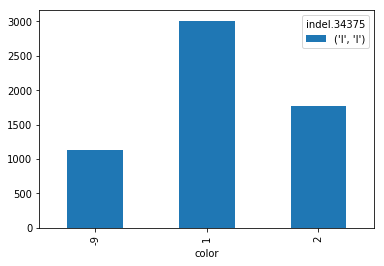

exm1144662


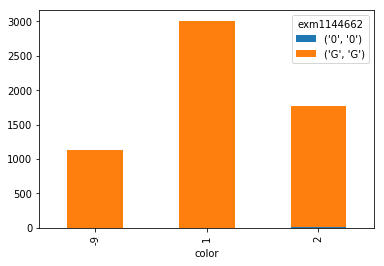

exm1144665


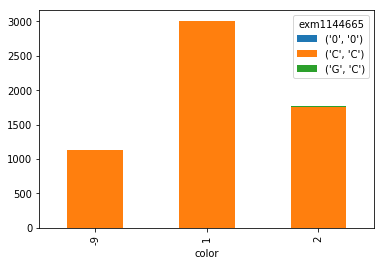

exm1144668


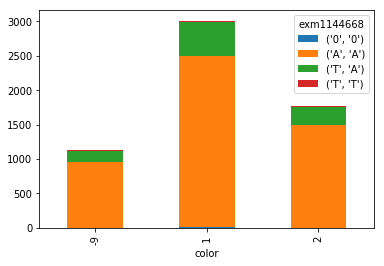

exm1144669


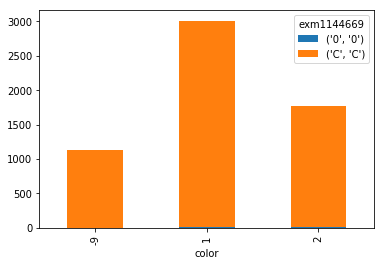

exm1144670


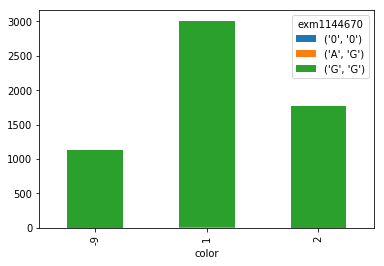

exm1144672


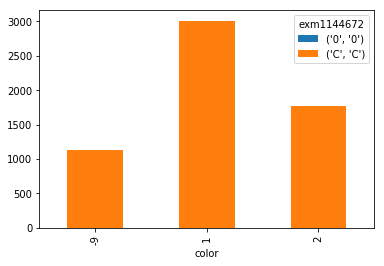

exm1144680


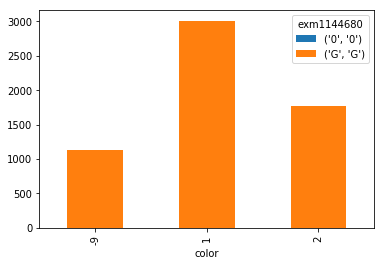

exm1144682


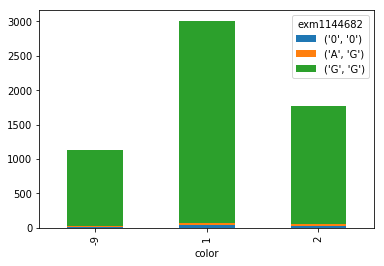

variant.34378


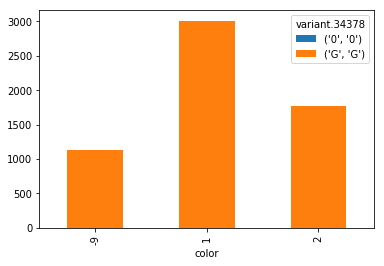

exm1144687


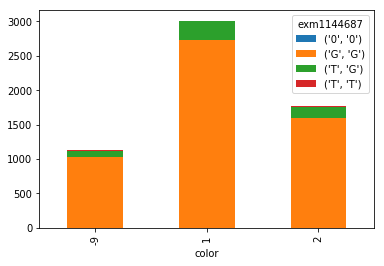

exm1144689


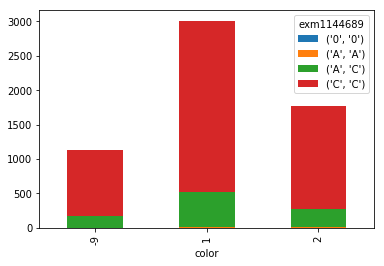

exm1144690


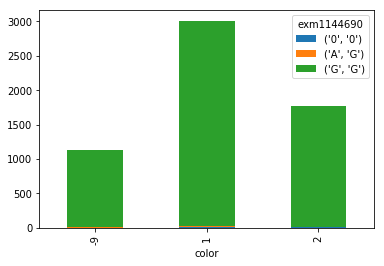

exm1144692


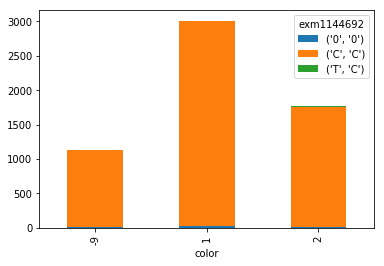

exm1144693


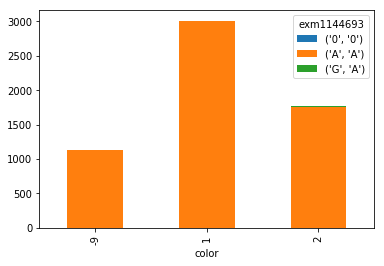

exm1144695


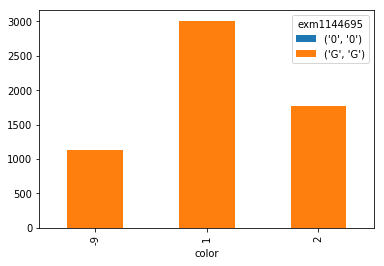

exm1144696


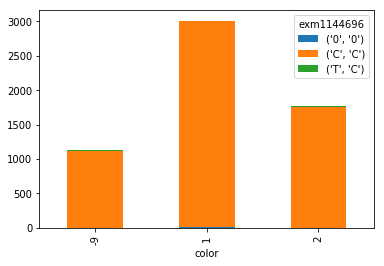

exm2274734


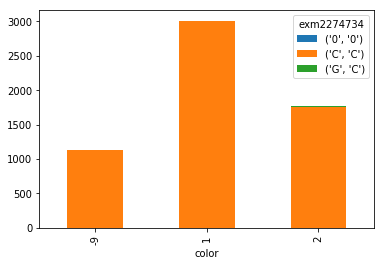

exm1826789


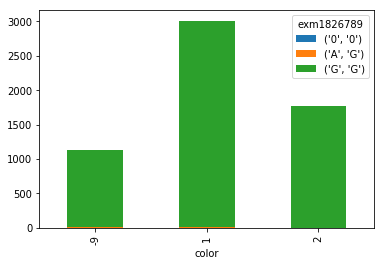

exm1826790


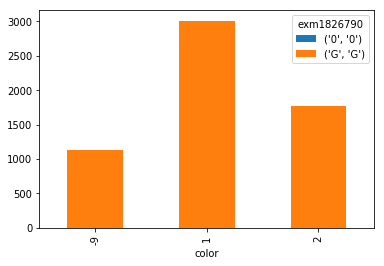

variant.34381


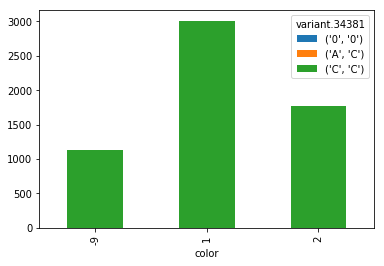

exm1144707


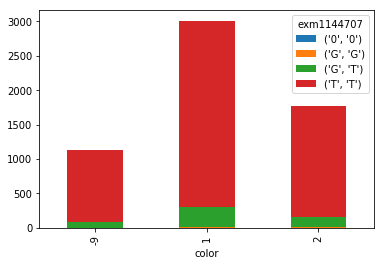

rs7182547


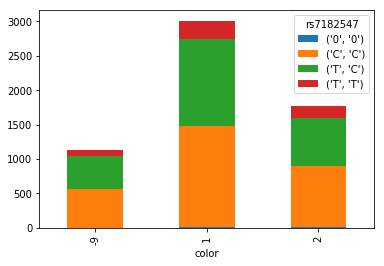

rs2113946


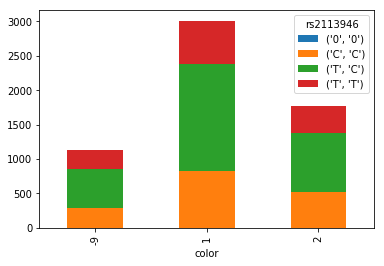

rs7161812


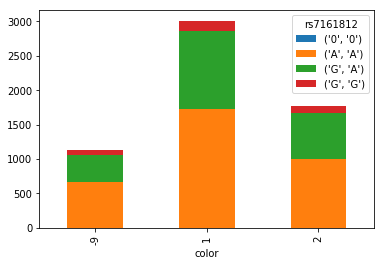

exm1144717


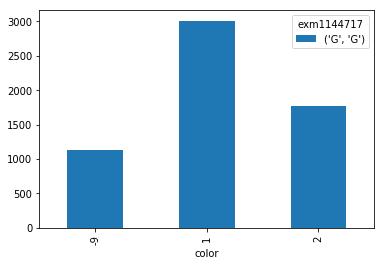

exm1144718


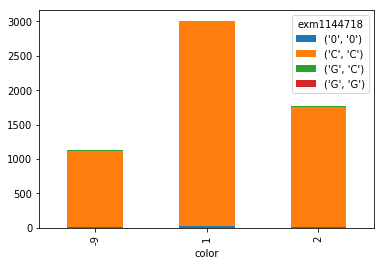

exm1144722


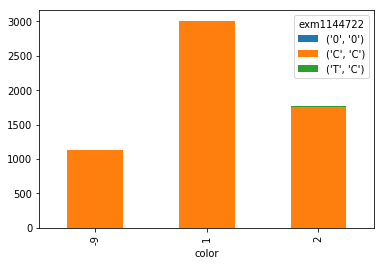

exm1144736


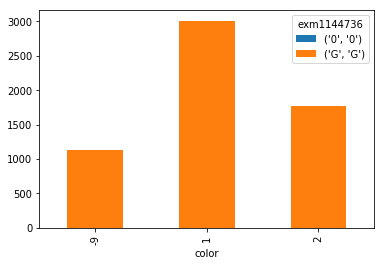

variant.34387


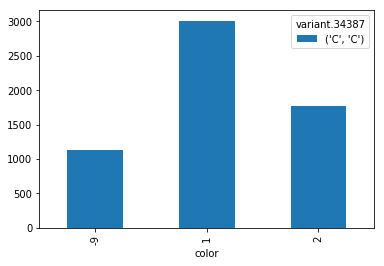

variant.34389


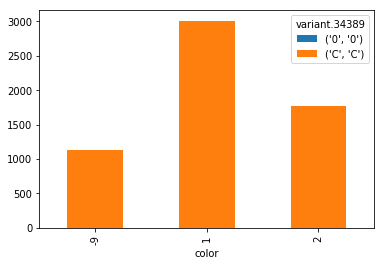

exm1144739


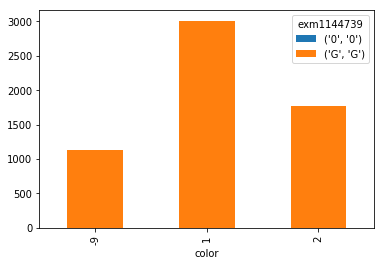

variant.34390


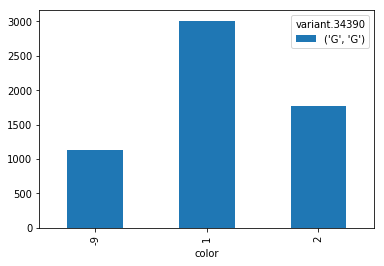

variant.34392


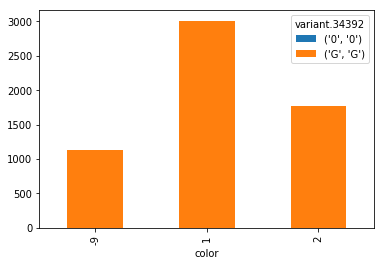

exm1144749


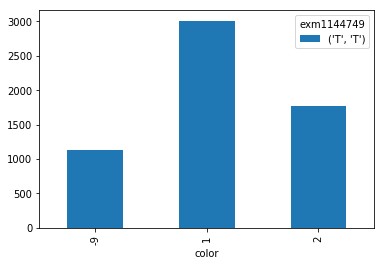

exm2274736


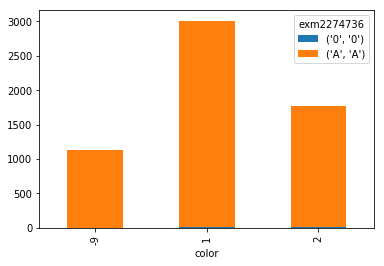

exm2274737


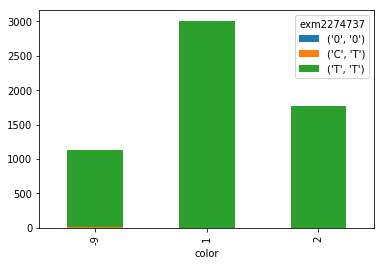

exm1144765


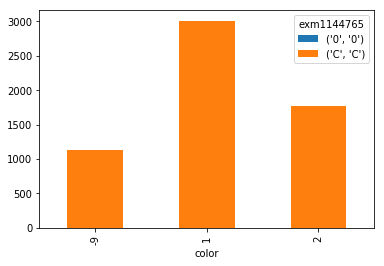

variant.34393


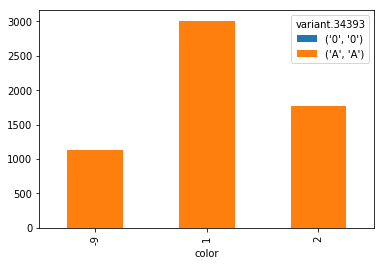

rs12913672


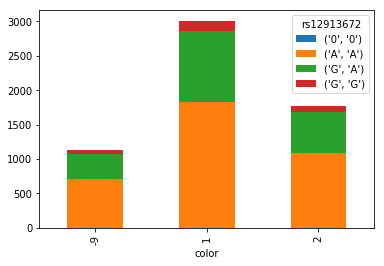

exm1144780


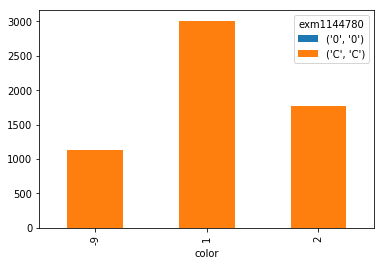

exm1144786


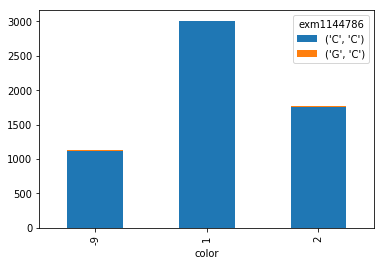

exm2223135


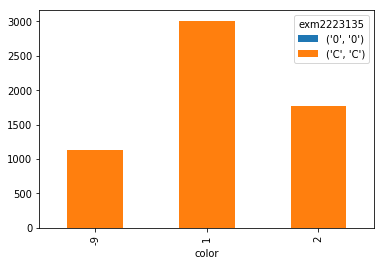

exm1144797


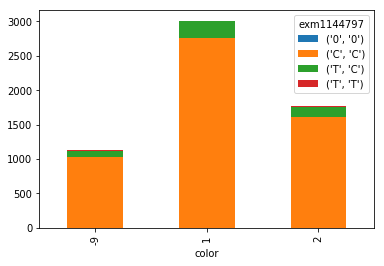

rs2338834


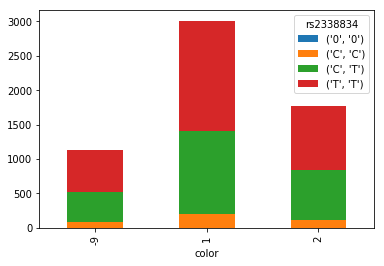

exm1826840


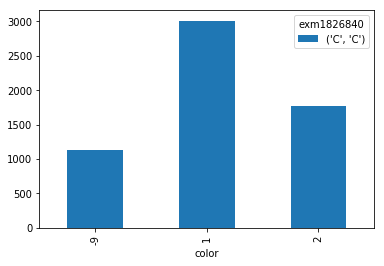

exm2252098


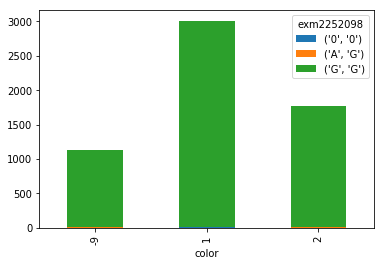

rs3743234


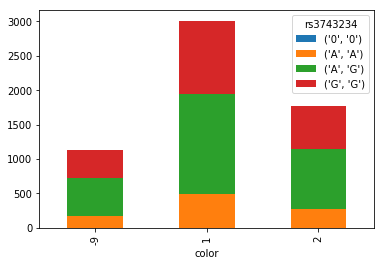

indel.34396


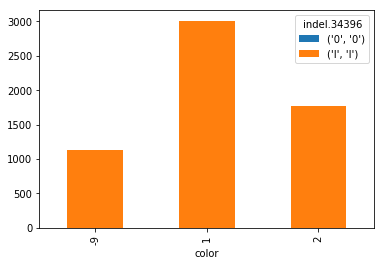

indel.34397


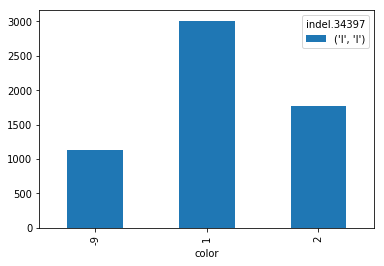

exm1144825


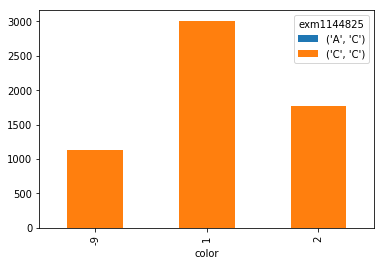

rs3784594


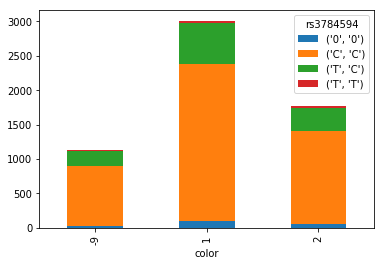

exm1144833


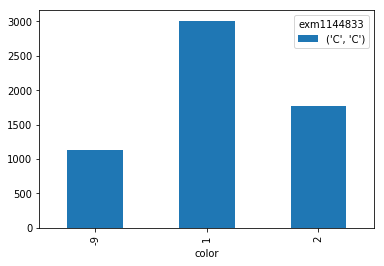

exm1144835


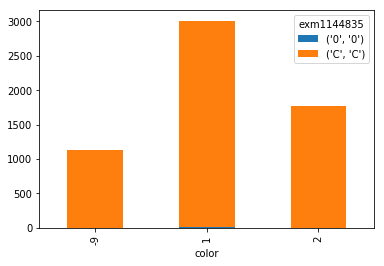

rs11070767


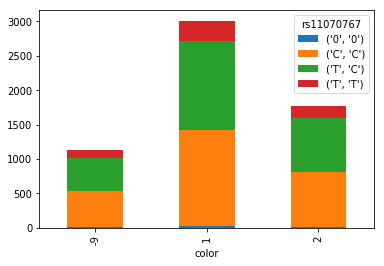

exm1144841


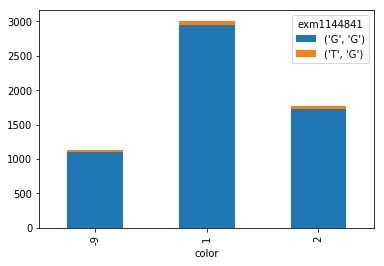

exm1144842


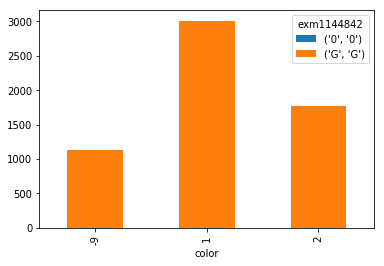

variant.34399


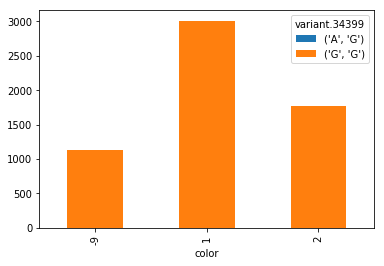

exm1144848


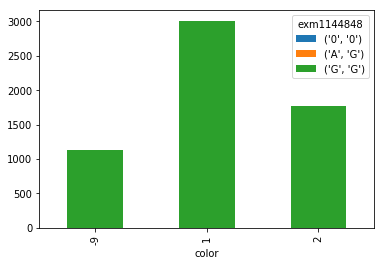

exm1144851


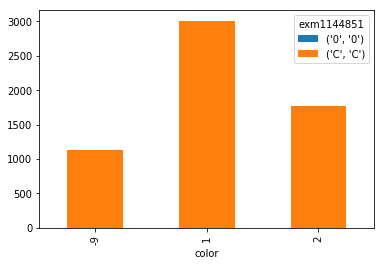

exm1144858


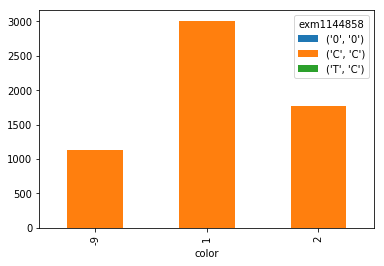

rs919001


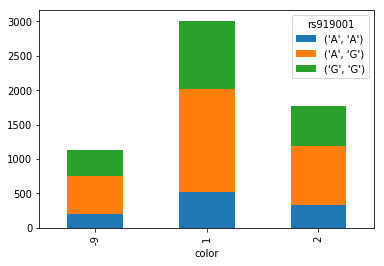

variant.34405


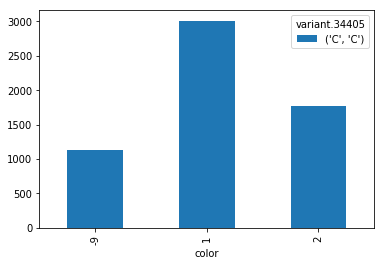

exm1144880


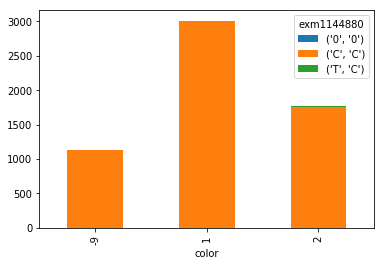

exm1144881


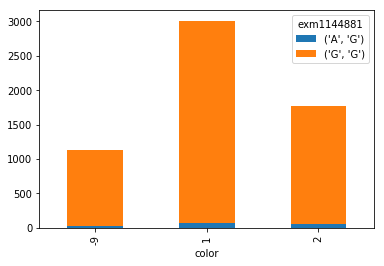

exm2252099


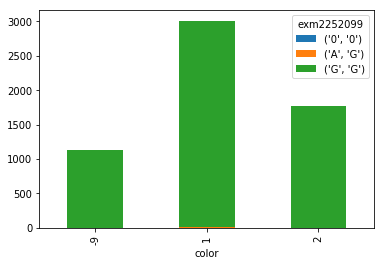

newrs191205969


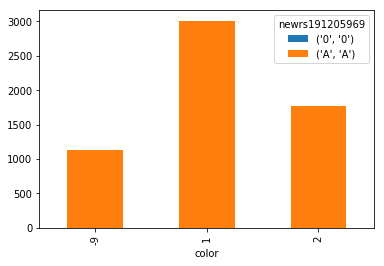

indel.34407


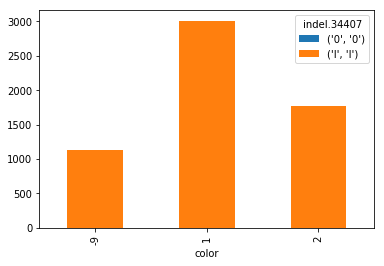

exm1144893


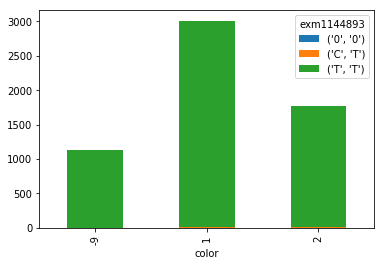

exm1144900


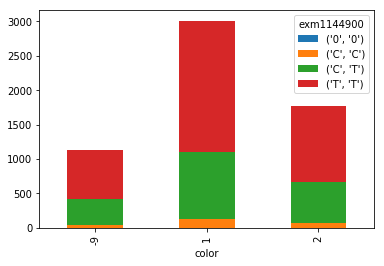

exm1144902


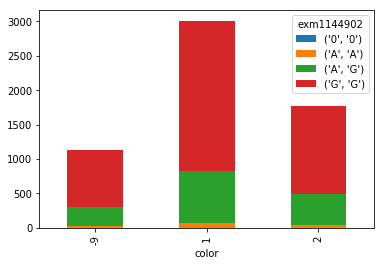

rs7180591


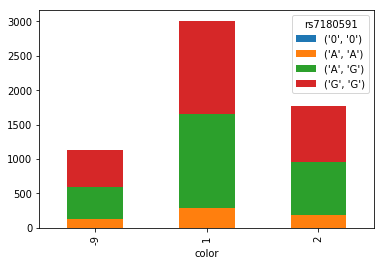

exm2252100


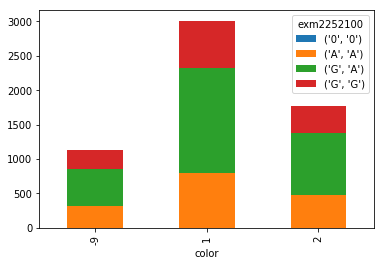

rs12911889


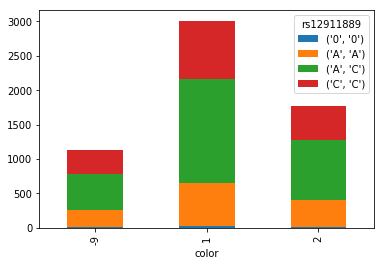

rs6493454


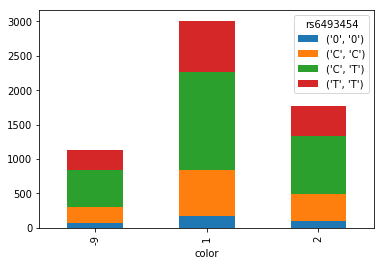

rs3809578


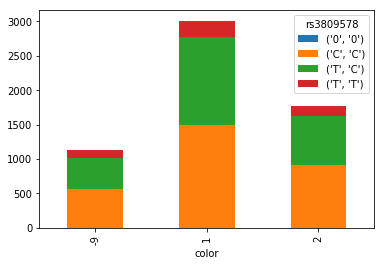

rs4779824


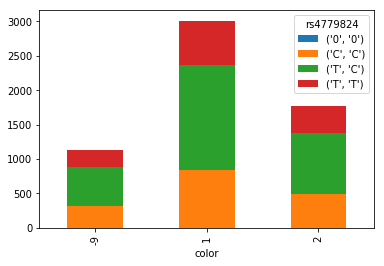

rs6493462


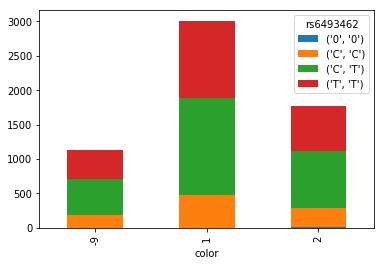

rs10467997


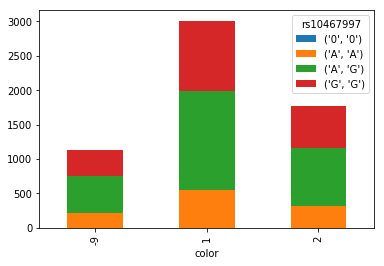

rs4779829


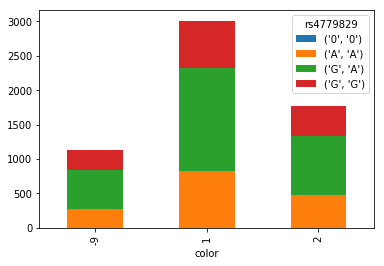

rs783024


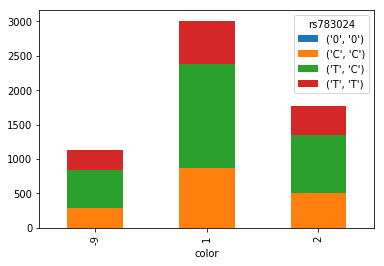

rs783026


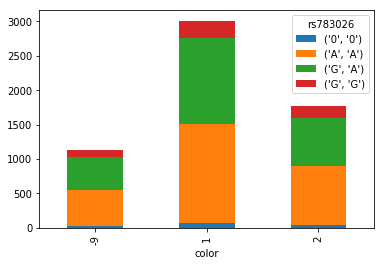

rs783033


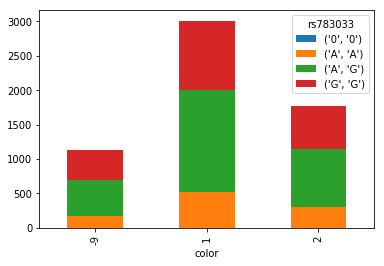

rs8028220


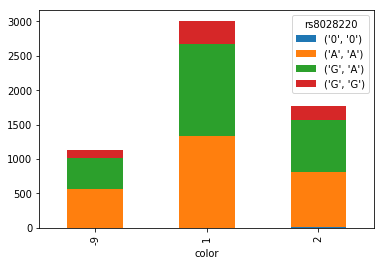

rs12148567


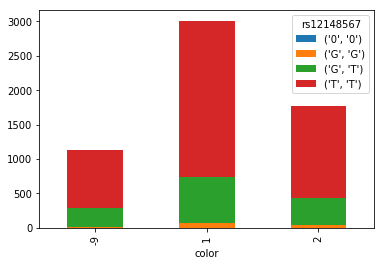

rs1672408


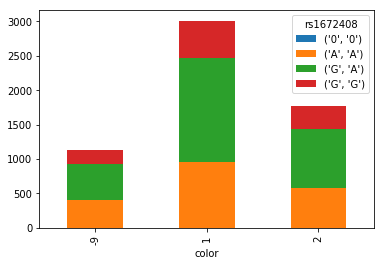

rs8035624


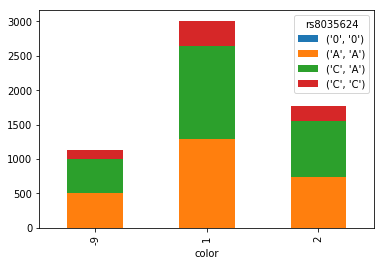

rs8025178


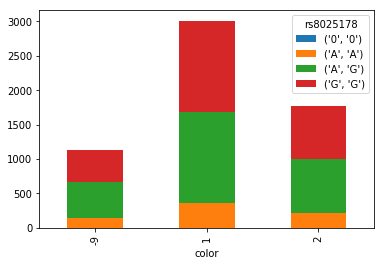

rs1463408


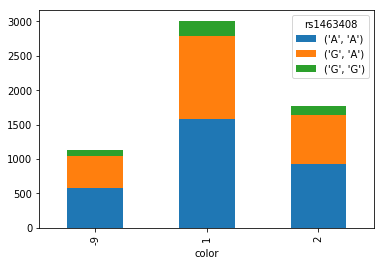

rs880011


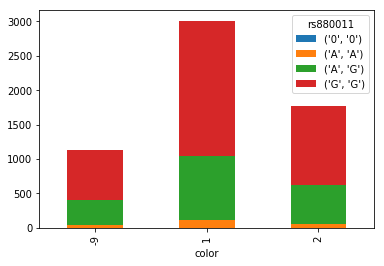

rs3096464


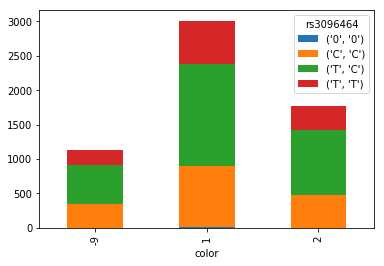

rs17228178


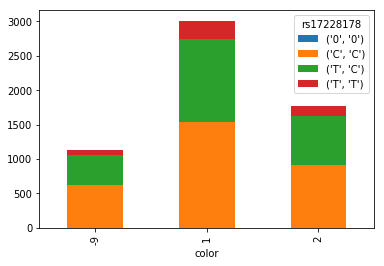

rs999876


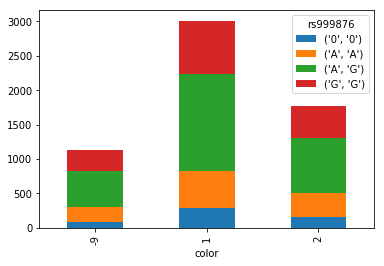

exm2252101


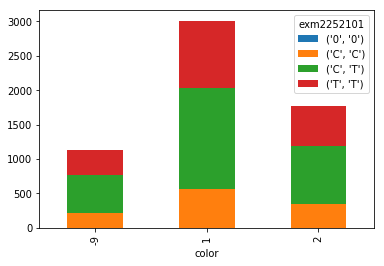

rs278357


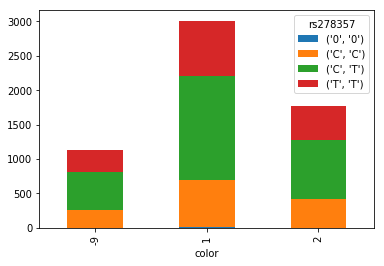

rs11070871


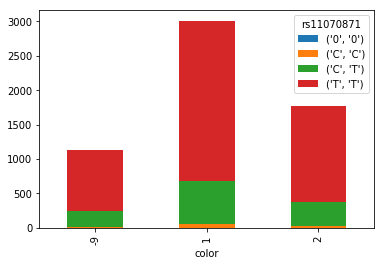

rs12903039


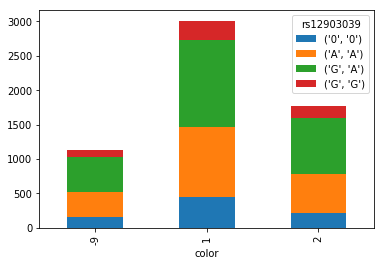

rs7163696


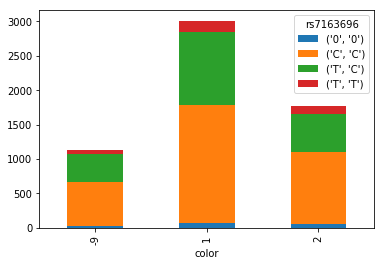

rs4329885


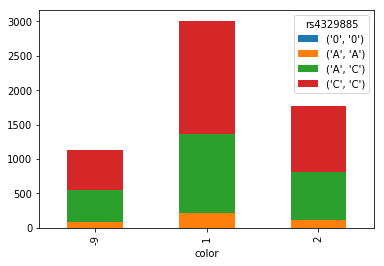

rs11632469


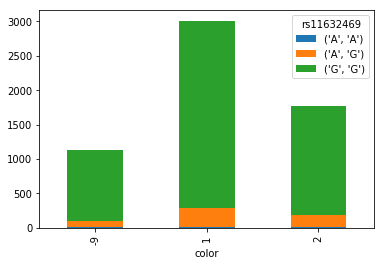

rs8035110


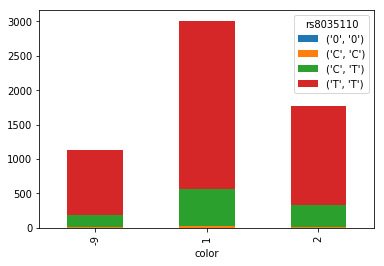

rs6493540


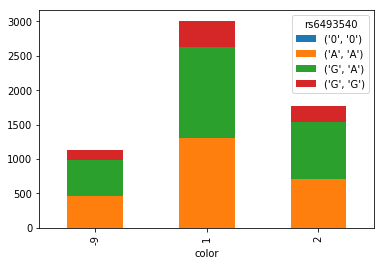

rs7178899


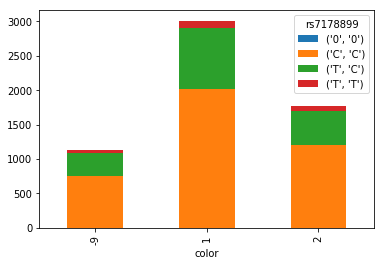

rs17815905


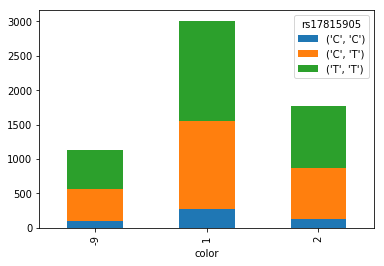

rs11632955


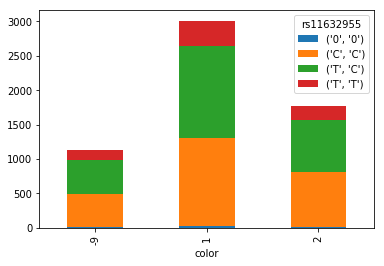

rs11070905


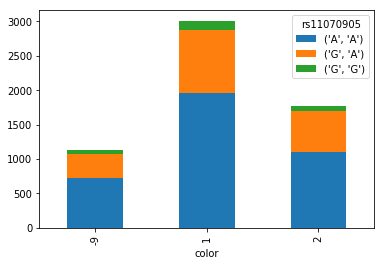

rs7175931


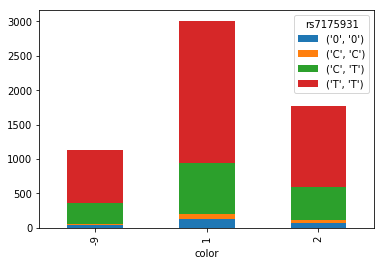

rs12439925


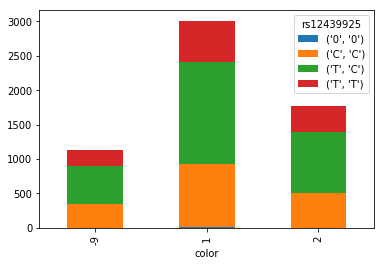

exm2272294


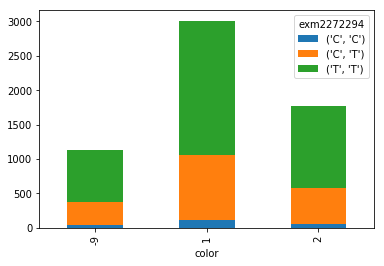

rs11630449


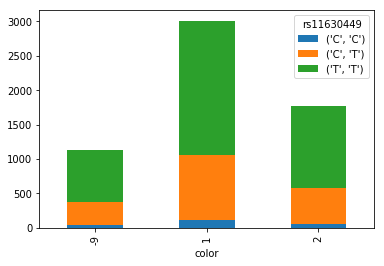

rs1465778


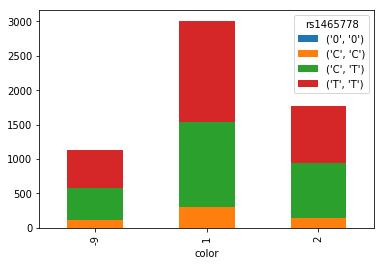

rs4779862


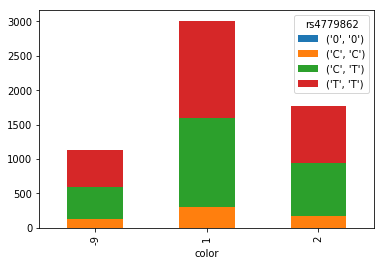

rs11857440


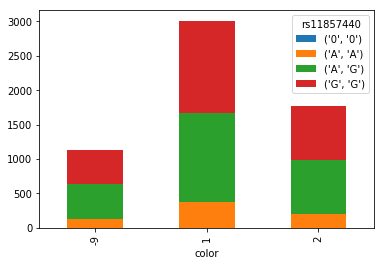

rs7169662


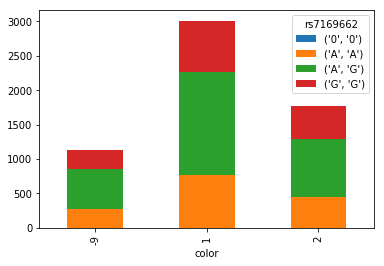

rs8031093


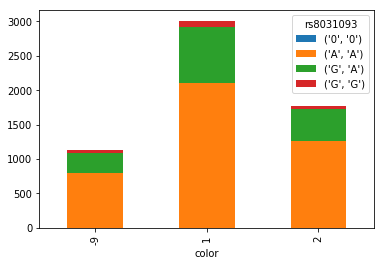

rs4779521


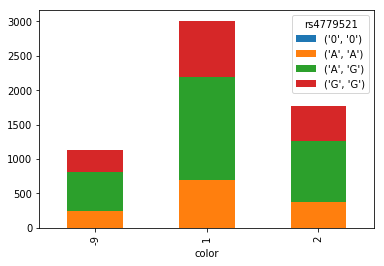

rs8042404


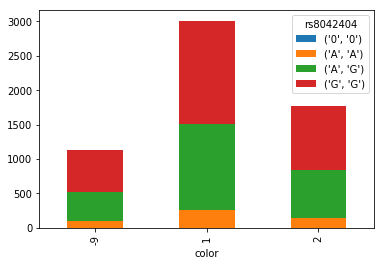

rs8035633


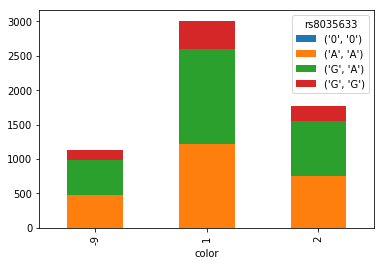

rs8039613


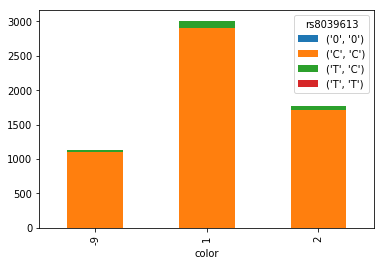

rs7402977


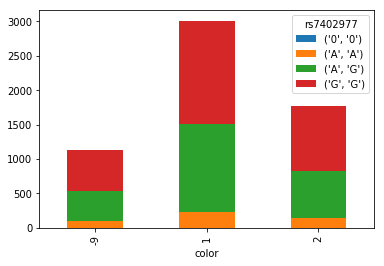

rs8040885


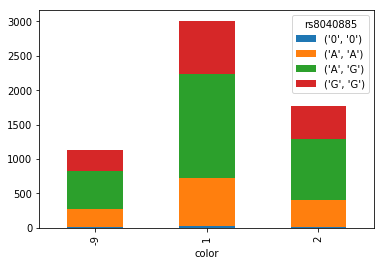

rs9302175


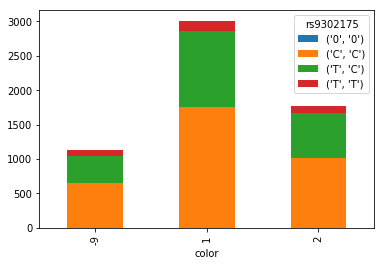

rs4779528


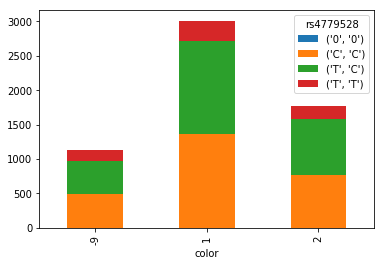

rs2219508


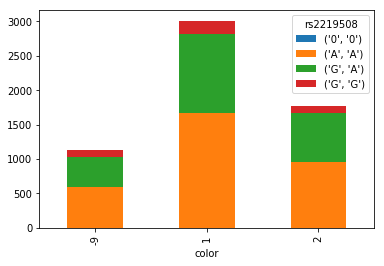

rs16956769


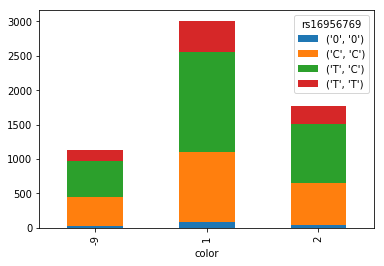

rs7183105


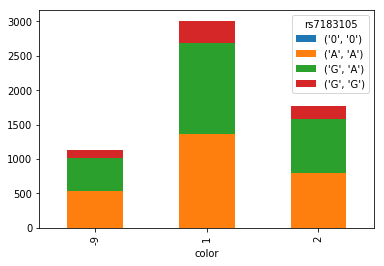

rs898213


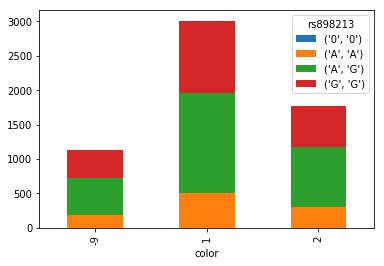

rs6493688


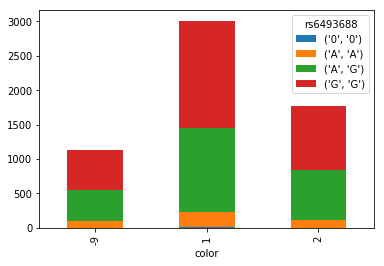

exm2275347


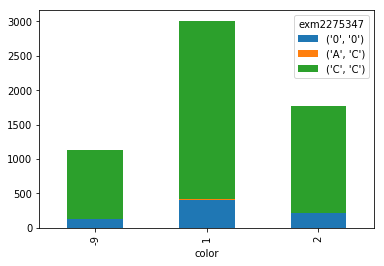

exm1144970


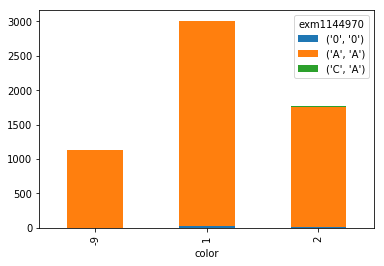

exm1144972


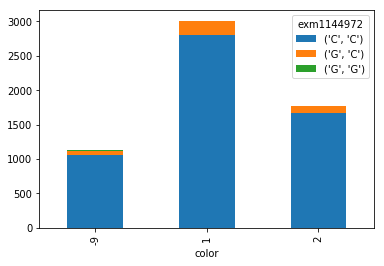

rs16956782


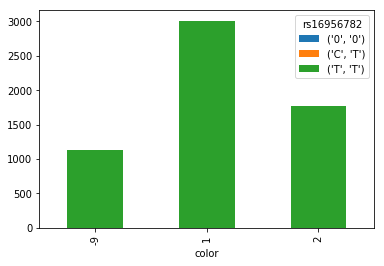

rs4779536


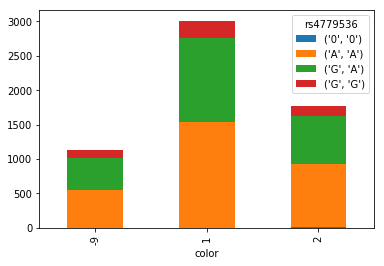

rs2125615


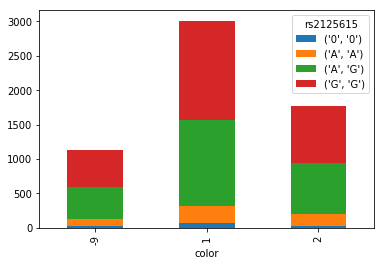

rs4779889


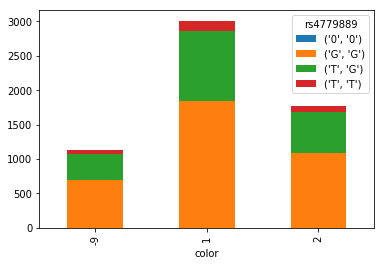

exm1144999


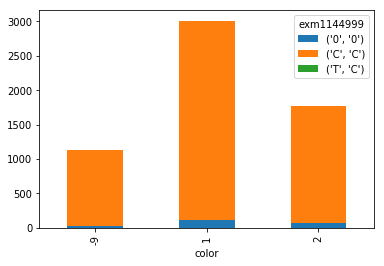

exm1145002


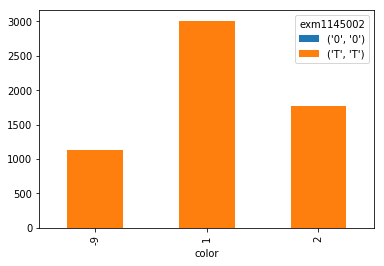

rs12915549


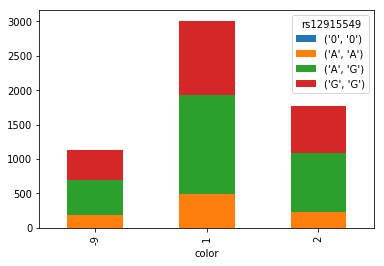

exm-rs2125623


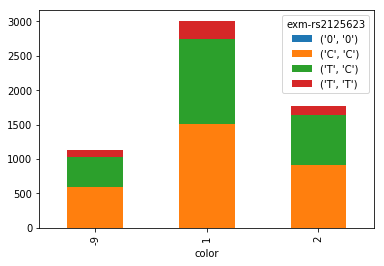

rs12908729


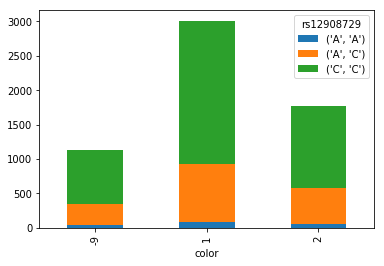

rs11071179


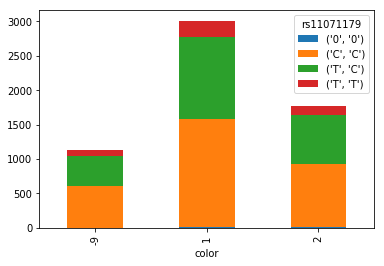

exm1145013


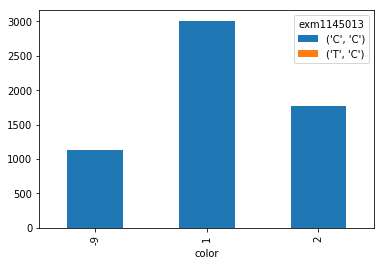

exm1826928


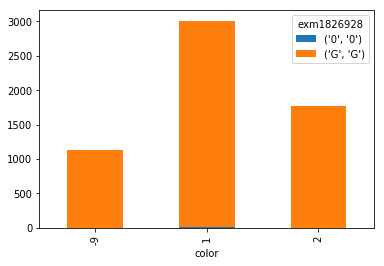

rs2219507


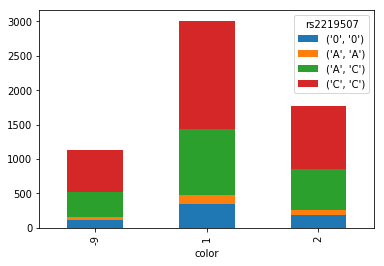

rs4779544


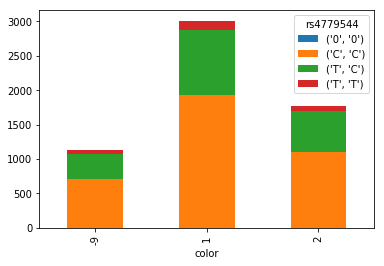

rs11635581


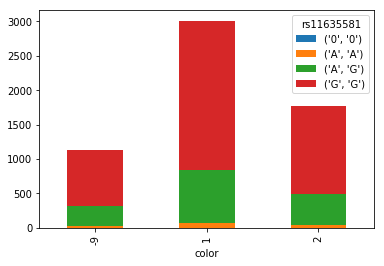

rs7170060


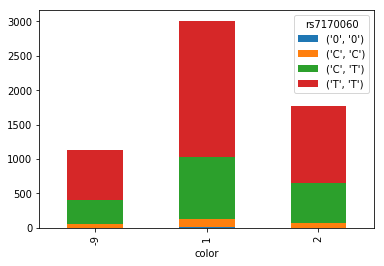

rs7178914


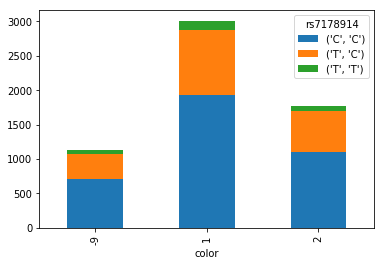

rs8026705


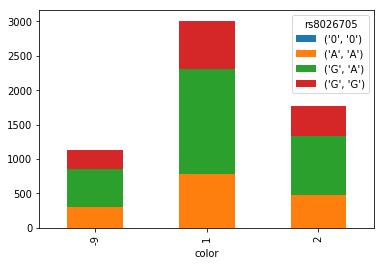

rs4779910


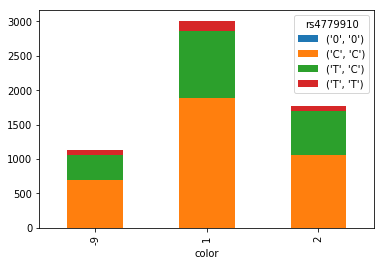

rs11858379


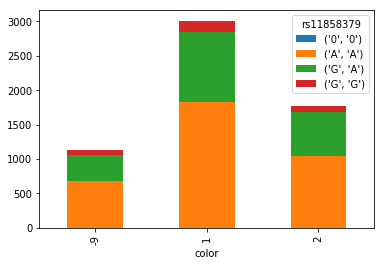

rs1962098


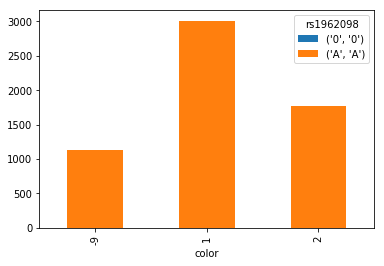

kgp3962104


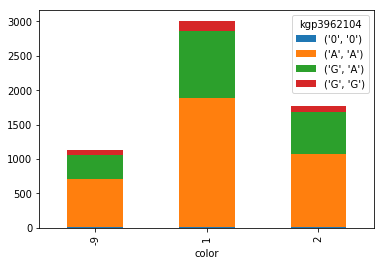

rs17762839


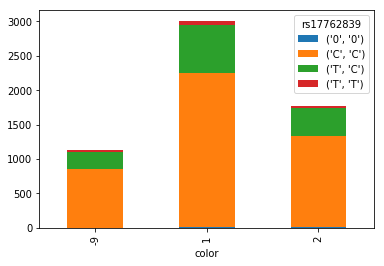

rs905432


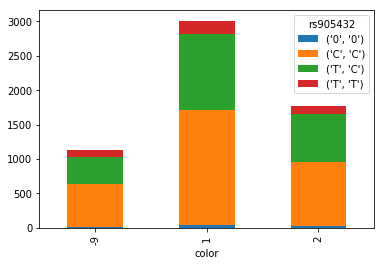

rs10519683


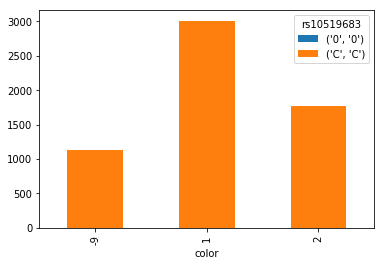

rs17684549


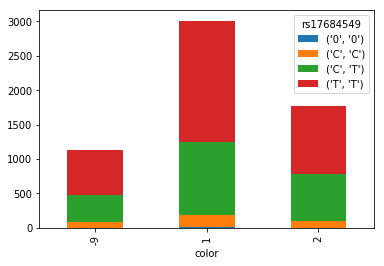

rs12908870


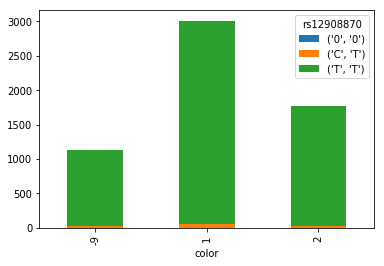

rs12904812


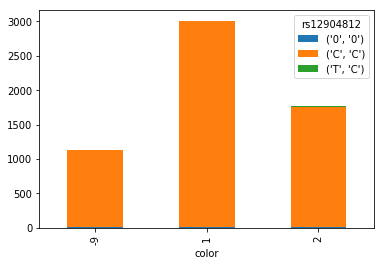

rs7171443


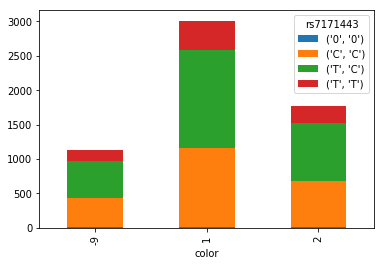

rs8027942


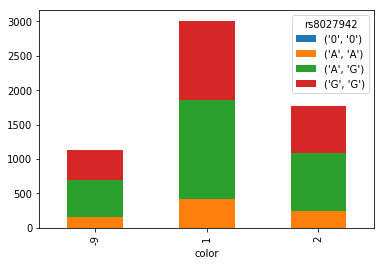

rs1502999


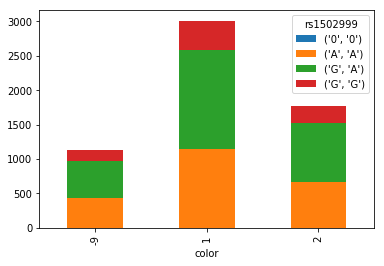

rs7170850


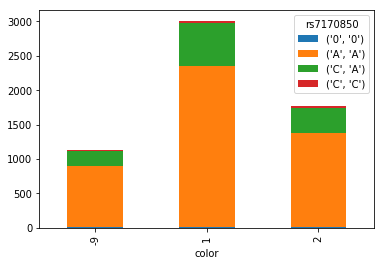

rs4238558


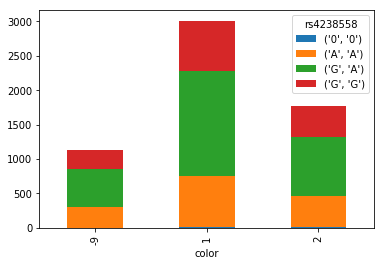

rs12594231


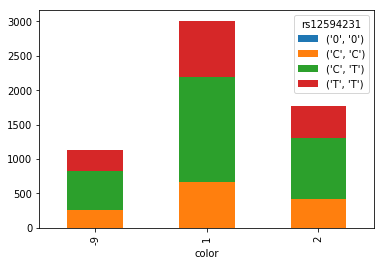

rs4417522


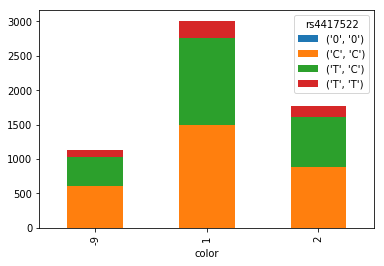

rs1011863


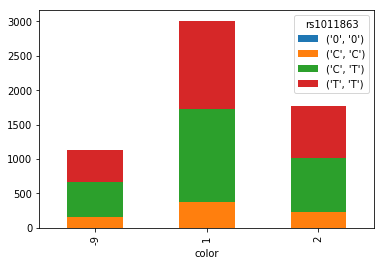

rs12916469


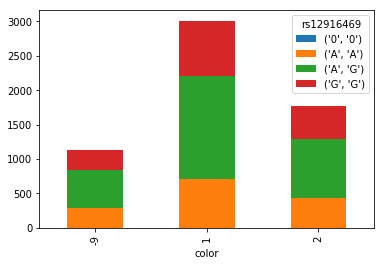

rs12441131


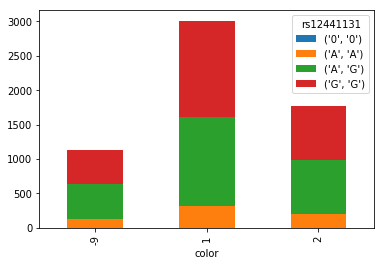

rs1514255


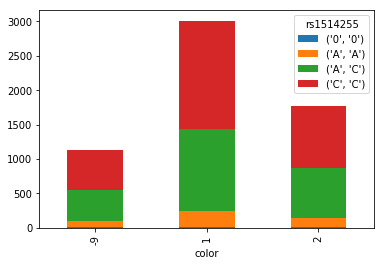

rs4779948


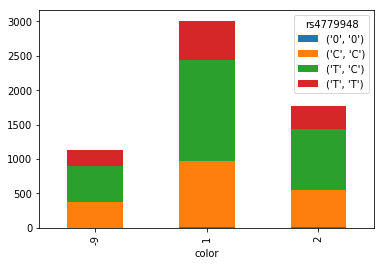

rs952284


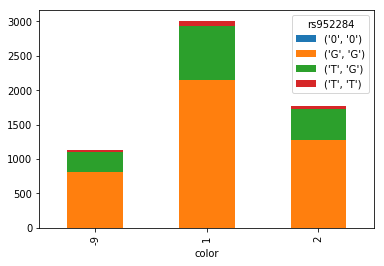

rs11636810


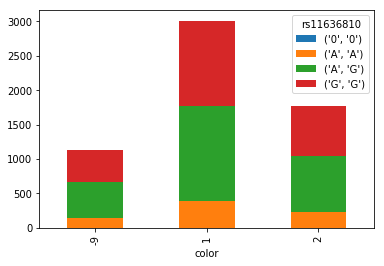

rs9920979


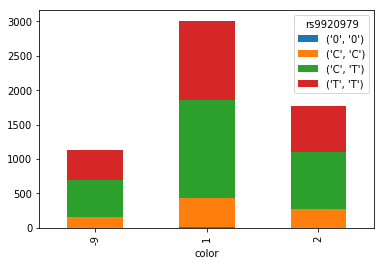

rs1399195


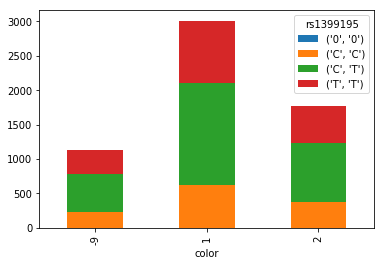

rs1514260


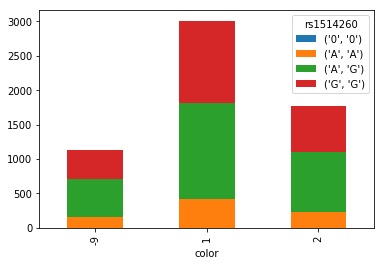

rs965435


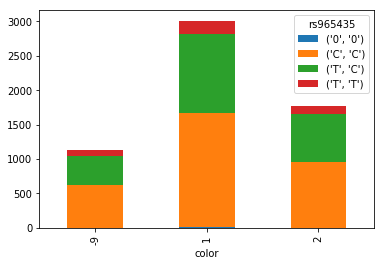

rs11635209


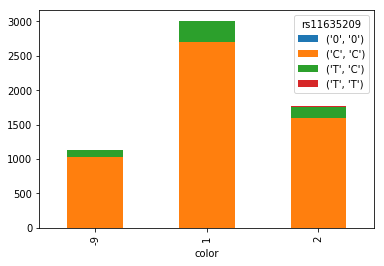

rs11071503


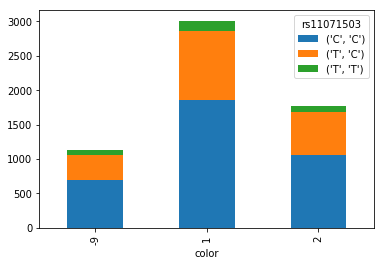

exm2260416


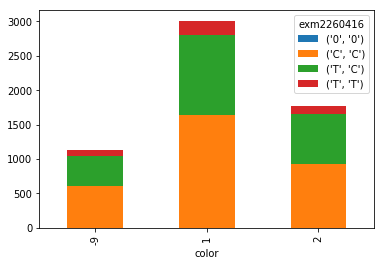

rs11637923


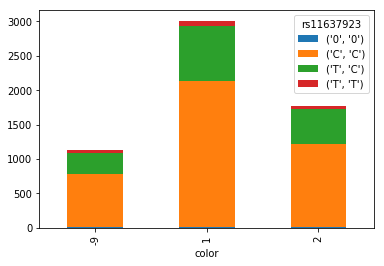

rs8033518


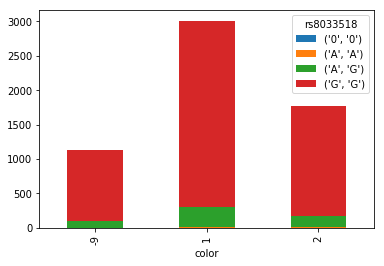

rs8036104


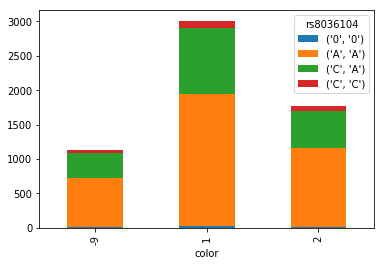

exm2272222


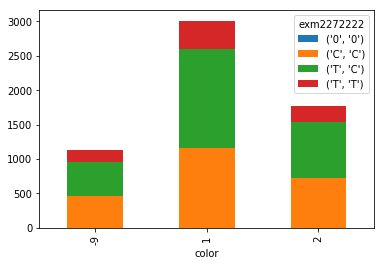

rs8028396


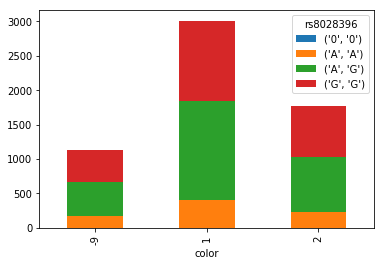

rs11858834


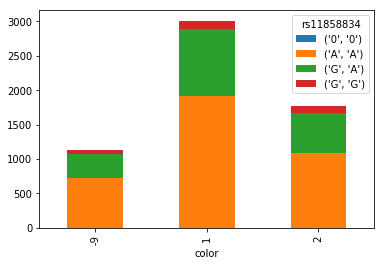

exm1145045


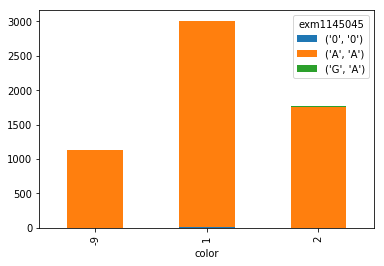

rs904951


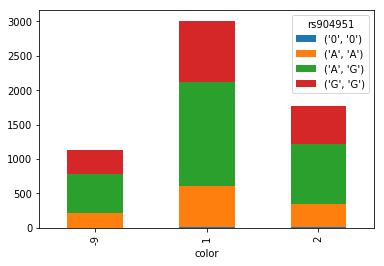

rs1909884


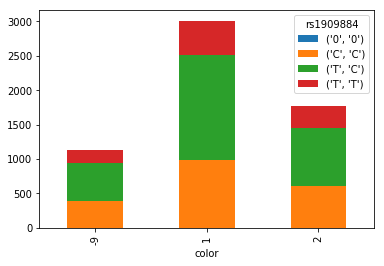

kgp10538347


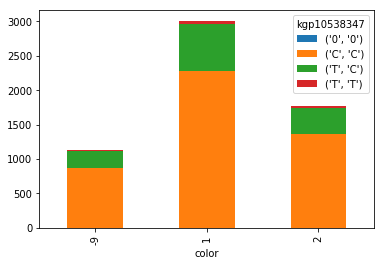

kgp9391258


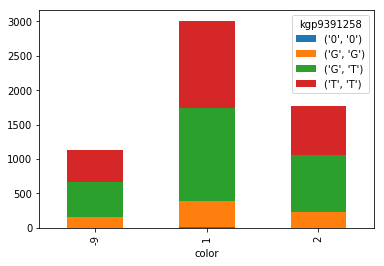

rs2926504


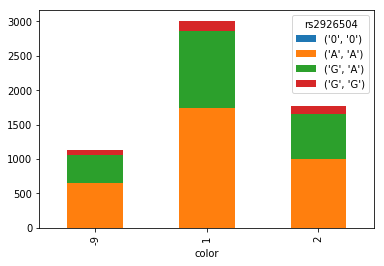

rs2946542


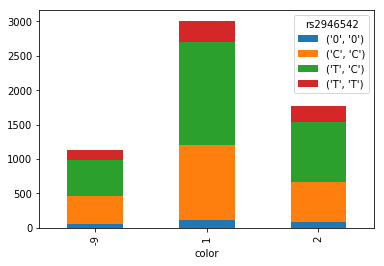

rs2946543


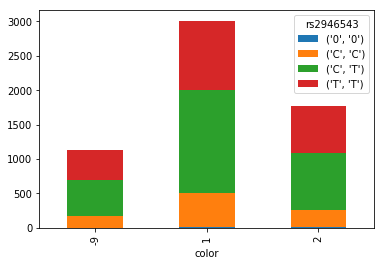

rs9672198


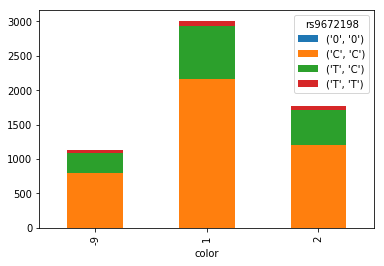

rs2611583


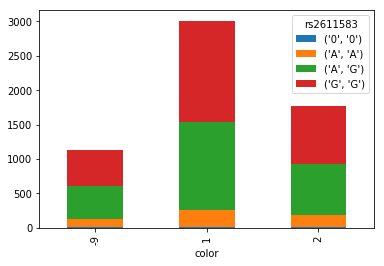

exm2223141


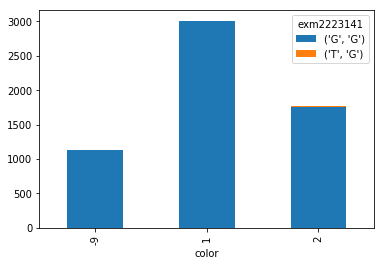

exm1145116


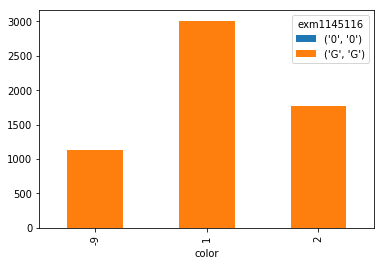

exm1145117


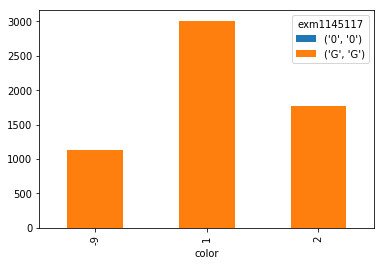

exm1145133


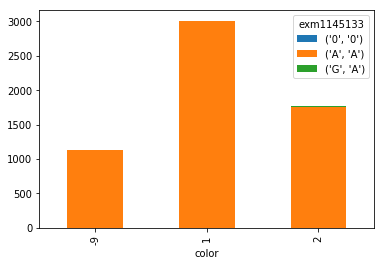

indel.34417


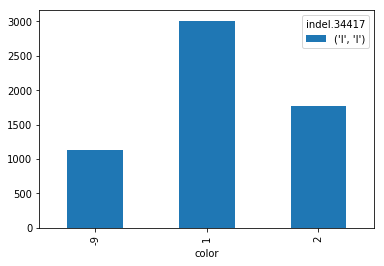

exm1145149


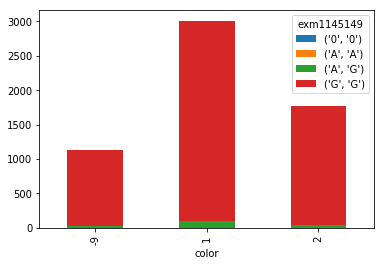

newrs77409359


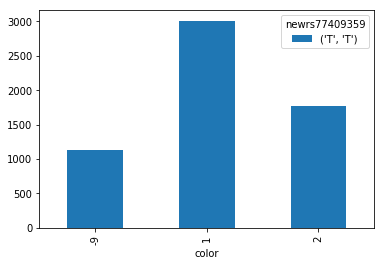

exm1145152


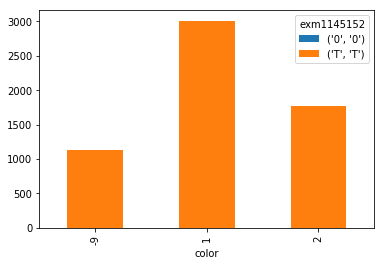

exm1145153


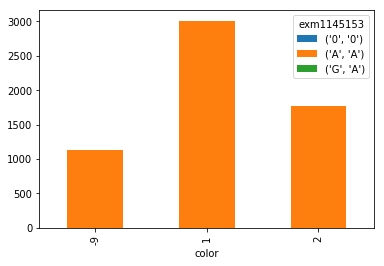

rs8037818


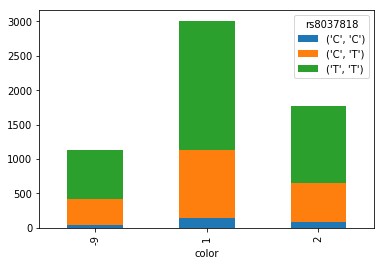

exm2223144


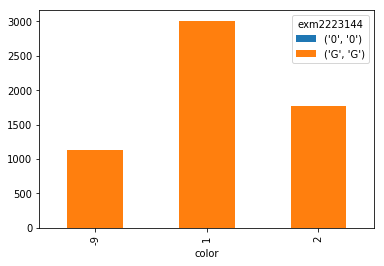

exm1145163


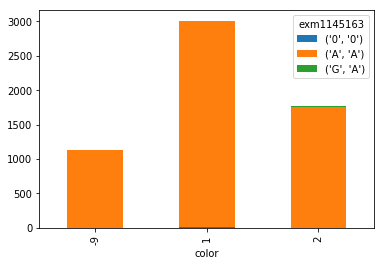

exm1145169


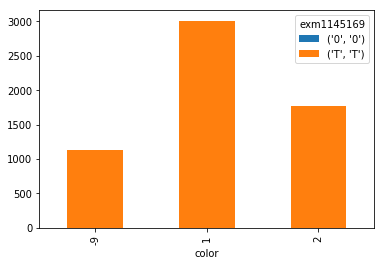

exm1827016


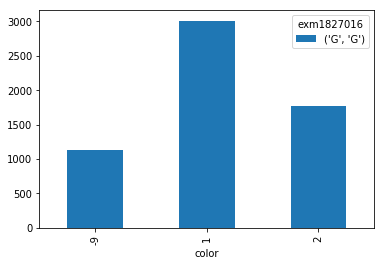

exm1145172


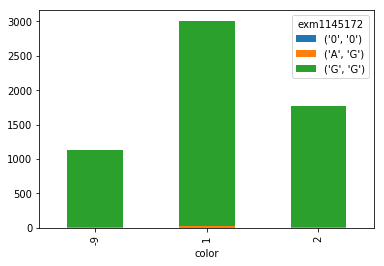

exm2223146


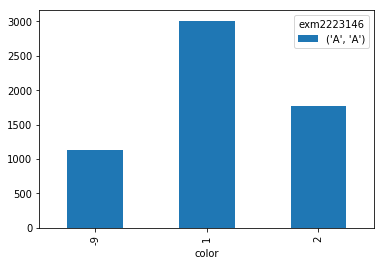

exm1145175


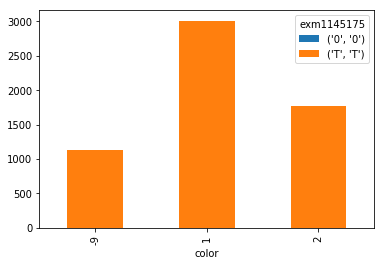

exm1145185


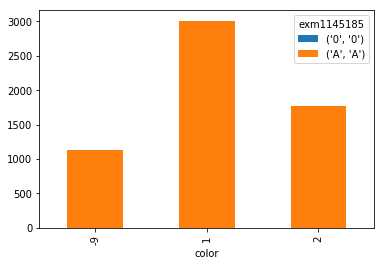

variant.34422


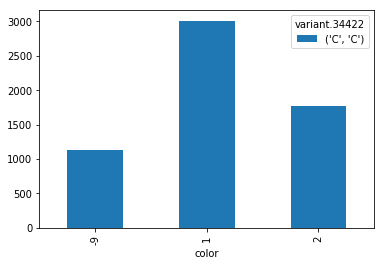

exm1145196


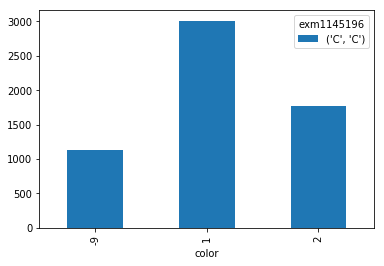

exm1145205


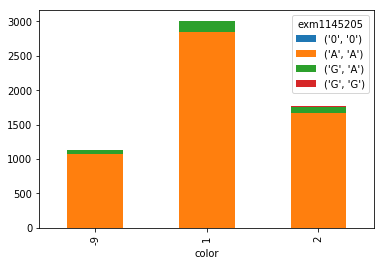

exm1145208


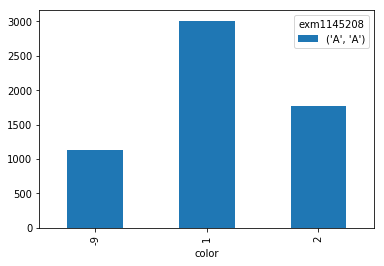

exm1145210


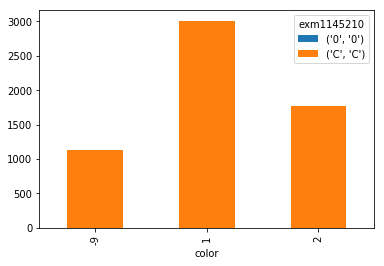

variant.34423


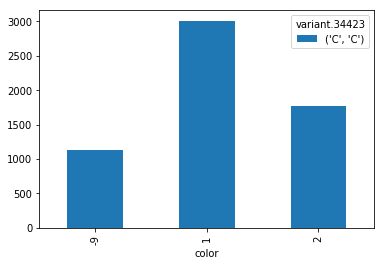

indel.34424


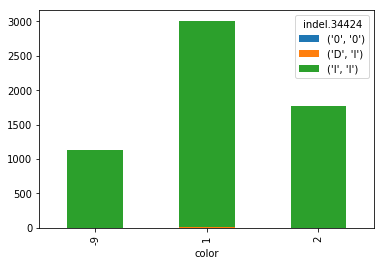

exm1145219


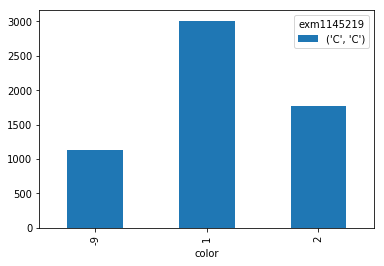

variant.34425


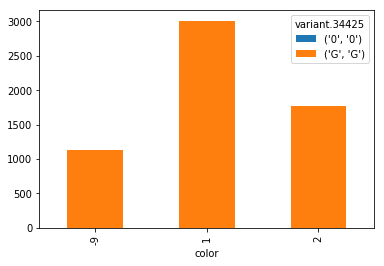

variant.34426


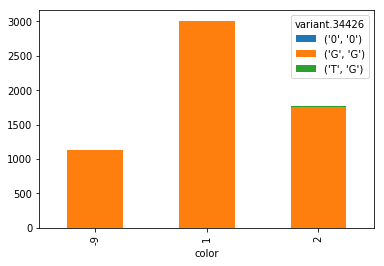

exm1145230


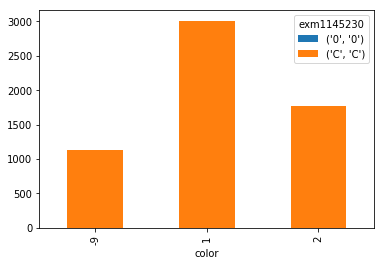

exm1145232


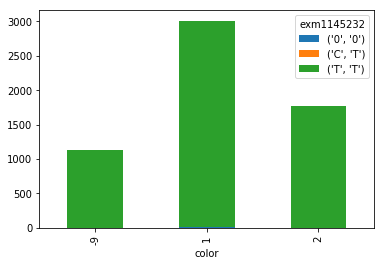

exm1145234


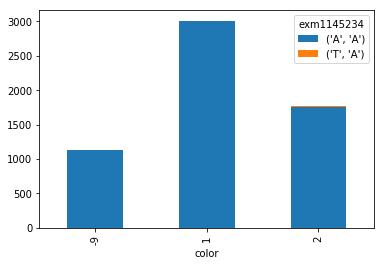

rs12594777


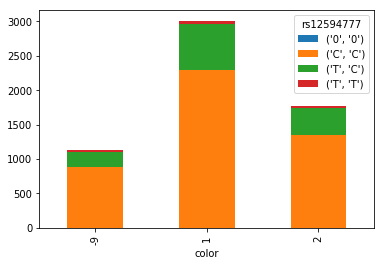

rs11071882


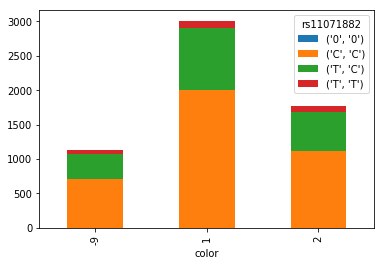

rs8041254


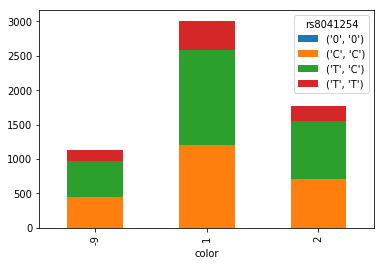

rs3817592


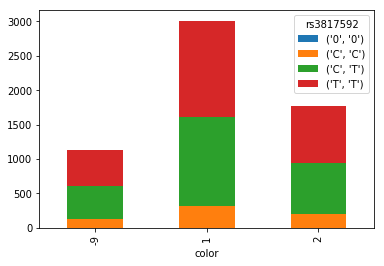

rs7177843


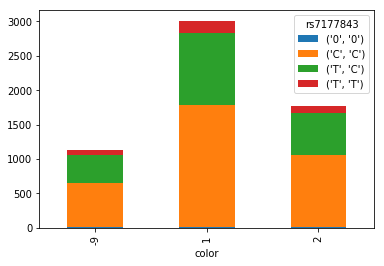

indel.34428


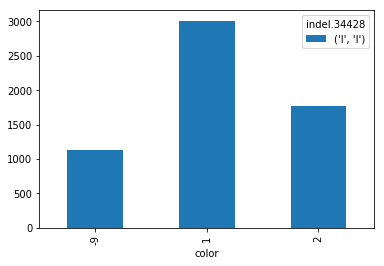

exm1145243


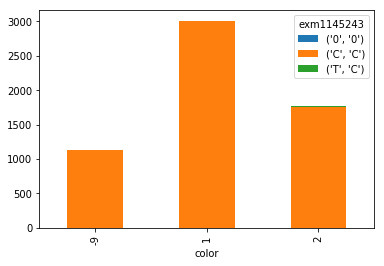

exm1145246


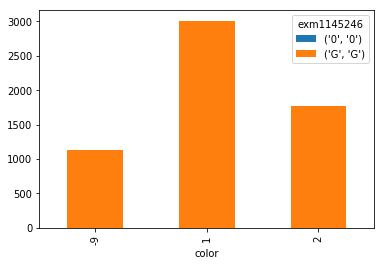

rs16966853


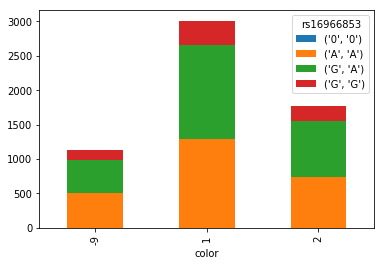

rs6494587


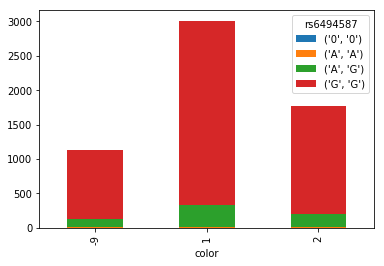

rs1997317


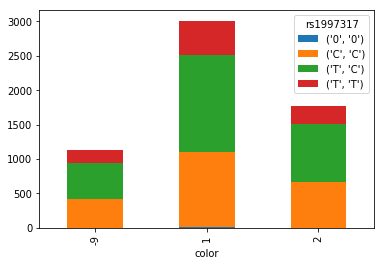

exm2252105


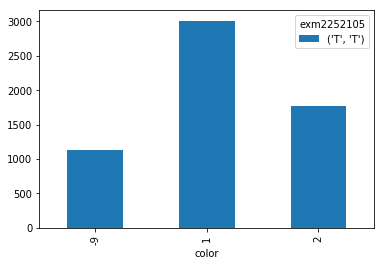

rs16969816


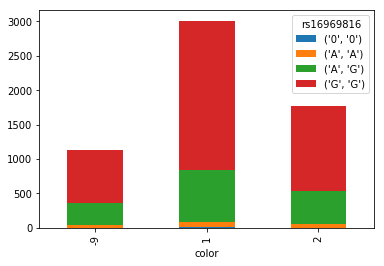

exm-rs4779584


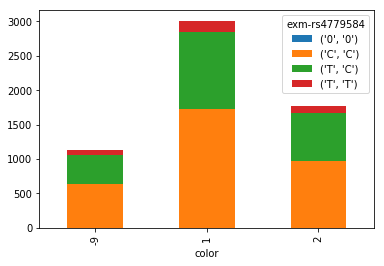

rs4779584


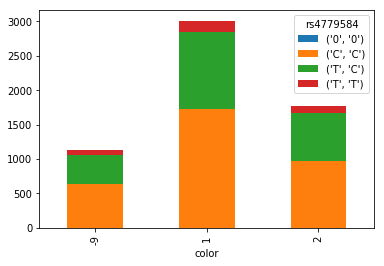

rs11853552


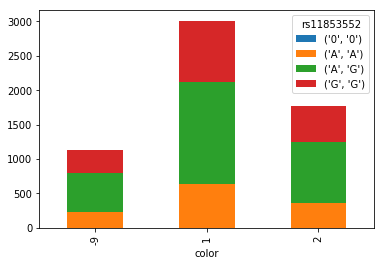

rs4780035


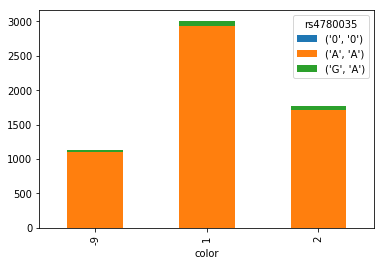

rs3812934


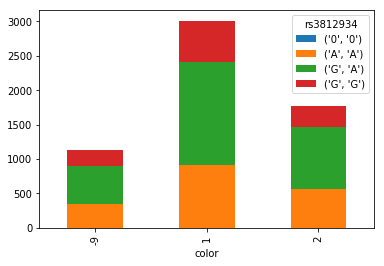

exm1145262


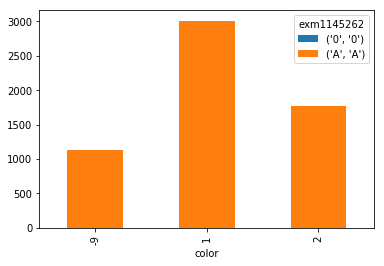

exm1145275


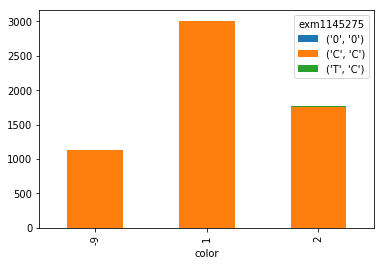

rs3743104


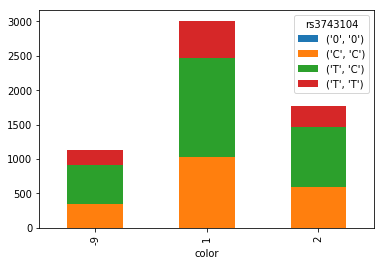

rs7162202


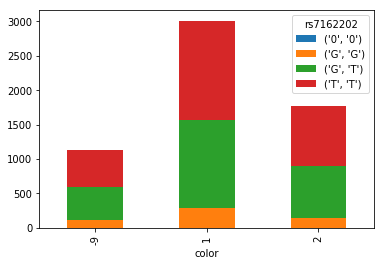

rs17525764


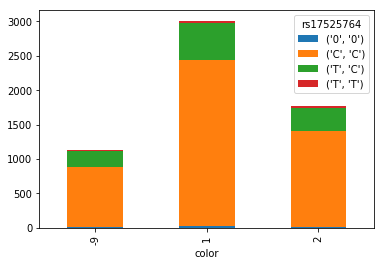

rs11071936


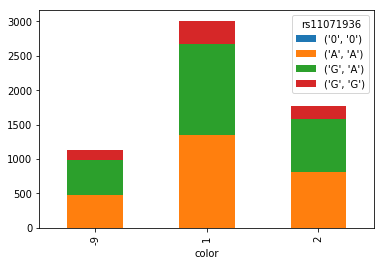

rs10519740


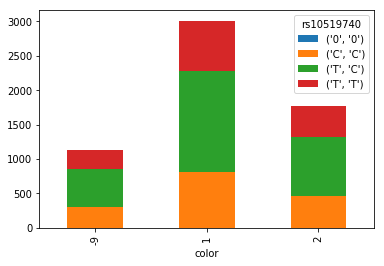

rs1919360


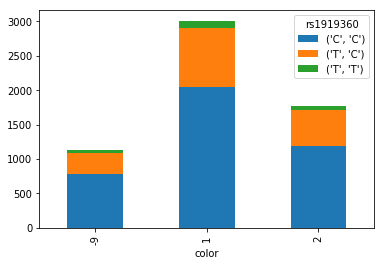

exm-rs1258763


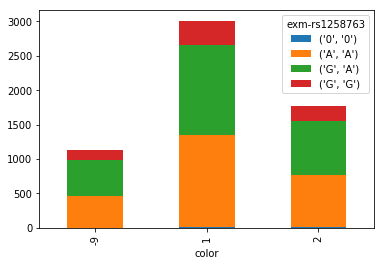

rs2697936


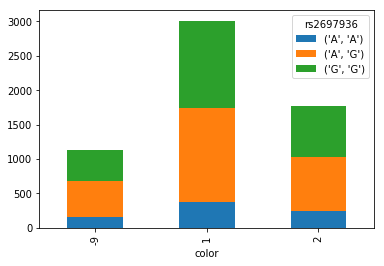

rs3108628


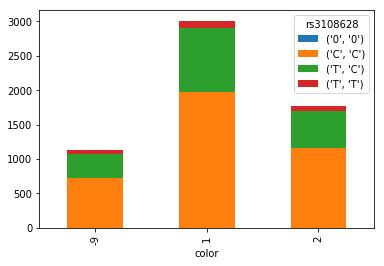

rs16958561


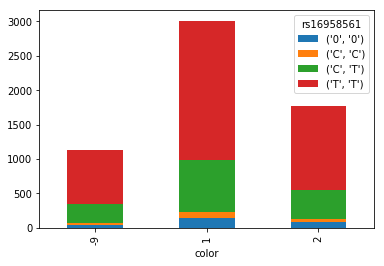

rs1258726


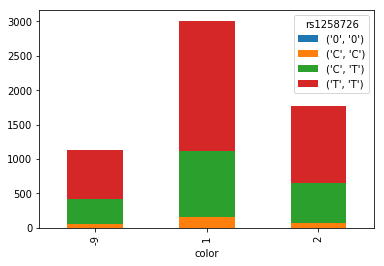

rs3743106


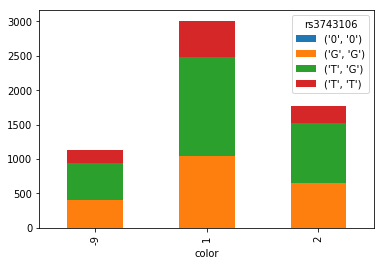

rs1258732


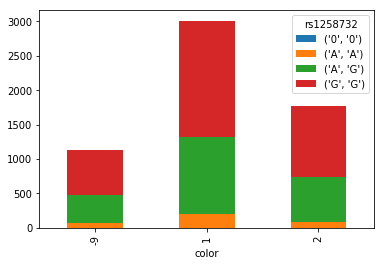

rs2037844


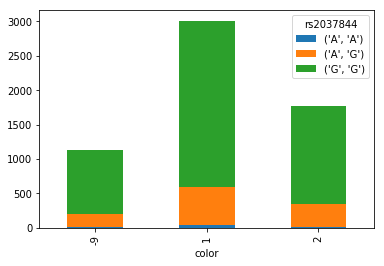

variant.34432


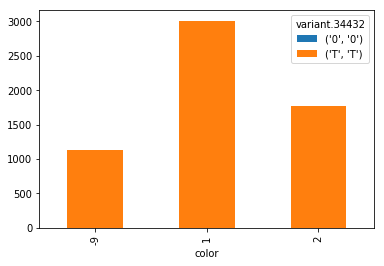

rs12594522


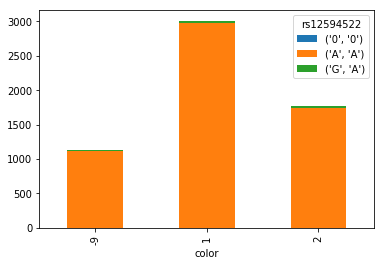

rs2077680


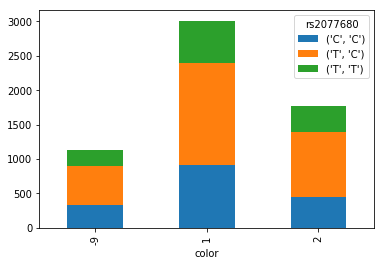

rs17816375


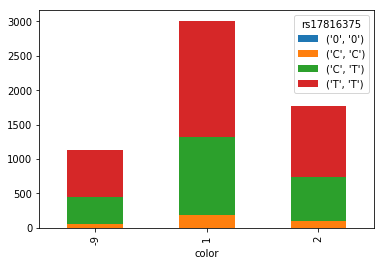

variant.34433


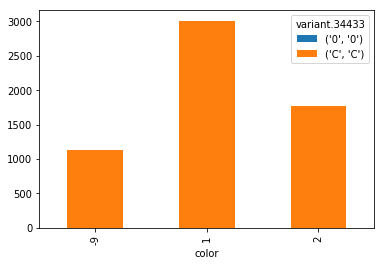

exm1145283


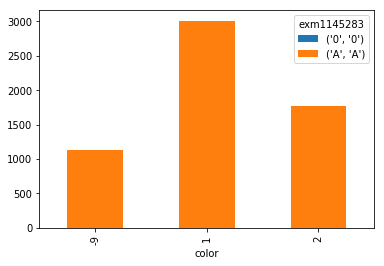

rs7162695


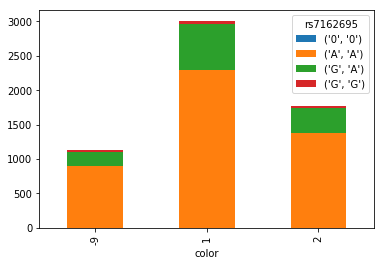

exm1145287


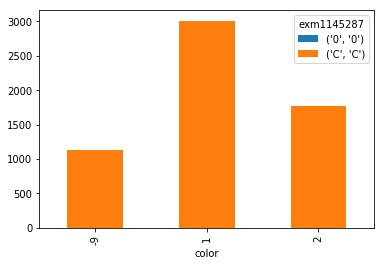

exm1145288


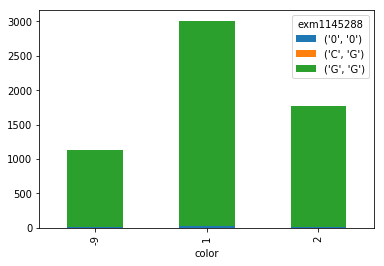

1KG_15_33091102


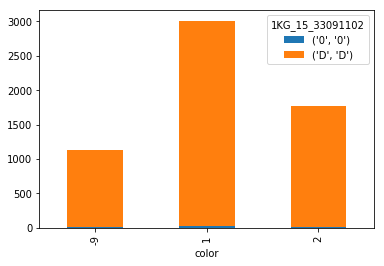

rs12593223


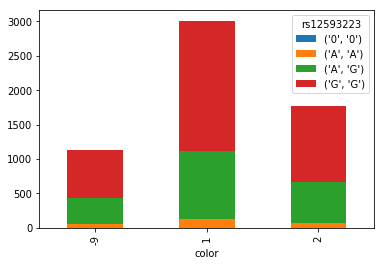

rs16959022


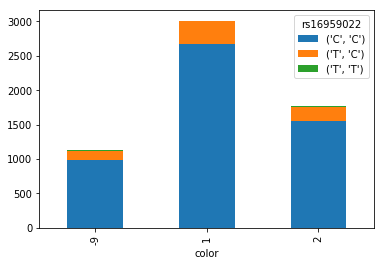

rs9806641


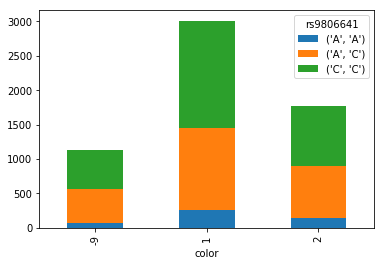

exm1145291


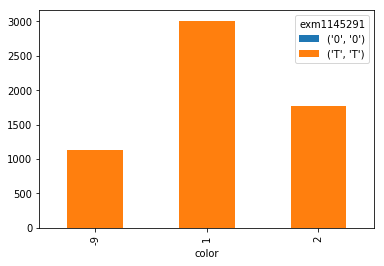

rs7178265


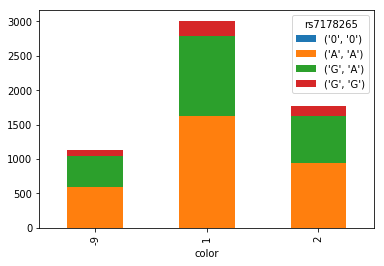

exm2272223


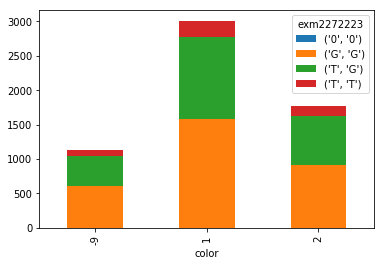

rs16959110


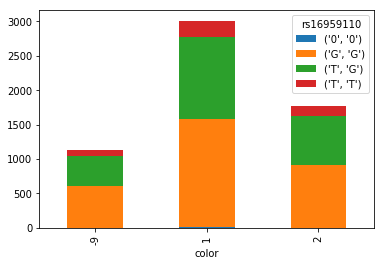

rs921510


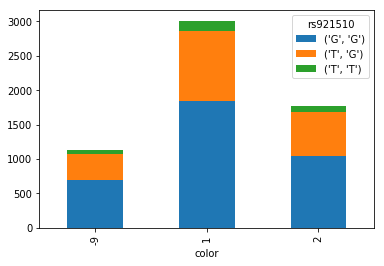

rs12101843


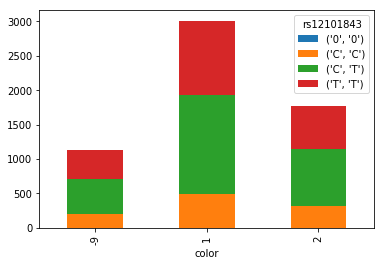

rs1258784


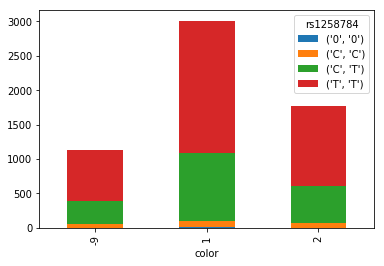

rs8032931


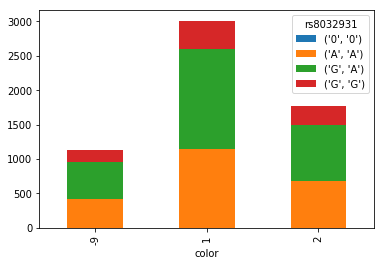

exm1145299


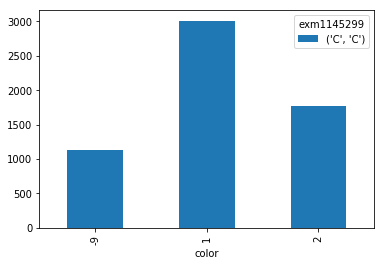

rs4780050


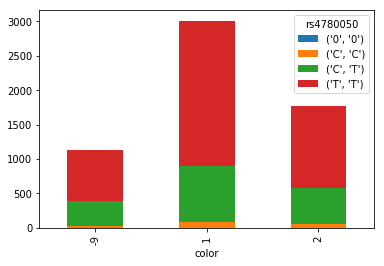

rs10519758


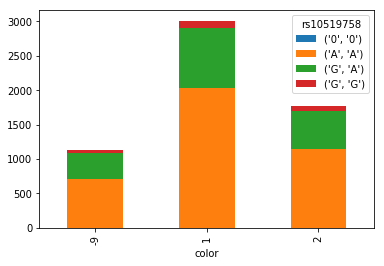

rs4780053


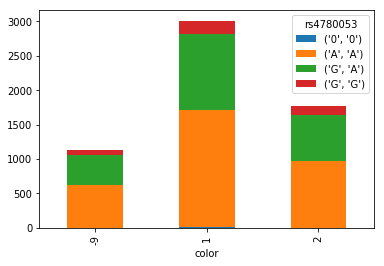

rs12595789


rs1562930


rs580115


exm1145302


rs347931


rs7162186


exm1145306


variant.34436


exm1145319


exm2276365


1KG_15_33200716


exm1145325


exm1145327


indel.34438


rs10519765


rs12904870


rs17816555


exm1145330


rs11072074


rs12916094


exm1145338


exm1145344


variant.34439


exm1145346


exm1145360


exm1145363


exm1145368


exm1145372


exm1145374


exm1145377


exm1145379


exm1145382


exm1145383


exm1145384


exm1145388


exm1145390


rs8034555


rs2597094


rs343929


exm1145396


rs345825


rs10519772


rs345827


rs345848


rs345850


rs7180389


rs184694


rs345875


rs1869663


rs345747


rs11854308


exm1145402


exm1145403


exm1145404


exm1145407


indel.34444


exm1145418


exm1145425


indel.34447


exm1145429


exm1145433


exm1145434


exm1145435


exm1145440


rs11072170


exm1145443


exm1145450


exm1145451


exm1145453


exm1145460


exm1145466


exm1145467


indel.34450


exm1145474


exm2252107


exm1145477


exm1145478


exm1145479


exm1145480


rs7179866


rs345800


rs16964872


rs2619172


rs345776


rs2444955


rs1454985


rs2085180


rs8023846


rs11629580


rs2444967


rs7162655


rs2468756


rs4350544


rs11072275


exm2260417


rs10519799


rs16966391


rs11072312


rs4238562


rs17817006


rs4780094


rs4780095


rs8038569


rs6494978


rs11072340


rs2292547


rs17235868


rs8031751


rs8030609


rs1399073


rs8043175


rs1913426


rs8035094


rs4536437


rs7173234


rs3924013


rs2339262


rs3902635


rs8031347


rs2676066


rs2251107


rs2670947


rs2670941


rs1514032


rs1980102


rs8030923


rs11631882


rs16969986


rs10519816


exm2272224


rs2676055


rs2339270


rs17098


rs16970823


rs4780118


rs2676023


rs4356445


rs16970977


rs2459470


rs2033610


indel.34451


rs4780121


rs11858432


variant.34452


rs2572182


rs2572164


rs7165389


rs6495130


rs8039078


exm1145512


rs744776


rs6495164


rs1435102


indel.34454


variant.34456


exm1145536


exm1145537


exm1145538


exm2252109


exm1145539


rs11634054


rs1435118


rs8041171


exm1145542


exm1145543


exm1145546


exm1145549


exm1145551


exm1145552


rs16972837


rs10153042


rs671122


rs2467561


rs16973062


rs2437143


exm1145568


exm1145569


exm1145582


rs17817384


exm1145586


rs2229116


rs4238566


rs16973323


exm1145597


exm1145608


exm1145609


exm1145611


rs1495279


rs11072570


exm1145623


rs1495280


exm1145625


rs2291734


variant.34459


exm1145646


exm1145648


rs8030397


exm1145660


exm2252110


exm1827246


rs12440581


rs2279663


exm1145679


exm1145680


exm1145682


exm1145694


exm1145708


exm1145712


exm1145720


exm1145723


exm1145725


exm1145733


exm1145739


rs4780154


rs12592542


exm1827273


variant.34462


rs12907066


exm1145772


rs2280417


rs6495218


exm1145779


rs4780159


rs11072635


rs4780162


exm1145783


exm1145785


exm1145789


exm1145792


exm1145796


exm1145797


rs2339336


exm1145800


rs12906810


exm1145814


exm1145819


1KG_15_34023840


rs17236525


rs8036377


rs8037593


exm1145823


exm1145825


exm1145839


exm1145840


rs2288608


exm1145848


rs12908501


exm1145855


exm1827316


exm-rs12440440


rs12440440


exm1145862


variant.34463


rs4780177


exm1145874


exm1145875


rs2288604


exm1145876


rs8035184


variant.34464


rs7497692


exm1827333


exm1145885


exm1145888


exm1145890


rs7164080


rs7169486


exm1827340


exm1145893


exm1145896


exm1145898


rs1429753


rs11855625


exm1145913


exm1145914


exm1145925


exm1145932


exm1145934


rs2115747


rs12911184


exm1827358


rs16958087


exm1145959


rs11072687


exm2223163


rs1036006


exm1145974


exm1145987


1KG_15_34118459


variant.34469


exm1146000


rs2059956


rs16958116


rs3815966


exm1146008


exm1146010


exm1146011


exm1146019


exm1146023


exm1146041


exm1146045


exm1146059


exm1146070


rs3764232


exm1146072


indel.34470


exm1146074


exm1827424


rs17817680


rs891343


rs2278314


variant.34473


exm1146102


exm1146108


rs1044129


exm1146135


indel.34474


exm1146136


exm1827481


exm1146142


variant.34475


exm1146149


exm1146153


exm1146154


exm1146155


exm1146156


exm1146157


exm1146160


exm1146162


rs12913404


exm1146172


rs477192


rs4267279


rs592907


rs10152468


rs1978499


rs1978498


rs604289


rs580413


rs679829


rs16958380


rs8028253


rs558160


rs527834


exm2272225


rs8038713


rs519152


rs8042524


rs12050692


rs603152


rs602302


exm1146174


rs6495459


rs2078562


rs623941


exm1146186


exm1146187


exm1146191


exm1146196


exm2252113


exm1146200


exm1146216


exm1146220


exm1146221


exm1146225


exm1146228


exm1146231


exm1146234


exm1146237


exm1146241


exm1146255


exm1146260


rs10152504


rs2568532


exm1146268


exm1146290


exm1146292


exm1146298


indel.34480


exm1146313


exm1146317


var_15_34395827


indel.34484


exm1146329


indel.34485


exm1146335


rs7181861


rs3850096


rs16958835


exm1146352


rs4587944


rs7181902


rs11635964


rs8040071


rs4780227


rs7169884


exm1146385


exm1146399


rs4780233


variant.34489


variant.34490


exm1827605


exm1146474


exm1146475


rs2290942


exm1146479


variant.34492


exm1146494


exm1827625


exm1146501


exm1146504


var_15_34547612


exm1146507


exm1146521


exm1146523


rs12591967


rs347849


rs347861


rs347866


exm1146526


rs7175028


rs347830


rs8031147


exm1146534


exm1146537


indel.34496


exm1146566


exm1146568


exm1146578


exm1146590


exm1146594


exm1146599


exm1146602


exm1146609


exm1146611


exm1146612


exm1146619


indel.34500


exm1146624


exm1146625


exm1146627


exm1146634


exm2223172


exm1146638


exm1146639


exm1146640


exm1146654


exm1146669


exm1146671


exm1146677


exm1146681


exm1146689


exm1146693


exm1146694


variant.34502


exm1146699


exm1827689


exm1146706


exm1146708


exm1146709


exm1146712


exm1146713


newrs61737329


exm1146717


exm1146719


exm1146722


exm1146732


exm1146734


exm1146744


exm1146759


exm1146774


rs4984222


rs4984215


rs4984217


kgp11313841


rs2879515


rs4924045


rs8041207


rs8036663


rs2059591


rs16954263


rs6495691


rs9806404


rs1836974


rs17236946


rs11632459


rs6495699


rs1158263


rs764231


rs6495700


rs6495702


rs1436911


rs16959391


exm-rs7164838


rs6495708


rs6495710


rs4924131


rs11073058


exm-rs634990


rs549811


rs684000


rs669487


rs811563


rs672382


rs12591918


rs596054


rs7163190


rs7164642


exm1146865


exm1146868


rs7174852


rs664251


rs10519956


rs628118


rs16959757


rs16959766


rs893133


rs543686


rs573441


rs1898314


rs16959793


rs661392


rs640249


rs7168187


rs7175090


rs17237149


rs11852984


exm2260419


rs2015461


rs2339648


rs11854124


rs8033479


rs12591523


rs7171993


exm1146914


exm1146916


exm1146918


exm1146920


rs11857217


exm1146945


exm1146961


exm1827820


exm1146982


rs7168306


exm1147005


exm1147013


exm1147029


exm1147031


exm1147045


rs4513050


rs11636350


rs7164070


rs7165312


variant.34518


exm1147106


exm1147108


exm1147117


exm1147118


exm1147130


exm1147136


exm1147144


rs8037200


rs8042678


rs8032009


rs6495739


rs732165


rs6495749


rs730493


rs7175947


rs11853288


rs8027514


rs16960370


exm2264556


rs12440463


rs2054252


rs2199117


rs11073083


rs12917609


rs11073084


rs2339783


rs4923912


rs12917029


rs6495758


rs4924647


rs2339829


rs7167862


rs318339


rs2622756


rs16960723


rs1867523


rs12438661


rs318358


rs2127895


rs16960786


rs28880122


exm1147150


exm1147170


rs6495766


rs11632343


rs6495768


exm2260420


rs11853690


indel.34523


exm1147178


indel.34524


rs16961040


rs16961048


rs1443822


rs8035759


exm1147183


variant.34525


variant.34526


exm1147190


rs1020307


exm1147192


exm1147193


exm1147195


rs6495785


rs7169964


rs16954301


rs956362


rs1498592


rs2291850


rs319883


exm-rs9920881


rs16961410


rs4923689


rs10775226


rs4924012


rs1498589


rs2958724


rs1027486


rs1027488


rs1497825


rs1391265


rs2173286


rs12440810


rs4924022


rs2683075


rs904210


exm2252120


rs2646782


rs1497812


rs904211


rs12438902


rs2460842


rs4924032


rs12440724


rs789782


rs789777


rs789774


rs9920178


rs4299106


rs4924036


rs2055851


rs6495809


rs17616971


exm-rs16962252


exm-rs4923705


rs4923705


rs10520043


exm-rs10520045


rs7168471


rs10431815


rs17536109


rs10520048


rs1898036


rs789892


rs789897


rs1946706


rs1435680


rs11631700


rs11854384


rs4924049


rs11073152


rs12915391


rs11852265


rs7175479


rs1435673


rs723804


rs11636623


rs16962705


rs11631328


rs12101915


rs11073161


rs16962756


rs17641900


rs951169


rs1474084


rs16962788


rs12908730


rs1517877


rs10518868


rs7162897


rs4923709


exm2264572


rs4923710


rs1568221


rs8028529


rs16962904


rs7171802


rs11854877


rs11637690


rs11857344


rs7180805


rs16963009


rs8023848


rs896994


rs2444754


rs17702674


rs965415


rs2444757


rs1453969


rs16963164


rs2467350


rs2123793


rs17704315


rs11632896


rs8026282


rs12899716


rs1453949


rs1453948


rs12899988


rs12440078


rs11073182


rs9972295


rs1979205


rs717316


rs12592712


rs12443190


rs7169571


rs6495860


rs9635387


exm2274738


exm1147209


exm1147210


exm1147211


rs7495845


rs2381887


indel.34527


rs6495867


rs8039451


rs2041849


exm-rs1037439


rs1037439


rs12903547


rs1901725


rs1035172


rs737201


rs16964032


rs7170442


exm2272298


rs8042057


rs8041016


exm1828044


exm1828046


rs16964079


rs1015943


rs1349697


rs13329545


rs11073206


rs4924100


rs2167194


rs4294775


rs1450418


rs8036656


rs12903788


exm1147243


exm1147248


exm1147252


rs16964268


rs9302318


rs11634246


rs16964301


rs8026749


rs7173425


rs10518918


rs8026755


rs1719900


exm2267757


rs1020499


rs896052


rs7183465


rs12898938


rs940093


rs17527156


exm-rs12102256


rs12900044


rs4924114


rs12437615


rs7169007


exm-rs8041675


exm-rs1568679


rs1543245


rs4625687


rs11854996


variant.34531


rs11073224


rs16964713


rs11073227


rs2681319


rs2701506


rs12904297


rs7171671


rs9972361


rs11854089


rs16954389


rs16964798


rs8028213


rs8034579


rs11635704


rs957515


rs12917515


rs1915045


rs1401895


rs2890851


exm2272228


rs7175775


rs11632275


rs11852839


rs11632283


rs9672570


rs4924148


rs10451007


rs1915403


rs624991


rs642598


rs657586


rs1942036


rs10438401


rs16965026


rs1402391


rs1457257


rs8033166


rs1379346


rs17446248


rs7166925


rs1902623


rs17447142


rs10518956


rs12912594


rs12101746


rs11073252


rs7182406


rs9919963


rs4435216


rs10162817


rs4924172


rs12593354


rs11633357


rs12905136


rs8025338


rs7174609


rs8027930


rs4597272


rs4483815


rs4924182


rs8042060


rs8039764


rs10520089


rs16965467


rs1874820


rs11856650


rs16965564


rs1498423


rs8040172


rs2382028


rs10852005


rs7167587


exm2272229


rs8036796


rs10152193


rs1003161


rs4924198


rs12438794


rs8029216


rs6495930


rs12593433


rs16965830


rs8033434


rs8030904


rs11073280


rs8035251


rs1502404


exm1147296


variant.34532


variant.34533


exm1147300


exm1147301


variant.34534


exm1147313


exm1147314


indel.34535


exm1147331


exm2223181


exm1147333


exm1147334


exm1147338


exm1147345


rs2959336


rs4372645


rs12442439


exm2260423


rs8027027


rs7177901


rs11638085


rs6495940


rs4923770


exm2267758


rs8034033


rs1319145


rs12915619


rs7183608


rs16966271


rs11634456


rs16966290


rs16966297


rs6495951


rs17641404


rs1522774


rs2382078


rs1522772


rs867043


rs8030953


rs16966478


rs1522785


rs1522778


exm1147347


exm1147348


rs16966575


rs8035425


rs2177249


rs16966665


exm1147352


rs16966681


rs7182445


rs7177681


exm1147370


exm1147381


exm1147382


exm1147385


rs8039150


rs10852021


rs11854742


rs11856708


rs4412937


rs4923791


rs12438737


rs4924263


rs4244564


rs4324085


rs12439333


rs12905733


rs8036878


exm1147396


exm1147398


rs12440278


rs12594530


exm1147408


exm1147415


exm-rs11073328


exm1147428


rs12591633


exm1147480


exm1147481


exm1147497


exm1147498


rs7177101


variant.34544


exm1147524


exm2223183


exm1147527


exm1147531


exm-rs8035957


rs12593201


rs7170151


exm1147537


rs11073338


exm2267759


rs16967035


rs1316583


rs17574546


rs924005


rs7171171


rs883625


rs9972494


rs13329279


rs3923022


rs1004496


rs6495986


rs1874251


rs4924285


rs4924287


rs6495989


rs1874249


exm-rs12912251


rs12903120


exm1147547


exm1147549


exm2276366


variant.34546


exm1828220


exm1147560


rs1495186


exm-rs12899449


rs4340305


rs2624272


rs2643210


rs8024474


rs16967283


rs7163834


rs12916495


rs7171789


rs2912382


rs16967312


rs2958295


rs2958285


rs11073355


rs1465511


rs2929657


rs2929660


rs11636712


rs2912387


rs1004866


rs2624257


rs17659166


rs12903682


rs16954437


rs8182091


rs2958305


exm-rs2624265


rs4924307


rs11632328


rs7177787


rs7176726


rs8040465


exm2267760


rs7178589


rs1897737


rs2060369


rs12439653


rs7163517


rs731223


rs8027106


rs9972315


rs11857756


rs768269


rs12905686


rs8039562


rs4924313


rs2164006


rs3910264


rs6492848


rs8034449


rs2035060


rs2164011


rs10152887


rs12442494


rs1460800


rs11853413


rs983482


rs2004175


rs4924327


rs1368814


rs7166614


rs1460787


rs724729


rs16968165


rs1380934


rs166693


rs275184


exm2267824


rs275178


rs9972581


rs11638941


rs1505274


rs3913762


exm-rs2852078


rs10520122


rs7170961


rs16968450


rs8031607


rs8030447


rs11070178


rs17691453


exm1147570


exm1147577


exm1147581


exm1147583


exm1828246


exm1147596


rs156787


rs12442932


rs11637020


rs16968678


rs17692507


rs8041440


rs16968751


rs2411267


rs17694111


rs6492879


rs10851385


rs7174403


rs8042633


rs4506869


rs8023965


rs7496544


rs11638546


rs1470148


exm2267761


rs8043207


rs4417529


rs4462564


rs4603529


rs16969087


rs16969088


rs13379938


rs936532


rs1478606


rs11070218


rs2618160


rs7167206


exm2267825


rs8041420


rs16969338


rs2169830


exm1147607


exm1147613


exm1147616


indel.34551


exm1147632


exm1147643


indel.34552


exm1147657


exm1147666


variant.34553


exm1147677


exm1147679


exm1828305


exm1147690


exm1147691


exm1147701


exm1147707


exm1147708


exm1147720


exm1147721


exm1828317


indel.34556


exm1147753


exm1147754


exm2223186


newrs185847032


var_15_39893129


rs11070223


exm1147777


exm1147779


exm1147780


exm1147782


exm1147787


indel.34561


exm1147792


exm1147799


rs10152640


rs1004739


rs2898687


rs7162781


rs2411312


rs2411310


rs6492911


rs16969547


rs937960


rs2631695


exm1147805


exm1147809


rs2664135


1KG_15_40018807


exm1147815


rs2171310


rs2412426


exm1147832


rs6492913


exm-rs8033957


rs7179417


rs12437837


rs12324408


rs2576931


exm1147838


exm1147848


exm1147850


exm1147853


rs4924390


exm1147873


exm1147874


rs594863


exm2252131


exm1147893


exm1147907


exm1147912


exm1147920


rs275717


rs275721


rs10520154


rs8030833


rs1436274


rs8027339


rs1865753


rs994402


rs1369885


rs7173524


rs4924399


rs275728


rs183914


exm1147940


rs486816


exm1147952


indel.34570


rs2196470


rs7169266


exm1147965


rs489508


exm1147968


exm1147969


exm1147973


exm2223192


rs554336


exm1147977


rs1627122


exm1147987


variant.34574


exm1147994


exm1147995


exm1148003


exm1148006


exm2274739


rs8030640


exm1148014


exm1148034


exm1148035


exm1148036


rs12442713


variant.34578


var_15_40284388


variant.34580


rs11070241


variant.34581


exm1148062


exm1148068


exm2252132


exm1148073


exm1148074


rs2291623


exm1148084


exm1148085


rs3816900


indel.34584


exm1148104


exm1148105


exm1148106


rs3207297


exm1148112


rs3816899


rs12591842


variant.34586


rs17722526


exm1148126


rs4432245


indel.34588


exm1148142


rs8041057


rs937215


rs8026641


rs4924410


rs7181985


exm-rs7181230


rs7181230


exm1148163


exm1148166


rs11637681


rs568652


exm1148171


exm1148173


exm1148181


rs537455


rs8023845


rs1565863


rs12902458


rs7168394


rs1565866


exm1148193


var_15_40457396


variant.34591


variant.34592


variant.34593


exm1148227


exm1148230


indel.34596


exm1148233


exm1148237


rs1801376


exm1148239


exm1148243


exm1148245


exm1148248


exm1148249


exm1148254


exm1148257


variant.34599


exm1148268


exm1148269


rs7173181


exm1148272


exm1148275


var_15_40501902


indel.34604


exm1148287


exm1148289


indel.34605


variant.34606


exm1148300


exm1148305


exm1148307


variant.34608


exm1148316


exm1148318


variant.34609


rs1017843


exm2267762


rs2306480


rs11638855


exm1148323


exm1148326


exm1148332


rs900054


rs1075507


exm1148344


exm1148346


exm1148349


exm1148360


rs2016902


exm1148384


exm1148395


exm1148397


exm1148399


exm1148400


exm1148402


exm1148403


exm1148407


exm1148412


rs7183540


exm1148417


exm1148425


exm1148428


exm1148435


exm1148446


exm1148447


exm1148465


rs7169803


rs4924445


exm1148486


exm1148487


exm1148492


C:\Program Files\Python36\lib\site-packages\matplotlib\axis.py:1086: UserWarning: Unable to find pixel distance along axis for interval padding of ticks; assuming no interval padding needed.
  warnings.warn("Unable to find pixel distance along axis "


exm1148495


exm1148501


variant.34621


exm1148510


exm1148523


exm1148537


exm1148539


exm1148541


exm1148547


exm1148552


exm1148553


var_15_40588496


exm1148582


exm1148585


exm1148589


variant.34636


indel.34637


exm1148614


exm1148615


exm1148623


exm1148627


exm1148629


exm1148630


exm1148643


exm1148644


rs1869901


rs1123487


rs28602975


rs2289333


exm1148661


exm1148665


exm1148672


exm1148679


exm1148685


exm1148687


1KG_15_40628005


exm1148696


exm1148706


exm1828694


exm1148724


variant.34644


exm1148731


exm1148742


exm1148750


exm1148766


exm1148771


rs16970633


exm1828713


exm1148780


exm1148781


exm1148785


exm1148787


exm1148792


exm1148796


exm1148815


rs1992272


exm1148823


exm1148827


exm1148829


exm1148830


exm1148833


exm1148843


exm1148845


exm1148846


exm1148850


exm1148854


exm1148862


exm1148863


exm1148893


exm1148894


exm1148898


exm1148910


exm1148912


exm1148913


exm1148932


exm1148937


exm1148945


rs11630119


rs2412513


exm1148977


exm1148985


exm1148988


exm1148989


exm1148992


exm1148993


exm1148995


rs7176592


exm1148998


variant.34660


exm1149010


exm1149011


exm1149012


exm1149014


exm1149015


var_15_40683756


rs2289332


variant.34662


exm1149019


variant.34663


variant.34664


exm1149029


exm1149036


exm1149042


exm1149047


rs10518693


exm1149065


variant.34673


exm1149078


exm1149088


exm1149090


exm1149093


variant.34680


rs2075624


rs2034650


rs2289326


exm1149111


exm1149112


exm1149116


exm1149120


exm1149124


exm1149142


exm1149144


exm1149153


exm1149154


exm1828812


exm1149157


exm1149165


exm1149166


exm1149169


exm1149170


exm1149181


exm1149185


exm1828820


exm1149202


exm1149208


exm2260427


exm1149241


exm1149243


rs11070275


rs7494968


rs11857247


rs2290379


exm2273526


rs1044474


exm1149273


newrs146363483


rs2278888


rs1530942


exm1149288


exm1149290


exm1149292


exm1149298


exm1149313


exm1149315


exm1149324


exm1149325


exm1149327


exm1149348


exm1149349


exm1149350


exm1149351


exm1149355


exm1149364


exm1149368


exm1149372


indel.34695


exm1149378


exm1149379


exm1149380


rs7171945


rs8026605


rs16970851


exm1149386


exm1149388


exm1149393


var_15_40902497


exm1149401


rs10518697


exm1149406


exm1149409


exm1149413


exm1828883


exm1149417


exm1149418


exm1149422


exm1149429


exm1149432


exm1149443


rs2412541


exm1149448


exm1149451


exm1149456


exm1828892


exm1149459


exm1149468


exm1149470


exm1149471


rs11855334


exm1149478


exm1149480


exm1149485


exm1828902


exm1149490


exm1149491


exm1149497


exm1149498


exm2252135


exm1149514


exm1149532


exm1149533


exm1149537


exm1828917


exm1149544


exm1149546


exm1149548


exm1149549


exm1149550


exm1149554


exm1149564


exm1149565


exm1149567


exm1149570


exm1149572


exm1149594


variant.34700


indel.34701


exm1149610


exm1149614


exm1149616


exm1149617


indel.34703


variant.34704


newrs115900739


rs7165509


exm1149632


exm1149633


exm1149634


rs2412545


exm1149657


exm1149662


exm1149672


exm1149673


exm1149676


indel.34707


newrs139810756


rs4924501


exm-rs2304580


indel.34709


exm1828979


exm1149712


rs11070292


exm1149724


exm1149727


exm1828995


exm1149733


rs16970960


rs752012


exm1149761


exm1149770


exm1149787


exm1149789


rs1866170


exm2276371


exm1149810


exm1149813


exm1149814


exm1149819


exm1149821


exm1829028


exm1149828


rs16970997


exm1829031


exm1149839


exm1149848


exm1149849


exm1149850


exm1149860


rs3743034


exm2223233


exm1149881


exm1149882


exm1149887


exm1149890


exm1149895


1KG_15_41105020


rs3736286


exm1149918


rs690347


exm1149920


exm1149924


exm1149926


variant.34742


rs7915


exm1149941


exm1149947


variant.34744


rs7180036


exm1149960


rs689594


exm1149969


exm1149970


exm1149972


exm1149975


exm1149977


exm1149980


exm1149988


exm1149992


exm1149994


exm1149998


exm1149999


exm1150007


exm1150016


exm1150020


rs8028552


exm1150024


exm1150026


exm1150032


exm1150038


exm2223237


exm1150043


exm1150046


exm1150054


rs1049598


rs4923886


rs8028214


rs677273


exm1150082


exm2252136


exm1150090


exm2267827


rs686038


exm1150098


exm1150100


exm1150104


exm1150111


exm1150123


exm1150138


exm1150155


exm2223239


exm1150172


exm1150181


exm1150183


exm1150201


exm1150204


exm1150209


exm1150212


exm1150231


rs8036080


rs17659152


exm1150244


exm1150262


exm1150269


exm1150274


exm1150286


exm1150301


exm1829176


exm1150311


exm1150312


rs6492971


exm2272231


exm1150323


exm1150325


exm1150326


exm1150333


exm1150346


exm1150348


exm1150359


exm1150361


exm1150362


exm1150364


exm1150371


rs11854054


rs1869908


exm1150377


exm1150382


exm1150385


exm1150396


exm1150398


exm1150404


rs11855248


exm1150414


exm1150425


exm1150432


rs16971413


exm1150443


rs7174513


variant.34758


exm1150455


exm1150456


exm1150457


exm1150464


exm1150465


exm1150470


exm1150473


exm1150478


exm1150479


indel.34759


exm1150507


exm1829279


exm1150529


exm1150541


rs8029385


rs8032195


exm1150556


rs522063


exm1150566


exm1829306


variant.34761


exm1150582


exm1150591


rs1971131


variant.34762


indel.34763


exm1150605


rs8025660


exm1829316


variant.34767


exm1150611


exm1829318


rs8025916


indel.34769


indel.34770


indel.34771


var_15_41508995


exm1150620


rs11855102


rs7179969


variant.34774


exm1150623


rs7166556


variant.34775


rs16971733


rs17730589


variant.34776


exm1150660


exm1150661


exm1150665


rs7168307


rs16971767


exm1150697


exm1150700


exm1150707


exm1829366


variant.34781


exm1150721


exm2223245


exm1829371


variant.34783


exm1150728


exm1150739


exm1150740


exm1150744


exm1150758


exm1150766


exm1150768


exm1150769


exm1829382


exm1150772


exm1150778


exm1150780


indel.34787


exm1150786


exm1150789


exm1150798


exm1150805


exm1150808


exm1150812


exm1150817


rs3743038


rs7166469


exm1150854


exm1150859


variant.34788


variant.34789


exm1150870


rs1942


rs1757463


exm1150889


exm1829426


exm1150901


exm1150906


exm2252138


exm1150921


exm1150922


exm1150935


exm1150943


exm1150950


rs170296


variant.34793


exm2276372


exm1150958


exm1150962


exm1150966


exm1150972


exm1150974


exm1150975


exm1150977


exm1150982


exm1150985


exm1150993


exm1151000


exm1151002


exm1829477


exm1151008


exm1151020


exm2223250


exm1151026


exm1151040


exm1151052


rs1077809


exm1151064


rs2305030


exm1151066


exm1151070


exm1151081


exm1151085


exm1151087


exm1151101


exm1151102


exm1151109


exm1151131


exm1151132


rs3743031


exm1151141


exm1151146


exm2223253


exm1151152


exm1151154


exm1151158


exm1151159


exm1151168


exm1151170


exm1151171


exm2252139


exm1151183


exm1151189


rs1473781


exm1151192


exm1151193


exm1151201


exm1151205


exm1151206


exm1151208


exm1151212


exm1151214


exm1151215


exm1151217


rs2289741


rs1200349


exm1151227


exm1151228


exm1151240


exm1151247


exm1151249


exm1151250


exm1151253


exm1151256


exm1151259


var_15_41828413


exm1151265


exm1829590


exm1151266


exm2252140


exm1151273


exm1151274


exm1151277


rs1200353


rs7167667


exm1151282


exm2223257


exm1151309


exm1151323


rs6493004


rs17676332


exm1151343


exm1151356


exm1151359


exm1151366


exm1151367


exm1151369


exm1151374


exm1151375


exm1151377


exm1151378


exm1151398


exm1151399


exm1151410


exm1151411


exm1151413


exm1151436


exm1151440


rs4924556


rs17676742


kgp4019646


exm1151451


exm1151461


exm1151472


exm1151489


exm1151490


exm1151491


exm1151498


exm1151499


exm1151503


exm1151510


exm1151511


exm1151513


rs16971976


exm1151522


exm1151526


exm1151527


rs2178004


exm1151529


exm1151532


exm1151537


exm1151548


variant.34840


rs17677757


exm1151572


exm2276373


exm1151576


exm1151581


exm1151585


exm1151586


exm1151596


exm1151597


exm1151599


exm1151611


rs12440747


exm1151617


exm1151619


exm1151626


variant.34841


exm1151637


rs2695163


exm1151640


exm1151642


exm1151645


exm1151653


exm1151655


exm1151673


exm2252141


rs17678310


exm1151688


exm1151697


exm1151701


rs16972058


exm1151716


exm1151723


exm1151729


exm1151733


exm1151734


exm2252142


exm1151752


exm1151754


rs2925337


rs1197704


rs11070349


exm1151774


exm1151784


exm1151788


exm1151789


exm1151806


exm1151807


exm1151809


exm1151816


exm1151820


exm1151825


exm1151829


exm1151832


exm1151836


exm1151853


exm1151862


exm1151868


exm1151880


exm1151885


exm1151889


exm1829782


exm1151904


exm1151906


exm1151911


exm1151932


exm1151942


exm1151946


exm1829803


exm1151963


exm1151964


exm1151965


exm1151976


exm2223266


exm1151981


exm1151982


exm1151991


rs3743024


exm1151995


exm1151999


exm1152001


exm1829815


exm1152010


exm1152011


exm1152017


exm1152022


exm1152025


exm1152037


exm1152044


exm1152045


exm1152047


exm1152058


exm1152059


exm1152060


exm1152064


indel.34850


exm1152075


exm1152077


exm1152082


exm1152097


exm1829859


exm1152106


exm1152111


exm1152121


exm1152129


exm1152134


exm1152135


rs1648835


exm1152137


exm1152138


exm1152139


exm2223268


exm1152148


exm1152154


rs1648830


exm1152169


exm1152173


exm1152177


exm1152180


exm1152182


exm1152183


exm1152185


exm1152197


exm1152213


exm1152214


rs1197669


exm1152219


exm1152222


exm1152225


exm1152235


exm1152251


exm1152252


exm1152257


exm1152260


exm1152269


exm1829917


exm1152279


exm1152283


exm1152288


exm1152289


exm1152292


exm1152296


exm1152299


exm1152300


exm1152304


exm1152305


exm1152313


exm1152317


exm1152320


var_15_42144831


exm1152341


exm1152348


exm1152355


exm1152366


exm1152374


exm1152375


exm1152377


exm1152383


variant.34895


exm1152403


exm1152431


exm1152438


exm1152452


exm1152453


exm1152455


exm1152457


exm1152462


exm1152470


exm1152474


exm1152481


exm1152491


exm1152498


exm1152505


exm1152509


exm1152513


exm1152518


exm1152525


exm1152526


exm1152527


exm1152530


exm1152535


exm1152537


exm1152544


exm1152549


exm1152551


exm1152584


exm1152599


exm1152607


exm1152612


exm1152618


exm1152621


exm1152623


exm1152639


exm1152653


exm1152665


exm1152669


exm1152673


exm1152699


exm1152702


exm1152706


exm1152710


exm1152712


exm1152714


exm1152723


exm1152727


exm1152730


exm1152736


exm2223279


exm1152740


exm1152752


exm1152755


exm1152762


exm1152764


exm1152767


exm1152773


rs2271283


exm1152778


exm1152779


exm1152785


exm1152787


exm1152802


exm1152805


exm1152808


exm1152810


exm1152812


exm1152814


exm1152819


exm1152820


exm1152821


exm1152822


exm1152824


exm1152831


exm1152837


exm1152839


rs890499


exm1152841


exm1152843


exm1152850


exm1152857


exm1152861


exm1152864


rs1618332


exm1152867


exm1152871


exm1152873


exm1152874


exm1152882


rs1209334


exm1152901


exm1152911


exm1152913


exm1152930


rs4923919


rs1621597


rs1704396


rs12101888


rs11070354


exm1152962


rs1648854


rs8035074


rs1704405


exm1830081


exm1152975


exm2252143


var_15_42276164


rs1704348


variant.34940


exm1152999


exm1153000


variant.34941


exm1153006


exm1153018


exm1153020


exm1153033


exm1153053


exm1153058


exm1153062


exm1153064


rs1627062


exm1153066


exm1153071


exm1153072


exm1153081


exm1153087


exm1153088


exm1153089


exm1153095


rs1704365


rs7163374


exm1153100


exm1153102


variant.34950


rs4924599


rs12904722


rs8029818


rs1668562


rs2724938


rs7496336


rs2724945


rs16972507


rs2665208


rs1712428


rs1668596


rs1668547


rs776694


rs16972565


exm1153130


exm1153134


exm1153139


rs12906047


exm1153152


exm1153165


exm1153168


exm1153169


exm1153171


exm1153173


exm1153179


exm1153186


exm1153188


exm1153194


exm1153197


exm1153198


exm1153203


exm1153204


exm1153213


exm1153214


exm1153222


rs614215


exm1153234


exm1153240


exm1153243


rs11635685


exm1830147


exm1153249


exm1830150


exm1153255


exm1153257


exm1153263


exm1153267


exm1153268


exm1153275


exm1153283


KeyboardInterrupt: 

In [12]:
import matplotlib.pyplot as plt

for poly in list(train.columns.values):
    print(poly)
    (ped2
     .groupby(['color', poly])
     .size()
     .unstack()
     .plot.bar(stacked=True)
    )
    plt.show()

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

from sklearn.datasets import make_classification
from sklearn.ensemble import ExtraTreesClassifier

# Build a forest and compute the feature importances
forest = ExtraTreesClassifier(n_estimators=250,
                              random_state=0)

In [ ]:
forest.fit(X, y)

In [ ]:
importances = forest.feature_importances_
std = np.std([tree.feature_importances_ for tree in forest.estimators_],
             axis=0)
indices = np.argsort(importances)[::-1]

In [ ]:
# Print the feature ranking
print("Feature ranking:")

for f in range(X.shape[1]):
    print("%d. feature %d (%f)" % (f + 1, indices[f], importances[indices[f]]))

# Plot the feature importances of the forest
plt.figure()
plt.title("Feature importances")
plt.bar(range(X.shape[1]), importances[indices],
       color="r", yerr=std[indices], align="center")
plt.xticks(range(X.shape[1]), indices)
plt.xlim([-1, X.shape[1]])
plt.show()